In [1]:
########################################

##. This version of P6_3 added "Corrections" for IR pokes in delayed winodw.  
# If the mice had thier head insde the port at time 0 as they exist the trial initiation port,  
# Those instance will not count toward total IR port duraiton and IR count. They need to re-enter to get counted. 
########################################




import os
from os import listdir
from os.path import isfile, join
import warnings
import pickle

import numpy
import pandas as pd
import pandas as SignalTraces_pd
import pandas as Trial_Type_pd
import pandas as Summary_Trial_pd
import pandas as Summary_Cells_pd
import pandas as Perm_Table_pd
import pandas as Perm_Table_Count_pd
import pandas as Motion_pd
import pandas as Behavioral_Performance_pd
import pandas as Summary_Dur_pd

from collections import defaultdict
from collections import OrderedDict

# TimeStamps
import matplotlib.pyplot as plt_perievent_traces
import matplotlib.pyplot as plt_trial
import matplotlib.pyplot as plt_Check_Alighnment 
import matplotlib.pyplot as plt

# neurons
import matplotlib.pyplot as plt_raw
import matplotlib.pyplot as plt_norm_raw
import matplotlib.pyplot as plt_norm_deconv
import matplotlib.pyplot as plt_scaled
import matplotlib.pyplot as plt_Binary
import matplotlib.pyplot as plt_Heat_raw
import matplotlib.pyplot as plt_Heat_scaled
import matplotlib.pyplot as plt_Heat_Binary

import matplotlib.pyplot as plt_Perievent_One
import matplotlib.pyplot as plt_perievent_traces
from mpl_toolkits.axes_grid1 import make_axes_locatable
import dataframe_image as dfi #. save table 

import numpy as np
import colorsys
import statistics
import scipy.stats
from mlxtend.evaluate import permutation_test

#  Color Options
#https://matplotlib.org/1.2.1/mpl_examples/pylab_examples/show_colormaps.pdf
#https://jakevdp.github.io/PythonDataScienceHandbook/04.07-customizing-colorbars.html

In [2]:
#############
#Remove_trials = [0,6,41, 45, 46, 49]  # any trials listed here gets remove (Trial starts at zero)
Remove_trials = [0]  # any trials listed here gets remove (Trial starts at zero)
Motion_data = 1  #. 0 is no motion data. 1 is has motion data.  
Permutation_p_value = 0.05/10
Entire_Trial_p_value = 0.05/2

Export_Fig = 1
ReCalculate_TimeStamp =1    #. must recalculate timestamp for first time run,  afterward, loading timestamps saves time (~ 20 minute).

Reverse_Left_Right = 0        # DS1,2,3 boxes left/right Infrared Port detector and LED(s) needs to be flipped.  (Default is 0, = no flip left/right,  set to 1 to flip left/right Infrared Port detector AND LED light)
Left_vs_Right_Comparsion = 0
Permutation_Left_vs_Right_p_value = 0.05/10   # only affects the analysis, does not affect sig graph (set based on Permutation_p_value ).  Only One color code system possible to apply to all columns in the same table. 

############

reversed_already = 0 # Dont touch this setting,  (default = 0) Ensures the reverse is only run once. 

# File_Path = '/Users/kang/Desktop/P5_5_Water_2Second_Trial_Initiation/0_Original_P5_5_Water_2Second_Trial_Initiation/behav_added_Session-20221002-155415-Ka-DS18-P5_5-S6-Water'


# File_Name = 'behav_added_Session-20221002-155415-Ka-DS18-P5_5-S6-Water.csv'   # phase III, go no go
# Motion_File_Name = '5_2022-10-02_16-04-24-Ka-DS18-P5_5-S6-Water_Completed_For_Imaging_Step4.csv'   # phase III, go no go
# Save_Path = '/Users/kang/Desktop/P5_5_Water_2Second_Trial_Initiation/0_Original_P5_5_Water_2Second_Trial_Initiation/behav_added_Session-20221002-155415-Ka-DS18-P5_5-S6-Water'

# File_Name = 'DS3_water_day1_aligned_filtered_traces_deconv_combined.csv'   # phase III, go no go
# Motion_File_Name = 'Ka-DS3-P5_5-S7-Water_Completed_For_Imaging_Step4.csv'   # phase III, go no go
# Save_Path = '/Users/kang/Documents/GitHub-Data/Nautiyal_Manning/New/DS3_water_day1'

# Motion_File_Name ='5_2022-10-08_16-02-39-Ka-DS20-P5_5-S8-Water_Completed_For_Imaging_Align_w_Whole_Step4.csv'
# File_Path =  '/Users/kang/Desktop/P5_5_Water_Sucrose/filtered_cells_water/filtered_behav_added-DS12-P5_5-S8-Water'
# #File_Name = 'behav_added-DS11-P5_5-S8-Water.csv'
# #File_Name = 'behav_added-DS12-P5_5-S6-Water.csv'
# #File_Name = 'behav_added-DS13-P5_5-S9-Water.csv'
# File_Name = 'filtered_behav_added-DS12-P5_5-S8-Water.csv'
# Save_Path = '/Users/kang/Desktop/P5_5_Water_Sucrose/filtered_cells_water/filtered_behav_added-DS12-P5_5-S8-Water'


File_Path =  '/Users/kang/Desktop/P6_3_filtered_files 2_For_Motion/S1/filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced'
#File_Name = 'behav_added-DS11-P5_5-S8-Water.csv'
#File_Name = 'behav_added-DS12-P5_5-S6-Water.csv'
#File_Name = 'behav_added-DS13-P5_5-S9-Water.csv'
File_Name = 'filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced.csv'
Save_Path = '/Users/kang/Desktop/P6_3_filtered_files 2_For_Motion/S1/filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced'

Motion_File_Name = '5_2022-10-23_14-16-18-Ka-DS1122-P6_3-S1-Sucrose_Completed_For_Imaging_Align_w_Whole_Step4.csv'


Frame_Rate = 20

##############################################


###########################################
# Optional for Motion data

if (Motion_data == 1):

    
    Temp_Motion_df = Motion_pd.read_csv((File_Path+'/'+ Motion_File_Name), low_memory=False)
    #print(Temp_Motion_df)
    


In [3]:
df = pd.read_csv((File_Path+'/'+File_Name), index_col=0, low_memory=False)

NumofCell_raw = 0
CellList_raw = []
for x in range(len(df.columns)):
    if((df.columns[x]).isnumeric()):     #. Detects cell by number heading (raw calcium trace)
        NumofCell_raw = NumofCell_raw+1
        CellList_raw.append(df.columns[x])
print('NumofCell_raw = ',NumofCell_raw )
print('CellList_raw =', CellList_raw)
print('\n')



NumofCell_deconv = 0
CellList_deconv = []
for x in range(len(df.columns)):
    if('deconv_' in (df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_deconv = NumofCell_deconv+1
        CellList_deconv.append(df.columns[x])
print('NumofCell_deconv = ',NumofCell_deconv )
print('CellList_deconv =', CellList_deconv)


NumofCell_raw =  13
CellList_raw = ['30', '33', '34', '38', '39', '40', '41', '42', '43', '44', '48', '50', '52']


NumofCell_deconv =  13
CellList_deconv = ['deconv_30', 'deconv_33', 'deconv_34', 'deconv_38', 'deconv_39', 'deconv_40', 'deconv_41', 'deconv_42', 'deconv_43', 'deconv_44', 'deconv_48', 'deconv_50', 'deconv_52']


In [4]:
#. Check to see if it is 20 bins per second 

Bin_Loc=[]
Bin_Len=[]



#temp_time = df['time'][0:50]
temp_time = df['time']
#print(temp_time)

Last_int = temp_time[0]
Bin_Loc.append(Last_int)

temp_count = 0

for i in range(len(temp_time)):
    
    temp_count = temp_count +1
    
    if((temp_time[i]-Last_int)== 1):   #. has to be exactly 1 second
        Last_int = temp_time[i]+0
        Bin_Loc.append(Last_int)
        
        
        Bin_Len.append(temp_count)
        temp_count=0
        

# print(Bin_Loc)
# print(Bin_Len)
# print(len(Bin_Len))

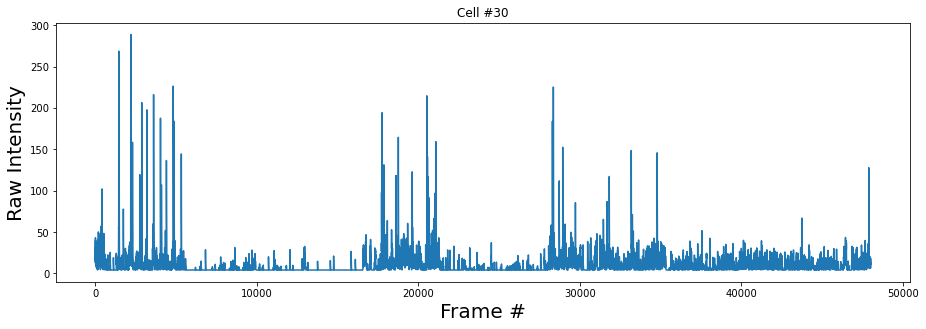

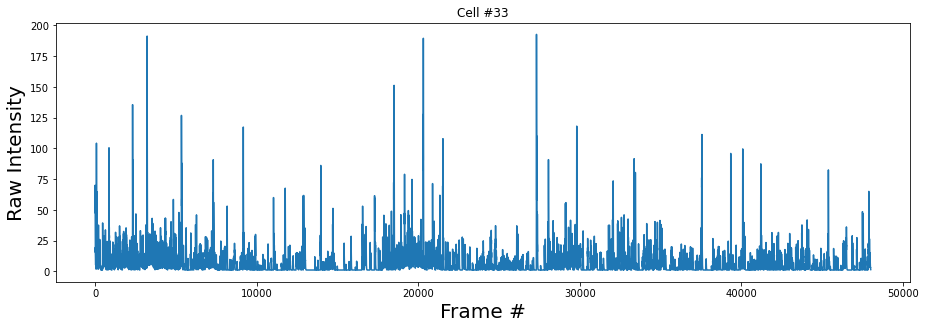

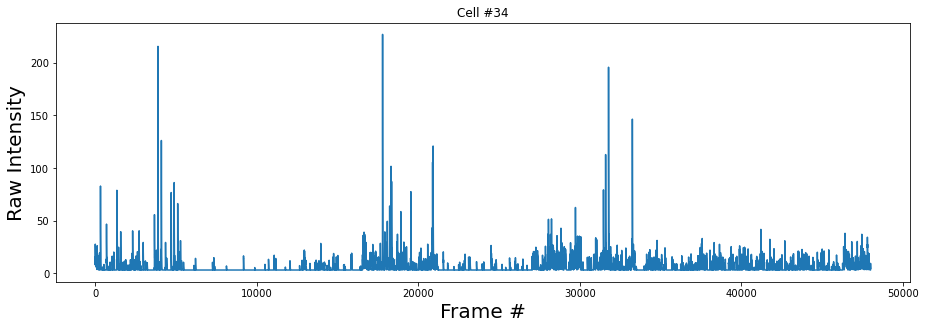

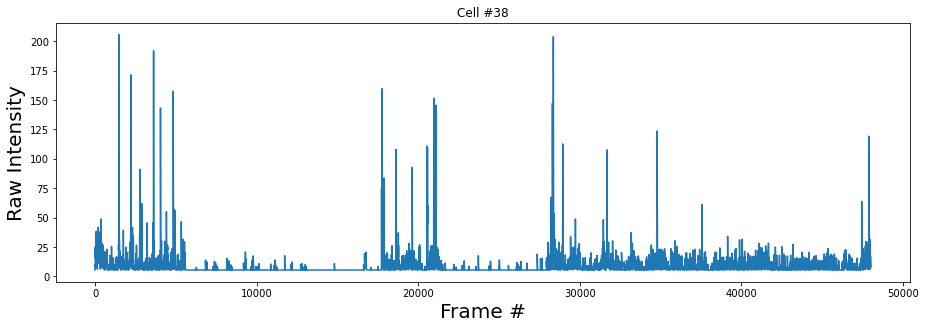

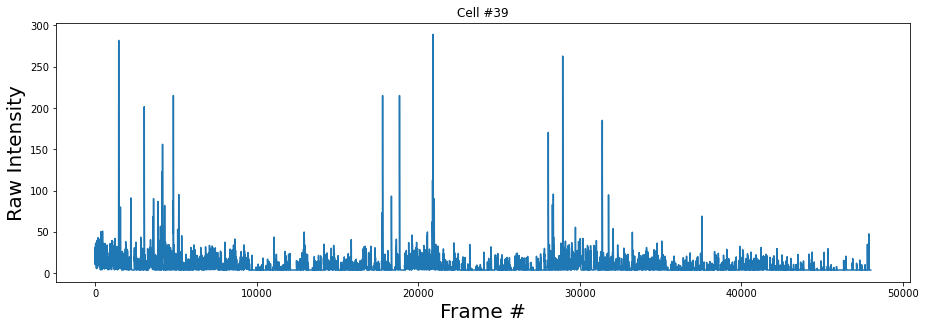

...

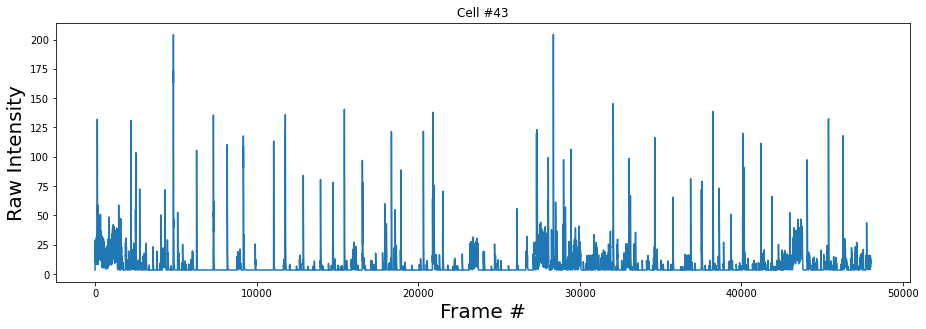

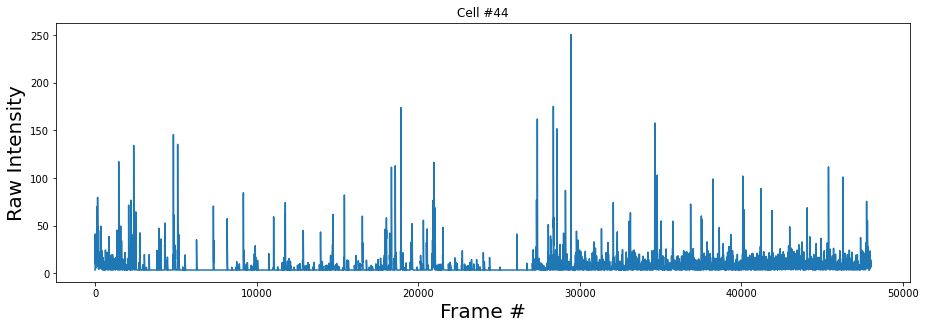

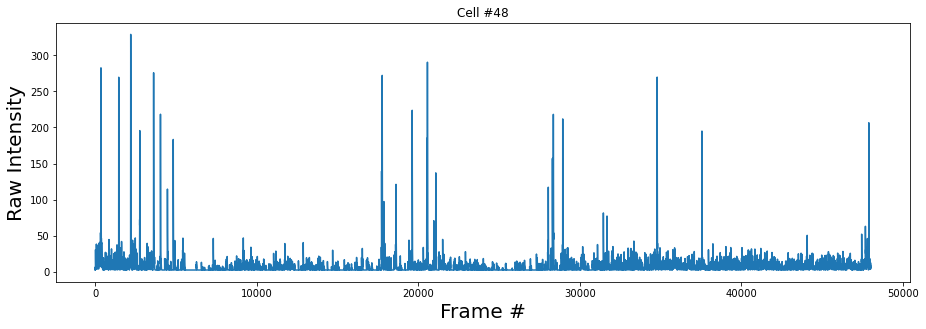

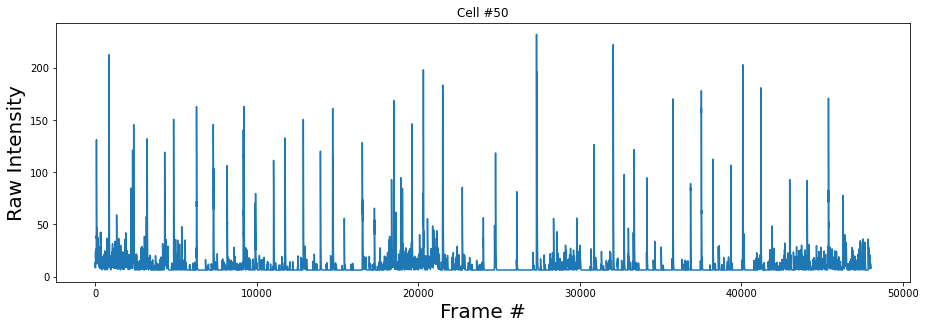

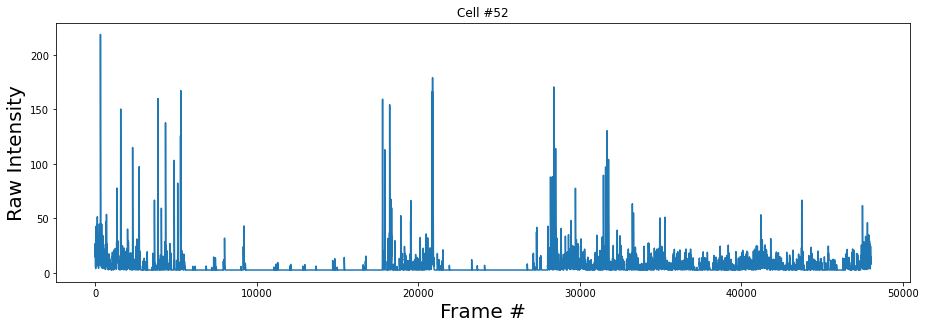

In [5]:
# Plot Individual Traces 

for x in range(NumofCell_raw):
    plt_raw.plot(df[CellList_raw[x]])
    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.ylabel('Raw Intensity', size = 20)
    plt_raw.xlabel('Frame #', size = 20)
    plt_raw.title(('Cell #' + CellList_raw[x]), fontdict=None, loc='center')
    plt_raw.show()




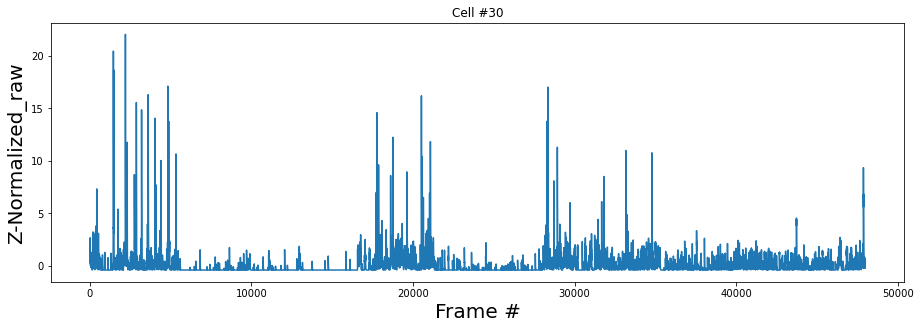

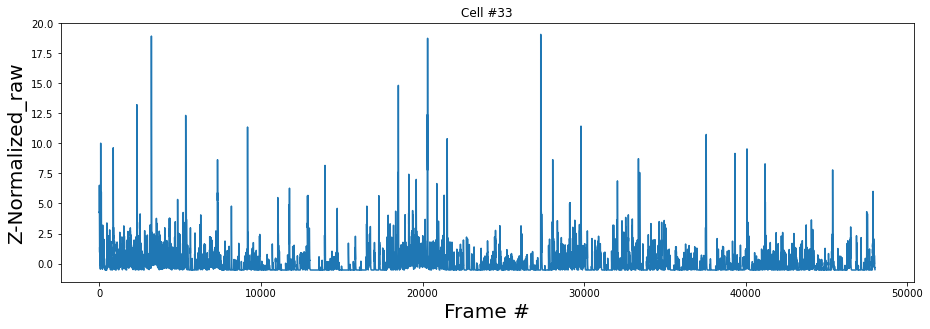

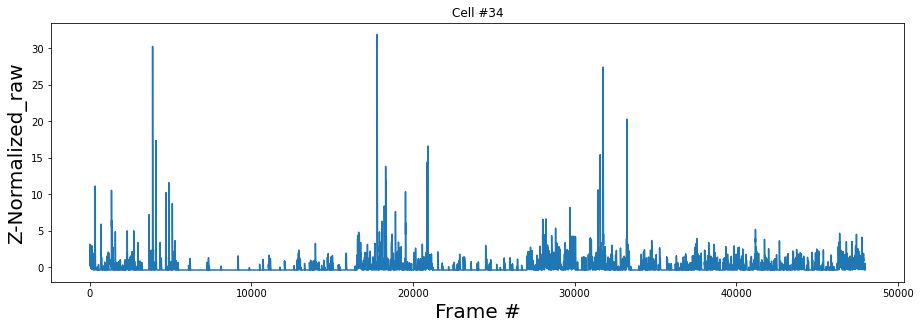

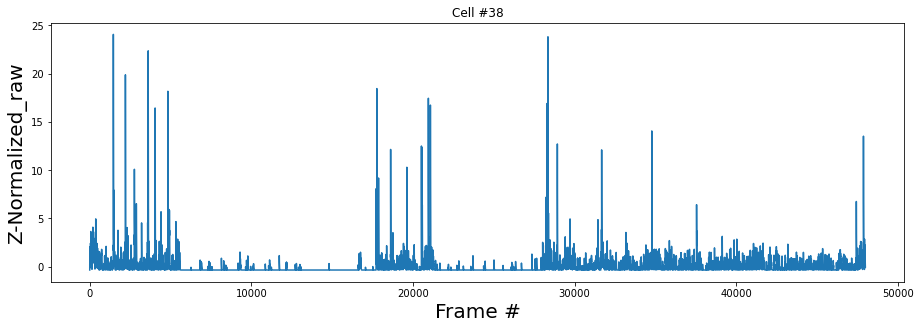

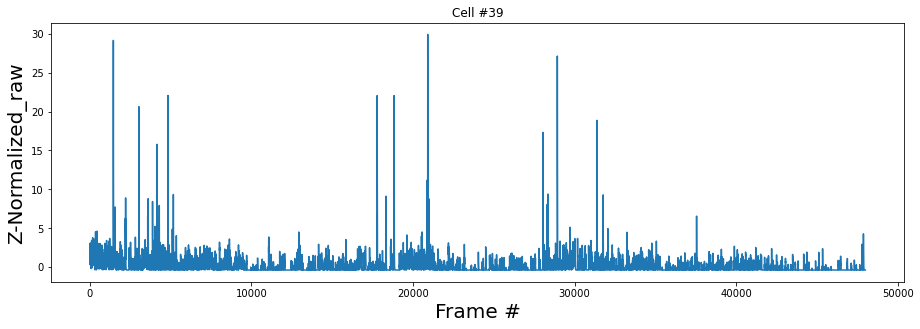

...

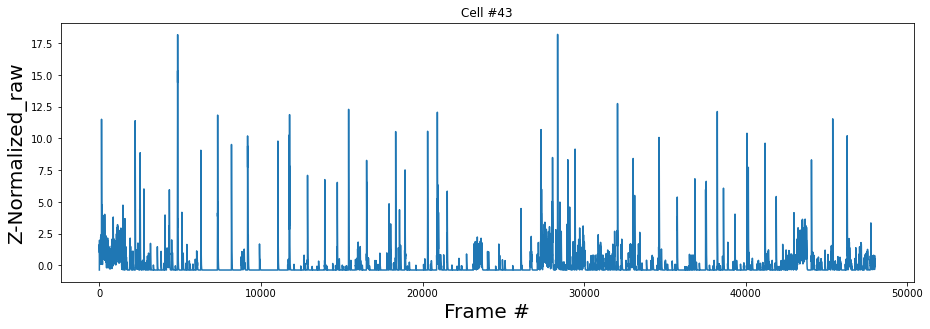

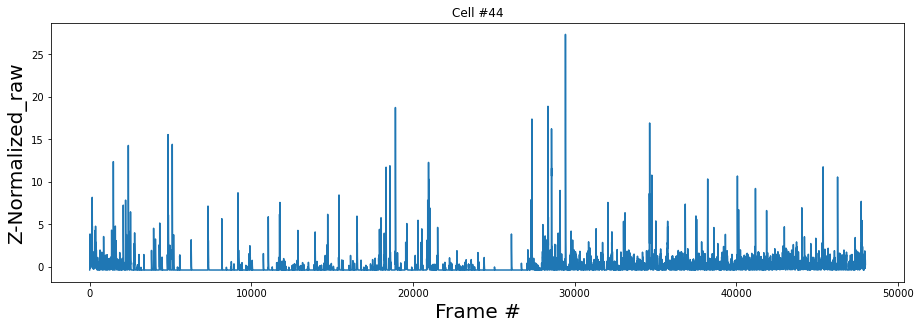

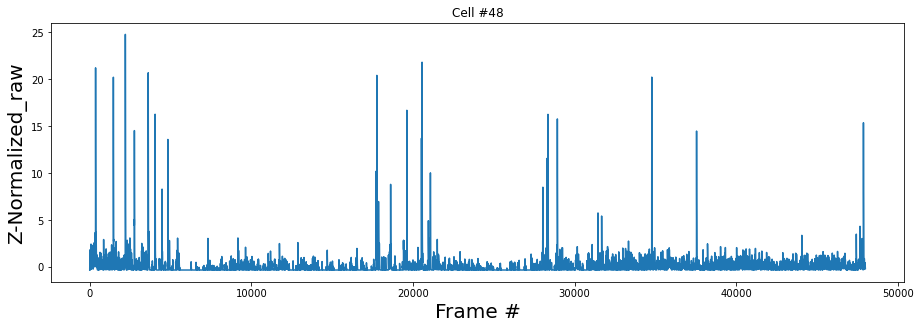

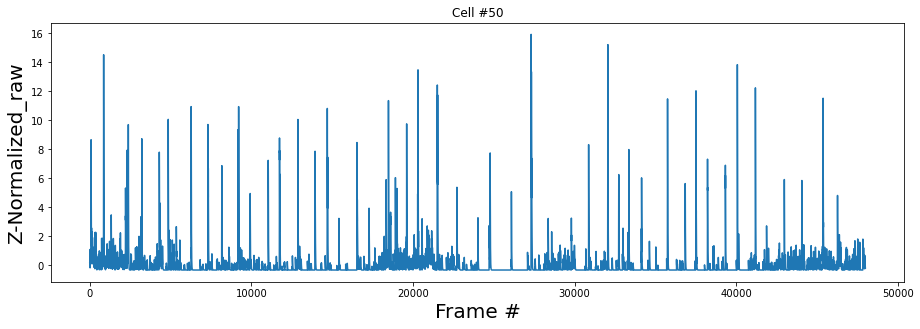

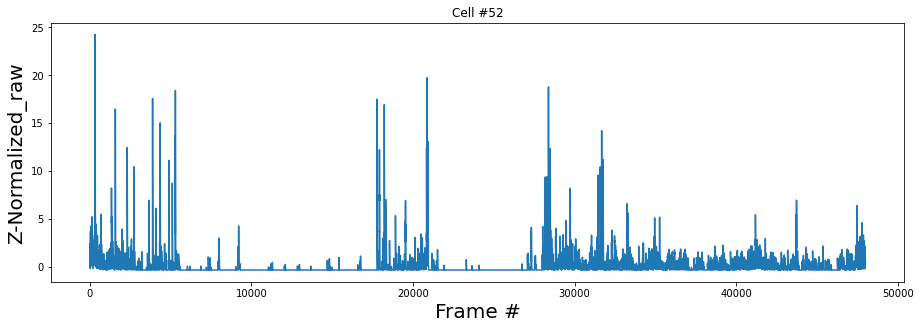

In [6]:
# Z-Normalized_raw Traces
# Individual Waveform
zNormalized_raw = df.copy()
for x in range(NumofCell_raw):
    zNormalized_raw[CellList_raw[x]] = (df[CellList_raw[x]]-np.mean(df[CellList_raw[x]]))/statistics.stdev(df[CellList_raw[x]])
for x in range(NumofCell_raw):
    plt_norm_raw.plot(zNormalized_raw[CellList_raw[x]])
    plt_norm_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_norm_raw.ylabel('Z-Normalized_raw', size = 20)
    plt_norm_raw.xlabel('Frame #', size = 20)
    plt_norm_raw.title(('Cell #' + CellList_raw[x]), fontdict=None, loc='center')
    plt_norm_raw.show()
    
for x in range(NumofCell_raw):
    df[('zNormalized_raw_Cell_'+ CellList_raw[x])]= zNormalized_raw[CellList_raw[x]]    # Export this to df dataframe

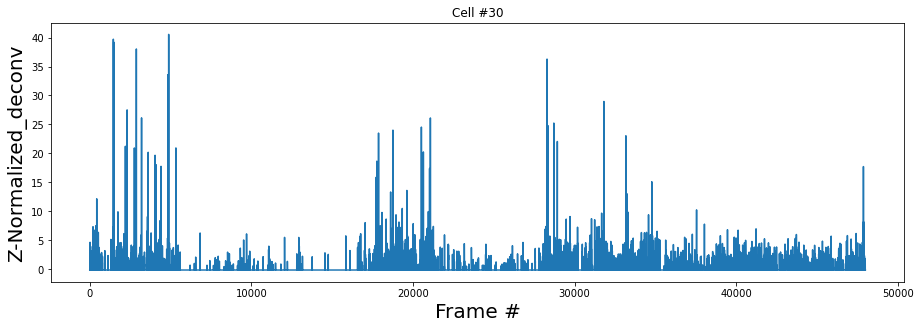

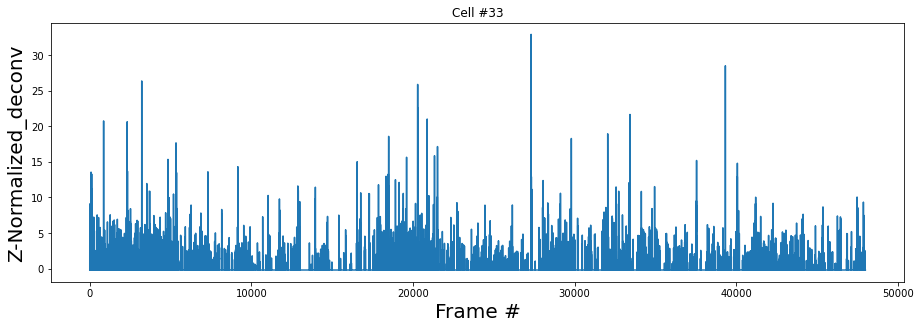

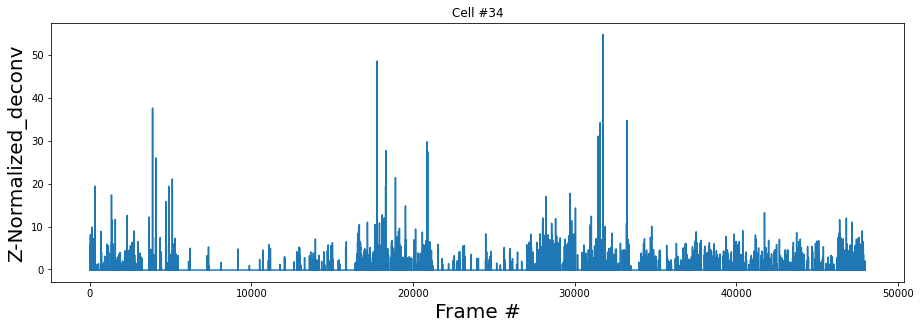

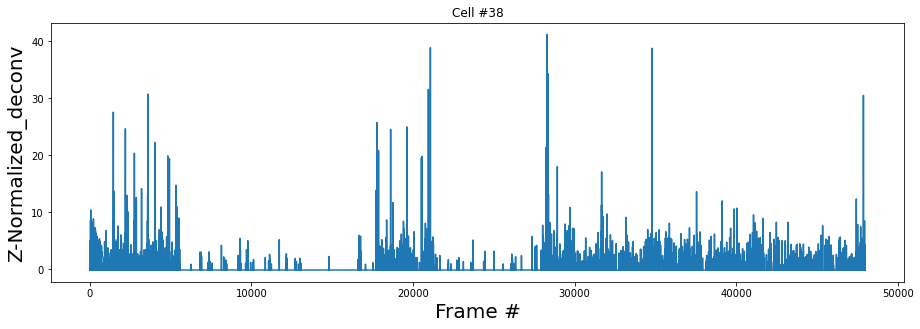

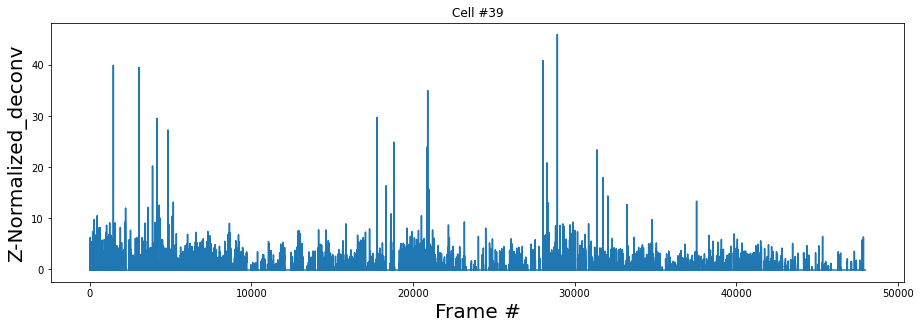

...

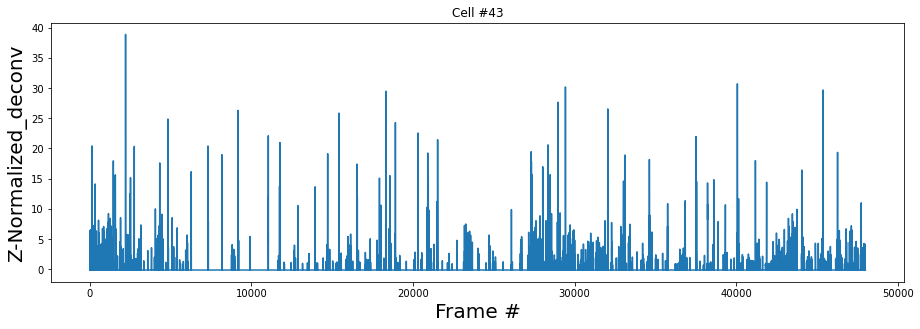

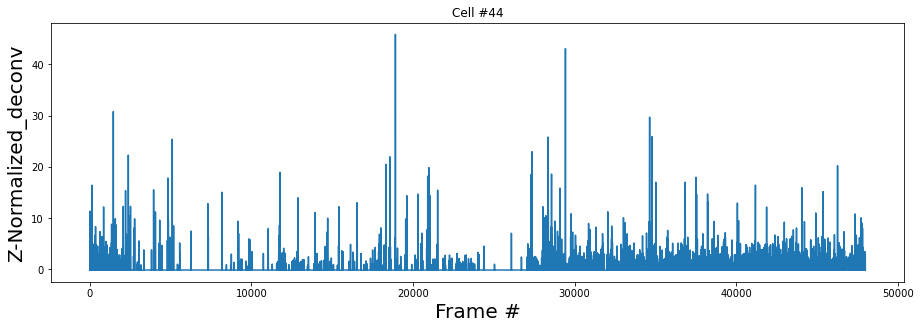

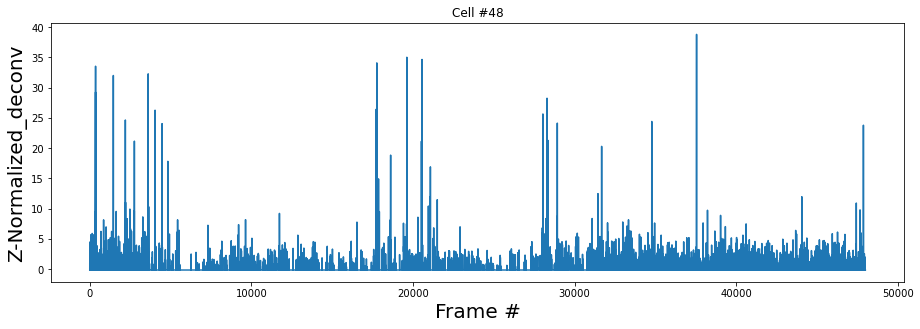

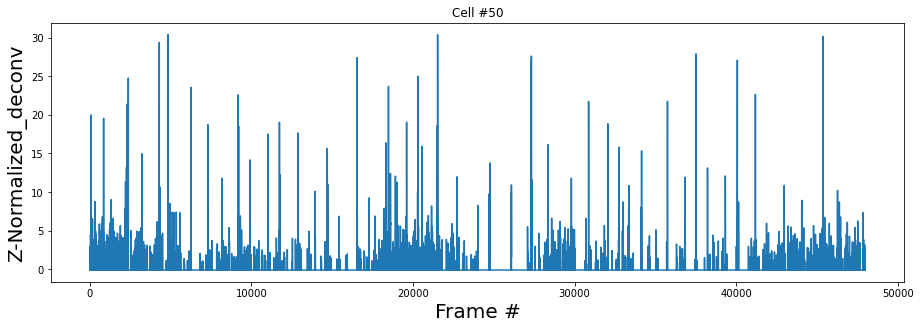

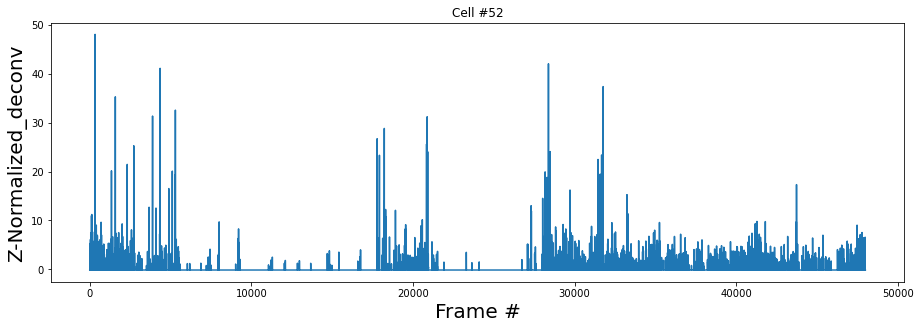

In [7]:
# Z-Normalized_deconv Traces
# Individual Waveform
zNormalized_deconv = df.copy()
for x in range(NumofCell_deconv):
    zNormalized_deconv[CellList_deconv[x]] = (df[CellList_deconv[x]]-np.mean(df[CellList_deconv[x]]))/statistics.stdev(df[CellList_deconv[x]])
for x in range(NumofCell_deconv):
    plt_norm_deconv.plot(zNormalized_deconv[CellList_deconv[x]])
    plt_norm_deconv.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_norm_deconv.ylabel('Z-Normalized_deconv', size = 20)
    plt_norm_deconv.xlabel('Frame #', size = 20)
    plt_norm_deconv.title(('Cell #' + CellList_raw[x]), fontdict=None, loc='center')
    plt_norm_deconv.show()
    
for x in range(NumofCell_deconv):
    df[('zNormalized_deconv_Cell_'+ CellList_deconv[x])]= zNormalized_deconv[CellList_deconv[x]]    # Export this to df dataframe
    
    
    

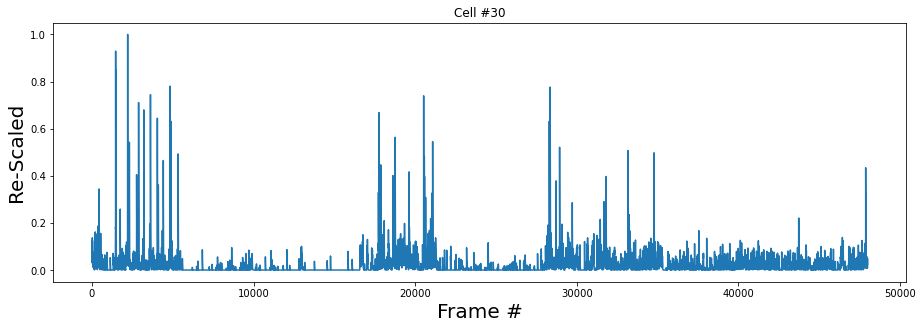

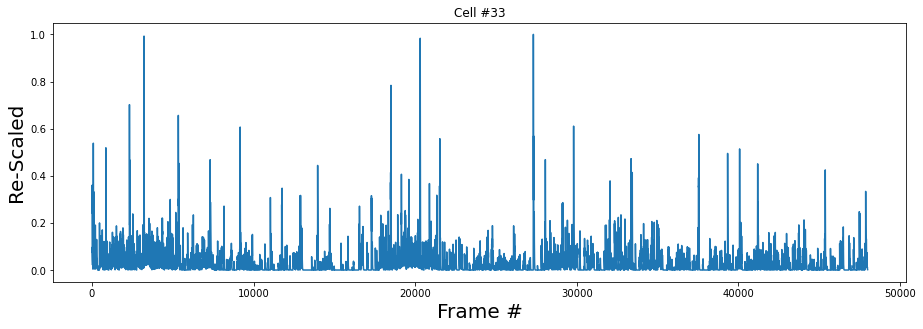

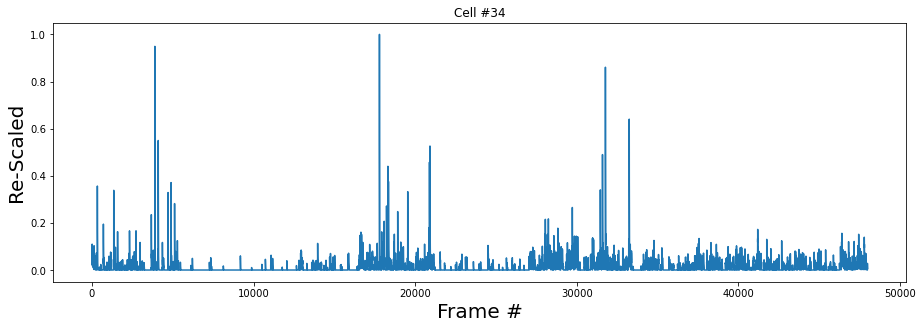

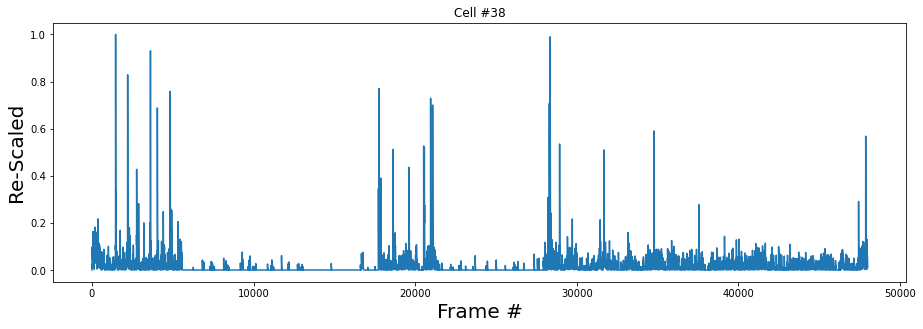

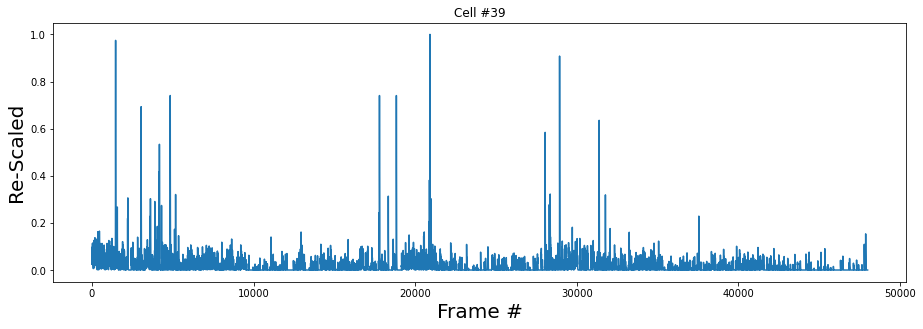

...

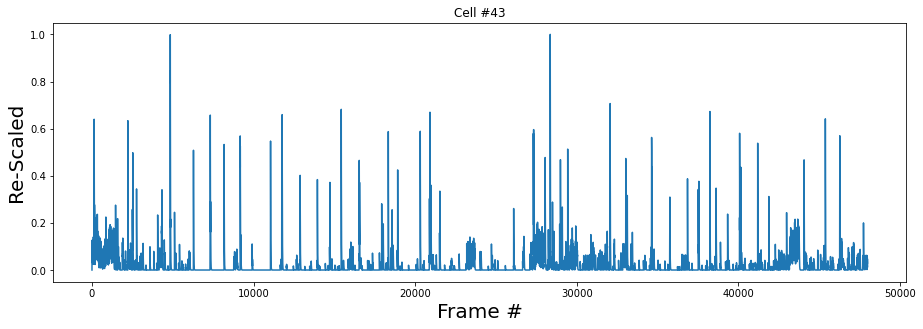

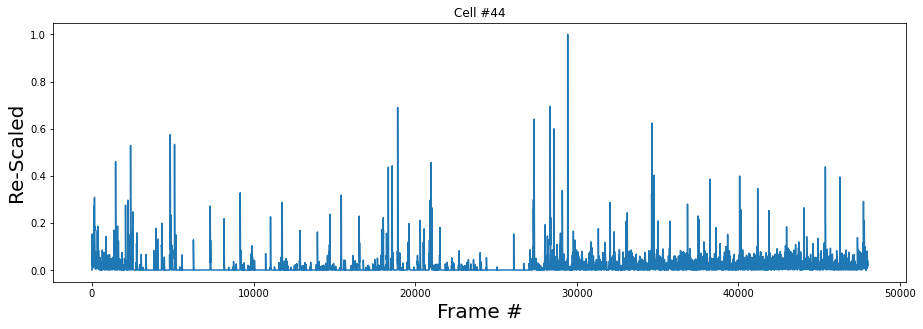

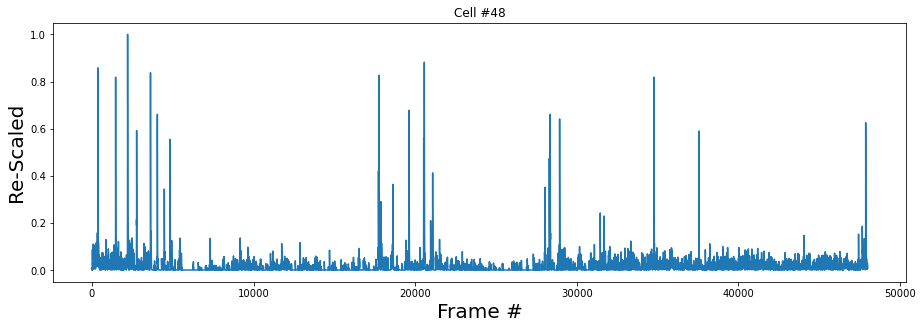

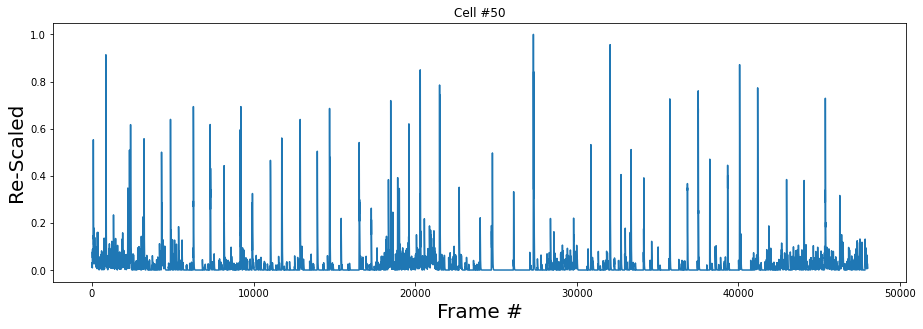

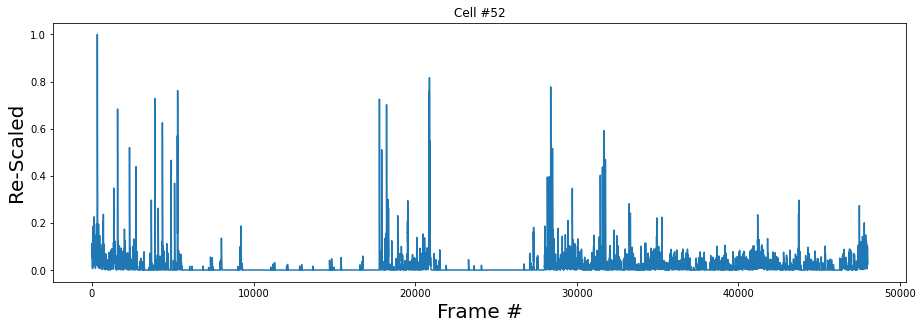

In [8]:
# Re-Scale Traces so it ranges from 0 to 1 based on maximum amplitude of each trace
# Individual Waveform
#ReScaled = df.copy()
ReScaled =pd.DataFrame()

for x in range(NumofCell_raw):
    #ReScaled[CellList[x]] = (df[CellList[x]]/np.max(df[CellList[x]]))    #delete me, incorrect
    ReScaled[CellList_raw[x]] = (df[CellList_raw[x]]-np.min(df[CellList_raw[x]]))/(np.max(df[CellList_raw[x]]) - np.min(df[CellList_raw[x]]))
for x in range(NumofCell_raw):
    plt_scaled.plot(ReScaled[CellList_raw[x]])
    plt_scaled.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_scaled.ylabel('Re-Scaled', size = 20)
    plt_scaled.xlabel('Frame #', size = 20)
    plt_scaled.title(('Cell #' + CellList_raw[x]), fontdict=None, loc='center')
    plt_scaled.show()

    
# print(np.max(ReScaled))
# print(np.min(ReScaled))

for x in range(NumofCell_raw):
    df[('ReScaled_Cell_'+ CellList_raw[x])]= ReScaled[CellList_raw[x]]    # Export this to df dataframe

##################################
# Calculates mean across cell 

Mean_of_All_Cells_Rescaled_df = ReScaled.iloc[:,0:NumofCell_raw].mean(axis=1)  
df['Mean_of_All_Cells_Rescaled_df']= Mean_of_All_Cells_Rescaled_df    # Export this to df dataframe

##################################
# Calculates median across cell 
Median_of_All_Cells_Rescaled_df = ReScaled.iloc[:,0:NumofCell_raw].median(axis=1)  
df['Median_of_All_Cells_Rescaled_df']= Median_of_All_Cells_Rescaled_df    # Export this to df dataframe





In [9]:
print(np.shape(df))
#print(df.keys())

print(np.shape(ReScaled))

print(NumofCell_raw)

(48001, 78)
(48001, 13)
13


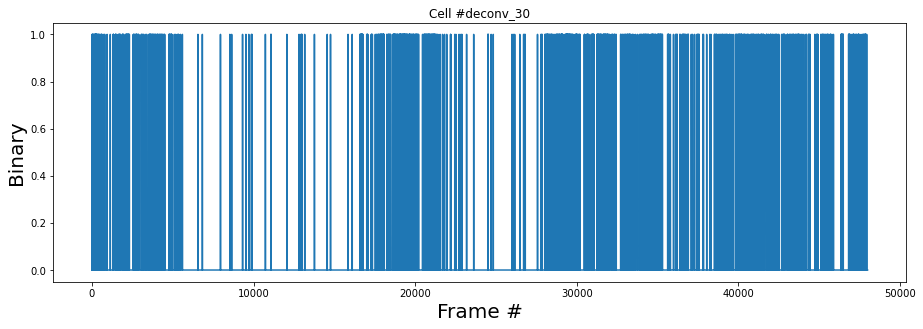

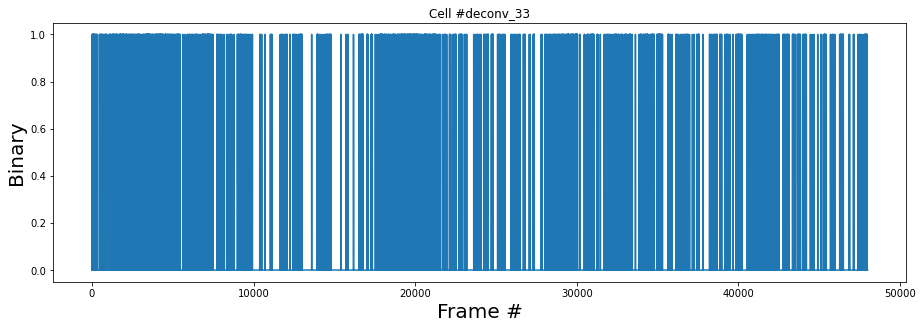

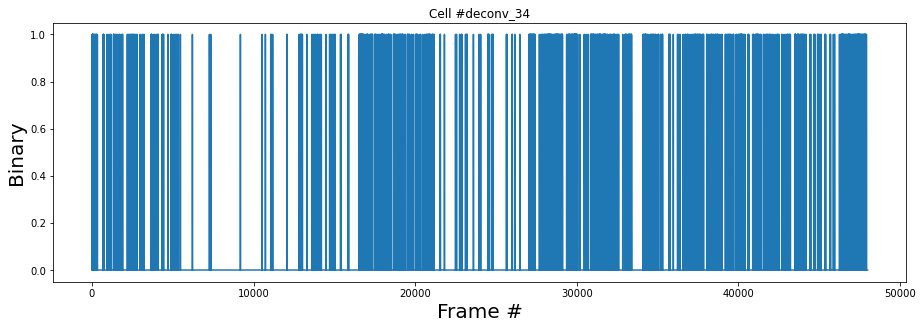

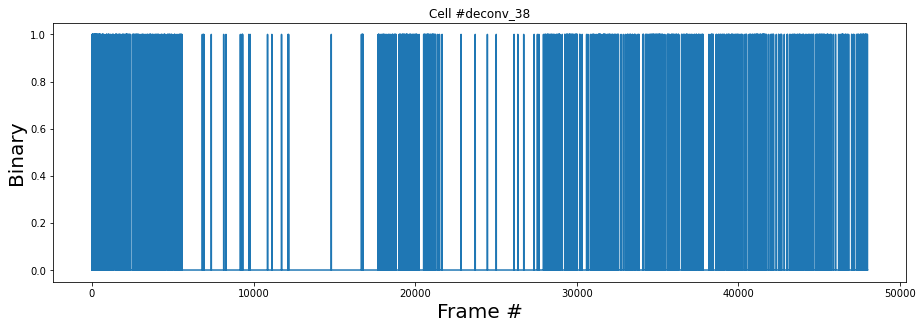

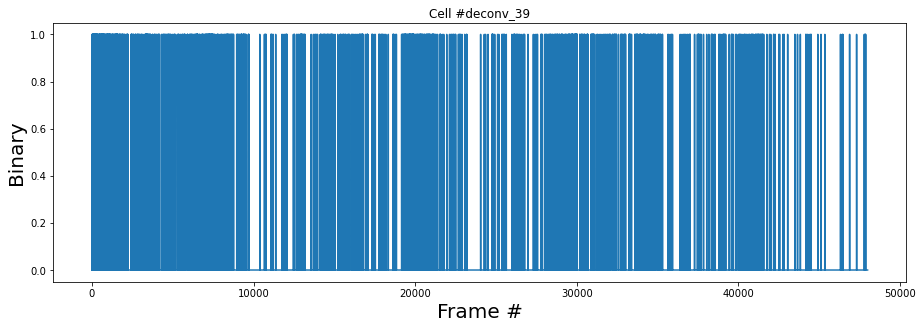

...

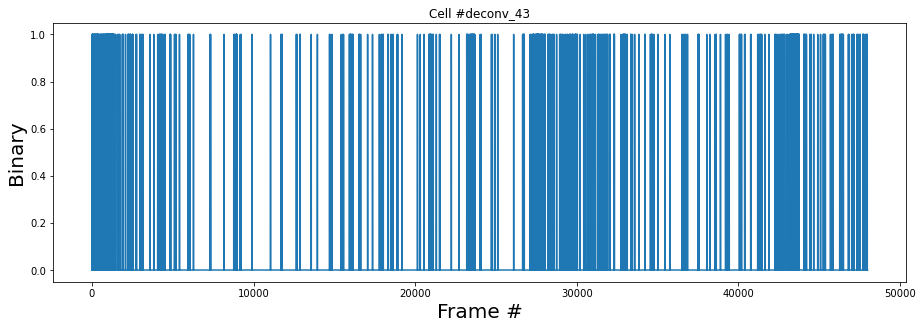

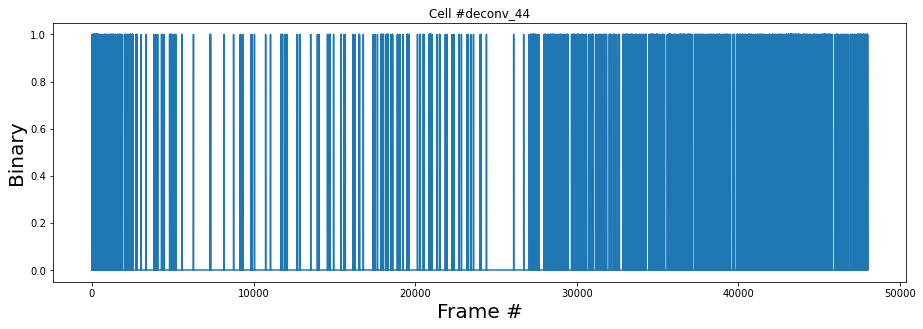

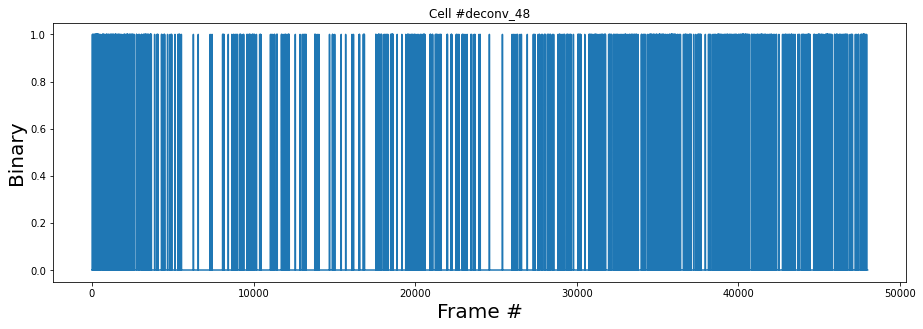

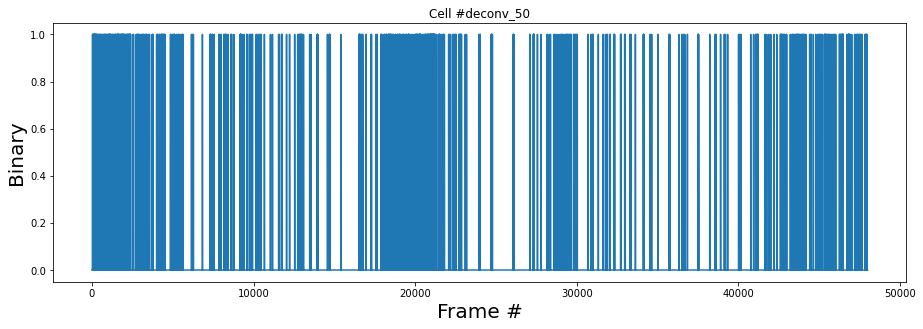

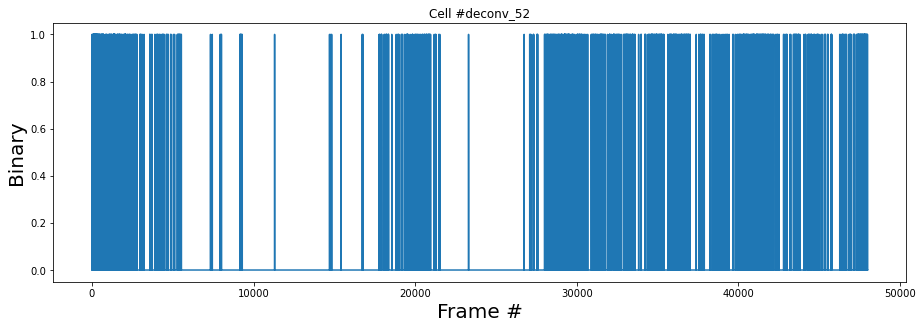

Bin                                48000.000000
time                                2400.000000
30                                   288.839434
33                                   192.746928
34                                   226.962257
                                       ...     
ReScaled_Cell_48                       1.000000
ReScaled_Cell_50                       1.000000
ReScaled_Cell_52                       1.000000
Mean_of_All_Cells_Rescaled_df          0.435085
Median_of_All_Cells_Rescaled_df        0.387817
Length: 73, dtype: float64
Bin                                0.000000
time                               0.000000
30                                 4.018119
33                                 1.164028
34                                 3.238768
                                     ...   
ReScaled_Cell_48                   0.000000
ReScaled_Cell_50                   0.000000
ReScaled_Cell_52                   0.000000
Mean_of_All_Cells_Rescaled_df      0.000001
Media

/Users/kang/opt/anaconda3/envs/Ca_Imaging/lib/python3.8/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  return reduction(axis=axis, out=out, **passkwargs)


In [10]:
# Binary Traces so it is either 0 or 1 
# Individual Waveform
Binary = df.copy()
# New lab convention to use 2 std as a threshold for event detection (based on overall event rate)
Binary_Threshold = 2  # anything larger than 2 will be coded as one, anything else is coded as 0.  

########## This approach takes too long to run
# for x in range(NumofCell):
#     for i in range(len(Binary[CellList[x]])):
#         if(df[CellList[x]][i] > 0):
#             Binary[CellList[x]][i] = 1
#         else:
#             Binary[CellList[x]][i] = 0


for x in range(NumofCell_deconv):
    #Binary[CellList_deconv[x]] = np.where(Binary[CellList_deconv[x]] > Binary_Threshold, 1, 0)
    Binary[CellList_deconv[x]] = np.where(zNormalized_deconv[CellList_deconv[x]] >= Binary_Threshold, 1, 0)

for x in range(NumofCell_deconv):
    plt_Binary.plot(Binary[CellList_deconv[x]])
    plt_Binary.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_Binary.ylabel('Binary', size = 20)
    plt_Binary.xlabel('Frame #', size = 20)
    plt_Binary.title(('Cell #' + CellList_deconv[x]), fontdict=None, loc='center')
    plt_Binary.show()

    
print(np.max(Binary))
print(np.min(Binary))

for x in range(NumofCell_deconv):
    df[('Binary_Cell_'+ CellList_deconv[x])]= Binary[CellList_deconv[x]]    # Export this to df dataframe
 

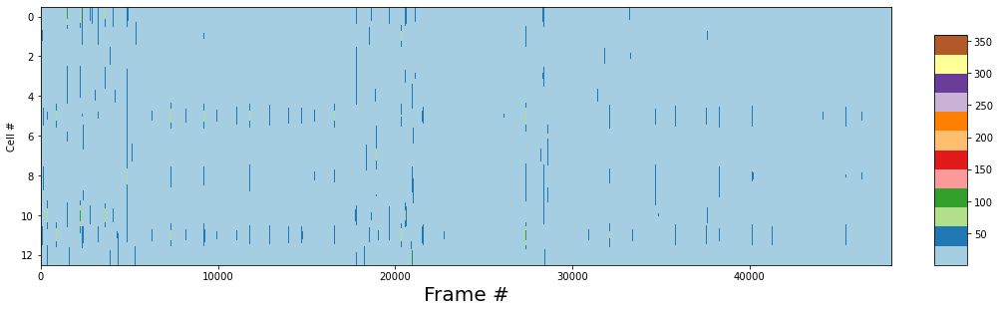

In [11]:
# Plot Raw Traces 

TransRawTraces = np.transpose(df.loc[0:len(df), CellList_raw])
plt_Heat_raw.imshow(TransRawTraces, cmap=plt_Heat_raw.cm.Paired, aspect = 'auto')
plt_Heat_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_Heat_raw.xlabel('Frame #', size = 20)
plt_Heat_raw.ylabel(('Cell #'), fontdict=None, loc='center')

# Color axis
cax = plt_Heat_raw.axes([2.2, 0.1, 0.075, 0.8])
plt_Heat_raw.colorbar(cax=cax)

plt_Heat_raw.show()


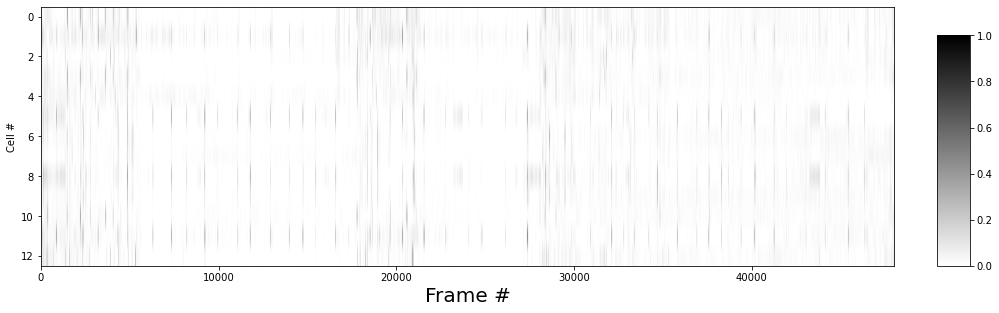

In [12]:
# Plot Scaled Traces,  Full Range (0 to 1)
TransScaledTraces = np.transpose(ReScaled.loc[0:len(ReScaled), CellList_raw])
plt_Heat_scaled.imshow(TransScaledTraces, cmap=plt_Heat_scaled.cm.gist_yarg, aspect = 'auto')
#plt_Heat_scaled.imshow(TransScaledTraces, cmap=plt_Heat_scaled.cm.gist_rainbow_r, aspect = 'auto')
plt_Heat_scaled.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_Heat_scaled.xlabel('Frame #', size = 20)
plt_Heat_scaled.ylabel(('Cell #'), fontdict=None, loc='center')
# Color axis
cax = plt_Heat_scaled.axes([2.2, 0.1, 0.075, 0.8])
plt_Heat_scaled.colorbar(cax=cax)
plt_Heat_scaled.show()


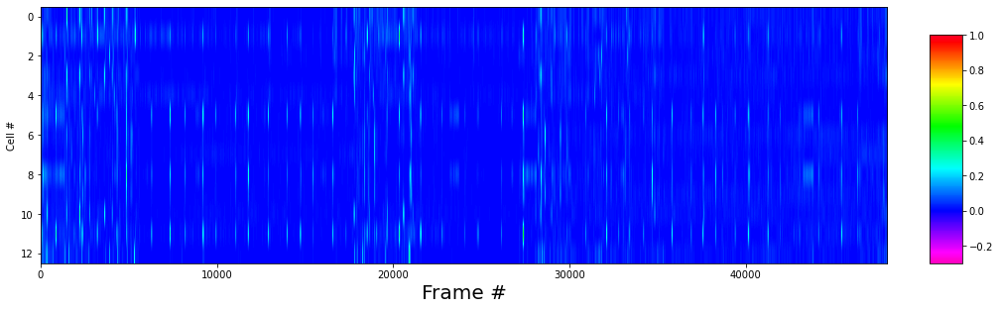

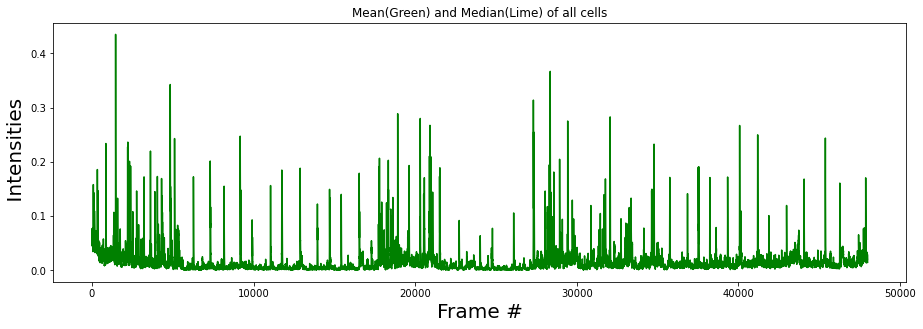

In [13]:
# Plot Scaled Traces,  Full Range (0 to 1), log scale
TransScaledTraces = np.transpose(ReScaled.loc[0:len(ReScaled), CellList_raw])
#plt_Heat_scaled.imshow(TransScaledTraces, cmap=plt_Heat_scaled.cm.gist_yarg, aspect = 'auto')
plt_Heat_scaled.imshow(TransScaledTraces, cmap=plt_Heat_scaled.cm.gist_rainbow_r, aspect = 'auto')
plt_Heat_scaled.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_Heat_scaled.xlabel('Frame #', size = 20)
plt_Heat_scaled.ylabel(('Cell #'), fontdict=None, loc='center')
# Color axis
cax = plt_Heat_scaled.axes([2.2, 0.1, 0.075, 0.8])
#plt_Heat_scaled.yscale('log')
plt_Heat_scaled.clim(-0.3, 1)###############################################################  Set Range for Color
plt_Heat_scaled.colorbar(cax=cax)
plt_Heat_scaled.show()

#. Plot Re-Scaled traces that are averages and median of all cells
plt_scaled.plot(df['Mean_of_All_Cells_Rescaled_df'],'g')
#plt_scaled.plot(df['Median_of_All_Cells_Rescaled_df'],'lime')
plt_scaled.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_scaled.ylabel(' Intensities', size = 20)
plt_scaled.xlabel('Frame #', size = 20)
plt_scaled.title('Mean(Green) and Median(Lime) of all cells', fontdict=None, loc='center')
plt_scaled.show()

    
# # print(np.max(ReScaled))
# # print(np.min(ReScaled))

# for x in range(NumofCell_raw):
#     df[('ReScaled_Cell_'+ CellList_raw[x])]= ReScaled[CellList_raw[x]]    # Export this to df dataframe

# ##################################


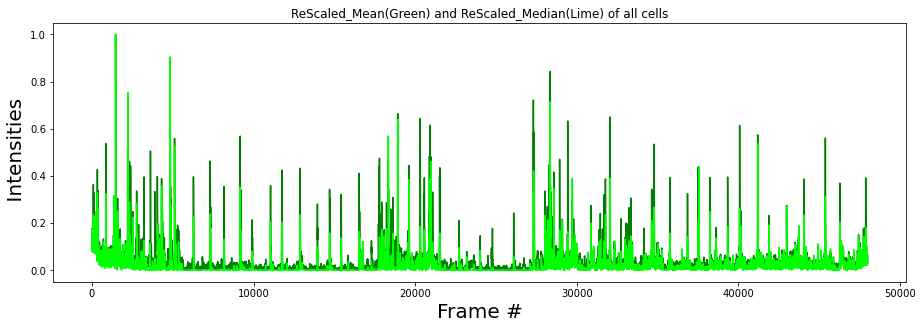

In [14]:
df['ReScaled_Mean_of_All_Cells_Rescaled_df'] = df['Mean_of_All_Cells_Rescaled_df']/max(df['Mean_of_All_Cells_Rescaled_df'])
df['ReScaled_Median_of_All_Cells_Rescaled_df'] = df['Median_of_All_Cells_Rescaled_df']/max(df['Median_of_All_Cells_Rescaled_df'])

plt_scaled.plot(df['ReScaled_Mean_of_All_Cells_Rescaled_df'],'g')
plt_scaled.plot(df['ReScaled_Median_of_All_Cells_Rescaled_df'], 'lime')
plt_scaled.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_scaled.ylabel(' Intensities', size = 20)
plt_scaled.xlabel('Frame #', size = 20)
plt_scaled.title('ReScaled_Mean(Green) and ReScaled_Median(Lime) of all cells', fontdict=None, loc='center')
plt_scaled.show()

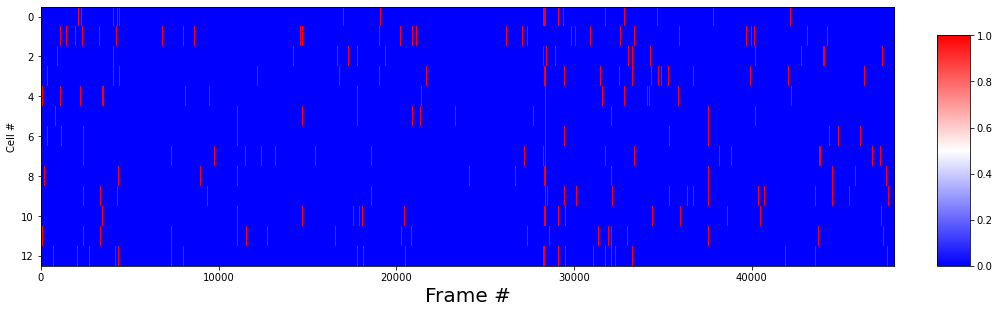

In [15]:
# Plot Binary Traces,  Full Range (0 to 1), log scale
TransBinaryTraces = np.transpose(Binary.loc[0:len(Binary), CellList_deconv])

#plt_Heat_Binary.imshow(TransBinaryTraces, cmap=plt_Heat_scaled.cm.gist_rainbow_r, aspect = 'auto')
plt_Heat_Binary.imshow(TransBinaryTraces, interpolation = 'none', cmap=plt_Heat_scaled.cm.bwr, aspect = 'auto')
#plt_Heat_Binary.xlim(0, 100)

plt_Heat_Binary.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_Heat_Binary.xlabel('Frame #', size = 20)
plt_Heat_Binary.ylabel(('Cell #'), fontdict=None, loc='center')
# Color axis
cax = plt_Heat_Binary.axes([2.2, 0.1, 0.075, 0.8])
#plt_Heat_scaled.yscale('log')
plt_Heat_Binary.clim(0, 1)###############################################################  Set Range for Color
plt_Heat_Binary.colorbar(cax=cax)


plt_Heat_Binary.show()

Deconv_Rate_Thrsld_0:  [0.9404291256752665]


Avg_z-Norm_Rate [0.9335702942086141, 0.6662040694665013, 0.4241578300452073, 0.2682315913290268, 0.17695144171675908, 0.11967699390878074, 0.08448541937427584, 0.0640050768173099, 0.05163353968587193, 0.04115298879991282, 0.034133904261609935]


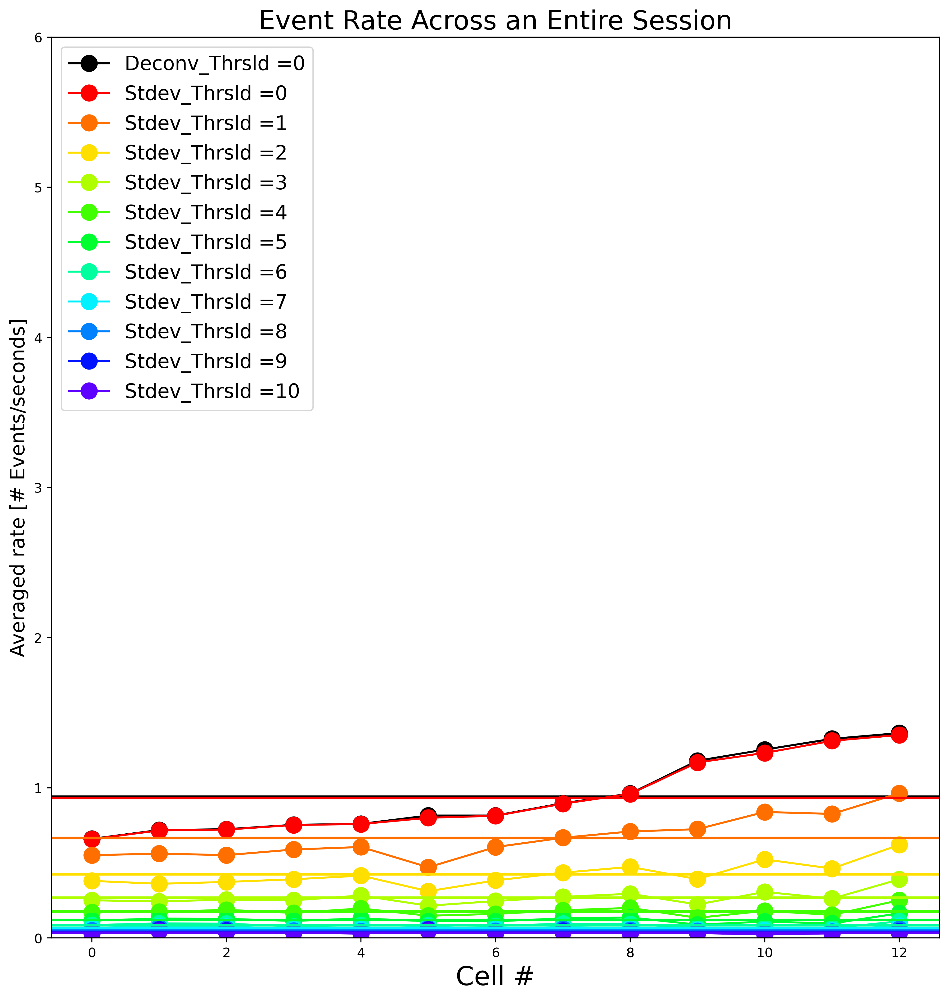

In [16]:
#.  Event Rate as with respect with different standard deviation threshold (after zNormalizing Deconvoluted signal )


#####################################################################################################
#. Re-order cell list to asending orders of event rate at stdev = 0 
Cell_Event_Total_at_stdev_zero =  defaultdict(list)

for ii in range(NumofCell_deconv):
    count_Event_cell = len(zNormalized_deconv[zNormalized_deconv[CellList_deconv[ii]]  > 0 ]) 
    Cell_Event_Total_at_stdev_zero[CellList_deconv[ii]].append(count_Event_cell)

ReOrdered_Cell_Event_Total_at_stdev_zero = dict(sorted(Cell_Event_Total_at_stdev_zero.items(), key=lambda item: item[1]))

CellList_ReOrdered_Cell_Event_Total_at_stdev_zero = list(ReOrdered_Cell_Event_Total_at_stdev_zero.keys())



# verify that deconv at zero threshold is same as z-normalized at zero threshold
temp_deconv_sum = 0
temp_znorm_sum = 0

temp_deconv_Rate = defaultdict(list)
temp_znorm_Rate = defaultdict(list)

#deconv at zero threshold 
for ii in range(NumofCell_deconv):

    len_cell = len(df[CellList_deconv[ii]] )
    count_Event_cell = len(df[df[CellList_deconv[ii]]  > 0 ]) # count # of items > 4 

    temp_deconv_sum = temp_deconv_sum +(count_Event_cell/(len_cell/20))    #. 20 is sample rate per second, sum the event count for all cells in each stdev_threshold

    temp_deconv_Rate[CellList_deconv[ii]].append(count_Event_cell/(len_cell/20))   #20 is sample rate per second

temp_deconv_Rate['Avg'].append(temp_deconv_sum/NumofCell_deconv)


#z-normalize threshold zero
for ii in range(NumofCell_deconv):

    len_cell = len(zNormalized_deconv[CellList_deconv[ii]] )
    count_Event_cell = len(zNormalized_deconv[zNormalized_deconv[CellList_deconv[ii]]  > 0 ]) # count # of items > 4 

    temp_znorm_sum = temp_znorm_sum +(count_Event_cell/(len_cell/20))    #. 20 is sample rate per second, sum the event count for all cells in each stdev_threshold

    temp_znorm_Rate[CellList_deconv[ii]].append(count_Event_cell/(len_cell/20))   #20 is sample rate per second
    
temp_znorm_Rate['Avg'].append(temp_znorm_sum/NumofCell_deconv)
    

y_deconv_Rate =[]
y_znorm_Rate =[]

for ii in range(NumofCell_deconv):
    #y_One_values.append(Overall_Rate[CellList_deconv[ii]][i])   # Original Cell order
    y_deconv_Rate.append(temp_deconv_Rate[CellList_ReOrdered_Cell_Event_Total_at_stdev_zero[ii]][0])  # Asending order
    
for ii in range(NumofCell_deconv):
    y_znorm_Rate.append(temp_znorm_Rate[CellList_ReOrdered_Cell_Event_Total_at_stdev_zero[ii]][0])  # Asending order    


#####################################################################################################
#. Calculate overall event rates for individual cells at different threshold of standard deviations
Stdev_Threshold = [0,1,2,3,4,5,6,7,8,9,10]
Overall_Rate = defaultdict(list)

for i in range(len(Stdev_Threshold)):
    temp_sum = 0
    
    for ii in range(NumofCell_deconv):
       
        len_cell = len(zNormalized_deconv[CellList_deconv[ii]] )
        count_Event_cell = len(zNormalized_deconv[zNormalized_deconv[CellList_deconv[ii]]  > Stdev_Threshold[i] ]) # count # of items > 4 
     
        temp_sum = temp_sum +(count_Event_cell/(len_cell/20))    #. 20 is sample rate per second, sum the event count for all cells in each stdev_threshold
        
        Overall_Rate[CellList_deconv[ii]].append(count_Event_cell/(len_cell/20))   #20 is sample rate per second


    #print(Stdev_Threshold[i])
    Overall_Rate['Threshold'].append(i)
    Overall_Rate['Avg'].append(temp_sum/NumofCell_deconv)
    
#print(Overall_Rate.keys())

#print(Overall_Rate)
# print(Overall_Rate[CellList_deconv[0]])
# print(Overall_Rate[CellList_deconv[0]][2])

#####################################################################################################
#. Plot overall event rates for individual cells at different threshold of standard deviations



x_values = list(range(0,NumofCell_deconv))

fig = plt_raw.figure(figsize =(5, 5), dpi = 400.0)
# plot deconvoluted event rate (not z normalized) at threshold zero  
plt_raw.plot(x_values, y_deconv_Rate, color = 'black', marker='o', markerfacecolor='black' , markersize=12, label = ('Deconv_Thrsld ='+str(0)))
plt_raw.axhline(y=temp_deconv_Rate['Avg'][0], c = 'black', lw=2)


for i in range(len(Stdev_Threshold)):

    y_One_values =[]

    for ii in range(NumofCell_deconv):
        #y_One_values.append(Overall_Rate[CellList_deconv[ii]][i])   # Original Cell order
        y_One_values.append(Overall_Rate[CellList_ReOrdered_Cell_Event_Total_at_stdev_zero[ii]][i])  # Asending order
    
    temp_c = colorsys.hsv_to_rgb(0.8/len(Stdev_Threshold)*i, 1, 1)#. 0 to 0.8 for rainbow color
    plt_raw.plot(x_values, y_One_values, color = temp_c, marker='o', markerfacecolor=temp_c , markersize=12, label = ('Stdev_Thrsld ='+str(i)))



for i in range(len(Stdev_Threshold)):
    temp_c = colorsys.hsv_to_rgb(0.8/len(Stdev_Threshold)*i, 1, 1)#. 0 to 0.8 for rainbow color
    plt_raw.axhline(y=Overall_Rate['Avg'][i], c=temp_c, lw=2)



plt_raw.legend(loc ="upper left", fontsize = 15)
plt_raw.subplots_adjust(bottom=0.1, right=2, top=2)
plt_raw.ylabel('Averaged rate [# Events/seconds]', size = 15)
plt_raw.xlabel('Cell #', size = 20)
plt_raw.title('Event Rate Across an Entire Session', size = 20 )
#plt_raw.xlim(0,5)
plt_raw.ylim(0,6)


print('Deconv_Rate_Thrsld_0: ',temp_deconv_Rate['Avg'])
print('\n')
print('Avg_z-Norm_Rate',Overall_Rate['Avg'])

# print(x)
# print(len(x))

filename =  File_Name.split(".")[0] +'_'+ 'Event_Rate' + '.jpg'
savefilename = os.path.join(Save_Path, filename)
plt_raw.savefig(savefilename, bbox_inches='tight')
    
plt_raw.show()
    

In [17]:
event_code_dict = {
                   '5521' :'Trial_Window_Start', '5520' :'Trial_Window_End', 
                   '4521' :'Trial_Start', '4520' :'Trial_End',
                   '3521' :'Reward_Win_Start', '3520' :'Reward_Win_End',
                   '2521' :'ITI_Start', '2520' :'ITI_End',
                   '0000' : "Trial_Type",
                   '0001' : "Session_Start",
                   '0002' : "Session_End",
                   
                   '0114' :'File_END',
                   
                   '7171': 'L_led_Valid_ON', '7170': 'L_led_Valid_OFF',
                   '8171': 'M_led_Valid_ON', '8170': 'M_led_Valid_OFF',
                   '9171': 'R_led_Valid_ON', '9170': 'R_led_Valid_OFF', 
                   
                   '7271': 'L_sol_Valid_ON', '7270': 'L_sol_Valid_OFF',
                   '8271': 'M_sol_Valid_ON', '8270': 'M_sol_Valid_OFF',
                   '9271': 'R_sol_Valid_ON', '9270': 'R_sol_Valid_OFF',
                   
                   
                   
                   
                   '7071': 'L_Poke_Valid_IN', '7070': 'L_Poke_Valid_OUT',
                   '8071': 'M_Poke_Valid_IN', '8070': 'M_Poke_Valid_OUT',
                   '9071': 'R_Poke_Valid_IN', '9070': 'R_Poke_Valid_OUT', 


                   '7540' :'Left Omission', '8540' :'Middle Omission', '9540' :'Right Omission',
    
    
#                    '5530' :'Poke_In_Delayed_Window_Punishmnet',
#                    '5531' :'No_Poke_In_Delayed_Window_OK',
                   
                   
#                     '7160': 'L_led_Invalid_OFF',
#                     '8160': 'M_led_Invalid_OFF',
#                     '9160': 'R_led_Invalid_OFF',

                   # '7519': 'L_iw',  '7529': 'L_tw',  '7539': 'L_vw', '7559': 'L_delay_w',
                   # '8519': 'M_iw',  '8529': 'M_tw',  '8539': 'M_vw', '8559': 'M_delay_w',
                   # '9519': 'R_iw',  '9529': 'R_tw',  '9539': 'R_vw', '9559': 'R_delay_w',

                   }

In [18]:

if(ReCalculate_TimeStamp== 0):  # load timestamp from file 

    filename = 'Event_Count_' + File_Name.split(".")[0] +'.pkl'
    savefilename = os.path.join(Save_Path, filename)
    with open(savefilename, 'rb') as file: 
      # Call load method to deserialze 
        Event_Count = pickle.load(file)
    
    filename = 'Event_Count_TimeStamps' + File_Name.split(".")[0] +'.pkl'
    savefilename = os.path.join(Save_Path, filename)
    with open(savefilename, 'rb') as file: 
        # Call load method to deserialze 
        Event_Count_TimeStamps = pickle.load(file) 

In [19]:
# Extract Events from (event_1, event_2, event_3, event_4, event_5)

if(ReCalculate_TimeStamp == 1):
    x = 1
    NumofEventColumn = 0  # Identify Events based on "event_"    
    EvenColumnList = []
    for xx in range(len(df.columns)):
        if(('event_' in df.columns[xx])):
            NumofEventColumn = NumofEventColumn +1
            EvenColumnList.append(df.columns[xx])
    print('NumofEventColumn = ',NumofEventColumn )
    print('EvenColumnList =', EvenColumnList)






    ##  Counts different kinds of events (Event_Count),  
    ##. then sorts timestamps with respects to differnet kinds of events (Event_Count_TimeStamps)   
    Event_Count_temp = {}
    Event_Count = {}  
    Event_Count_TimeStamps = defaultdict(list)


    ########. OPTION 1.  Create Event_Count purly on timestamps found in data###########
    ######### But Y-axis label looks messy because it's random order ###################################################
    # for i in range(NumofEventColumn):  # Goes through all event columns (5 for now)
    #     for ii in range (len(df)):
    #         Event_Count_temp[list(df[EvenColumnList[i]])[ii]]= 0

    # # Orders dictionary items, so it is easier to read later on        
    # OrderedDict(sorted(Event_Count_temp.items(), key=lambda t: t[1]))        
    # Event_Count = Event_Count_temp




    ####### OPTION 2.  Create Event_Count by using pre-ordered code dictionary######
    #########. Y-axis looks cleaner################################################

    for i in range (len(event_code_dict)):
            Event_Count[ list(event_code_dict.values())[i] ]= 0

    for i in range(NumofEventColumn):  # Goes through all event columns (5 for now)
        for ii in range (len(df)):

            match = 0   
            for iii in range (len(event_code_dict)):
                #if(df[EvenColumnList[0]][ii] == list(event_code_dict.values())[iii]):
                #if(df[EvenColumnList[i]][ii] == list(event_code_dict.values())[iii]):
                if((df[EvenColumnList[i]][ii] == list(event_code_dict.values())[iii])|pd.isnull(df[EvenColumnList[i]][ii])== True):  # Does not count NAN
                    match  = 1
            if(match == 0):
                Event_Count[list(df[EvenColumnList[i]])[ii]]= 0
    #############################################################################

    # initalized Event_Count_TimeStamps so it's the same order as Event_Count,  'None' is addeded as a place holder, will be remove in next few lines
    for iii in range(len(Event_Count)):
        Event_Count_TimeStamps[(list(Event_Count.keys())[iii])].append(None)     

    #  Count number of Events , and sorting timestamps into Event_Count_Timestamps
    for i in range(NumofEventColumn):  # Goes through all event columns (5 for now)
        for ii in range(len(df)):
            for iii in range (len(Event_Count)):
                if(df[EvenColumnList[i]][ii] == list(Event_Count.keys())[iii]):
                    Event_Count[list(Event_Count.keys())[iii]] += 1  # add one  to count num of events
                    Event_Count_TimeStamps[list(Event_Count.keys())[iii]].append([ii]) 

    #  Remove 'None' place holder for Event_Count_TimeStamp, whihc is the first value
    for i in range(len(Event_Count)):
        del Event_Count_TimeStamps[list(Event_Count_TimeStamps.keys())[i]][0]



    # go through each Event_Count_Timestamps to sort timestamps from smallest to largest 
    for iii in range(len(Event_Count)):
        (Event_Count_TimeStamps[(list(Event_Count.keys())[iii])]).sort()      




    # print('\n')
    #print(Event_Count)
    # print('\n')
    #print(Event_Count_TimeStamps)
    
    #. Save TimeStamps for later use
    filename = 'Event_Count_' + File_Name.split(".")[0] +'.pkl'
    savefilename = os.path.join(Save_Path, filename)
    # Open a file and use dump() 
    with open(savefilename, 'wb') as file:       
        # A new file will be created 
        pickle.dump(Event_Count, file) 

    filename = 'Event_Count_TimeStamps' + File_Name.split(".")[0] +'.pkl'
    savefilename = os.path.join(Save_Path, filename)

    # Open a file and use dump() 
    with open(savefilename, 'wb') as file:       
        # A new file will be created 
        pickle.dump(Event_Count_TimeStamps, file) 




In [20]:
# print(i)
# print(ii)
# print(iii)
# print(match)
# # print(len(df))
# # print((Event_Count.keys()))
# # #print((Event_Count_TimeStamps.keys()))
# # print(EvenColumnList)

# # print([list(df[EvenColumnList[i]])[ii]])

# a = [list(df[EvenColumnList[i]])[ii]]
# print(a)


# #if(df[EvenColumnList[0]][ii] == list(event_code_dict.values())[iii]):

# b = df[EvenColumnList[0]][ii]
# print(b)


# print(print(list(event_code_dict.values())))
# print(print(list(event_code_dict.keys())))

In [21]:
# #. Save TimeStamps for later use
# filename = 'Event_Count_' + File_Name.split(".")[0] +'.pkl'
# savefilename = os.path.join(Save_Path, filename)
# # Open a file and use dump() 
# with open(savefilename, 'wb') as file:       
#     # A new file will be created 
#     pickle.dump(Event_Count, file) 

# filename = 'Event_Count_TimeStamps' + File_Name.split(".")[0] +'.pkl'
# savefilename = os.path.join(Save_Path, filename)

# # Open a file and use dump() 
# with open(savefilename, 'wb') as file:       
#     # A new file will be created 
#     pickle.dump(Event_Count_TimeStamps, file) 


In [22]:
# flip left/right timestamps for  Infrared Port detector  and LED lights



if ((Reverse_Left_Right == 1)& (reversed_already == 0)):

    
    Event_Count['L_led_Valid_ON'], Event_Count['R_led_Valid_ON']= Event_Count['R_led_Valid_ON'],Event_Count['L_led_Valid_ON']
    Event_Count['L_led_Valid_OFF'], Event_Count['R_led_Valid_OFF']= Event_Count['R_led_Valid_OFF'],Event_Count['L_led_Valid_OFF']
    Event_Count['L_sol_Valid_ON'], Event_Count['R_sol_Valid_ON']= Event_Count['R_sol_Valid_ON'],Event_Count['L_sol_Valid_ON']
    Event_Count['L_sol_Valid_OFF'], Event_Count['R_sol_Valid_OFF']= Event_Count['R_sol_Valid_OFF'],Event_Count['L_sol_Valid_OFF']
    Event_Count['L_Poke_Valid_IN'], Event_Count['R_Poke_Valid_IN']= Event_Count['R_Poke_Valid_IN'],Event_Count['L_Poke_Valid_IN']
    Event_Count['L_Poke_Valid_OUT'], Event_Count['R_Poke_Valid_OUT']= Event_Count['R_Poke_Valid_OUT'],Event_Count['L_Poke_Valid_OUT']
    Event_Count['Left Omission'], Event_Count['Right Omission']= Event_Count['Right Omission'],Event_Count['Left Omission']



    Event_Count_TimeStamps['L_led_Valid_ON'], Event_Count_TimeStamps['R_led_Valid_ON']= Event_Count_TimeStamps['R_led_Valid_ON'],Event_Count_TimeStamps['L_led_Valid_ON']
    Event_Count_TimeStamps['L_led_Valid_OFF'], Event_Count_TimeStamps['R_led_Valid_OFF']= Event_Count_TimeStamps['R_led_Valid_OFF'],Event_Count_TimeStamps['L_led_Valid_OFF']
    Event_Count_TimeStamps['L_sol_Valid_ON'], Event_Count_TimeStamps['R_sol_Valid_ON']= Event_Count_TimeStamps['R_sol_Valid_ON'],Event_Count_TimeStamps['L_sol_Valid_ON']
    Event_Count_TimeStamps['L_sol_Valid_OFF'], Event_Count_TimeStamps['R_sol_Valid_OFF']= Event_Count_TimeStamps['R_sol_Valid_OFF'],Event_Count_TimeStamps['L_sol_Valid_OFF']
    Event_Count_TimeStamps['L_Poke_Valid_IN'], Event_Count_TimeStamps['R_Poke_Valid_IN']= Event_Count_TimeStamps['R_Poke_Valid_IN'],Event_Count_TimeStamps['L_Poke_Valid_IN']
    Event_Count_TimeStamps['L_Poke_Valid_OUT'], Event_Count_TimeStamps['R_Poke_Valid_OUT']= Event_Count_TimeStamps['R_Poke_Valid_OUT'],Event_Count_TimeStamps['L_Poke_Valid_OUT']
    Event_Count_TimeStamps['Left Omission'], Event_Count_TimeStamps['Right Omission']= Event_Count_TimeStamps['Right Omission'],Event_Count_TimeStamps['Left Omission']
    
    print('Left Right has been reversed')
    
    reversed_already = 1

In [23]:





# dct = {'one' : 1, 'two' : [2,2,2], 'three' : 3 } 
# print(type(dct))
# print(dct)

# dct["one"], dct["two"] = dct["two"], dct["one"]


# print(dct)

In [24]:
# create backup , original event count and event count are the same thing
Original_Event_Count = {}  
Original_Event_Count_TimeStamps = defaultdict(list)
Original_Event_Count = Event_Count.copy()
Original_Event_Count_TimeStamps= Event_Count_TimeStamps.copy()

In [25]:
# Delete me

# print(type(Original_Event_Count))
# print(Original_Event_Count)



# filename = 'Original_Event_Count_' + File_Name.split(".")[0] +'.pkl'
# savefilename = os.path.join(Save_Path, filename)

# # Open a file and use dump() 
# with open(savefilename, 'wb') as file:       
#     # A new file will be created 
#     pickle.dump(Original_Event_Count, file) 

    
# with open(savefilename, 'rb') as file: 
      
#     # Call load method to deserialze 
#     myvar = pickle.load(file)

# print(myvar)   
# print(type(myvar))

# print(type(Original_Event_Count_TimeStamps))
# print(Original_Event_Count_TimeStamps)

# filename = 'Original_Event_Count_TimeStamps' + File_Name.split(".")[0] +'.pkl'
# savefilename = os.path.join(Save_Path, filename)

# # Open a file and use dump() 
# with open(savefilename, 'wb') as file:       
#     # A new file will be created 
#     pickle.dump(Original_Event_Count_TimeStamps, file) 

    
# with open(savefilename, 'rb') as file: 
      
#     # Call load method to deserialze 
#     myvar = pickle.load(file) 
    
# print('\n\n')
# print(myvar) 
# print(type(myvar))

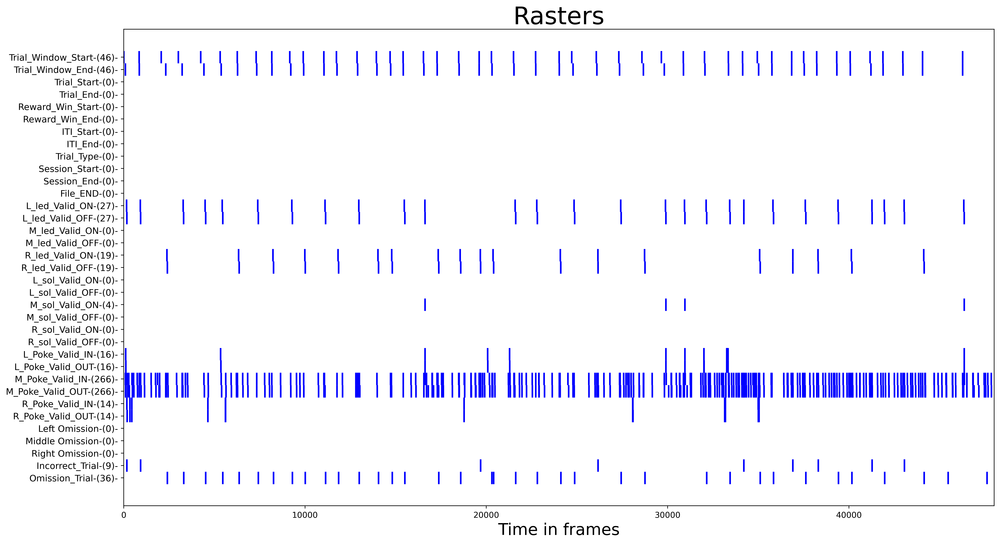

In [26]:
      
#################  raster for Events
# calling the label
#list(Event_Count_TimeStamps.keys())[3]


# calling the timestamps within label 
#Event_Count_TimeStamps[list(Event_Count_TimeStamps.keys())[3]][1]

# same ylabel as previous figure on timestamp count 
ylabel = []
for i in range(len(Event_Count)):
    ylabel.append(str(list(Event_Count.keys())[i]) + '-(' + str(list(Event_Count.values())[i]) + ')-')

#xlabel = np.arange(int(max(Selected_Data['timestamp']))+ 2)   #  use last timestamp from SelectedData
#xlabel = np.arange(int(Selected_Data['timestamp'][len(Selected_Data)-1])+ 2)   #  use last timestamp from SelectedData
xlabel = np.arange(0, len(df)+10)

fig, b = plt.subplots(figsize =(19.2, 10.8), dpi = 400.0)
#  turn timestamp into traces 
for i in range(len(Event_Count_TimeStamps)):                
    for ii in range(len(Event_Count_TimeStamps[list(Event_Count_TimeStamps.keys())[i]])):
        #if(str(Event_Count_TimeStamps[list(Event_Count_TimeStamps.keys())[i]][ii]).isnumeric()):  #  do not plot 'NAN', only plot if it is a number
        if((str(Event_Count_TimeStamps[list(Event_Count_TimeStamps.keys())[i]][ii]).replace('[', '')).replace(']', '').isnumeric()):  #  do not plot 'NAN', only plot if it is a number
            #t_stamp = (str(Event_Count_TimeStamps[list(Event_Count_TimeStamps.keys())[i]][ii]).replace('[', '')).replace(']', '')
            t_stamp = int((str(Event_Count_TimeStamps[list(Event_Count_TimeStamps.keys())[i]][ii]).replace('[', '')).replace(']', ''))
            b.vlines(x= t_stamp, ymin=(i-1)+0.5, ymax=(i)+0.5, colors='blue', lw=2, label='vline_single - partial height')
            
b.invert_yaxis()  # labels read top-to-bottom    
b.set_yticks(np.arange(len((Event_Count.keys()))))
b.set_yticklabels(ylabel, size = 11)
#b.set_xticks(xlabel)
#b.set_xticklabels(xlabel, size = 20)
b.set_xlabel('Time in frames', size = 20)
b.set_title('Rasters', size = 30)
#filename = 'Rasters-COM-' + ''.join(file_info['Box Number']).replace(' ', '') + '-' + ''.join(file_info['Paradigm']).replace(' ', '')  + \
#'-'+ ((Timelist[currentblock]).replace(':', '_')).replace('/', '_') + '.png'
plt.xlim([0, len(df)+10])
plt.show()

#savefilename = os.path.join(Save_Path, filename)
#fig.savefig(savefilename)


In [27]:
Event_Count = Original_Event_Count.copy()
Event_Count_TimeStamps = Original_Event_Count_TimeStamps.copy()

In [28]:
# Remove Specific Trials 
# Crop out the first Trial Initiation timestamp (necessary, when the pre-cue baseline period is very long)
# Crop out the last Trial Initiation timestamp (necessary, when the post period is very long)
# Crop out some middle Trial Initiation timestamp (necessary, when response has zero latency)



#Remove_trials = [0]  # any trials listed here gets remove (Trial starts at zero)
#Remove_trials = [0,18]  # any trials listed here gets remove (Trial starts at zero)


    
if(len(Remove_trials) > 0):
    
    Event_Count = Original_Event_Count.copy()
    Event_Count_TimeStamps = Original_Event_Count_TimeStamps.copy()
    
    #############################  'Trial_Window_End' #######################
    if 'Trial_Window_End' in Event_Count_TimeStamps: del Event_Count_TimeStamps['Trial_Window_End']
    for i in range(len(Original_Event_Count_TimeStamps['Trial_Window_End'])):
        if(Remove_trials.count(i)== 0):  #. appends data if the trial # is not on the "Remove_trials list "
            Event_Count_TimeStamps['Trial_Window_End'].append(Original_Event_Count_TimeStamps['Trial_Window_End'][i]) 
        else:
            Event_Count['Trial_Window_End']= Event_Count['Trial_Window_End']-1
            print('\n' + 'Trial_Window_End:  ' + 'Removed Trial(s):'+ str(i) + ' : ' + str([Original_Event_Count_TimeStamps['Trial_Window_End'][i]]))

     #############################  'Trial_Window_Start' #######################
    if 'Trial_Window_Start' in Event_Count_TimeStamps: del Event_Count_TimeStamps['Trial_Window_Start']
    for i in range(len(Original_Event_Count_TimeStamps['Trial_Window_Start'])):
        if(Remove_trials.count(i)== 0):  #. appends data if the trial # is not on the "Remove_trials list "
            Event_Count_TimeStamps['Trial_Window_Start'].append(Original_Event_Count_TimeStamps['Trial_Window_Start'][i]) 
        else:
            Event_Count['Trial_Window_Start']= Event_Count['Trial_Window_Start']-1
            print('\n' + 'Trial_Window_Start:  ' +'Removed Trial(s):' + str(i) + ' : ' + str([Original_Event_Count_TimeStamps['Trial_Window_Start'][i]]))       
            
            
print('\n')
print(Original_Event_Count['Trial_Window_End'])
print(Original_Event_Count_TimeStamps['Trial_Window_End'])
print('\n')
print(Event_Count['Trial_Window_End'])
print(Event_Count_TimeStamps['Trial_Window_End'])

print('\n')
print(len(Original_Event_Count_TimeStamps['Trial_Window_Start']))
print(len(Event_Count_TimeStamps['Trial_Window_Start']))




Trial_Window_End:  Removed Trial(s):0 : [[91]]

Trial_Window_Start:  Removed Trial(s):0 : [[1]]


46
[[91], [855], [2317], [3216], [4424], [5372], [6272], [7332], [8168], [9208], [9923], [11039], [11758], [12899], [13960], [14717], [15415], [16551], [17283], [18494], [19605], [20308], [21524], [22720], [24019], [24776], [26091], [27346], [28661], [29815], [30867], [32059], [33355], [34138], [35013], [35748], [36842], [37531], [38227], [39332], [40073], [41209], [41882], [42980], [44061], [46272]]


45
[[855], [2317], [3216], [4424], [5372], [6272], [7332], [8168], [9208], [9923], [11039], [11758], [12899], [13960], [14717], [15415], [16551], [17283], [18494], [19605], [20308], [21524], [22720], [24019], [24776], [26091], [27346], [28661], [29815], [30867], [32059], [33355], [34138], [35013], [35748], [36842], [37531], [38227], [39332], [40073], [41209], [41882], [42980], [44061], [46272]]


46
45


In [29]:
print(Event_Count_TimeStamps['L_led_Valid_ON'])
print(Event_Count_TimeStamps['R_led_Valid_ON'])

[[151], [915], [3276], [4484], [5432], [7392], [9268], [11099], [12959], [15475], [16611], [21584], [22780], [24836], [27406], [29875], [30927], [32119], [33415], [34198], [35808], [37591], [39392], [41269], [41942], [43040], [46332]]
[[2377], [6332], [8228], [9983], [11818], [14020], [14777], [17343], [18554], [19665], [20368], [24079], [26151], [28721], [35073], [36902], [38287], [40133], [44121]]


In [30]:

# # Delete me later
# print((Event_Count))

# print('\n')

print((Event_Count_TimeStamps.keys()))


dict_keys(['Trial_Start', 'Trial_End', 'Reward_Win_Start', 'Reward_Win_End', 'ITI_Start', 'ITI_End', 'Trial_Type', 'Session_Start', 'Session_End', 'File_END', 'L_led_Valid_ON', 'L_led_Valid_OFF', 'M_led_Valid_ON', 'M_led_Valid_OFF', 'R_led_Valid_ON', 'R_led_Valid_OFF', 'L_sol_Valid_ON', 'L_sol_Valid_OFF', 'M_sol_Valid_ON', 'M_sol_Valid_OFF', 'R_sol_Valid_ON', 'R_sol_Valid_OFF', 'L_Poke_Valid_IN', 'L_Poke_Valid_OUT', 'M_Poke_Valid_IN', 'M_Poke_Valid_OUT', 'R_Poke_Valid_IN', 'R_Poke_Valid_OUT', 'Left Omission', 'Middle Omission', 'Right Omission', 'Incorrect_Trial', 'Omission_Trial', 'Trial_Window_End', 'Trial_Window_Start'])


In [31]:
#. Create Timestamps by copying other timestamps

#Reward_Win_Begining
NewTimeStampLabel = 'Reward_Win_Begining'
TimeStampsToCopy = 'M_sol_Valid_ON'
Event_Count_TimeStamps[NewTimeStampLabel] = Event_Count_TimeStamps[TimeStampsToCopy]
Event_Count[NewTimeStampLabel] = Event_Count[TimeStampsToCopy]  # add one  to count num of events

#Pre_Trial_Baseline_End
NewTimeStampLabel = 'Pre_Trial_Baseline_End'
TimeStampsToCopy = 'Trial_Window_Start'
Event_Count_TimeStamps[NewTimeStampLabel] = Event_Count_TimeStamps[TimeStampsToCopy]
Event_Count[NewTimeStampLabel] = Event_Count[TimeStampsToCopy]  # add one  to count num of events



#######################################################
# Create Timestamps by shifting other timestamps (Part I)

#Reward_Win_Ending
NewTimeStampLabel = 'Reward_Win_Ending'
TimeStampsToShift = 'Reward_Win_Begining'
Shift_Duration = 3*20
temp=[[]]*Event_Count[TimeStampsToShift]
for i in range(Event_Count[TimeStampsToShift]):
    tempa = Event_Count_TimeStamps[TimeStampsToShift][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = tempa +Shift_Duration
    temp[i]= [tempb]
Event_Count_TimeStamps.update({NewTimeStampLabel : temp })
Event_Count[NewTimeStampLabel] = Event_Count[TimeStampsToShift]
    
#Pre_Trial_Baseline_Start
NewTimeStampLabel = 'Pre_Trial_Baseline_Start'
TimeStampsToShift = 'Pre_Trial_Baseline_End'
Shift_Duration = -6*20   # 6 seconds of pre-trial baseline
#Shift_Duration = -20*20   # 20 seconds of pre-trial baseline
temp=[[]]*Event_Count[TimeStampsToShift]
for i in range(Event_Count[TimeStampsToShift]):
    tempa = Event_Count_TimeStamps[TimeStampsToShift][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = tempa +Shift_Duration
    temp[i]= [tempb]
Event_Count_TimeStamps.update({NewTimeStampLabel : temp })
Event_Count[NewTimeStampLabel] = Event_Count[TimeStampsToShift]





In [32]:
#  Create Traces for Trial_Window_Available_Trace, Left_IR_Trace,  Middle_IR_Trace,  Right_IR_Trace,  ALL_IR_Trace 

#Trial_Window_Available_Trace
Reference_Begin = 'Trial_Window_Start'
Reference_End = 'Trial_Window_End'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Trial_Window_Available_Trace = np.asarray( [0]*signal_Length)

#Check to make sure # of begin and end timestamps are same
if(Event_Count[Reference_Begin] > Event_Count[Reference_End]):
    Event_Count[Reference_Begin] = Event_Count[Reference_Begin] -1    #remove excess timestamp, happens when trial gets interrupted by session end 
for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    Trial_Window_Available_Trace[tempa:tempb] = [1]
    
#Left_IR_Trace   
Reference_Begin = 'L_Poke_Valid_IN'
Reference_End = 'L_Poke_Valid_OUT'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Left_IR_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]-1):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i+0]
    tempb = int(tempb[0])   # Convert to Integer
    Left_IR_Trace[tempa:tempb] = [1]

#Middle_IR_Trace
Reference_Begin = 'M_Poke_Valid_IN'
Reference_End = 'M_Poke_Valid_OUT'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Middle_IR_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]-1):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i+0]
    tempb = int(tempb[0])   # Convert to Integer
    Middle_IR_Trace[tempa:tempb] = [1]

#Right_IR_Trace
Reference_Begin = 'R_Poke_Valid_IN'
Reference_End = 'R_Poke_Valid_OUT'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Right_IR_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]-1):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i+0]
    tempb = int(tempb[0])   # Convert to Integer
    Right_IR_Trace[tempa:tempb] = [1]

#Middle_SOL_Trace
Reference_Begin = 'M_sol_Valid_ON'
# Reference_End = 'M_sol_Valid_OFF'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Middle_SOL_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_Begin][i]
    tempb = int(tempb[0])+20      # Convert to Integer,  20 bins is 1 second for visualization purpose
    Middle_SOL_Trace[tempa:tempb] = [1]
    
    
    
#ALL_IR_Trace
Reference_Begin = 'L_Poke_Valid_IN'
Reference_End = 'L_Poke_Valid_OUT'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
ALL_IR_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]-1):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i+0]
    tempb = int(tempb[0])   # Convert to Integer
    ALL_IR_Trace[tempa:tempb] = [1]
    
Reference_Begin = 'M_Poke_Valid_IN'
Reference_End = 'M_Poke_Valid_OUT'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
#ALL_IR_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]-1):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i+0]
    tempb = int(tempb[0])   # Convert to Integer
    ALL_IR_Trace[tempa:tempb] = [1]

Reference_Begin = 'R_Poke_Valid_IN'
Reference_End = 'R_Poke_Valid_OUT'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
#ALL_IR_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]-1):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i+0]
    tempb = int(tempb[0])   # Convert to Integer
    ALL_IR_Trace[tempa:tempb] = [1]

       
        
#Left_LED_Trace   
Reference_Begin = 'L_led_Valid_ON'
Reference_End = 'L_led_Valid_ON'   #. OFF TimeStamp missing , so added 1 second duration for visualization purpose 
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Left_LED_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    #Left_LED_Trace[tempa:(tempb+ 2)] = [1]   #. OFF TimeStamp missing , so added 0.1 second (which is 2 frames) duration for visualization purpose 
    Left_LED_Trace[tempa:(tempb+ 20)] = [1]   #. OFF TimeStamp missing , so added 1 second (which is 2 frames) duration for visualization purpose
    
#Right_LED_Trace   
Reference_Begin = 'R_led_Valid_ON'
Reference_End = 'R_led_Valid_ON'   #. OFF TimeStamp missing , so added 1 second duration for visualization purpose 
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Right_LED_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    #Right_LED_Trace[tempa:(tempb+ 2)] = [1]   #. OFF TimeStamp missing , so added 0.1 second (which is 2 frames) duration for visualization purpose 
    Right_LED_Trace[tempa:(tempb+ 20)] = [1]   #. OFF TimeStamp missing , so added 1 second (which is 2 frames) duration for visualization purpose


    
    
####### All LED Trace
        
#Left_LED_Trace   
Reference_Begin = 'L_led_Valid_ON'
Reference_End = 'L_led_Valid_ON'   #. OFF TimeStamp missing , so added 1 second duration for visualization purpose 
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
All_LED_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    #Left_LED_Trace[tempa:(tempb+ 2)] = [1]   #. OFF TimeStamp missing , so added 0.1 second (which is 2 frames) duration for visualization purpose 
    All_LED_Trace[tempa:(tempb+ 30)] = [1]   #. OFF TimeStamp missing , so added 1 second (which is 2 frames) duration for visualization purpose
    
#Right_LED_Trace   
Reference_Begin = 'R_led_Valid_ON'
Reference_End = 'R_led_Valid_ON'   #. OFF TimeStamp missing , so added 1 second duration for visualization purpose 
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
# All_LED_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    #Right_LED_Trace[tempa:(tempb+ 2)] = [1]   #. OFF TimeStamp missing , so added 0.1 second (which is 2 frames) duration for visualization purpose 
    All_LED_Trace[tempa:(tempb+ 30)] = [1]   #. OFF TimeStamp missing , so added 1 second (which is 2 frames) duration for visualization purpose

    
############    
    
    
    
# Reward_Window_Trace
Window_Begin = 'M_sol_Valid_ON'
Window_End_Offset = 3*20     #  20 frames per second, reward windows last for 3 seconds after reward delivery
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Reward_Window_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Window_Begin]):
    tempa = Event_Count_TimeStamps[Window_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Window_Begin][i]
    tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
    Reward_Window_Trace[tempa:tempb] = [1]

    
        
#Pre_Trial_Baseline
Reference_Begin = 'Pre_Trial_Baseline_Start'
Reference_End = 'Pre_Trial_Baseline_End'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Pre_Trial_Baseline_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    Pre_Trial_Baseline_Trace[tempa:tempb] = [1]
    
    
    
# Convert dictionary to pandas data frame 
temp = SignalTraces_pd.DataFrame(Trial_Window_Available_Trace)
Trial_Window_Available_Trace_panda = temp.squeeze()  ################    Trial_Window_Available_Trace_panda
df['Trial_Window_Available_Trace_panda']  = Trial_Window_Available_Trace_panda  # add this back to existing dataframe 


temp = SignalTraces_pd.DataFrame(Left_IR_Trace)
Left_IR_Traces_panda = temp.squeeze()               #################     Left_IR_Traces_panda
df['Left_IR_Traces_panda']  = Left_IR_Traces_panda  # add this back to existing dataframe


temp = SignalTraces_pd.DataFrame(Middle_IR_Trace)
Middle_IR_Traces_panda = temp.squeeze()             #################     Middle_IR_Traces_panda
df['Middle_IR_Traces_panda']  = Middle_IR_Traces_panda  # add this back to existing dataframe

temp = SignalTraces_pd.DataFrame(Right_IR_Trace)
Right_IR_Traces_panda = temp.squeeze()              #################     Right_IR_Traces_panda
df['Right_IR_Traces_panda']  = Right_IR_Traces_panda  # add this back to existing dataframe

temp = SignalTraces_pd.DataFrame(ALL_IR_Trace)
ALL_IR_Traces_panda = temp.squeeze()                #################      ALL_IR_Traces_panda
df['ALL_IR_Traces_panda']  = ALL_IR_Traces_panda  # add this back to existing dataframe

temp = SignalTraces_pd.DataFrame(Middle_SOL_Trace)
Middle_SOL_Trace_panda = temp.squeeze()              #################     Middle_SOL_Trace_panda
df['Middle_SOL_Trace_panda']  = Middle_SOL_Trace_panda  # add this back to existing dataframe

temp = SignalTraces_pd.DataFrame(Left_LED_Trace)
Left_LED_Traces_panda = temp.squeeze()               #################     Left_LED_Traces_panda
df['Left_LED_Traces_panda']  = Left_LED_Traces_panda  # add this back to existing dataframe

temp = SignalTraces_pd.DataFrame(Right_LED_Trace)
Right_LED_Traces_panda = temp.squeeze()               #################     Left_LED_Traces_panda
df['Right_LED_Traces_panda']  = Right_LED_Traces_panda  # add this back to existing dataframe


temp = SignalTraces_pd.DataFrame(All_LED_Trace)
All_LED_Traces_panda = temp.squeeze()               #################     Left_LED_Traces_panda
df['All_LED_Traces_panda']  = All_LED_Traces_panda  # add this back to existing dataframe



temp = SignalTraces_pd.DataFrame(Reward_Window_Trace)
Reward_Window_Trace_panda = temp.squeeze()                #################      Reward_Window_Trace_panda
df['Reward_Window_Trace_panda']  = Reward_Window_Trace_panda  # add this back to existing dataframe

temp = SignalTraces_pd.DataFrame(Pre_Trial_Baseline_Trace)
Pre_Trial_Baseline_Trace_panda = temp.squeeze()                #################      Reward_Window_Trace_panda
df['Pre_Trial_Baseline_Trace_panda']  = Pre_Trial_Baseline_Trace_panda  # add this back to existing dataframe


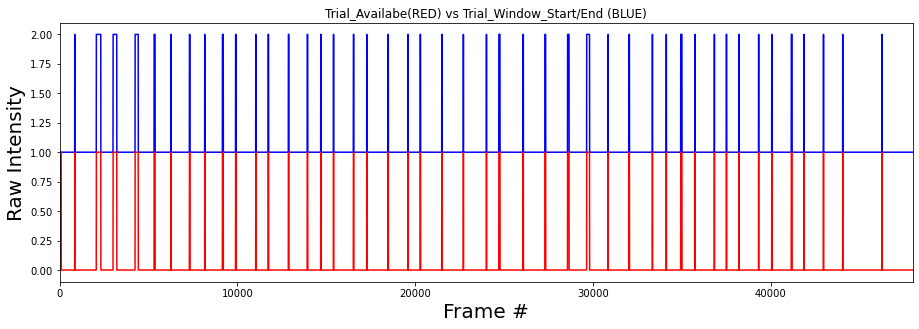

In [33]:
#  Verify extracted timestamp match up with sgianl 
#(so "Trial_Window" (timestamp) should be equal to "Trial_Available" (trace))

#plt_Check_Alighnment.plot(x_axis,(Trial_Window_Available_Trace_panda +1)) 
plt_Check_Alighnment.plot(df['Trial_Window_Available_Trace_panda']+1, color ='b')   # Trial Avalable Trace
plt_Check_Alighnment.plot(df['Trial_available'], color ='r')   # Trial Avalable Trace

plt_Check_Alighnment.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_Check_Alighnment.ylabel('Raw Intensity', size = 20)
plt_Check_Alighnment.xlabel('Frame #', size = 20)
plt_Check_Alighnment.title(('Trial_Availabe(RED) vs Trial_Window_Start/End (BLUE)'), fontdict=None, loc='center')
plt_trial.xlim(0, len(df))
#plt_Check_Alighnment.xlim(2310, 2360)  #Example Trial
#plt_Check_Alighnment.ylim(0, 3.5)  #Example Trial

plt_Check_Alighnment.show()

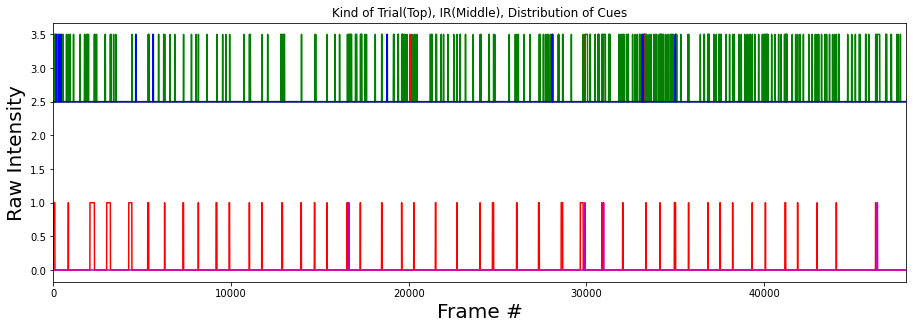

In [34]:
# Plot TimeStamps (Events)

plt_trial.plot(df['Trial_available'], color ='r')
#plt_trial.plot(df['trial'], color ='b')
#plt_trial.plot(df['reward_received'], color ='g')
plt_trial.plot(df['Middle_SOL_Trace_panda'], color ='m')

plt_trial.plot(df['Left_IR_Traces_panda']+2.5, color ='r')
plt_trial.plot(df['Middle_IR_Traces_panda']+2.5, color ='g')
plt_trial.plot(df['Right_IR_Traces_panda']+2.5, color ='b')


# plt_trial.plot((df['correct_trial'] +4.5), color ='g')
# plt_trial.plot((df['incorrect_trial'] + 4.5), color ='r')
# plt_trial.plot((df['omitted']+4.5), color ='b')


plt_trial.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_trial.ylabel('Raw Intensity', size = 20)
plt_trial.xlabel('Frame #', size = 20)
plt_trial.title(('Kind of Trial(Top), IR(Middle), Distribution of Cues'), fontdict=None, loc='center')

plt_trial.xlim(0, len(df))
#plt_trial.xlim(2300, 2400)  #Example Trial
#plt_trial.xlim(5000, 7000)  #Example Trial
plt_trial.show()

In [35]:
# print(df['Left_IR_Traces_panda'])

0


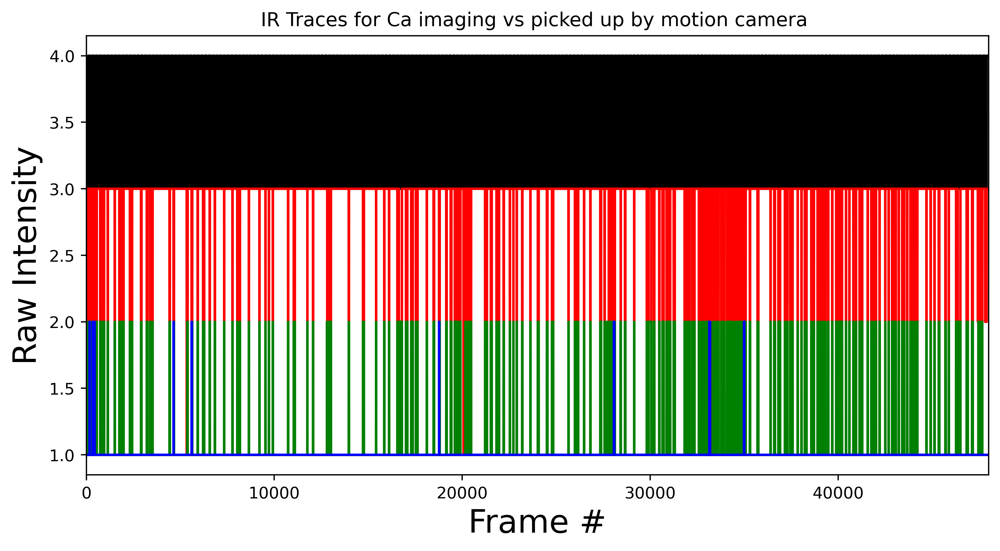

In [36]:
if (Motion_data == 1):    
    
    # ############################################
    # # Optional for Motion data

    #Manual_Shift = -22 +26  #. Additional shifting within the 5 second pulse (necessary to perform manually bc of poential electrical noise in the begining)
    Manual_Shift = 0 #. Additional shifting within the 5 second pulse (necessary to perform manually bc of poential electrical noise in the begining)

    ###############################################

    if (Motion_data == 1):  #. Running Motion Data from over-head camera is optional. 

        # Motion_File_Name = 'Aligned-Ka-DS2-P5_5-S10-Sucrose_Motion.csv'   # phase III, go no go
        # Temp_Motion_df = Motion_pd.read_csv((File_Path+'/'+ Motion_File_Name), low_memory=False)
        # print(Temp_Motion_df)

        # Find Imaging Onset Time in frames using ALL_IR_Traces_panda
    #     temp = df.ALL_IR_Traces_panda.values.tolist()
    #     res = list(filter(lambda i: i > 0.5, temp))[0]
    #     Image_Onset =  temp.index(res)


        # #. add rows to all columns, then shift Motion_video based on ImageOnset
        #Shift = Image_Onset+ Manual_Shift #. 20 is added manually in addition to the shift detected by the computer.  
        Shift = Manual_Shift +0 #. 20 is added manually in addition to the shift detected by the computer.
        print(Shift)
        df2 = pd.DataFrame(index=range(Shift),columns=Temp_Motion_df.columns)
        df3 = Temp_Motion_df.append(df2, ignore_index=True)      #. add rows to all columns before shifting 

        Shifted_Motion_df = df3.shift(Shift, axis = 0, fill_value=0)

        df['Video_Motion_Trace_panda']  = Shifted_Motion_df['Motion']
        df['Video_Motion_Thresholded_Trace_panda']  = Shifted_Motion_df['Motion_Thresholded']
        df['Video_Motion_Thresholded_Binary_Trace_panda']  = Shifted_Motion_df['Motion_Thresholded_Binary']

        df['Video_Light1_Trace_panda']  = Shifted_Motion_df['Light_1']
        df['Video_Light2_Trace_panda']  = Shifted_Motion_df['Light_2']
        df['Video_Light3_Trace_panda']  = Shifted_Motion_df['Light_3']

        # #. Optional,  IR Traces for Ca imaging vs picked up by motion camera 
        # # Plot TimeStamps (Events)
        fig = plt_trial.figure(figsize =(10, 5), dpi = 400.0)
        
        plt_trial.plot(-df['Video_Light2_Trace_panda']+4, color ='k')
        plt_trial.plot(-df['Video_Light3_Trace_panda']+3, color ='r')

        plt_trial.plot(df['Left_IR_Traces_panda']+1, color ='r')
        plt_trial.plot(df['Middle_IR_Traces_panda']+1, color ='g')
        plt_trial.plot(df['Right_IR_Traces_panda']+1, color ='b')

        #plt_trial.vlines(x= Image_Onset, ymin=1, ymax=2, colors='c', lw=5)

        #.  Plot non offset data before they get adjusted
        # plt_trial.plot(-Temp_Motion_df['Light_2']+9, color ='k')
        # plt_trial.plot(-Temp_Motion_df['Light_3']+8, color ='r')

        #plt_trial.subplots_adjust(bottom=0.1, right=2.1, top=1)
        plt_trial.ylabel('Raw Intensity', size = 20)
        plt_trial.xlabel('Frame #', size = 20)
        plt_trial.title(('IR Traces for Ca imaging vs picked up by motion camera '), fontdict=None, loc='center')

        #plt_trial.xlim(0, 800)  #Example Trial  All TimeStamp
        plt_trial.xlim(0, 48000)  #Example Trial  All TimeStamp
        #plt_trial.xlim(350, 390)  #Example Trial  First TimeStamp (0 shift)
        #plt_trial.xlim(5000, 5500)  #Example Trial  First TimeStamp (0 shift)
        #plt_trial.xlim(10000, 10500)  #Example Trial  First TimeStamp (0 shift)
        #plt_trial.xlim(20000, 20500)  #Example Trial  middle TimeStamp
        #plt_trial.xlim(29000, 30000)  #Example Trial  middle TimeStamp
        #plt_trial.xlim(30000, 40000)  #Example Trial  middle TimeStamp
        #plt_trial.xlim(44000, 44500)  #Example Trial  Second Last TimeStamp  (+4 manual shift)
        #plt_trial.xlim(45000, 48000)  #Example Trial  Last TimeStamp
        #plt_trial.show()
        
        filename =  File_Name.split(".")[0] +'_'+ 'Motion_Alightment_Check' + '.jpg'
        savefilename = os.path.join(Save_Path, filename)
        plt_raw.savefig(savefilename)
        
        
        plt_trial.show()



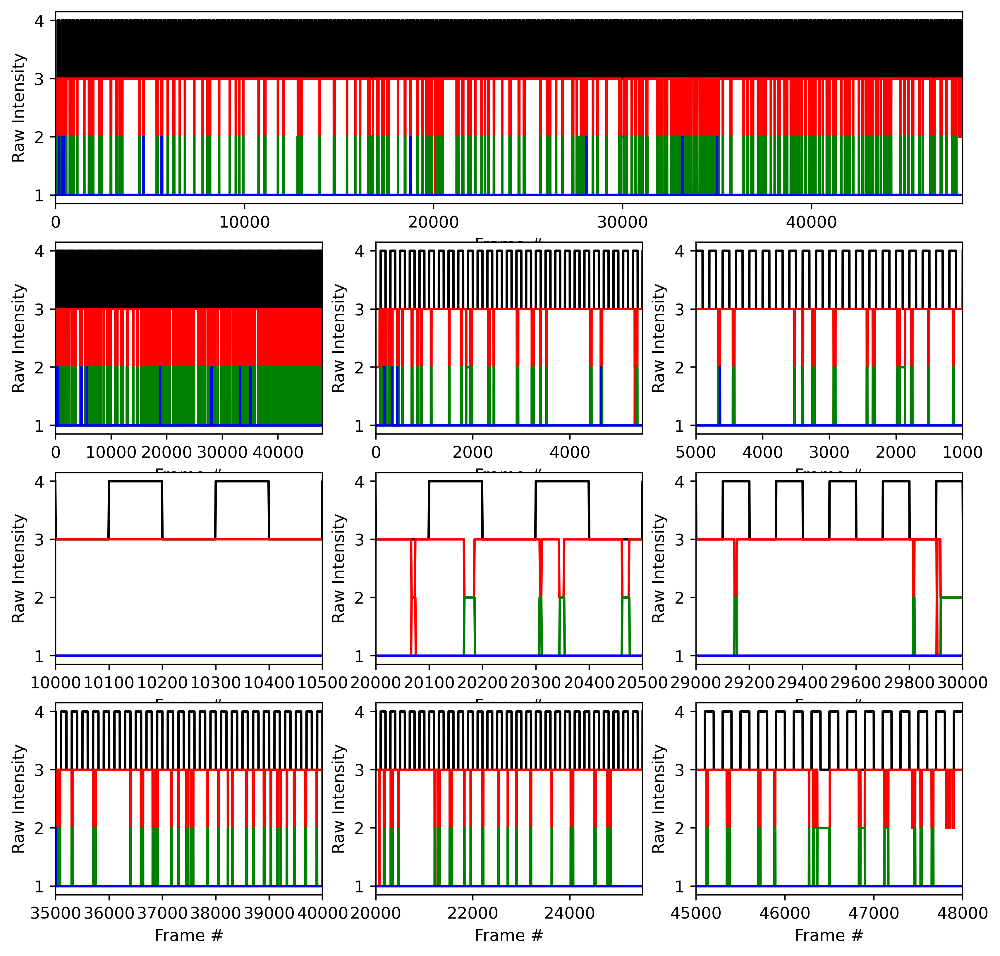

In [37]:
if (Motion_data == 1):
    fig = plt_trial.figure(figsize =(10, 10), dpi = 400.0)

    ax = fig.add_subplot(4,1 ,1)
            
    plt_trial.plot(-df['Video_Light2_Trace_panda']+4, color ='k')
    plt_trial.plot(-df['Video_Light3_Trace_panda']+3, color ='r')
    
    plt_trial.plot(df['Left_IR_Traces_panda']+1, color ='r')
    plt_trial.plot(df['Middle_IR_Traces_panda']+1, color ='g')
    plt_trial.plot(df['Right_IR_Traces_panda']+1, color ='b')
    

    
    #plt_trial.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_trial.ylabel('Raw Intensity', size = 10)
    plt_trial.xlabel('Frame #', size = 10)

    plt_trial.xlim(0, 48000)  #Example Trial  All TimeStamp

        ######################################################################################
    for i in range(1,10,1):
        ax = fig.add_subplot(4,3 ,i+3)
            
        plt_trial.plot(-df['Video_Light2_Trace_panda']+4, color ='k')
        plt_trial.plot(-df['Video_Light3_Trace_panda']+3, color ='r')
    
        plt_trial.plot(df['Left_IR_Traces_panda']+1, color ='r')
        plt_trial.plot(df['Middle_IR_Traces_panda']+1, color ='g')
        plt_trial.plot(df['Right_IR_Traces_panda']+1, color ='b')
    

    
        #plt_trial.subplots_adjust(bottom=0.1, right=2.1, top=1)
        plt_trial.ylabel('Raw Intensity', size = 10)
        plt_trial.xlabel('Frame #', size = 10)
        #plt_trial.title(('IR Traces for Ca imaging vs picked up by motion camera '), fontdict=None, loc='center')
    
        #plt_trial.xlim(0, 800)  #Example Trial  All TimeStamp
        if(i== 1):
            plt_trial.xlim(0, 48000)  #Example Trial  All TimeStamp
        elif(i ==2):
            plt_trial.xlim(0, 5500)  #Example Trial  First TimeStamp (0 shift)
        elif(i ==3):
            plt_trial.xlim(5000, 1000)  #Example Trial  First TimeStamp (0 shift)
        elif(i ==4):
            plt_trial.xlim(10000, 10500)  #Example Trial  First TimeStamp (0 shift)
        elif(i==5):
            plt_trial.xlim(20000, 20500)  #Example Trial  middle TimeStamp
        elif(i ==8):
            plt_trial.xlim(20000, 25500)  #Example Trial  First TimeStamp (0 shift)
        elif(i==6):
            plt_trial.xlim(29000, 30000)  #Example Trial  middle TimeStamp
        elif(i==7):
            plt_trial.xlim(35000, 40000)  #Example Trial  middle TimeStamp
        elif(i==9):
            plt_trial.xlim(45000, 48000)  #Example Trial  Last TimeStamp

        
    filename =  File_Name.split(".")[0] +'_'+ 'Motion_Alightment_Check' + '.jpg'
    savefilename = os.path.join(Save_Path, filename)
    plt_trial.savefig(savefilename)
    
    
    plt_trial.show()

    

In [38]:
if (Motion_data == 1):
    
    # ############################################
    # # Optional for Motion data
    # Bin data to 1 second bins


    Motion_Bin = 20  # Bin size            #(60 seonds *20 frames per second)     
    #Motion_Bin = 1200  # Bin size            #(60 seonds *20 frames per second)                             
    Bin_Motion_Data_df = pd.DataFrame()
    Mean_Bin_Motion_Data_df = pd.DataFrame()
    Check_Motion_Data_df = pd.DataFrame()

    print(Shifted_Motion_df.keys()[0:8])   #. ['Motion', 'Light_1', 'Light_2', 'Light_3', 'Motion_Thresholded']

    for x in range(8):                      

        #  Input data 
        temp = Shifted_Motion_df.loc[0:len(Shifted_Motion_df), Shifted_Motion_df.keys()[x]]
        temp_df = pd.DataFrame(temp)
        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Motion_Bin+1,1),Motion_Bin)
        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Motion_Bin+1, len(temp)%Motion_Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[Shifted_Motion_df.keys()[x]].sum()).tolist()
        Bin_Motion_Data_df[Shifted_Motion_df.keys()[x]] = Temp_Bin_Data


        ######. This is for manual checking 
        Check_Motion_Data_df['ax']= temp_df['ax']
        Check_Motion_Data_df[Shifted_Motion_df.keys()[x]]= temp


    Trans_Bin_Data = np.transpose(Bin_Motion_Data_df.loc[0:len(Bin_Motion_Data_df), Shifted_Motion_df.keys()[0:5]])      #***********   Test

    Bin_Motion_Data_df.to_csv(os.path.join(Save_Path, 'Export_Binned_Motion.csv'))

    #print(Check_Data_df)
    #print(Bin_Data_df)
    #print(Trans_Bin_Data)

Index(['Motion', 'Light_1', 'Light_2', 'Light_3',
       'original_video_coor, cropped_video_coor, cropped_video_area,  x0, x1, y0, y1 (crop coordinate)',
       'Bin', 'Motion_Thresholded', 'Motion_Thresholded_Binary'],
      dtype='object')


In [39]:
if (Motion_data == 1):
    
    #. Export Binned Data for calcium events 

    Bin = 20  # Bin size            #(60 seonds *20 frames per second)     
    #Bin = 1200  # Bin size            #(60 seonds *20 frames per second)                             
    Bin_Data_Binary_df = pd.DataFrame()
    Bin_Data_ReScaled_df = pd.DataFrame()
    Mean_Bin_Data_df = pd.DataFrame()
    Check_Data_df = pd.DataFrame()

    for x in range(NumofCell_raw):                      
    #for x in range(5):                                          # ******* test

        #  Input data 
        #*******************************Change this for signal type(ReScaled, Binary)
        temp = Binary.loc[0:len(Binary), CellList_deconv[x]]        
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)

        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[CellList_deconv[x]].sum()).tolist()
        Bin_Data_Binary_df[CellList_deconv[x]] = Temp_Bin_Data


        #*******************************Change this for signal type(ReScaled, Binary)     
        temp = ReScaled.loc[0:len(ReScaled), CellList_raw[x]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)

        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[CellList_raw[x]].sum()).tolist()
        Bin_Data_ReScaled_df[CellList_raw[x]] = Temp_Bin_Data




    #     ######. This is for manual checking 
    #     Check_Data_df['ax']= temp_df['ax']
    #     Check_Data_df[CellList_raw[x]]= temp

    Trans_Bin_Data_Binary = np.transpose(Bin_Data_Binary_df.loc[0:len(Bin_Data_Binary_df), CellList_deconv])
    Trans_Bin_Data_ReScaled = np.transpose(Bin_Data_ReScaled_df.loc[0:len(Bin_Data_ReScaled_df), CellList_raw])

    # Trans_Bin_Data = np.transpose(Bin_Data_df.loc[0:len(Bin_Data_df), CellList_raw])      #***********   Test

    # Bin_Data_df.to_csv(os.path.join(Save_Path, 'Export_Binned_Traces.csv'))

    #print(Check_Data_df)
    #print(Bin_Data_df)
    #print(Trans_Bin_Data)

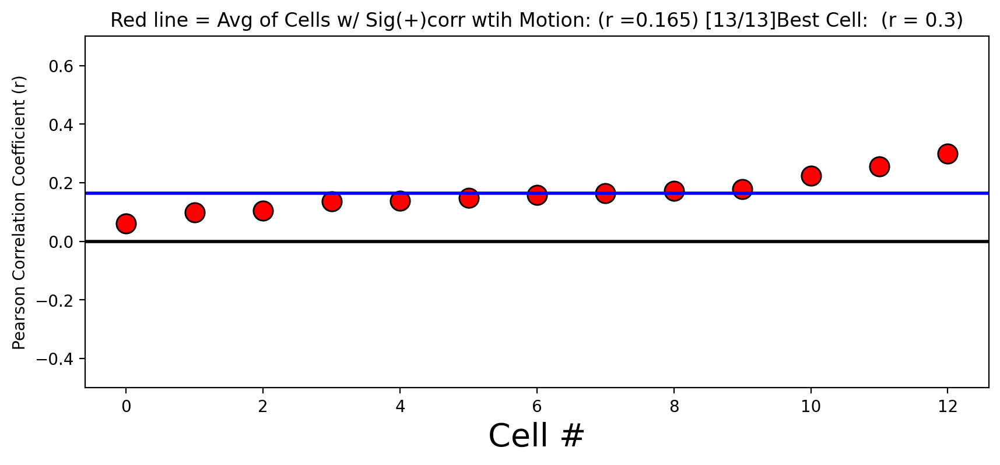

Motion Bin:  20
Cell Bin:  20


In [40]:
if (Motion_data == 1):    
    ###########################################
    #  Whole Session correlation to compare each cell with motion trace
    #####################################################################################################
    #. Re-order cell list to asending orders of pearsons correlation coefficient (row 1) or p-value (row 2)

    order_setting = 1   #. 1 for organizing by perason's correlation coefficient (r)

    #######################
    All_Correlation_sum = 0   # for calculating the average correlation of all cells regarldess significance 
    Sig_Correlation_sum = 0   # for calculating the average correlation of only signfiicantly positive cells 

    Sig_P_value_count = 0
    Non_Sig_P_value_count = 0

    Cell_Pearson_Correlation =  defaultdict(list)

    for ii in range(NumofCell_raw):

        #Signal_One_Ref = Bin_Data_ReScaled_df[CellList_raw[ii]][0: len(Bin_Data_ReScaled_df)] 
        
        Signal_One_Ref = Bin_Data_Binary_df[CellList_deconv[ii]][0: len(Bin_Data_Binary_df)]     #. 3,4,14, 18
        Signal_Two = Bin_Motion_Data_df['Motion_Thresholded'][0: len(Bin_Data_Binary_df)]

        Pearson_r, p_value = scipy.stats.pearsonr(Signal_One_Ref, Signal_Two)


        Cell_Pearson_Correlation[CellList_raw[ii]].append(Pearson_r)
        Cell_Pearson_Correlation[CellList_raw[ii]].append(p_value)


        All_Correlation_sum= All_Correlation_sum + Pearson_r

        # only for significant and postively correlated (w/ behavior) cells.  
        if((p_value < 0.05)& (Pearson_r > 0)):
            Sig_P_value_count = Sig_P_value_count+1
            Sig_Correlation_sum= Sig_Correlation_sum + Pearson_r
        else:
            Non_Sig_P_value_count = Non_Sig_P_value_count+1



    ReOrdered_Cell_Pearson_Correlation = dict(sorted(Cell_Pearson_Correlation.items(), key=lambda item: item[order_setting]))

    CellList_ReOrdered = list(ReOrdered_Cell_Pearson_Correlation.keys())

    Cell_Pearson_Correlation['Avg_Correlation_All'].append(All_Correlation_sum/NumofCell_raw) #average correlation of all cells regarldess significance 

    if(Sig_P_value_count>0):
        Cell_Pearson_Correlation['Avg_Correlation_Sig'].append(Sig_Correlation_sum/Sig_P_value_count) #average correlation of only signfiicant cells 
    else:
        Cell_Pearson_Correlation['Avg_Correlation_Sig'].append(0) #No significant cells, not correlated   
    #######################################################################################
    # Plotting 

    fig = plt_raw.figure(figsize =(10, 4), dpi = 200.0)
    x_values = list(range(0,NumofCell_deconv))


    y_Correlation =[]
    y_P_value =[]

    for ii in range(NumofCell_deconv):

        y_Correlation.append(Cell_Pearson_Correlation[CellList_ReOrdered[ii]][0])  # Asending order
        y_P_value.append(Cell_Pearson_Correlation[CellList_ReOrdered[ii]][1])  # Asending order

    for ii in range(NumofCell_deconv): 
        if(y_P_value[ii]<0.05):   #color code based on significance
            plt_raw.plot(x_values[ii], y_Correlation[ii], color = 'red', marker='o', markerfacecolor='red', markeredgecolor='black' , markersize=12)
        else:
            plt_raw.plot(x_values[ii], y_Correlation[ii], color = 'grey', marker='o', markerfacecolor='grey' ,markeredgecolor='black', markersize=12)
    #plt_raw.axhline(y=Cell_Pearson_Correlation['Avg_Correlation_All'][0], c = 'pink', lw=2)
    plt_raw.axhline(y=Cell_Pearson_Correlation['Avg_Correlation_Sig'][0], c = 'blue', lw=2)

    plt_raw.axhline(y=0, c = 'black', lw=2)


    #plt_raw.legend(loc ="upper left", fontsize = 15)
    #plt_raw.subplots_adjust(bottom=0.1, right=2, top=2)
    plt_raw.ylabel('Pearson Correlation Coefficient (r)', size = 10)
    plt_raw.xlabel('Cell #', size = 20)
    plt_raw.title('Red line = Avg of Cells w/ Sig(+)corr wtih Motion: (r =' + str(round(Cell_Pearson_Correlation['Avg_Correlation_Sig'][0], 3)) + ') '
                  + '[' + str(Sig_P_value_count)  + '/'+ str(NumofCell_raw) +
                  ']' +  'Best Cell:  (r = '+ str(round(y_Correlation[NumofCell_deconv -1],3 )) + ')')
    #plt_raw.xlim(0,5)
    plt_raw.ylim(-0.5,0.7)


    filename =  File_Name.split(".")[0] +'_'+ 'Correlation_By_Cell' + '.jpg'
    savefilename = os.path.join(Save_Path, filename)
    plt_raw.savefig(savefilename)
    plt_raw.show()
    #plt_perievent_traces.close()


    # print(Cell_Pearson_Correlation['Avg_Correlation_All'][0] )
    # print(Cell_Pearson_Correlation['Avg_Correlation_Sig'][0])
    print('Motion Bin: ', Motion_Bin)
    print('Cell Bin: ', Bin)

In [41]:
# Filter timestamps, only include timestmaps ('c') that occured inside a window( A trace that was defined by two timestamps)
# window    = 0000000111110000111100000
# Timestamp = 0001000010000100010000000
# Result    = 0000000010000000010000000

# rewarded_received
Window_Begin = 'M_sol_Valid_ON'
Window_End_Offset = 3*20     #  20 frames per second, reward windows last for 3 seconds after reward delivery
TimeStampToFilter ='M_Poke_Valid_IN'    
Filter_Refractory = 3*20     # stop looking for timestamps for x time after detecting a timestamp 
LastTimeStampTime = 0 #  for counting refracty time of detecting events

Reward_Received_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[TimeStampToFilter]):
    for ii in range (Event_Count[Window_Begin]):
        tempa = Event_Count_TimeStamps[Window_Begin][ii]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][ii]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempc = Event_Count_TimeStamps[TimeStampToFilter][i]
        tempc = int(tempc[0])
        
        if ((tempa<= tempc <= tempb)  & ( (tempc-LastTimeStampTime) > Filter_Refractory)):
            Reward_Received_Trace[tempc] = 1
            LastTimeStampTime = tempc     
            
temp = SignalTraces_pd.DataFrame(Reward_Received_Trace)
Reward_Received_Trace_panda = temp.squeeze()                #################      Reward_Received_Trace_panda
df['Reward_Received_Trace_panda']  = Reward_Received_Trace_panda  # add this back to existing dataframe


# Reward_Trial_init_Window_End
Window_Begin_Offset = -10*20     #  20 frames per second, look for event 7s before reward window starts. 
Window_End =  'Reward_Win_Begining'   
TimeStampToFilter ='Trial_Window_End'    
LastTimeStampTime = 0 #  for counting refracty time of detecting events

Reward_Trial_init_Window_End = np.asarray( [0]*signal_Length)
for i in range(Event_Count[TimeStampToFilter]):
    for ii in range (Event_Count[Window_End]):

        tempa = Event_Count_TimeStamps[Window_End][ii]
        tempa = int(tempa[0]) + Window_Begin_Offset  # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_End][ii]
        tempb = int(tempb[0])    # Convert to Integer, then add the offset value        
        tempc = Event_Count_TimeStamps[TimeStampToFilter][i]
        tempc = int(tempc[0])
        
        if ((tempa<= tempc <= tempb)):
            Reward_Trial_init_Window_End[tempc] = 1
            LastTimeStampTime = tempc     
            
temp = SignalTraces_pd.DataFrame(Reward_Trial_init_Window_End)
Reward_Trial_init_Window_End_panda = temp.squeeze()                #################      Reward_Received_Trace_panda
df['Reward_Trial_init_Window_End_panda']  = Reward_Trial_init_Window_End_panda  # add this back to existing dataframe


# Convert Traces into TimeStamps
# Reward_Trial_init_Window_End_panda
Signal_Trace_to_Convert = 'Reward_Trial_init_Window_End_panda'
Event_Count[ (Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp') ]= 0
Event_Count_TimeStamps[(Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp')].append(None)
for i in range(signal_Length):
    if(df[Signal_Trace_to_Convert][i]== 1):
        Event_Count[(Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp') ] += 1  # add one  to count num of events
        Event_Count_TimeStamps[(Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp') ].append([i]) 
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
del Event_Count_TimeStamps[(Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp')][0]




In [42]:
######.  Funct_analyze_Trace  #######. (The function)
# Analyze everything about a signal trace 

#Example to Extract features from traces (Num_of_Occurance, Total_Durat_above_zero, Min_Duration, Max_Duration, Onset_Latency )

# 'Left_IR_Traces_panda' 'Middle_IR_Traces_panda' 'Right_IR_Traces_panda'
#  'ALL_IR_Traces_panda' 'Video_Motion_Thresholded_Trace_panda'

# Initialize


###########################
Total_Durat_above_zero = 0
Onset = 0

Num_of_Occurance = 0 
Events_Duration = ''
Events_Time = ''

Inter_Events_Duration = ''
Inter_Events_Time = ''

Events_Duration_list = []
Events_Time_list = []
Inter_Events_Duration_list = []
Inter_Events_Time_list = []

Min_Event_Duration = 10000000   # cannot be smaller than 1 
Max_Event_Duration = 0 
Min_Inter_Event_Duration = 10000000   # cannot be smaller than 1 
Max_Inter_Event_Duration= 0

Event_Presence = 0   # for counting the previous event 
Current_Event_Duration = 0. # for counting


###################################
def Funct_analyze_Trace(Signal_ana_Trace,Win_ana_Bgn, Win_ana_End,Trial_ana ):
    Signal_analysis_Trace = Signal_ana_Trace
    Win_analysis_Bgn = Win_ana_Bgn
    Win_analysis_End = Win_ana_End
    Trial_analysis = Trial_ana 
    ##################################################
    xCropped_SignalTraces = {}

    tempa = Trial_Type[Win_analysis_Bgn][Trial_analysis]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type[Win_analysis_End][Trial_analysis]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(Trial_analysis)) :  Signal_analysis_Trace.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(Trial_analysis)].tolist()
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(Trial_analysis)])   # length of trace (in frame #) after sliced by timestamps 
    temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(Trial_analysis)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second


    # # Example Data
    # temp = [1,1,0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0 ,1,1,1,1,1,1,1,1,1,1]



    temp.append(0) #. Important for counting signals that last until the end of the duration
    a = numpy.zeros(len(temp))

    # # print(len(temp))


    Total_Durat_above_zero = 0
    Onset = 0

    Num_of_Occurance = 0 
    Events_Duration = ''
    Events_Time = ''

    Inter_Events_Duration = ''
    Inter_Events_Time = ''

    Events_Duration_list = []
    Events_Time_list = []
    Inter_Events_Duration_list = []
    Inter_Events_Time_list = []

    Min_Event_Duration = 10000000   # cannot be smaller than 1 
    Max_Event_Duration = 0 
    Min_Inter_Event_Duration = 10000000   # cannot be smaller than 1 
    Max_Inter_Event_Duration= 0

    Event_Presence = 0   # for counting the previous event 
    Current_Event_Duration = 0. # for counting


    for i in range(len(temp)):
        if((temp[i]>0) &(Total_Durat_above_zero == 0 )):   # Detect the first occurance to mark Onset Latency
            Onset = i+1
        if(temp[i]>0):
            Total_Durat_above_zero = Total_Durat_above_zero +1
            Event_Presence = 1  # for counting
            Current_Event_Duration = Current_Event_Duration +1

        if(((temp[i]==0)|((i+1) == len(temp)))& (Event_Presence == 1)):    #. no event now, but has an event a time point ago. (i == len(temp)) was added to account fo the last timestamp duration

            Num_of_Occurance = Num_of_Occurance +1 
            Events_Duration = Events_Duration + '-'+str(int(Current_Event_Duration))
            Events_Duration_list.append(Current_Event_Duration)
            Events_Time = Events_Time + '-'+str(int(i-Current_Event_Duration+1))
            Events_Time_list.append(i-Current_Event_Duration+1)

            Event_Presence = 0  # resets 

            Max_Event_Duration = np.max(Events_Duration_list)
            Min_Event_Duration = np.min(Events_Duration_list)


            Current_Event_Duration = 0 # Resets 

    # Inter Event Interval 
    if(Num_of_Occurance>1):
        for ii in range(Num_of_Occurance-1):
            Inter_Events_Duration = Inter_Events_Duration + '-' + str(int(Events_Time_list[ii+1]- (Events_Duration_list[ii] +Events_Time_list[ii] -1)-1))
            Inter_Events_Time = Inter_Events_Time + '-' +str(int(Events_Duration_list[ii] +Events_Time_list[ii] ))

            Inter_Events_Duration_list.append(Events_Time_list[ii+1]- (Events_Duration_list[ii] +Events_Time_list[ii] -1)-1)
            Inter_Events_Time_list.append(Events_Duration_list[ii] +Events_Time_list[ii])

        Max_Inter_Event_Duration = np.max(Inter_Events_Duration_list)
        Min_Inter_Event_Duration = np.min(Inter_Events_Duration_list)

    return  temp_Len, Onset, Total_Durat_above_zero, Num_of_Occurance, Max_Event_Duration, Min_Event_Duration,Max_Inter_Event_Duration,Min_Inter_Event_Duration, Events_Duration_list, Events_Time_list,Inter_Events_Duration_list, Inter_Events_Time_list     
        

In [43]:
#. Identify Trial Type (in Progress )



Shift_Duration = -6*20    #. 6 seconds of pre-trial baseline 
#Shift_Duration = -20*20    #. 6 seconds of pre-trial baseline 
Cue_Duration = 2.5 *20


# Defining a dict
Trial_Type = defaultdict(list)
Trial_Type_Header = ['P_Value','L/R_Reversed','Trial_Num', 'Trial_Descript','Type','Pre_Trial_Initi_Start','Pre_Trial_Initi_End', 'Trial_Initi_Start','Trial_Initi_Start_2_Sec_Limit', 'Trial_Initi_End','Delay_Win_Start','Delay_Win_End',
                     'Cue_Start','Cue_End','Cue_Side','Cue_Resp','Reward_Outcome','Reward_Start', 'Reward_End','Reward_Start_(Fake)', 'Reward_End_(Fake)', 'Reward_received_T', '5s_bfr_Reward_received_T', '5s_aft_Reward_received_T', 'Reward_received',
                      'Post_Rewrd_Win_BLk_1_Start', 'Post_Rewrd_Win_BLk_1_End', 'Post_Rewrd_Win_BLk_2_Start', 'Post_Rewrd_Win_BLk_2_End','5s_bfr_Trial_Initi_End', '5s_aft_Trial_Initi_End','Reward_Start_5s_Bfr','Reward_Start_(Fake)_5s_Bfr', 'Ka_Win_Begin', 'Ka_Win_End',
                    'Data_Len(R)','Onset(R)', 'Total_Durat_above_zero(R)', 'Num_of_Occurance(R)', 'Max_Event_Duration(R)', 'Min_Event_Duration(R)','Max_Inter_Event_Duration(R)','Min_Inter_Event_Duration(R)', 'Events_Duration_list(R)', 'Events_Time_list(R)','Inter_Events_Duration_list(R)', 'Inter_Events_Time_list(R)',
                    'Data_Len(D)','Onset(D)', 'Total_Durat_above_zero(D)', 'Num_of_Occurance(D)', 'Max_Event_Duration(D)', 'Min_Event_Duration(D)','Max_Inter_Event_Duration(D)','Min_Inter_Event_Duration(D)', 'Events_Duration_list(D)', 'Events_Time_list(D)','Inter_Events_Duration_list(D)', 'Inter_Events_Time_list(D)',
                    'Corrected(D)','Corrected_Onset(D)','Corrected_Total_Durat_above_zero(D)', 'Corrected_Num_of_Occurance(D)' ]
                    # The corrected will remove the specific IR events (along with the corresponding duration) if the time starts at 0.  
                    # This happens when the mice pull their head out too slow after initiating the trials.  

##########################################################################
# Delay Window

Event_Count['Delay_Win_Start'] = Event_Count['Trial_Window_End']
Event_Count['Delay_Win_End'] = Event_Count['Trial_Window_End']


for i in range(Event_Count['Trial_Window_End']):
   
    tempb = Event_Count_TimeStamps['Trial_Window_End'][i]
    tempb = int(tempb[0])   # Convert to Integer

    
    tempc = tempb + 20*3    # 3 seconds of delay window 
    
    Event_Count_TimeStamps['Delay_Win_Start'].append([tempb])
    Event_Count_TimeStamps['Delay_Win_End'].append([tempc])


##########################################################################




for i in range(len(Trial_Type_Header)):
    Trial_Type[Trial_Type_Header[i]].append(None) 
    
    
    
Earliest_Poke_By_Trial = defaultdict(list)
Earliest_Poke_By_Trial_Header = ['Left','Middle','Right']
for x in range(len(Earliest_Poke_By_Trial_Header)):
    Earliest_Poke_By_Trial[Earliest_Poke_By_Trial_Header[x]].append(None) 
    
for i in range(Event_Count['Trial_Window_End']):

    Trial_Type['P_Value'].append(Permutation_p_value)
    Trial_Type['L/R_Reversed'].append(reversed_already)
    Trial_Type['Trial_Num'].append([i+1])  
    Trial_Type['Trial_Initi_Start'].append(Event_Count_TimeStamps['Trial_Window_Start'][i])
    Trial_Type['Trial_Initi_End'].append(Event_Count_TimeStamps['Trial_Window_End'][i])
    Trial_Type['Pre_Trial_Initi_End'].append(Event_Count_TimeStamps['Trial_Window_Start'][i])
    
    Trial_Type['Delay_Win_Start'].append(Event_Count_TimeStamps['Delay_Win_Start'][i])
    Trial_Type['Delay_Win_End'].append(Event_Count_TimeStamps['Delay_Win_End'][i])
    
    ##########################################################################
    # 'Trial_Initi_Start_2_Sec_Limit' limit the "trial initiation window" to 2 seconds max for permutation test
    # so if the mice were to sit around for a long time before initiating a trial,  those sitting time are not counted
    #. only the (max) 2 seconds before they initiate the trial is counted toward trial initation permutation analysis 
    
    tempa = Event_Count_TimeStamps['Trial_Window_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    
    tempb = Event_Count_TimeStamps['Trial_Window_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    
    if(tempb- tempa > 20*2):
        tempc = tempb - 20*2   # max 2 seconds if exceede 2 seconds
    else:
        
        tempc = tempa +0    # use 'Trial_Window_Start' if less than 2 seconds
        
    Trial_Type['Trial_Initi_Start_2_Sec_Limit'].append([tempc])
    

    ###########################################################################
    #Pre_Trial_Initi_Start
    tempa = Event_Count_TimeStamps['Trial_Window_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = tempa +Shift_Duration
    Trial_Type['Pre_Trial_Initi_Start'].append([tempb])
    
    ###########################################################################
    #Cue_Start (Left Poke or Right Poke)
    #Window_Begin = 'Trial_Window_End'
    Window_Begin = 'Delay_Win_End'
    Window_End_Offset = Cue_Duration     #  cue-detection duration; 20 frames per second, look for Left or Right timestamps within 1.5 seconds after Trial_Window_End
    TimeStampToFilter_One =  'L_led_Valid_ON' 
    TimeStampToFilter_Two = 'R_led_Valid_ON'
    Found_TimeStamp = 0 
    
    # Left Trials,  Cue Start
    for ii in range(Event_Count[TimeStampToFilter_One]):   # Check against all 
        tempa = Event_Count_TimeStamps[Window_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempc = Event_Count_TimeStamps[TimeStampToFilter_One][ii]
        tempc = int(tempc[0])        
        
        if ((tempa<= tempc <= tempb)):
            Trial_Type['Cue_Side'].append('Left')
            Trial_Type['Cue_Start'].append([tempc])
            #Trial_Type['Cue_End'].append([tempc+ 1.5*3])
            Found_TimeStamp = 1

    # Right Trials, Cue Start
    for ii in range(Event_Count[TimeStampToFilter_Two]):   # Check against all 
        tempa = Event_Count_TimeStamps[Window_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempd = Event_Count_TimeStamps[TimeStampToFilter_Two][ii]
        tempd = int(tempd[0])
            

        if ((tempa<= tempd <= tempb)):
            
            if (Found_TimeStamp == 1):
                warnings.warn("Warning...........Cues are not getting detected correctly")
                print('Some Trials has both Left and Right LED detected, please check your cue-detection duration settings')
                break
            Trial_Type['Cue_Side'].append('Right')
            Trial_Type['Cue_Start'].append([tempd])
            #Trial_Type['Cue_End'].append([tempc+ 1*3])
            Found_TimeStamp = 1
            
    # NO Cue detected, Cue Start
    if(Found_TimeStamp == 0):
        Trial_Type['Cue_Side'].append('NonCue')
        Trial_Type['Cue_Start'].append([''])

###########################################################################
    #Cue_End (Left Poke or Right Poke)********************
    #Window_Begin = 'Trial_Window_End'
    Window_Begin = 'Delay_Win_End'
    Window_End_Offset = Cue_Duration     #  cue-detection duration; 20 frames per second, look for Left or Right timestamps within 1.5 seconds after Trial_Window_End
    TimeStampToFilter_One =  'L_led_Valid_OFF' 
    TimeStampToFilter_Two = 'R_led_Valid_OFF'
    Found_TimeStamp = 0 
    
    # Left Trials,  Cue Start
    
    for ii in range(Event_Count[TimeStampToFilter_One]):   # Check against all 

        tempa = Event_Count_TimeStamps[Window_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempc = Event_Count_TimeStamps[TimeStampToFilter_One][ii]
        tempc = int(tempc[0])        
        
        if ((tempa<= tempc <= tempb)):
            #Trial_Type['Cue_Side'].append('Left')
            #Trial_Type['Cue_Start'].append([tempc])
            Trial_Type['Cue_End'].append([tempc])
            Found_TimeStamp = 1

    # Right Trials, Cue Start
    for ii in range(Event_Count[TimeStampToFilter_Two]):   # Check against all 

        tempa = Event_Count_TimeStamps[Window_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempd = Event_Count_TimeStamps[TimeStampToFilter_Two][ii]
        tempd = int(tempd[0])
            

        if ((tempa<= tempd <= tempb)):
            
            if (Found_TimeStamp == 1):
                warnings.warn("Warning...........Cues are not getting detected correctly")
                print('Some Trials has both Left and Right LED detected, please check your cue-detection duration settings')
                break
            #Trial_Type['Cue_Side'].append('Right')
            #Trial_Type['Cue_Start'].append([tempd])
            Trial_Type['Cue_End'].append([tempd])
            Found_TimeStamp = 1
            
    # NO Cue detected, Cue Start
    if(Found_TimeStamp == 0):
        Trial_Type['Cue_End'].append('NonCue')
        #Trial_Type['Cue_Side'].append('NonCue')
        #Trial_Type['Cue_Start'].append([''])

    
    ###########################################################################
    # Cue End   ,  Cue ends to poke 
    #Window_Begin = 'Trial_Window_End'    #. Cue Starts when Trial Window Ends
    Window_Begin = 'Delay_Win_End'
    Window_End_Offset = Cue_Duration     #  cue-detection duration; 20 frames per second, look for Left or Right timestamps within 1.5 seconds after Trial_Window_End
    TimeStampToFilter_One =  'L_Poke_Valid_IN' 
    TimeStampToFilter_Two = 'M_Poke_Valid_IN'
    TimeStampToFilter_Three =  'R_Poke_Valid_IN'
    Found_TimeStamp = 0 
    Found_L_Poke = 0
    Found_M_Poke = 0
    Found_R_Poke = 0
        
    
    # Left Poke,  Cue Start
    for ii in range(Event_Count[TimeStampToFilter_One]):   # Check against all 
        tempa = Event_Count_TimeStamps[Window_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempc = Event_Count_TimeStamps[TimeStampToFilter_One][ii]
        tempc = int(tempc[0])        
        
        if ((tempa< tempc <= tempb)):
            Earliest_Poke_By_Trial['Left'].append([tempc])
            Found_TimeStamp = 1
            Found_L_Poke = 1
            break  #. Stop when finding the earliest timestamp
    if(Found_L_Poke == 0):   #. No poke, fill in nan
        Earliest_Poke_By_Trial['Left'].append([np.nan])
            
        # Middle Poke,  Cue Start
    for ii in range(Event_Count[TimeStampToFilter_Two]):   # Check against all 
        tempa = Event_Count_TimeStamps[Window_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempd = Event_Count_TimeStamps[TimeStampToFilter_Two][ii]
        tempd = int(tempd[0])        
        
        if ((tempa< tempd <= tempb)):
            Earliest_Poke_By_Trial['Middle'].append([tempd])
            Found_TimeStamp = 1
            Found_M_Poke = 1
            break  #. Stop when finding the earliest timestamp
    if(Found_M_Poke == 0):   #. No poke, fill in nan
        Earliest_Poke_By_Trial['Middle'].append([np.nan])
        
        # Right Poke,  Cue Start
    for ii in range(Event_Count[TimeStampToFilter_Three]):   # Check against all 
        tempa = Event_Count_TimeStamps[Window_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempe = Event_Count_TimeStamps[TimeStampToFilter_Three][ii]
        tempe = int(tempe[0])        
        
        if ((tempa< tempe <= tempb)):
            Earliest_Poke_By_Trial['Right'].append([tempe])
            Found_TimeStamp = 1
            Found_R_Poke = 1
            break  #. Stop when finding the earliest timestamp
    if(Found_R_Poke == 0):   #. No poke, fill in nan
        Earliest_Poke_By_Trial['Right'].append([np.nan])
    
    
    Poke_Timing = []
    if(Found_TimeStamp == 1):  #Find the earliest poke from all three ports 
        Poke_Timing.append(Earliest_Poke_By_Trial['Left'][i+1])   # 1 beacause of "nan" first element 
        Poke_Timing.append(Earliest_Poke_By_Trial['Middle'][i+1]) # 1 beacause of "nan" first element 
        Poke_Timing.append(Earliest_Poke_By_Trial['Right'][i+1]) # 1 beacause of "nan" first element 

        minimum = [np.nanmin(Poke_Timing)]    #. First Port activity to cue from all three ports 
        Position = Poke_Timing.index(minimum)
        Poke_Choice = Earliest_Poke_By_Trial_Header[Position]
        
        #Trial_Type['Cue_End'].append(minimum)    # Remove, bc not as precise in some trials 
        Trial_Type['Cue_Resp'].append(Poke_Choice)
        
        Found_TimeStamp = 0
        
    else:
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset
        #Trial_Type['Cue_End'].append([tempb])#. No poke detected, cue ends in cue duration # Remove, bc not as precise in some trials 
        Trial_Type['Cue_Resp'].append('None')

    ###########################################################################
    # Rewarded Trials (aka Correct Trial )
    Window_Begin = 'Trial_Window_End'  #. Cue Starts when Trial Window Ends
    Window_End_Offset = 10*20     #  20 frames per second, look for SOL timestamps within 10 seconds after Trial_Window_End
    TimeStampToFilter ='M_sol_Valid_ON'   
    Found_TimeStamp = 0 

    for ii in range(Event_Count[TimeStampToFilter]):   # Check against all 'M_sol_Valid_ON'
        tempa = Event_Count_TimeStamps[Window_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Window_Begin][i]
        tempb = int(tempb[0]) + Window_End_Offset   # Convert to Integer, then add the offset value
        tempc = Event_Count_TimeStamps[TimeStampToFilter][ii]
        tempc = int(tempc[0])

        if ((tempa<= tempc <= tempb)):
            Trial_Type['Reward_Outcome'].append('Rewarded')
            Trial_Type['Reward_Start'].append([tempc])
            Trial_Type['Reward_End'].append([tempc+ 20*3])
            Trial_Type['Reward_Start_5s_Bfr'].append([tempc- 20*5])  # for plotting purpose
            
            Found_TimeStamp = 1
            
            ###################
            # rewarded_received
            #xWindow_Begin = 'M_sol_Valid_ON'
            #xWindow_End_Offset = 3*20     #  20 frames per second, reward windows last for 3 seconds after reward delivery
            xTimeStampToFilter ='M_Poke_Valid_IN'    
            xFilter_Refractory = 3*20     # stop looking for timestamps for x time after detecting a timestamp 
            xLastTimeStampTime = 0 #  for counting refracty time of detecting events
            xReward_poke_detected = 0

            for iii in range(Event_Count[xTimeStampToFilter]): 
                
                xtempa = tempc                #Trial_Type['Reward_Start'].append([tempc])
                xtempb = tempc+ 20*3          #Trial_Type['Reward_Start'].append([tempc])
                xtempc = Event_Count_TimeStamps[xTimeStampToFilter][iii]
                xtempc = int(xtempc[0])

                if ((xtempa<= xtempc <= xtempb)  & ( (xtempc-xLastTimeStampTime) > xFilter_Refractory)):
                    xReward_poke_detected = 1
                    Trial_Type['Reward_received_T'].append([xtempc]) # reward delivered and picked up reward, reward received timestamp
                    Trial_Type['Reward_received'].append('1')
                    xLastTimeStampTime= xtempc
            if(xReward_poke_detected == 0):
                Trial_Type['Reward_received_T'].append('No_drink')  #. reward delivered but did not pick up reward
                Trial_Type['Reward_received'].append('0')
    if(Found_TimeStamp == 0):
        Trial_Type['Reward_Outcome'].append('NonReward')
        Trial_Type['Reward_Start'].append([''])
        Trial_Type['Reward_End'].append([''])
        Trial_Type['Reward_received_T'].append('No_Reward')
        Trial_Type['Reward_received'].append('0')
        Trial_Type['Reward_Start_5s_Bfr'].append([''])
        
        
       
    ############################################################################
## Add Fake Reward Timestamps window as a control for nonRewarded Trials 

for i in range(Event_Count['Trial_Window_End']):
    if(Trial_Type['Reward_Outcome'][i+1] == 'NonReward'):
        Trial_Type['Reward_Start_(Fake)'].append(Trial_Type['Cue_End'][i+1])
        
        temp = Trial_Type['Cue_End'][i+1]
        Trial_Type['Reward_End_(Fake)'].append([int(temp[0])+ 20*3])
        
        temp = Trial_Type['Reward_Start_(Fake)'][i+1]
        Trial_Type['Reward_Start_(Fake)_5s_Bfr'].append([int(temp[0])- 20*5])  # for plotting purpuse

        
        
    else:
        Trial_Type['Reward_Start_(Fake)'].append('')
        Trial_Type['Reward_End_(Fake)'].append('')
        Trial_Type['Reward_Start_(Fake)_5s_Bfr'].append('')
    
#################################################################################
## 'Post_Rewrd_Win_BLk_1 (after the 3 seconds of reward window, the following 3 seconds window)

#################################################################################
## 'Post_Rewrd_Win_BLk_2' (after the 3 seconds of reward window and after the 3 seconds of Post_Reward_Win_BLock_1 
##, the following 3 seconds window)
for i in range(Event_Count['Trial_Window_End']):
    if(Trial_Type['Reward_Outcome'][i+1] == 'Rewarded'):
        Trial_Type['Post_Rewrd_Win_BLk_1_Start'].append(Trial_Type['Reward_End'][i+1])
        temp = Trial_Type['Reward_End'][i+1]
        Trial_Type['Post_Rewrd_Win_BLk_1_End'].append([int(temp[0])+ 20*3])

    elif((Trial_Type['Reward_Outcome'][i+1] == 'NonReward')):
        Trial_Type['Post_Rewrd_Win_BLk_1_Start'].append(Trial_Type['Reward_End_(Fake)'][i+1])
        temp = Trial_Type['Reward_End_(Fake)'][i+1]
        Trial_Type['Post_Rewrd_Win_BLk_1_End'].append([int(temp[0])+ 20*3])


    ## 'Post_Rewrd_Win_BLk_2'    
    Trial_Type['Post_Rewrd_Win_BLk_2_Start'].append(Trial_Type['Post_Rewrd_Win_BLk_1_End'][i+1])     
    temp = Trial_Type['Post_Rewrd_Win_BLk_1_End'][i+1]
    Trial_Type['Post_Rewrd_Win_BLk_2_End'].append([int(temp[0])+ 20*3])

#################################################################################
#  '5s_bfr_Trial_Initi_End'  5 seconds before Trial Initiation window end   (5s before the mice starts a trial) 
#  '5s_aft_Trial_Initi_End'  5 seconds after Trial Initiation window end   (5s after the mice starts a trial) 

for i in range(Event_Count['Trial_Window_End']):  
    
    temp = Trial_Type['Trial_Initi_End'][i+1]
    Trial_Type['5s_bfr_Trial_Initi_End'].append([int(temp[0])- 20*5])
    
    temp = Trial_Type['Trial_Initi_End'][i+1]
    Trial_Type['5s_aft_Trial_Initi_End'].append([int(temp[0])+ 20*12])
    
    
#################################################################################
#'5s_bfr_Reward_received_T' 5seconds before Reward Received
#'5s_aft_Reward_received_T' 5seconds after Reward received

for i in range(Event_Count['Trial_Window_End']):  
    
    if(Trial_Type['Reward_received'][i+1] == '1'):
        
        temp = Trial_Type['Reward_received_T'][i+1]
        Trial_Type['5s_bfr_Reward_received_T' ].append([int(temp[0])- 20*5])

        temp = Trial_Type['Reward_received_T'][i+1]
        Trial_Type['5s_aft_Reward_received_T'].append([int(temp[0])+ 20*5]) 
        
    else:
        

        Trial_Type['5s_bfr_Reward_received_T' ].append([''])

        Trial_Type['5s_aft_Reward_received_T'].append(['']) 
###################################################################################
##### 'Ka_Win_Begin' and 'Ka_Win_End'  for testing purposes 
# 'Ka_Win_Begin' begins with 10 s prior to pre trial baseline begin
#'Ka_Win_End' occurs 34 seconds after 'Ka_Win_Begin'

for i in range(Event_Count['Trial_Window_End']):  
    
    temp = Trial_Type['Pre_Trial_Initi_Start'][i+1]
    Trial_Type['Ka_Win_Begin'].append([int(temp[0])- 20*10])
    
    temp = Trial_Type['Ka_Win_Begin'][i+1]
    Trial_Type['Ka_Win_End'].append([int(temp[0])+ 20*34])
    
#################################################################################
Trial_Initiated_Count = 0
Reward_Count = 0
Omission_Count = 0
Incorrect_Count = 0
Reject_Count = 0


# Combine columns to create new columns for trial sorting 
for i in range(Event_Count['Trial_Window_End']):
    
    Trial_Initiated_Count = Trial_Initiated_Count +1
    # i+1 because the first column is "None"  until it gets remove in the bottom of this script
    Trial_Type['Trial_Descript'].append(str(Trial_Type['Reward_Outcome'][i+1]) + '_' + str(Trial_Type['Cue_Side'][i+1]))
    
    if(Trial_Type['Reward_Outcome'][i+1] == 'Rewarded'):
        Trial_Type['Type'].append('Rewarded')
        Reward_Count= Reward_Count+1
    elif((Trial_Type['Reward_Outcome'][i+1] == 'NonReward') & (Trial_Type['Cue_Resp'][i+1] =='None')):  # Non-Rewarded trials, omission
        Trial_Type['Type'].append('Omission')
        Omission_Count= Omission_Count+1
    elif((Trial_Type['Reward_Outcome'][i+1] == 'NonReward') & (Trial_Type['Cue_Resp'][i+1] =='Middle')):  # Non-Rewarded trials, Reject Middle Port Issue
        Trial_Type['Type'].append('Rejejct')  # Reject trial because it is a middle port issue
        Reject_Count= Reject_Count+1
    elif((Trial_Type['Reward_Outcome'][i+1] == 'NonReward') & ((Trial_Type['Cue_Resp'][i+1] =='Left')|(Trial_Type['Cue_Resp'][i+1] =='Right')) ):  # Non-Rewarded trials, omission
        Trial_Type['Type'].append('Incorrect')
        Incorrect_Count = Incorrect_Count+1
    else:
        Trial_Type['Type'].append('')
    


#######################################################################

## Analyze Reward window, Middle_IR Trace activities 

for i in range(Event_Count['Trial_Window_End']): 
    
    ######## Use function to calculate features of a trace 
#     Signal_ana_Trace = Binary[CellList_deconv[2]]
#     Win_ana_Bgn = 'Pre_Trial_Initi_Start'
#     Win_ana_End = 'Pre_Trial_Initi_End'
#     Trial_ana = 1
#     temp_Len, Onset, Total_Durat_above_zero, Num_of_Occurance, Max_Event_Duration, Min_Event_Duration,Max_Inter_Event_Duration,Min_Inter_Event_Duration, Events_Duration_list, Events_Time_list,Inter_Events_Duration_list, Inter_Events_Time_list = Funct_analyze_Trace(Signal_ana_Trace,Win_ana_Bgn, Win_ana_End,Trial_ana )
    
    Signal_ana_Trace = df['Middle_IR_Traces_panda']
    Win_ana_Bgn = 'Cue_End'
    Win_ana_End = 'Post_Rewrd_Win_BLk_1_End'
    Trial_ana = i+1    # Plus one becuase we are using "Trial_Type instead of "Trial_Type_panda", which has "none" not yet remove
    temp_Len, Onset, Total_Durat_above_zero, Num_of_Occurance, Max_Event_Duration, Min_Event_Duration,Max_Inter_Event_Duration,Min_Inter_Event_Duration, Events_Duration_list, Events_Time_list,Inter_Events_Duration_list, Inter_Events_Time_list = Funct_analyze_Trace(Signal_ana_Trace,Win_ana_Bgn, Win_ana_End,Trial_ana )
    ##############################################
    
    
    
    ##############################################
    
    Trial_Type['Data_Len(R)'].append(temp_Len)
    Trial_Type['Onset(R)'].append(Onset)
    Trial_Type['Total_Durat_above_zero(R)'].append(Total_Durat_above_zero)
    Trial_Type['Num_of_Occurance(R)'].append(Num_of_Occurance)
    Trial_Type['Max_Event_Duration(R)'].append(Max_Event_Duration)
    Trial_Type['Min_Event_Duration(R)'].append(Min_Event_Duration)
    Trial_Type['Max_Inter_Event_Duration(R)'].append(Max_Inter_Event_Duration)
    Trial_Type['Min_Inter_Event_Duration(R)'].append(Min_Inter_Event_Duration)
    Trial_Type['Events_Duration_list(R)'].append([Events_Duration_list])
    Trial_Type['Events_Time_list(R)'].append([Events_Time_list])
    Trial_Type['Inter_Events_Duration_list(R)'].append([Inter_Events_Duration_list])
    Trial_Type['Inter_Events_Time_list(R)'].append([Inter_Events_Time_list])

#######################################################################


## Analyze Delay Window,  ALL_IR Trace activities 


for i in range(Event_Count['Trial_Window_End']): 
    
    ######## Use function to calculate features of a trace 
#     Signal_ana_Trace = Binary[CellList_deconv[2]]
#     Win_ana_Bgn = 'Pre_Trial_Initi_Start'
#     Win_ana_End = 'Pre_Trial_Initi_End'
#     Trial_ana = 1
#     temp_Len, Onset, Total_Durat_above_zero, Num_of_Occurance, Max_Event_Duration, Min_Event_Duration,Max_Inter_Event_Duration,Min_Inter_Event_Duration, Events_Duration_list, Events_Time_list,Inter_Events_Duration_list, Inter_Events_Time_list = Funct_analyze_Trace(Signal_ana_Trace,Win_ana_Bgn, Win_ana_End,Trial_ana )
    
    Signal_ana_Trace = df['ALL_IR_Traces_panda']
    Win_ana_Bgn = 'Delay_Win_Start'
    Win_ana_End = 'Delay_Win_End'
    Trial_ana = i+1    # Plus one becuase we are using "Trial_Type instead of "Trial_Type_panda", which has "none" not yet remove
    temp_Len, Onset, Total_Durat_above_zero, Num_of_Occurance, Max_Event_Duration, Min_Event_Duration,Max_Inter_Event_Duration,Min_Inter_Event_Duration, Events_Duration_list, Events_Time_list,Inter_Events_Duration_list, Inter_Events_Time_list = Funct_analyze_Trace(Signal_ana_Trace,Win_ana_Bgn, Win_ana_End,Trial_ana )
    ##############################################
    
    
    
    ##############################################
    
    Trial_Type['Data_Len(D)'].append(temp_Len)
    Trial_Type['Onset(D)'].append(Onset)
    Trial_Type['Total_Durat_above_zero(D)'].append(Total_Durat_above_zero)
    Trial_Type['Num_of_Occurance(D)'].append(Num_of_Occurance)
    Trial_Type['Max_Event_Duration(D)'].append(Max_Event_Duration)
    Trial_Type['Min_Event_Duration(D)'].append(Min_Event_Duration)
    Trial_Type['Max_Inter_Event_Duration(D)'].append(Max_Inter_Event_Duration)
    Trial_Type['Min_Inter_Event_Duration(D)'].append(Min_Inter_Event_Duration)
    Trial_Type['Events_Duration_list(D)'].append([Events_Duration_list])
    Trial_Type['Events_Time_list(D)'].append([Events_Time_list])
    Trial_Type['Inter_Events_Duration_list(D)'].append([Inter_Events_Duration_list])
    Trial_Type['Inter_Events_Time_list(D)'].append([Inter_Events_Time_list])

                        
    # The corrected will remove the specific IR events (along with the corresponding duration) if the time starts at 0.  
    # This happens when the mice pull their head out too slow after initiating the trials.  
    
    if(len(Events_Time_list)> 0): 
        if(Events_Time_list[0]== 1):
            
            Trial_Type['Corrected(D)'].append(1)
            Trial_Type['Corrected_Num_of_Occurance(D)'].append(Num_of_Occurance-1)

            if(len(Events_Time_list)> 1):

                Trial_Type['Corrected_Onset(D)'].append(Events_Time_list[1]) # append the next number as onset

                temp_d = np.array(Events_Duration_list)
                d = temp_d[1:len(temp_d)].sum()
                Trial_Type['Corrected_Total_Durat_above_zero(D)'].append(d)
                
            else:
                Trial_Type['Corrected_Onset(D)'].append('NA')
                Trial_Type['Corrected_Total_Durat_above_zero(D)'].append(0)
                
        else:
            Trial_Type['Corrected(D)'].append(0)
            Trial_Type['Corrected_Num_of_Occurance(D)'].append(Num_of_Occurance)
            Trial_Type['Corrected_Onset(D)'].append(Onset)
            Trial_Type['Corrected_Total_Durat_above_zero(D)'].append(Total_Durat_above_zero)
    else:
        
        Trial_Type['Corrected(D)'].append(0)
        Trial_Type['Corrected_Num_of_Occurance(D)'].append(Num_of_Occurance)
        Trial_Type['Corrected_Onset(D)'].append(Onset)
        Trial_Type['Corrected_Total_Durat_above_zero(D)'].append(Total_Durat_above_zero)
                     
            
            
###########################################################################    
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for i in range(len(Trial_Type_Header)):
    del Trial_Type[Trial_Type_Header[i]][0]
#Display Purpose Only
Trial_Type_panda = Trial_Type_pd.DataFrame.from_dict(Trial_Type, orient='index').T
Trial_Type_pd.set_option('display.max_columns', None)


filename = '_Summary_Timestamps_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Trial_Type_panda.to_csv(savefilename, mode='w', index=False, header=True)


#######################################################################
# Calculate Overall Side Preferences in rewarded trials (-1 = prefered left, 1 = prefered right, 0 = no preference )

temp_Filtered_df = Trial_Type_panda[Trial_Type_panda['Type']== 'Rewarded']
Side_Rewarded_Left = len(temp_Filtered_df[temp_Filtered_df['Cue_Side']=='Left'])
Side_Rewarded_Right = len(temp_Filtered_df[temp_Filtered_df['Cue_Side']=='Right'])

if ((Side_Rewarded_Left+Side_Rewarded_Right)> 1):
    Overall_Side_Preference_Rewarded = (Side_Rewarded_Left-Side_Rewarded_Right)/(Side_Rewarded_Left+Side_Rewarded_Right)
else:
    Overall_Side_Preference_Rewarded = 'NaN'


############################################

# Behavioral Performance Summary
Behavioral_Performance = defaultdict(list)
Behavioral_Performance_Header = ['File_Name', 'Side_Preference(Rewarded)','Trials_Initiated' ,'Trials_Rewarded', 'Trials_Incorrect','Trials_Omission','Trials_Rejeced(Middle_Port)']
Behavioral_Performance['File_Name'].append(File_Name)
Behavioral_Performance['Side_Preference(Rewarded)'].append(Overall_Side_Preference_Rewarded)
Behavioral_Performance['Trials_Initiated'].append(Trial_Initiated_Count)
Behavioral_Performance['Trials_Rewarded'].append(Reward_Count)
Behavioral_Performance['Trials_Incorrect'].append(Incorrect_Count)
Behavioral_Performance['Trials_Omission'].append(Omission_Count)
Behavioral_Performance['Trials_Rejeced(Middle_Port)'].append(Reject_Count)


##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
# for ii in range(len(Behavioral_Performance_Header)):
#     del Behavioral_Performance[Behavioral_Performance_Header[ii]][0]
#Display Purpose Only

Behavioral_Performance_panda = Behavioral_Performance_pd.DataFrame.from_dict(Behavioral_Performance, orient='index').T

display(Behavioral_Performance_panda)
display(Trial_Type_panda)


filename = '_Behavioral_Performance_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Behavioral_Performance_panda.to_csv(savefilename, mode='w', index=False, header=True)

    



# #Display Purpose Only
# SignalTraces_panda = SignalTraces_pd.DataFrame.from_dict(Trial_Type, orient='index').T
# display(SignalTraces_panda)


#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
# for x in range(len(Earliest_Poke_By_Trial_Header)):
#     del Earliest_Poke_By_Trial[Earliest_Poke_By_Trial_Header[x]][0]


# #Display Purpose Only
# SignalTraces_panda = SignalTraces_pd.DataFrame.from_dict(Earliest_Poke_By_Trial, orient='index').T
# display(SignalTraces_panda)


,File_Name,Side_Preference(Rewarded),Trials_Initiated,Trials_Rewarded,Trials_Incorrect,Trials_Omission,Trials_Rejeced(Middle_Port)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,1.0,45,4,0,31,10


,P_Value,L/R_Reversed,Trial_Num,Trial_Descript,Type,Pre_Trial_Initi_Start,Pre_Trial_Initi_End,Trial_Initi_Start,Trial_Initi_Start_2_Sec_Limit,Trial_Initi_End,Delay_Win_Start,Delay_Win_End,Cue_Start,Cue_End,Cue_Side,Cue_Resp,Reward_Outcome,Reward_Start,Reward_End,Reward_Start_(Fake),Reward_End_(Fake),Reward_received_T,5s_bfr_Reward_received_T,5s_aft_Reward_received_T,Reward_received,Post_Rewrd_Win_BLk_1_Start,Post_Rewrd_Win_BLk_1_End,Post_Rewrd_Win_BLk_2_Start,Post_Rewrd_Win_BLk_2_End,5s_bfr_Trial_Initi_End,5s_aft_Trial_Initi_End,Reward_Start_5s_Bfr,Reward_Start_(Fake)_5s_Bfr,Ka_Win_Begin,Ka_Win_End,Data_Len(R),Onset(R),Total_Durat_above_zero(R),Num_of_Occurance(R),Max_Event_Duration(R),Min_Event_Duration(R),Max_Inter_Event_Duration(R),Min_Inter_Event_Duration(R),Events_Duration_list(R),Events_Time_list(R),Inter_Events_Duration_list(R),Inter_Events_Time_list(R),Data_Len(D),Onset(D),Total_Durat_above_zero(D),Num_of_Occurance(D),Max_Event_Duration(D),Min_Event_Duration(D),Max_Inter_Event_Duration(D),Min_Inter_Event_Duration(D),Events_Duration_list(D),Events_Time_list(D),Inter_Events_Duration_list(D),Inter_Events_Time_list(D),Corrected(D),Corrected_Onset(D),Corrected_Total_Durat_above_zero(D),Corrected_Num_of_Occurance(D)
0,0.005,0,[1],NonReward_Left,Rejejct,[730],[850],[850],[850],[855],[855],[915],[915],[924],Left,Middle,NonReward,[],[],[924],[984],No_Reward,[],[],0,[984],[1044],[1044],[1104],[755],[1095],[],[824],[530],[1210],120,1,27,1,27.0,27.0,0,10000000,[[27.0]],[[1.0]],[[]],[[]],60,1,3,1,3.0,3.0,0,10000000,[[3.0]],[[1.0]],[[]],[[]],1,NA,0,0
1,0.005,0,[2],NonReward_Right,Omission,[1944],[2064],[2064],[2277],[2317],[2317],[2377],[2377],[2400],Right,None,NonReward,[],[],[2400],[2460],No_Reward,[],[],0,[2460],[2520],[2520],[2580],[2217],[2557],[],[2300],[1744],[2424],120,31,10,1,10.0,10.0,0,10000000,[[10.0]],[[31.0]],[[]],[[]],60,1,14,2,13.0,1.0,18.0,18.0,"[[1.0, 13]]","[[1.0, 20]]",[[18.0]],[[2.0]],1,20,13.0,1
2,0.005,0,[3],NonReward_Left,Omission,[2887],[3007],[3007],[3176],[3216],[3216],[3276],[3276],[3300],Left,None,NonReward,[],[],[3300],[3360],No_Reward,[],[],0,[3360],[3420],[3420],[3480],[3116],[3456],[],[3200],[2687],[3367],120,95,10,2,6.0,4.0,1.0,1.0,"[[6.0, 4]]","[[95.0, 102]]",[[1.0]],[[101.0]],60,1,19,2,16.0,3.0,24.0,24.0,"[[3.0, 16]]","[[1.0, 28]]",[[24.0]],[[4.0]],1,28,16.0,1
3,0.005,0,[4],NonReward_Left,Omission,[4126],[4246],[4246],[4384],[4424],[4424],[4484],[4484],[4514],Left,None,NonReward,[],[],[4514],[4574],No_Reward,[],[],0,[4574],[4634],[4634],[4694],[4324],[4664],[],[4414],[3926],[4606],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,23,1,23.0,23.0,0,10000000,[[23.0]],[[1.0]],[[]],[[]],1,NA,0,0
4,0.005,0,[5],NonReward_Left,Omission,[5194],[5314],[5314],[5332],[5372],[5372],[5432],[5432],[5462],Left,None,NonReward,[],[],[5462],[5522],No_Reward,[],[],0,[5522],[5582],[5582],[5642],[5272],[5612],[],[5362],[4994],[5674],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,21,1,21.0,21.0,0,10000000,[[21.0]],[[1.0]],[[]],[[]],1,NA,0,0
5,0.005,0,[6],NonReward_Right,Omission,[6142],[6262],[6262],[6262],[6272],[6272],[6332],[6332],[6362],Right,None,NonReward,[],[],[6362],[6422],No_Reward,[],[],0,[6422],[6482],[6482],[6542],[6172],[6512],[],[6262],[5942],[6622],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,2,1,2.0,2.0,0,10000000,[[2.0]],[[1.0]],[[]],[[]],1,NA,0,0
6,0.005,0,[7],NonReward_Left,Omission,[7182],[7302],[7302],[7302],[7332],[7332],[7392],[7392],[7422],Left,None,NonReward,[],[],[7422],[7482],No_Reward,[],[],0,[7482],[7542],[7542],[7602],[7232],[7572],[],[7322],[6982],[7662],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,4,1,4.0,4.0,0,10000000,[[4.0]],[[1.0]],[[]],[[]],1,NA,0,0
7,0.005,0,[8],NonReward_Right,Omission,[8042],[8162],[8162],[8162],[8168],[8168],[8228],[8228],[8258],Right,None,NonReward,[],[],[8258],[8318],No_Reward,[],[],0,[8318],[8378],[8378],[8438],[8068],[8408],[],[8158],[7842],[8522],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,4,1,4.0,4.0,0,1

In [44]:
print(Side_Rewarded_Left)

print(Side_Rewarded_Right)

display(Trial_Type_panda)

4
0


,P_Value,L/R_Reversed,Trial_Num,Trial_Descript,Type,Pre_Trial_Initi_Start,Pre_Trial_Initi_End,Trial_Initi_Start,Trial_Initi_Start_2_Sec_Limit,Trial_Initi_End,Delay_Win_Start,Delay_Win_End,Cue_Start,Cue_End,Cue_Side,Cue_Resp,Reward_Outcome,Reward_Start,Reward_End,Reward_Start_(Fake),Reward_End_(Fake),Reward_received_T,5s_bfr_Reward_received_T,5s_aft_Reward_received_T,Reward_received,Post_Rewrd_Win_BLk_1_Start,Post_Rewrd_Win_BLk_1_End,Post_Rewrd_Win_BLk_2_Start,Post_Rewrd_Win_BLk_2_End,5s_bfr_Trial_Initi_End,5s_aft_Trial_Initi_End,Reward_Start_5s_Bfr,Reward_Start_(Fake)_5s_Bfr,Ka_Win_Begin,Ka_Win_End,Data_Len(R),Onset(R),Total_Durat_above_zero(R),Num_of_Occurance(R),Max_Event_Duration(R),Min_Event_Duration(R),Max_Inter_Event_Duration(R),Min_Inter_Event_Duration(R),Events_Duration_list(R),Events_Time_list(R),Inter_Events_Duration_list(R),Inter_Events_Time_list(R),Data_Len(D),Onset(D),Total_Durat_above_zero(D),Num_of_Occurance(D),Max_Event_Duration(D),Min_Event_Duration(D),Max_Inter_Event_Duration(D),Min_Inter_Event_Duration(D),Events_Duration_list(D),Events_Time_list(D),Inter_Events_Duration_list(D),Inter_Events_Time_list(D),Corrected(D),Corrected_Onset(D),Corrected_Total_Durat_above_zero(D),Corrected_Num_of_Occurance(D)
0,0.005,0,[1],NonReward_Left,Rejejct,[730],[850],[850],[850],[855],[855],[915],[915],[924],Left,Middle,NonReward,[],[],[924],[984],No_Reward,[],[],0,[984],[1044],[1044],[1104],[755],[1095],[],[824],[530],[1210],120,1,27,1,27.0,27.0,0,10000000,[[27.0]],[[1.0]],[[]],[[]],60,1,3,1,3.0,3.0,0,10000000,[[3.0]],[[1.0]],[[]],[[]],1,NA,0,0
1,0.005,0,[2],NonReward_Right,Omission,[1944],[2064],[2064],[2277],[2317],[2317],[2377],[2377],[2400],Right,None,NonReward,[],[],[2400],[2460],No_Reward,[],[],0,[2460],[2520],[2520],[2580],[2217],[2557],[],[2300],[1744],[2424],120,31,10,1,10.0,10.0,0,10000000,[[10.0]],[[31.0]],[[]],[[]],60,1,14,2,13.0,1.0,18.0,18.0,"[[1.0, 13]]","[[1.0, 20]]",[[18.0]],[[2.0]],1,20,13.0,1
2,0.005,0,[3],NonReward_Left,Omission,[2887],[3007],[3007],[3176],[3216],[3216],[3276],[3276],[3300],Left,None,NonReward,[],[],[3300],[3360],No_Reward,[],[],0,[3360],[3420],[3420],[3480],[3116],[3456],[],[3200],[2687],[3367],120,95,10,2,6.0,4.0,1.0,1.0,"[[6.0, 4]]","[[95.0, 102]]",[[1.0]],[[101.0]],60,1,19,2,16.0,3.0,24.0,24.0,"[[3.0, 16]]","[[1.0, 28]]",[[24.0]],[[4.0]],1,28,16.0,1
3,0.005,0,[4],NonReward_Left,Omission,[4126],[4246],[4246],[4384],[4424],[4424],[4484],[4484],[4514],Left,None,NonReward,[],[],[4514],[4574],No_Reward,[],[],0,[4574],[4634],[4634],[4694],[4324],[4664],[],[4414],[3926],[4606],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,23,1,23.0,23.0,0,10000000,[[23.0]],[[1.0]],[[]],[[]],1,NA,0,0
4,0.005,0,[5],NonReward_Left,Omission,[5194],[5314],[5314],[5332],[5372],[5372],[5432],[5432],[5462],Left,None,NonReward,[],[],[5462],[5522],No_Reward,[],[],0,[5522],[5582],[5582],[5642],[5272],[5612],[],[5362],[4994],[5674],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,21,1,21.0,21.0,0,10000000,[[21.0]],[[1.0]],[[]],[[]],1,NA,0,0
5,0.005,0,[6],NonReward_Right,Omission,[6142],[6262],[6262],[6262],[6272],[6272],[6332],[6332],[6362],Right,None,NonReward,[],[],[6362],[6422],No_Reward,[],[],0,[6422],[6482],[6482],[6542],[6172],[6512],[],[6262],[5942],[6622],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,2,1,2.0,2.0,0,10000000,[[2.0]],[[1.0]],[[]],[[]],1,NA,0,0
6,0.005,0,[7],NonReward_Left,Omission,[7182],[7302],[7302],[7302],[7332],[7332],[7392],[7392],[7422],Left,None,NonReward,[],[],[7422],[7482],No_Reward,[],[],0,[7482],[7542],[7542],[7602],[7232],[7572],[],[7322],[6982],[7662],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,4,1,4.0,4.0,0,10000000,[[4.0]],[[1.0]],[[]],[[]],1,NA,0,0
7,0.005,0,[8],NonReward_Right,Omission,[8042],[8162],[8162],[8162],[8168],[8168],[8228],[8228],[8258],Right,None,NonReward,[],[],[8258],[8318],No_Reward,[],[],0,[8318],[8378],[8378],[8438],[8068],[8408],[],[8158],[7842],[8522],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,4,1,4.0,4.0,0,1

In [45]:
# # Example 
# # Funct_analyze_Trace (calling the function )
# # Analyze everything about a signal trace 

# Signal_ana_Trace = Binary[CellList_deconv[2]]
# Win_ana_Bgn = 'Pre_Trial_Initi_Start'
# Win_ana_End = 'Pre_Trial_Initi_End'
# Trial_ana = 1

# temp_Len, Onset, Total_Durat_above_zero, Num_of_Occurance, Max_Event_Duration, Min_Event_Duration,Max_Inter_Event_Duration,Min_Inter_Event_Duration, Events_Duration_list, Events_Time_list,Inter_Events_Duration_list, Inter_Events_Time_list = Funct_analyze_Trace(Signal_ana_Trace,Win_ana_Bgn, Win_ana_End,Trial_ana )



# print("Onset: ", Onset)
# print("Total_Durat_above_zero: ", Total_Durat_above_zero)
# print("Num_of_Occurance: ", Num_of_Occurance)

# print("Max_Event_Duration: ", Max_Event_Duration)
# print("Min_Event_Duration: ", Min_Event_Duration)
# #print("Events_Duration: ", Events_Duration)
# #print("Events_Time: ", Events_Time)
# print('\n')

# print("Max_Inter_Event_Duration", Max_Inter_Event_Duration)
# print("Min_Inter_Event_Duration", Min_Inter_Event_Duration)
# #print("Inter_Events_Duration", Inter_Events_Duration)
# #print("Inter_Events_Time", Inter_Events_Time)



# #print(temp)

# print('Length of Data:', temp_Len)

# print("Events Duration: ", Events_Duration_list)
# print("Events Time: ", Events_Time_list)
# print("Inter Events Duration: ", Inter_Events_Duration_list)
# print("Inter Events Time: ", Inter_Events_Time_list)

In [46]:

###############################################
# Since all trial types has 'Trial_Window_End', search for this timestamp and translate it to Trial_Window_Start
#. Given a set of reward trials (2,3,7), extract their pre-trial baseline from all trial baseline (1,2,3,4,5,6,7,8)


# Search for position
New_Filtered_Var = 'Reward_Filtered_Trial_Window_Start'
Var_Geting_Filter = 'Trial_Window_Start'
#. Common_Var and Conditional_Var needs to have timestamps overlap
Conditional_Var ='Reward_Trial_init_Window_End_panda_ConvertedTimeStamp'     # Created from this script
Common_Var = 'Trial_Window_End'

position = []
temp=[[]]*Event_Count[Conditional_Var]

for i in range(Event_Count[Conditional_Var]):
    tempa = (Event_Count_TimeStamps[Conditional_Var][i])
    for ii in range(Event_Count[Common_Var]):
        tempb = str(Event_Count_TimeStamps[Common_Var][ii])
        if(str(tempb) == str(tempa)):
            position.append(ii)         # trial position of Conditiona_Var
    temp[i]= Event_Count_TimeStamps[Var_Geting_Filter][position[i]]   # Apply position to translate to Reward_Trial_Win_Start

    Event_Count_TimeStamps.update({New_Filtered_Var : temp })
Event_Count[New_Filtered_Var] = Event_Count[Conditional_Var]



In [47]:
#delete me
print(i)
print(position)
print(temp)
print(Event_Count[Conditional_Var])

3
[16, 28, 29, 44]
[[16525], [29652], [30863], [46267]]
4


In [48]:

#######################################################
# Create Timestamps by shifting other timestamps (Part II)

#Reward_Pre_Trial_Baseline_Ending
NewTimeStampLabel = 'Reward_Pre_Trial_Baseline_End'
TimeStampsToShift = 'Reward_Filtered_Trial_Window_Start'
Shift_Duration = 0
temp=[[]]*Event_Count[TimeStampsToShift]
for i in range(Event_Count[TimeStampsToShift]):
    tempa = Event_Count_TimeStamps[TimeStampsToShift][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = tempa +Shift_Duration
    temp[i]= [tempb]
Event_Count_TimeStamps.update({NewTimeStampLabel : temp })
Event_Count[NewTimeStampLabel] = Event_Count[TimeStampsToShift]

#Reward_Pre_Trial_Baseline_Starting
NewTimeStampLabel = 'Reward_Pre_Trial_Baseline_Start'
TimeStampsToShift = 'Reward_Filtered_Trial_Window_Start'
Shift_Duration = -6*20    #. 6 seconds of pre-trial baseline 
temp=[[]]*Event_Count[TimeStampsToShift]
for i in range(Event_Count[TimeStampsToShift]):
    tempa = Event_Count_TimeStamps[TimeStampsToShift][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = tempa +Shift_Duration
    temp[i]= [tempb]
Event_Count_TimeStamps.update({NewTimeStampLabel : temp })
Event_Count[NewTimeStampLabel] = Event_Count[TimeStampsToShift]

##########################################################
#  Create Traces from TimeStamps(Part II)

# Reward_Pre_Trial_Trace
Reference_Begin = 'Reward_Pre_Trial_Baseline_Start'
Reference_End = 'Reward_Pre_Trial_Baseline_End'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Reward_Pre_Trial_Trace = np.asarray( [0]*signal_Length)
for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    Reward_Pre_Trial_Trace[tempa:tempb] = [1]
    
    
# Trial_Initi_Window_2_Sec_Limit_Trace,  extracted from "Trial_Type" instead of the typical Event_Count_TimeStamps****

Reference_Begin = 'Trial_Initi_Start_2_Sec_Limit'
Reference_End = 'Trial_Initi_End'
signal_Length = len(df)
x_axis = np.arange(0,signal_Length) 
Trial_Initi_Window_2_Sec_Limit_Trace = np.asarray( [0]*signal_Length)
for i in range(len(Trial_Type[Reference_Begin])):
    tempa = Trial_Type[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    Trial_Initi_Window_2_Sec_Limit_Trace[tempa:tempb] = [1]
    
############################################
# save to pandas dataframe (Part II)

temp = SignalTraces_pd.DataFrame(Reward_Pre_Trial_Trace)
Reward_Pre_Trial_Trace = temp.squeeze()               #################     Left_IR_Traces_panda
df['Reward_Pre_Trial_Trace_panda']  = Reward_Pre_Trial_Trace  # add this back to existing dataframe

temp = SignalTraces_pd.DataFrame(Trial_Initi_Window_2_Sec_Limit_Trace)
Trial_Initi_Window_2_Sec_Limit_Trace = temp.squeeze()               #################     Left_IR_Traces_panda
df['Trial_Initi_Window_2_Sec_Limit_Trace_panda']  = Trial_Initi_Window_2_Sec_Limit_Trace  # add this back to existing dataframe

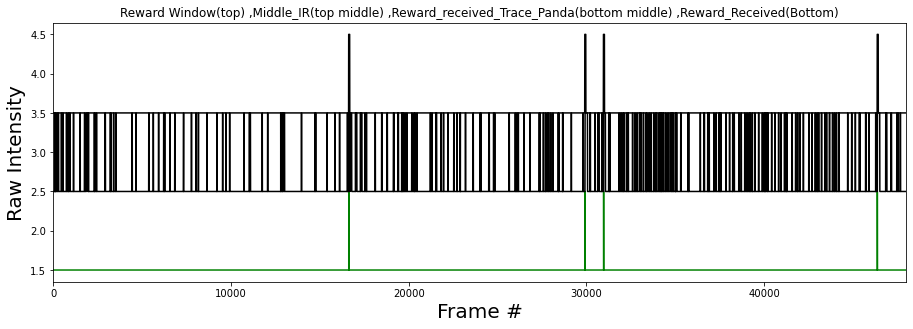

In [49]:
# Plot TimeStamps (Events)
#plt_trial.plot(df['reward_received'], color ='r')
plt_trial.plot(df['Reward_Received_Trace_panda']+1.5, color ='g')
plt_trial.plot(df['Middle_IR_Traces_panda']+2.5, color ='k')
plt_trial.plot(df['Reward_Window_Trace_panda']+3.5, color ='k')
# plt_Check_Alighnment.plot(x_axis,(Reward_Received_Trace_panda+1.5), color = 'g') 
# plt_Check_Alighnment.plot(x_axis,(Middle_IR_Traces_panda+2.5), color = 'k')
# plt_Check_Alighnment.plot(x_axis,(Reward_Window_Trace_panda+3.5), color = 'k')

plt_trial.subplots_adjust(bottom=0.1, right=2.1, top=1)
plt_trial.ylabel('Raw Intensity', size = 20)
plt_trial.xlabel('Frame #', size = 20)
plt_trial.title(('Reward Window(top) ,Middle_IR(top middle) ,Reward_received_Trace_Panda(bottom middle) ,Reward_Received(Bottom)'), fontdict=None, loc='center')

plt_trial.xlim(0, len(df))
#plt_trial.xlim(1000, 1500)  #Example Trial
#plt_trial.xlim(20750, 21250)


plt_trial.show()

In [50]:
# Convert traces into timestamps 
# Reward_Received_Trace_panda
Signal_Trace_to_Convert = 'Reward_Received_Trace_panda'
Event_Count[ (Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp') ]= 0
Event_Count_TimeStamps[(Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp')].append(None)
for i in range(signal_Length):
    if(df[Signal_Trace_to_Convert][i]== 1):
        Event_Count[(Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp') ] += 1  # add one  to count num of events
        Event_Count_TimeStamps[(Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp') ].append([i]) 
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
del Event_Count_TimeStamps[(Signal_Trace_to_Convert + '_'+ 'ConvertedTimeStamp')][0]





In [51]:
#. Crop Data and export csv for Analysis 

#############################################
#. Extract blocks of signal with respect to reference timestamp (WindowBeging before Reference -  to- WindowEnd after Reference)
Signal_Label = ('Reward_Window_Trace_panda') # 3rd cell
ReferenceEvent = 'M_sol_Valid_ON'
WindowBeging = 0   #Baseline signal Before Reference Event    
WindowEnd= 5      # Signal after Reference Event

Signal = df[Signal_Label]   # access data under signal label in df dataframe
SignalTraces = {}
for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
    tempt = Event_Count_TimeStamps[ReferenceEvent][i]
    Reference_Time = tempt[0]  # convert to integer
    SignalTraces.update({('Reference_' + str(i)) :  Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)]})

# Convert dictionary to pandas data frame 
SignalTraces_panda = SignalTraces_pd.DataFrame.from_dict(SignalTraces, orient='index').T
filename =  Signal_Label + '_|w_Ref_|' +  ReferenceEvent + '|_' + str(WindowBeging) + '_I_' + str(WindowEnd) + '.csv'
savefilename = os.path.join(Save_Path, filename)
#SignalTraces_panda.to_csv(savefilename)


#############################################################
# Extract signal between two timestamps 

Signal_Label = ('Reward_Window_Trace_panda') # 3rd cell
Reference_Begin = 'Reward_Win_Begining'
Reference_End = 'Reward_Win_Ending'
Signal = df[Signal_Label]   # access data under signal label in df dataframe
SignalTraces = {}

for i in range(Event_Count[Reference_Begin]):
    tempa = Event_Count_TimeStamps[Reference_Begin][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Event_Count_TimeStamps[Reference_End][i]
    tempb = int(tempb[0])   # Convert to Integer
    SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})
    
# Convert dictionary to pandas data frame 
SignalTraces_panda = SignalTraces_pd.DataFrame.from_dict(SignalTraces, orient='index').T
filename =  Signal_Label + '_|' + Reference_Begin + '|' + Reference_End +'|.csv'
savefilename = os.path.join(Save_Path, filename)
#SignalTraces_panda.to_csv(savefilename)




In [52]:


# # Use this to filter variables (all Rewarded trials)
Filtered_df = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] 
Filtered_Reward_Pre_Trial_Baseline_Start= (Filtered_df['Pre_Trial_Initi_Start']).values.tolist()
Filtered_Reward_Pre_Trial_Baseline_End= (Filtered_df['Pre_Trial_Initi_End']).values.tolist()
Filtered_Reward_Trial_Baseline_Start= (Filtered_df['Trial_Initi_Start']).values.tolist()
Filtered_Reward_Trial_Baseline_End= (Filtered_df['Trial_Initi_End']).values.tolist()
Filtered_Reward_Delay_Win_Start= (Filtered_df['Delay_Win_Start']).values.tolist()
Filtered_Reward_Delay_Win_End= (Filtered_df['Delay_Win_End']).values.tolist()
Filtered_Reward_Cue_Start= (Filtered_df['Cue_Start']).values.tolist()
Filtered_Reward_Cue_End= (Filtered_df['Cue_End']).values.tolist()
Filtered_Reward_Reward_Start= (Filtered_df['Reward_Start']).values.tolist()
Filtered_Reward_Reward_End= (Filtered_df['Reward_End']).values.tolist()


# # Use this to filter variables (Reward left)
Filtered_df = Trial_Type_panda[Trial_Type_panda['Trial_Descript'] == 'Rewarded_Left'] 
Filtered_Reward_Start_Left= (Filtered_df['Reward_Start']).values.tolist()
Filtered_Delay_Win_Start_Left_Rewarded= (Filtered_df['Delay_Win_Start']).values.tolist()
Filtered_Cue_Left_Rewarded= (Filtered_df['Cue_Start']).values.tolist()
Filtered_Cue_Left_Trial_Initi_Win_Start= (Filtered_df['Trial_Initi_Start']).values.tolist()

# # Use this to filter variables (Reward Right)
Filtered_df = Trial_Type_panda[Trial_Type_panda['Trial_Descript'] == 'Rewarded_Right'] 
Filtered_Reward_Start_Right= (Filtered_df['Reward_Start']).values.tolist()
Filtered_Delay_Win_Start_Right_Rewarded= (Filtered_df['Delay_Win_End']).values.tolist()
Filtered_Cue_Right_Rewarded= (Filtered_df['Cue_Start']).values.tolist()
Filtered_Cue_Right_Trial_Initi_Win_Start= (Filtered_df['Trial_Initi_Start']).values.tolist()


# # Use this to filter variables (all Omission trials)
Filtered_df = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] 
Filtered_Omission_Pre_Trial_Baseline_Start= (Filtered_df['Pre_Trial_Initi_Start']).values.tolist()
Filtered_Omission_Pre_Trial_Baseline_End= (Filtered_df['Pre_Trial_Initi_End']).values.tolist()
Filtered_Omission_Trial_Baseline_Start= (Filtered_df['Trial_Initi_Start']).values.tolist()
Filtered_Omission_Trial_Baseline_End= (Filtered_df['Trial_Initi_End']).values.tolist()
Filtered_Omission_Delay_Win_Start= (Filtered_df['Delay_Win_Start']).values.tolist()
Filtered_Omission_Delay_Win_End= (Filtered_df['Delay_Win_End']).values.tolist()
Filtered_Omission_Cue_Start= (Filtered_df['Cue_Start']).values.tolist()
Filtered_Omission_Cue_End= (Filtered_df['Cue_End']).values.tolist()

#'Delay_Win_Start','Delay_Win_End',

# Append them back to Even_Count and Event_Count_TimeStamps
Event_Count[ 'Filtered_Reward_Pre_Trial_Baseline_Start' ]= len(Filtered_Reward_Pre_Trial_Baseline_Start)
Event_Count_TimeStamps['Filtered_Reward_Pre_Trial_Baseline_Start'] = Filtered_Reward_Pre_Trial_Baseline_Start
Event_Count[ 'Filtered_Reward_Pre_Trial_Baseline_End' ]= len(Filtered_Reward_Pre_Trial_Baseline_End)
Event_Count_TimeStamps['Filtered_Reward_Pre_Trial_Baseline_End'] = Filtered_Reward_Pre_Trial_Baseline_End
Event_Count[ 'Filtered_Reward_Trial_Baseline_Start' ]= len(Filtered_Reward_Trial_Baseline_Start)
Event_Count_TimeStamps['Filtered_Reward_Trial_Baseline_Start'] = Filtered_Reward_Trial_Baseline_Start
Event_Count[ 'Filtered_Reward_Trial_Baseline_End' ]= len(Filtered_Reward_Trial_Baseline_End)
Event_Count_TimeStamps['Filtered_Reward_Trial_Baseline_End'] = Filtered_Reward_Trial_Baseline_End
Event_Count[ 'Filtered_Reward_Delay_Win_Start' ]= len(Filtered_Reward_Delay_Win_Start)
Event_Count_TimeStamps['Filtered_Reward_Delay_Win_Start'] = Filtered_Reward_Delay_Win_Start
Event_Count[ 'Filtered_Reward_Delay_Win_End' ]= len(Filtered_Reward_Delay_Win_End)
Event_Count_TimeStamps['Filtered_Reward_Delay_Win_End'] = Filtered_Reward_Delay_Win_End
Event_Count[ 'Filtered_Reward_Cue_Start' ]= len(Filtered_Reward_Cue_Start)
Event_Count_TimeStamps['Filtered_Reward_Cue_Start'] = Filtered_Reward_Cue_Start
Event_Count[ 'Filtered_Reward_Cue_End' ]= len(Filtered_Reward_Cue_End)
Event_Count_TimeStamps['Filtered_Reward_Cue_End'] = Filtered_Reward_Cue_End
Event_Count[ 'Filtered_Reward_Reward_Start' ]= len(Filtered_Reward_Reward_Start)
Event_Count_TimeStamps['Filtered_Reward_Reward_Start'] = Filtered_Reward_Reward_Start
Event_Count[ 'Filtered_Reward_Reward_End' ]= len(Filtered_Reward_Reward_End)
Event_Count_TimeStamps['Filtered_Reward_Reward_End'] = Filtered_Reward_Reward_End 



# Reward Left, or Reward Right
Event_Count[ 'Filtered_Reward_Start_Left' ]= len(Filtered_Reward_Start_Left)
Event_Count_TimeStamps['Filtered_Reward_Start_Left'] = Filtered_Reward_Start_Left
Event_Count[ 'Filtered_Reward_Start_Right' ]= len(Filtered_Reward_Start_Right)
Event_Count_TimeStamps['Filtered_Reward_Start_Right'] = Filtered_Reward_Start_Right

Event_Count[ 'Filtered_Delay_Win_Left_Rewarded' ]= len(Filtered_Delay_Win_Start_Left_Rewarded)
Event_Count_TimeStamps['Filtered_Delay_Win_Left_Rewarded'] = Filtered_Delay_Win_Start_Left_Rewarded
Event_Count[ 'Filtered_Delay_Win_Right_Rewarded' ]= len(Filtered_Delay_Win_Start_Right_Rewarded)
Event_Count_TimeStamps['Filtered_Delay_Win_Right_Rewarded'] = Filtered_Delay_Win_Start_Right_Rewarded

Event_Count[ 'Filtered_Cue_Left_Rewarded' ]= len(Filtered_Cue_Left_Rewarded)
Event_Count_TimeStamps['Filtered_Cue_Left_Rewarded'] = Filtered_Cue_Left_Rewarded
Event_Count[ 'Filtered_Cue_Right_Rewarded' ]= len(Filtered_Cue_Right_Rewarded)
Event_Count_TimeStamps['Filtered_Cue_Right_Rewarded'] = Filtered_Cue_Right_Rewarded

Event_Count[ 'Filtered_Cue_Left_Trial_Initi_Win_Start' ]= len(Filtered_Cue_Left_Trial_Initi_Win_Start)
Event_Count_TimeStamps['Filtered_Cue_Left_Trial_Initi_Win_Start'] = Filtered_Cue_Left_Trial_Initi_Win_Start
Event_Count[ 'Filtered_Cue_Right_Trial_Initi_Win_Start' ]= len(Filtered_Cue_Right_Trial_Initi_Win_Start)
Event_Count_TimeStamps['Filtered_Cue_Right_Trial_Initi_Win_Start'] =Filtered_Cue_Right_Trial_Initi_Win_Start



# Omissions

Event_Count[ 'Filtered_Omission_Pre_Trial_Baseline_Start' ]= len(Filtered_Omission_Pre_Trial_Baseline_Start)
Event_Count_TimeStamps['Filtered_Omission_Pre_Trial_Baseline_Start'] =Filtered_Omission_Pre_Trial_Baseline_Start

Event_Count[ 'Filtered_Omission_Pre_Trial_Baseline_End' ]= len(Filtered_Omission_Pre_Trial_Baseline_End)
Event_Count_TimeStamps['Filtered_Omission_Pre_Trial_Baseline_End'] =Filtered_Omission_Pre_Trial_Baseline_End

Event_Count[ 'Filtered_Omission_Trial_Baseline_Start' ]= len(Filtered_Omission_Trial_Baseline_Start)
Event_Count_TimeStamps['Filtered_Omission_Trial_Baseline_Start'] =Filtered_Omission_Trial_Baseline_Start

Event_Count[ 'Filtered_Omission_Trial_Baseline_End' ]= len(Filtered_Omission_Trial_Baseline_End)
Event_Count_TimeStamps['Filtered_Omission_Trial_Baseline_End'] =Filtered_Omission_Trial_Baseline_End


Event_Count[ 'Filtered_Omission_Delay_Win_Start' ]= len(Filtered_Omission_Delay_Win_Start)
Event_Count_TimeStamps['Filtered_Omission_Delay_Win_Start'] =Filtered_Omission_Delay_Win_Start

Event_Count[ 'Filtered_Omission_Delay_Win_End' ]= len(Filtered_Omission_Delay_Win_End)
Event_Count_TimeStamps['Filtered_Omission_Delay_Win_End'] =Filtered_Omission_Delay_Win_End

Event_Count[ 'Filtered_Omission_Cue_Start' ]= len(Filtered_Omission_Cue_Start)
Event_Count_TimeStamps['Filtered_Omission_Cue_Start'] =Filtered_Omission_Cue_Start

Event_Count[ 'Filtered_Omission_Cue_End' ]= len(Filtered_Omission_Cue_End)
Event_Count_TimeStamps['Filtered_Omission_Cue_End'] =Filtered_Omission_Cue_End

# Event_Count[ '' ]= len()
# Event_Count_TimeStamps[''] =


# Filtered_df = Trial_Type_panda[Trial_Type_panda['Reward_received'] == 'Yes'] 
# Filtered_Reward_received= (Filtered_df['Reward_received_T']).values.tolist()

#. Important TimeStamps

# # Pretrial_baseline
# print(Event_Count['Reward_Pre_Trial_Baseline_Start'])
# print(Event_Count['Reward_Pre_Trial_Baseline_End'])
# #Reward_Pre_Trial_Trace_panda

# # Trial Initiation
# print(Event_Count['Reward_Filtered_Trial_Window_Start'])
# print(Event_Count['Reward_Trial_init_Window_End_panda_ConvertedTimeStamp'])
# #Trial_Window_Available_Trace_panda

# # Actual "Trial" period which animal respond to cue  
# print(Event_Count['Reward_Trial_init_Window_End_panda_ConvertedTimeStamp'])
# print(Event_Count['Reward_Win_Begining'])

# # Reward Window
# print(Event_Count['Reward_Win_Begining'])
# print(Event_Count['Reward_Win_Ending'])
# #Reward_Window_Trace_panda



In [53]:

# Plot perievent using reference
#Signal = df['trial_available']
#Signal = Trial_Window_Available_Trace_panda
#Signal = Middle_IR_Traces_panda
#Signal = ReScaled[CellList[15]]  # 3rd cell

#ReferenceEvent = 'Trial_Window_Start'
#ReferenceEvent = 'Trial_Window_End'

# Verfiy Trial_Window_Start = Trial_Available
# Signal_Label = 'Trial_Window_Available_Trace_panda'
# ReferenceEvent = 'Trial_Window_Start'

#Verify middle port IR terminates trial initiation window 

# Signal_Label = 'Middle_IR_Traces_panda'
# ReferenceEvent = 'Trial_Window_End'


#IR during Trial, middle port IR response,  side port IR response,  Reward consumption in the middle port
# Signal_Label = 'ALL_IR_Traces_panda'
# ReferenceEvent = 'Trial_Window_End'


#  Ten Seconds before Trial Initiation Cue as baseline, showing very low IR activity
# Signal_Label = 'ALL_IR_Traces_panda'
# ReferenceEvent = 'Trial_Window_Start'






########################### Funcation to export figures##################
def ExportRasters(y_lim, WinBegin,WinEnd,Signal_Label_Trace ,Signal_Label_Event ,ReferenceEvent, MarkerOne_Label,MarkerTwo_Label, MarkerThree_Label,MarkerFour_Label, MarkerFive_Label, Cell_Resp_Label ):

    

    #BinSize = 20  # Unit in frames (20 = 1 seconds (20 frames/second))
    WindowBeging = WinBegin   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
    WindowEnd= WinEnd      # Signal after Reference Event
    Signal = df[Signal_Label_Trace].astype(float)   # access data under signal label in df dataframe
    MarkerOne = df[MarkerOne_Label]
    MarkerTwo = df[MarkerTwo_Label]
    MarkerThree = df[MarkerThree_Label]
    MarkerFour = df[MarkerFour_Label]
    MarkerFive = df[MarkerFive_Label]
    
    Cell_Resp = Cell_Resp_Label
    
    MarkerOnePlotThreshold = 0
    MarkerTwoPlotThreshold = 0
    MarkerThreePlotThreshold = 0
    MarkerFourPlotThreshold = 0
    MarkerFivePlotThreshold = 0
    
    Time_CutOff = 0 #. to mark graphs in which the time window is longer than the data, and those trials are not plotted
    
    # Trials with time cutoffs will be filled with zeros
    Filler =  [0] * (WinBegin + WinEnd)
    temp = SignalTraces_pd.DataFrame(Filler)
    Filler_panda = temp.squeeze()               #################     convert to data frame

    
    
    SignalTraces = {}
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):

        tempt = Event_Count_TimeStamps[ReferenceEvent][i]
        Reference_Time = int(tempt[0])  # convert to integer
        
        
        if ((WinBegin + WinEnd) == len(Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)])):  #full length data, no cutoffs
            SignalTraces.update({('Reference_' + str(i)) :  Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)]})
        else:
            SignalTraces.update({('Reference_' + str(i)) : Filler_panda })


    MarkerOneTraces = {}
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        tempt = Event_Count_TimeStamps[ReferenceEvent][i]
        Reference_Time = int(tempt[0])  # convert to integer
        if ((WinBegin + WinEnd) == len(Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)])):  #full length data, no cutoffs
            MarkerOneTraces.update({('Reference_' + str(i)) :  MarkerOne.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)]})
        else:
            MarkerOneTraces.update({('Reference_' + str(i)) : Filler_panda })
            
    MarkerTwoTraces = {}
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        tempt = Event_Count_TimeStamps[ReferenceEvent][i]
        Reference_Time = int(tempt[0])  # convert to integer
        if ((WinBegin + WinEnd) == len(Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)])):  #full length data, no cutoffs
            MarkerTwoTraces.update({('Reference_' + str(i)) :  MarkerTwo.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)]})
        else:
            MarkerTwoTraces.update({('Reference_' + str(i)) : Filler_panda })
        
    MarkerThreeTraces = {}
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        tempt = Event_Count_TimeStamps[ReferenceEvent][i]
        Reference_Time = int(tempt[0])  # convert to integer
        if ((WinBegin + WinEnd) == len(Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)])):  #full length data, no cutoffs
            MarkerThreeTraces.update({('Reference_' + str(i)) :  MarkerThree.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)]})
        else:
            MarkerThreeTraces.update({('Reference_' + str(i)) : Filler_panda })
            
    MarkerFourTraces = {}
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        tempt = Event_Count_TimeStamps[ReferenceEvent][i]
        Reference_Time = int(tempt[0])  # convert to integer
        if ((WinBegin + WinEnd) == len(Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)])):  #full length data, no cutoffs
            MarkerFourTraces.update({('Reference_' + str(i)) :  MarkerFour.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)]})
        else:
            MarkerFourTraces.update({('Reference_' + str(i)) : Filler_panda })
    
    MarkerFiveTraces = {}
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        tempt = Event_Count_TimeStamps[ReferenceEvent][i]
        Reference_Time = int(tempt[0])  # convert to integer
        if ((WinBegin + WinEnd) == len(Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)])):  #full length data, no cutoffs
            MarkerFiveTraces.update({('Reference_' + str(i)) :  MarkerFive.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)]})
        else:
            MarkerFiveTraces.update({('Reference_' + str(i)) : Filler_panda })


    # Convert dictionary to pandas data frame 

    SignalTraces_panda = SignalTraces_pd.DataFrame(SignalTraces)
    MarkerOneTraces_panda = SignalTraces_pd.DataFrame(MarkerOneTraces)
    MarkerTwoTraces_panda = SignalTraces_pd.DataFrame(MarkerTwoTraces)
    MarkerThreeTraces_panda = SignalTraces_pd.DataFrame(MarkerThreeTraces)
    MarkerFourTraces_panda = SignalTraces_pd.DataFrame(MarkerFourTraces)
    MarkerFiveTraces_panda = SignalTraces_pd.DataFrame(MarkerFiveTraces)


        ######## Plot Perievent#########
    # Plot Scaled Traces,  Full Range (0 to 1), log scale
    fig = plt_perievent_traces.figure(figsize =(19.2, 10.8), dpi = 400.0)
    fig.tight_layout() 
    #fig = plt_perievent_traces.figure()
    ax = fig.add_subplot(3,2 ,1)
    #ax = fig.add_subplot(3,1 ,1)

    Perievent_Traces = np.transpose(SignalTraces_panda)
    #plt_Heat_scaled.imshow(TransScaledTraces, cmap=plt_Heat_scaled.cm.gist_yarg, aspect = 'auto')
    im = plt_perievent_traces.imshow(Perievent_Traces, interpolation = 'none',  cmap=plt_Perievent_One.cm.gist_rainbow_r, aspect = 'auto')


    plt_perievent_traces.title(Cell_Resp +'\n Signal: ' + Signal_Label_Trace +  '      Ref:  '+ ReferenceEvent + '     ' + str(WindowBeging) + '_I_' + str(WindowEnd) 
    +'\n'+ MarkerOne_Label + ':(G)_' + MarkerTwo_Label+ ':(PK)_' +'\n'+ MarkerThree_Label + ':(O)_'+ MarkerFour_Label+ ':(BK)_',size = 10)
    
    plt_perievent_traces.xlabel('Time (in Frames)', size = 20)
    plt_perievent_traces.ylabel(('Trial #' + '(' + str(len(Event_Count_TimeStamps[ReferenceEvent]))+ ')'), size = 20)


        # Draw Reference Line and 
    ax.vlines(x= WindowBeging-0.5, ymin=-1, ymax=len(Event_Count_TimeStamps[ReferenceEvent]), colors='green', lw=10, label='vline_single - partial height')
    plt_perievent_traces.xticks(np.arange(-1, (WindowBeging +WindowEnd +1), 5))
    plt_perievent_traces.yticks(np.arange(0, len(Event_Count_TimeStamps[ReferenceEvent]), 5.0))

    # Color axis
    #cax = plt_perievent_traces.axes([2.2, 0.1, 0.075, 0.8])
    #plt_Heat_scaled.yscale('log')

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="3%", pad=0.05)
    #plt_perievent_traces.clim(-1000, 3000)###############################################################  Set Range for Color
    plt_perievent_traces.clim(-0.3, 1)###############################################################  Set Range for Color
    plt_perievent_traces.colorbar(im, cax=cax)





    ######## Plot Perievent with makers #########
    # Plot Scaled Traces,  Full Range (0 to 1), log scale
    #fig = plt_perievent_traces.figure(figsize =(19.2, 10.8), dpi = 400.0)
    #fig = plt_perievent_traces.figure()
    #ax = fig.add_subplot(3,1 ,2)
    ax = fig.add_subplot(3,2 ,3)
    
    Perievent_Traces = np.transpose(SignalTraces_panda)
    #plt_Heat_scaled.imshow(TransScaledTraces, cmap=plt_Heat_scaled.cm.gist_yarg, aspect = 'auto')
    im = plt_perievent_traces.imshow(Perievent_Traces, interpolation = 'none',  cmap=plt_Perievent_One.cm.gist_rainbow_r, aspect = 'auto')



    #plt_perievent_traces.title('Signal: ' + Signal_Label + '\n' + 'Ref:  '+ ReferenceEvent + '\n' + str(WindowBeging) + '_I_' + str(WindowEnd), size = 20)
    plt_perievent_traces.xlabel('Time (in Frames)', size = 20)
    plt_perievent_traces.ylabel(('Trial #' + '(' + str(len(Event_Count_TimeStamps[ReferenceEvent]))+ ')'), size = 20)



    #     ######### Draw line for marker one (Referenced with ReferenceEvent)  
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        for j in range (len(MarkerOneTraces_panda[('Reference_' + str(i))])):
            if(MarkerOneTraces_panda[('Reference_' + str(i))][j]>MarkerOnePlotThreshold):
                #ax.vlines(x= j-0.5, ymin=((i)-0.4), ymax=((i+1)-0.6), colors='lime', lw=10, label='vline_single - partial height')  #. (-0.4 and -0.6 controls line width)
                #ax.vlines(x= j-0.5, ymin=((i)-0.4), ymax=((i+1)-0.6), colors='c', lw=10, label='vline_single - partial height')  #. (-0.4 and -0.6 controls line width)
                ax.vlines(x= j-0.5, ymin=((i)-0.4), ymax=((i+1)-0.6), colors='purple', lw=10, label='vline_single - partial height')  #. (-0.4 and -0.6 controls line width)
                
    #     ######### Draw line for marker two (Referenced with ReferenceEvent)  
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        for j in range (len(MarkerTwoTraces_panda[('Reference_' + str(i))])):
            if(MarkerTwoTraces_panda[('Reference_' + str(i))][j]>MarkerTwoPlotThreshold):
                ax.vlines(x= j-0.5, ymin=((i)-0.4), ymax=((i+1)-0.6), colors='violet', lw=10, label='vline_single - partial height')  #. (-0.4 and -0.6 controls line width)
                                                                            #original orage
    #     ######### Draw line for marker Three (Referenced with ReferenceEvent)  
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        for j in range (len(MarkerThreeTraces_panda[('Reference_' + str(i))])):
            if(MarkerThreeTraces_panda[('Reference_' + str(i))][j]>MarkerThreePlotThreshold):
                ax.vlines(x= j-0.5, ymin=((i)-0.4), ymax=((i+1)-0.6), colors='orange', lw=10, label='vline_single - partial height')  #. (-0.4 and -0.6 controls line width)
                                                                            #original violet
    #     ######### Draw line for marker Four (Referenced with ReferenceEvent)  
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        for j in range (len(MarkerFourTraces_panda[('Reference_' + str(i))])):
            if(MarkerFourTraces_panda[('Reference_' + str(i))][j]>MarkerFourPlotThreshold):
                ax.vlines(x= j-0.5, ymin=((i)-0.4), ymax=((i+1)-0.6), colors='red', lw=10, label='vline_single - partial height')  #. (-0.4 and -0.6 controls line width)

        #     ######### Draw line for marker Five (Referenced with ReferenceEvent)  
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        for j in range (len(MarkerFiveTraces_panda[('Reference_' + str(i))])):
            if(MarkerFiveTraces_panda[('Reference_' + str(i))][j]>MarkerFivePlotThreshold):
                ax.vlines(x= j-0.5, ymin=((i)-0.4), ymax=((i+1)-0.6), colors='k', lw=10, label='vline_single - partial height')  #. (-0.4 and -0.6 controls line width)



        # Draw Reference Line and 
    ax.vlines(x= WindowBeging-0.5, ymin=-1, ymax=len(Event_Count_TimeStamps[ReferenceEvent]), colors='green', lw=10, label='vline_single - partial height')
    plt_perievent_traces.xticks(np.arange(-1, (WindowBeging +WindowEnd +1), 5))
    plt_perievent_traces.yticks(np.arange(0, len(Event_Count_TimeStamps[ReferenceEvent]), 5.0))

    # Color axis
    #cax = plt_perievent_traces.axes([2.2, 0.1, 0.075, 0.8])
    #plt_Heat_scaled.yscale('log')

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="3%", pad=0.05)
    #plt_perievent_traces.clim(-1000, 3000)###############################################################  Set Range for Color
    plt_perievent_traces.clim(-0.3, 1)###############################################################  Set Range for Color
    plt_perievent_traces.colorbar(im, cax=cax)





    #plt_perievent_traces.colorbar(cax=cax)
    #plt_perievent_traces.show()


    ######### Side view to look at Amplitude########

    #ax = fig.add_subplot(3,1 ,3)
    ax = fig.add_subplot(3,2 ,5)

    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):
        plt_perievent_traces.plot(SignalTraces_panda[('Reference_' + str(i))], color ='b')

    #ax.vlines(x= WindowBeging-0.5, ymin=0, ymax=1, colors='green', lw=10, label='vline_single - partial height')
    ax.vlines(x= WindowBeging-0.5, ymin=0, ymax=max(SignalTraces_panda.max()), colors='green', lw=10, label='vline_single - partial height')

    plt_perievent_traces.ylabel('Intensity', size = 20)
    plt_perievent_traces.xlabel('Time (in Frames)', size = 20)
    #plt_perievent_traces.title(('Cell #' + CellList[x]), fontdict=None, loc='center')

##################################################################################################################
########################################   Bin  Analysis    #################################    
    Signal = df[Signal_Label_Event].astype(float)   # access data under signal label in df dataframe
    SignalTraces = {}
    for i in range(len(Event_Count_TimeStamps[ReferenceEvent])):

        tempt = Event_Count_TimeStamps[ReferenceEvent][i]
        Reference_Time = int(tempt[0])  # convert to integer
        
        
        if ((WinBegin + WinEnd) == len(Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)])):  #full length data, no cutoffs
            SignalTraces.update({('Reference_' + str(i)) :  Signal.values[(Reference_Time-WindowBeging): (Reference_Time+WindowEnd)]})
        else:
            SignalTraces.update({('Reference_' + str(i)) : Filler_panda })
            
            
    
    Cell_Resp = Cell_Resp_Label
    
    #Bin = 20  # Bin size (Default 20 = 1 second)           #(10 seonds *20 frames per second)                             
    Bin = 5 # Tried new bin size 
    Bin_Data_df = pd.DataFrame()
    Mean_Bin_Data_df = pd.DataFrame()
    Check_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    #t = list(Perievent_Traces.keys())##########
    #temp = SignalTraces_pd.DataFrame(Perievent_Traces)
    t = list(SignalTraces.keys())##########
    temp = SignalTraces_pd.DataFrame(SignalTraces)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda
    ###########


    for x in range(len(t)):                      
    #for x in range(5):                                          # ******* test

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[x]]
        ######temp = Binary.loc[0:len(Binary), t[x]]
        #temp = Binary.loc[0:24, CellList[x]]                    #******* test
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)

        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[x]].sum()).tolist()
        #Bin_Data.insert(loc=1, column= 'test', value=[2,2,3,4])
        #Bin_Data_df[CellList[x]] = np.append(Temp_Bin_Data)
        Bin_Data_df[t[x]] = Temp_Bin_Data


        ######. This is for manual checking 
        Check_Data_df['ax']= temp_df['ax']
        Check_Data_df[t[x]]= temp


    Trans_Bin_Data = np.transpose(Bin_Data_df.loc[0:len(Bin_Data_df), t])      #***********   Test

    #Bin_Data_df.to_csv(os.path.join(Save_Path, 'Export_Binned_Traces.csv'))

    #print(Check_Data_df)
    #print(Bin_Data_df)
    #print(Trans_Bin_Data)


    ########################### Funcation to export figures Binned ##################




    ######## Plot Perievent#########

    #fig = plt_perievent_traces.figure(figsize =(19.2, 10.8), dpi = 400.0)
    ax = fig.add_subplot(3,2 ,2)
    #ax = fig.add_subplot(3,1 ,3)

    TransPerievent_Traces_panda = np.transpose(Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t])

    im = plt_perievent_traces.imshow(TransPerievent_Traces_panda, interpolation = 'none', cmap=plt_Heat_scaled.cm.bwr, aspect = 'auto')
    #im = plt_perievent_traces.imshow(Perievent_Traces, cmap=plt_Perievent_One.cm.gist_rainbow_r, aspect = 'auto')


    # Draw Reference Line and 
    ax.vlines(x= WinBegin-0.5, ymin=-1, ymax=len(Event_Count_TimeStamps[ReferenceEvent]), colors='green', lw=10, label='vline_single - partial height')
    plt_perievent_traces.xticks(np.arange(-1, (WinBegin +WinEnd +1), 5))
    plt_perievent_traces.yticks(np.arange(0, len(Event_Count_TimeStamps[ReferenceEvent]), 5.0))


    #####plt_perievent_traces.title('Signal: ' + Signal_Label + '\n' + 'Ref:  '+ ReferenceEvent + '\n' + str(WindowBeging) + '_I_' + str(WindowEnd), size = 20)
    plt_perievent_traces.title(Cell_Resp +'\n Signal: ' + Signal_Label_Event +  '      Ref:  '+ ReferenceEvent + '     ' + str(WindowBeging) + '_I_' + str(WindowEnd) 
    +'\n'+ MarkerOne_Label + ':(G)_' + MarkerTwo_Label+ ':(PK)_'+'\n' + MarkerThree_Label + ':(O)_'+ MarkerFour_Label+ ':(BK)_',size = 10)
    plt_perievent_traces.xlabel('Time (in Frames)', size = 20)
    plt_perievent_traces.ylabel(('Trial #' + '(' + str(len(t))+ ')'), size = 20)

    # Draw Reference Line and 
    #     ax.vlines(x= WindowBeging-0.5, ymin=-1, ymax=len(Event_Count_TimeStamps[ReferenceEvent]), colors='green', lw=10, label='vline_single - partial height')
    #     plt_perievent_traces.xticks(np.arange(-1, (WindowBeging +WindowEnd +1), 5))
    #     plt_perievent_traces.yticks(np.arange(0, len(Event_Count_TimeStamps[ReferenceEvent]), 5.0))

    # Color axis
    #cax = plt_perievent_traces.axes([2.2, 0.1, 0.075, 0.8])
    #plt_Heat_scaled.yscale('log')

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="3%", pad=0.05)
    plt_perievent_traces.clim(-0, 1)###############################################################  Set Range for Color
    plt_perievent_traces.colorbar(im, cax=cax)



    ######## Plot Perievent#########

    ax = fig.add_subplot(3,2 ,4)
    #ax = fig.add_subplot(3,1 ,3)
    im = plt_perievent_traces.imshow(Trans_Bin_Data, interpolation = 'none', cmap=plt_Heat_scaled.cm.hot, aspect = 'auto')
    #im = plt_perievent_traces.imshow(Perievent_Traces, cmap=plt_Perievent_One.cm.gist_rainbow_r, aspect = 'auto')



    #plt_perievent_traces.title('Binned Data (Count of Events per Bin)', size = 20, y=1.08)
    plt_perievent_traces.xlabel('Binned Data (Count of Events per Bin)', size = 20)
    plt_perievent_traces.ylabel(('Trial #' + '(' + str(len(t))+ ')'), size = 20)


    # Draw Reference Line and 
    ax.vlines(x= WinBegin/Bin -0.5, ymin=-1, ymax=len(Event_Count_TimeStamps[ReferenceEvent]), colors='green', lw=10, label='vline_single - partial height')
    plt_perievent_traces.xticks(np.arange(-1, (WinBegin/Bin +WinEnd/Bin +1), 5))
    plt_perievent_traces.yticks(np.arange(0, len(Event_Count_TimeStamps[ReferenceEvent]), 5.0))
    plt_perievent_traces.xlim(-0.5, (WinBegin +WinEnd)/Bin-0.5)  #. display window for x axis


    # Draw Reference Line and 
    #     ax.vlines(x= WindowBeging-0.5, ymin=-1, ymax=len(Event_Count_TimeStamps[ReferenceEvent]), colors='green', lw=10, label='vline_single - partial height')
    #     plt_perievent_traces.xticks(np.arange(-1, (WindowBeging +WindowEnd +1), 5))
    #     plt_perievent_traces.yticks(np.arange(0, len(Event_Count_TimeStamps[ReferenceEvent]), 5.0))

    # Color axis
    #cax = plt_perievent_traces.axes([2.2, 0.1, 0.075, 0.8])
    #plt_Heat_scaled.yscale('log')

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="3%", pad=0.05)
    #plt_perievent_traces.clim(0, 1)###############################################################  Set Range for Color
    plt_perievent_traces.colorbar(im, cax=cax)







    #plt_perievent_traces.colorbar(cax=cax)
    #plt_perievent_traces.show()


    ######### Side view to look at Amplitude########
    ax = fig.add_subplot(3,2 ,6)
    #ax = fig.add_subplot(3,1 ,3)

    for i in range(len(t)):
        plt_perievent_traces.plot(Bin_Data_df[t[i]], color ='b')

    #plt_perievent_traces.plot(Mean_Bin_Data_df, color ='r', linewidth = 3)    ########### Plot Averages of wave
    #ax.vlines(x= WindowBeging-0.5, ymin=0, ymax=1, colors='green', lw=10, label='vline_single - partial height')
    
    ax.vlines(x= WinBegin/Bin -0.5, ymin=0, ymax=max(Bin_Data_df.max()), colors='green', lw=10, label='vline_single - partial height')

    # STilll need to edit
    # # Draw Reference Line and 
    # ax.vlines(x= WinBegin/Bin -0.5, ymin=-1, ymax=len(Event_Count_TimeStamps[ReferenceEvent]), colors='green', lw=10, label='vline_single - partial height')
    # plt_perievent_traces.xticks(np.arange(-1, (WinBegin/Bin +WinEnd/Bin +1), 5))
    # plt_perievent_traces.yticks(np.arange(0, len(Event_Count_TimeStamps[ReferenceEvent]), 5.0))


    Mean_Bin_Data_df = Bin_Data_df.iloc[:,0:len(t)].mean(axis=1)  # Calculates mean of bins across cell #***********   Test
    SEM_Bin_Data_df = numpy.std(Bin_Data_df, ddof=1, axis=1) / numpy.sqrt(len(t))  # Stardard error of the mean 

    plt_perievent_traces.plot(Mean_Bin_Data_df, color ='r', linewidth = 3)    ########### Plot Averages of wave
    x = np.arange(0,len(Mean_Bin_Data_df)) 
    plt_perievent_traces.plot((Mean_Bin_Data_df +SEM_Bin_Data_df ), color ='g', linewidth = 3)    ########### Plot Averages of wave Error Shading
    plt_perievent_traces.plot((Mean_Bin_Data_df -SEM_Bin_Data_df ), color ='g', linewidth = 3)    ########### Plot Averages of wave Error Shading
    ax.fill_between(x, (Mean_Bin_Data_df +SEM_Bin_Data_df ), (Mean_Bin_Data_df -SEM_Bin_Data_df ), color='green', alpha=1)


    plt_perievent_traces.ylabel('# Events per Bin', size = 20)
    plt_perievent_traces.xlabel('Binned Data (Count of Events per Bin)', size = 20)
    #plt_perievent_traces.title('Binned Data (Count of Events per Bin)', fontdict=None, loc='center', y=1.08)
    plt_perievent_traces.ylim(0,y_lim)
    plt_perievent_traces.xlim(0,(WinBegin +WinEnd)/Bin-0.25)  #. use the length of the first trace to determine x limit display 
        
    
    plt_perievent_traces.subplots_adjust(bottom=0.1, right=0.8, top=0.9)    # Adjust Figure Size
    filename =  File_Name.split(".")[0]+ '_' + Cell_Resp +'_' +Signal_Label_Trace + '_I_' +  ReferenceEvent + '_' + str(WindowBeging) + '_I_' + str(WindowEnd) + '.jpg'
    savefilename = os.path.join(Save_Path, filename)
    plt_perievent_traces.savefig(savefilename)
    #plt_perievent_traces.show()
    plt_perievent_traces.close()
    print('Figure Exported')
    
    
    return SignalTraces   #. This is "Perievent_Traces" for making binned signal traces


    
# Signal_Label = ('ReScaled_Cell_'+ CellList[15])
# ReferenceEvent = 'Trial_Window_Start'
# ExportRasters(Signal_Label,ReferenceEvent)
    
# ##################################################   
# # Example Cell 



In [54]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

print('Available Signals')
#print(df.keys())    # Signal races available from Original Data Sheet
print(df.columns.values)


print('\n\n')
print('Available TimeStamps')
print(Event_Count)  # TimeStamps

Available Signals
['Bin' 'time' '30' '33' '34' '38' '39' '40' '41' '42' '43' '44' '48' '50'
 '52' 'deconv_30' 'deconv_33' 'deconv_34' 'deconv_38' 'deconv_39'
 'deconv_40' 'deconv_41' 'deconv_42' 'deconv_43' 'deconv_44' 'deconv_48'
 'deconv_50' 'deconv_52' 'Bins_Behavior' 'Time_Behavior' 'Trial_available'
 'ALL_IR' 'event_1' 'event_2' 'event_3' 'event_4' 'event_5'
 'zNormalized_raw_Cell_30' 'zNormalized_raw_Cell_33'
 'zNormalized_raw_Cell_34' 'zNormalized_raw_Cell_38'
 'zNormalized_raw_Cell_39' 'zNormalized_raw_Cell_40'
 'zNormalized_raw_Cell_41' 'zNormalized_raw_Cell_42'
 'zNormalized_raw_Cell_43' 'zNormalized_raw_Cell_44'
 'zNormalized_raw_Cell_48' 'zNormalized_raw_Cell_50'
 'zNormalized_raw_Cell_52' 'zNormalized_deconv_Cell_deconv_30'
 'zNormalized_deconv_Cell_deconv_33' 'zNormalized_deconv_Cell_deconv_34'
 'zNormalized_deconv_Cell_deconv_38' 'zNormalized_deconv_Cell_deconv_39'
 'zNormalized_deconv_Cell_deconv_40' 'zNormalized_deconv_Cell_deconv_41'
 'zNormalized_deconv_Cell_deconv_4

In [55]:
# Export Individual Perievent Figure


# WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
# WinEnd= 60*4   # Signal after Reference Event


WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
WinEnd= 20*12   # Signal after Reference Event


#Signal_Label = 'Video_Motion_Thresholded_Trace_panda'
#Signal_Label = 'Video_Motion_Trace_panda'
#Signal_Label = ('deconv_17') # 3rd cell
#Signal_Label = ('ReScaled_Cell_36') # 3rd cell
#Signal_Label = ('Binary_Cell_deconv_37')  # 28, 56, 64
#Signal_Label = ('ReScaled_Cell_37') 

#Signal_Label = ('Binary_Cell_' + CellList_deconv[5] ) # 3rd cell
#Signal_Label = ('ReScaled_Cell_' + CellList_raw[5] ) # 3rd cell

#Signal_Label = ('Binary_Cell_deconv_66' ) # 3rd cell
#Signal_Label = 'ReScaled_Median_of_All_Cells_Rescaled_df'
#Signal_Label = 'Mean_of_All_Cells_Rescaled_df'
#Signal_Label = 'ReScaled_Mean_of_All_Cells_Rescaled_df'

#Signal_Label = 'Video_Light3_Trace_panda'
#Signal_Label = 'Video_Motion_Thresholded_Binary_Trace_panda' # 3rd cell
#Signal_Label = 'Video_Motion_Thresholded_Trace_panda' # 3rd cell################################# 
#Signal_Label = 'ALL_IR_Traces_panda'
#Signal_Label = 'Mean_of_All_Cells_Rescaled_df'
#Signal_Label ='Reward_Window_Trace_panda'
#Signal_Label = 'Reward_Window_Trace_panda'

#ReferenceEvent ='Reward_Received_Trace_panda_ConvertedTimeStamp'
ReferenceEvent ='Trial_Window_End'
#ReferenceEvent = 'Reward_Win_Begining'############################################## 11111111
#ReferenceEvent = 'Filtered_Omission_Cue_End' ############################################## 11111111

#ReferenceEvent = 'Filtered_Reward_Cue_End'
#ReferenceEvent ='Filtered_Reward_Reward_Start'
#ReferenceEvent ='Filtered_Omission_Cue_End'
#ReferenceEvent = 'Filtered_Reward_Pre_Trial_Baseline_Start'###############################22222222222####
#ReferenceEvent = 'Filtered_Omission_Pre_Trial_Baseline_Start'###############################22222222222
#ReferenceEvent ='Trial_Window_End'

# Signal_Label_Trace = ('ReScaled_Cell_37')
# Signal_Label_Event = ('Binary_Cell_deconv_37')  # 28, 56, 64

Signal_Label_Trace = ('ReScaled_Cell_' + CellList_raw[0] ) # 3rd cell
Signal_Label_Event = ('Binary_Cell_' + CellList_deconv[0] ) # 3rd cell

# Signal_Label_Trace = ('Video_Motion_Thresholded_Trace_panda') # 3rd cell
# Signal_Label_Event = ('Video_Motion_Thresholded_Binary_Trace_panda') # 3rd cell


#MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
MarkerOne_Label = 'Trial_Initi_Window_2_Sec_Limit_Trace_panda'
#MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
#MarkerTwo_Label = 'Reward_Window_Trace_panda'
MarkerTwo_Label = 'All_LED_Traces_panda'

MarkerThree_Label = 'ALL_IR_Traces_panda'
#MarkerThree_Label = 'Video_Light3_Trace_panda'
MarkerFour_Label= 'Middle_IR_Traces_panda'
MarkerFive_Label= 'Reward_Received_Trace_panda'



Cell_Resp_Label= '[None-][None+]'
#Cell_Resp_Label=Perm_Table_panda['Classify'][3]  # Does not work here, not calculate yet until later


y_lim = 5  # number is for y_lim
Perievent_Traces = ExportRasters(y_lim, WinBegin,WinEnd, Signal_Label_Trace,Signal_Label_Event, ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label, MarkerFive_Label, Cell_Resp_Label)
#Perievent_Traces = ExportRasters(y_lim, WinBegin,WinEnd, Signal_Label,ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label, Cell_Resp_Label)

#Export Binned Data
#Export_Binned_Figure(8, Cell_Resp_Label) # number is for y_lim




Figure Exported


In [56]:
# # Export movement with the same parameters

# # WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
# # WinEnd= 60*4   # Signal after Reference Event


# # ReferenceEvent = 'Reward_Win_Begining'############################################## 11111111

# # MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
# # MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
# # MarkerThree_Label = 'ALL_IR_Traces_panda'
# # #MarkerThree_Label = 'Video_Light3_Trace_panda'
# # MarkerFour_Label= 'Reward_Received_Trace_panda'

# Signal_Label = 'Video_Motion_Thresholded_Trace_panda' # 3rd cell################################# 

#Cell_Resp_Label= '[None-][None+]'
#Cell_Resp_Label=Perm_Table_panda['Classify'][3]  # Does not work here, not calculate yet until later

# Perievent_Traces = ExportRasters(WinBegin,WinEnd, Signal_Label,ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label,Cell_Resp_Label)
# # Export Binned Data
# Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim

In [57]:
# # Export all Cells Perievent Figure


# WinBegin = 300   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
# WinEnd= 100   # Signal after Reference Event

# Signal_Label = ('Binary_Cell_' + CellList_deconv[1] ) # 3rd cell
# #ReferenceEvent = 'Reward_Win_Begining'
# ReferenceEvent = 'Filtered_Reward_Start_Left'
# MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
# MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
# MarkerThree_Label = 'ALL_IR_Traces_panda'
# MarkerFour_Label= 'Reward_Received_Trace_panda'

#Cell_Resp_Label= '[None-][None+]'
#Cell_Resp_Label=Perm_Table_panda['Classify'][3]  # Does not work here, not calculate yet until later

# ############## For looping through all the cells
# for loop in range(NumofCell_deconv):
    
#     Signal_Label = ('Binary_Cell_' + CellList_deconv[loop] ) # 3rd cell
#     Perievent_Traces = ExportRasters(WinBegin,WinEnd, Signal_Label,ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label,Cell_Resp_Label)
    
#     # # Export Binned Data
#     Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim


In [58]:
#############################################################
# For Testing program to see if timestamps are correct
# Extract signal between two timestamps 

# Cropped_SignalTraces = {}
#Cropped_SignalTraces = Funct_Extract_Traces('Trial_Window_Available_Trace_panda','Reward_Filtered_Trial_Window_Start', 'Reward_Trial_init_Window_End_panda_ConvertedTimeStamp' )

def Funct_Extract_Traces(x_Signal_Label, X_Reference_Begin, X_Reference_End):
    Signal_Label = x_Signal_Label # 3rd cell
    Reference_Begin = X_Reference_Begin
    Reference_End = X_Reference_End
    Signal = df[Signal_Label]   # access data under signal label in df dataframe
    xCropped_SignalTraces = {}

    for i in range(Event_Count[Reference_Begin]):
        tempa = Event_Count_TimeStamps[Reference_Begin][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Event_Count_TimeStamps[Reference_End][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})
        
    

    # Convert dictionary to pandas data frame 
    SignalTraces_panda = SignalTraces_pd.DataFrame.from_dict(xCropped_SignalTraces, orient='index').T
    filename =  Signal_Label + '_|' + Reference_Begin + '|' + Reference_End +'|.csv'
    savefilename = os.path.join(Save_Path, filename)
    #SignalTraces_panda.to_csv(savefilename)
    
    return xCropped_SignalTraces



In [59]:

#. Trial 
Cropped_SignalTraces = {}
Cropped_SignalTraces = Funct_Extract_Traces('Trial_Window_Available_Trace_panda','Filtered_Reward_Trial_Baseline_Start', 'Filtered_Reward_Trial_Baseline_End' )

# 'Filtered_Reward_Pre_Trial_Baseline_Start' 
# 'Filtered_Reward_Pre_Trial_Baseline_End'

# 'Filtered_Reward_Trial_Baseline_Start' 
# 'Filtered_Reward_Trial_Baseline_End'

# 'Filtered_Reward_Cue_Start'
# 'Filtered_Reward_Cue_End' 


# 'Filtered_Reward_Reward_Start' 
# 'Filtered_Reward_Reward_End'

# 'Filtered_Reward_Start_Left' 
# 'Filtered_Reward_Start_Right' 




# #. Important TimeStamps

# # Pretrial_baseline
# print(Event_Count['Reward_Pre_Trial_Baseline_Start'])
# print(Event_Count['Reward_Pre_Trial_Baseline_End'])
# #Reward_Pre_Trial_Trace_panda

# # Trial Initiation
# print(Event_Count['Reward_Filtered_Trial_Window_Start'])
# print(Event_Count['Reward_Trial_init_Window_End_panda_ConvertedTimeStamp'])
# #Trial_Window_Available_Trace_panda

# # Actual "Trial" period which animal respond to cue  
# print(Event_Count['Reward_Trial_init_Window_End_panda_ConvertedTimeStamp'])
# print(Event_Count['Reward_Win_Begining'])

# # Reward Window
# print(Event_Count['Reward_Win_Begining'])
# print(Event_Count['Reward_Win_Ending'])
# #Reward_Window_Trace_panda


In [60]:
display(Trial_Type_panda)

,P_Value,L/R_Reversed,Trial_Num,Trial_Descript,Type,Pre_Trial_Initi_Start,Pre_Trial_Initi_End,Trial_Initi_Start,Trial_Initi_Start_2_Sec_Limit,Trial_Initi_End,Delay_Win_Start,Delay_Win_End,Cue_Start,Cue_End,Cue_Side,Cue_Resp,Reward_Outcome,Reward_Start,Reward_End,Reward_Start_(Fake),Reward_End_(Fake),Reward_received_T,5s_bfr_Reward_received_T,5s_aft_Reward_received_T,Reward_received,Post_Rewrd_Win_BLk_1_Start,Post_Rewrd_Win_BLk_1_End,Post_Rewrd_Win_BLk_2_Start,Post_Rewrd_Win_BLk_2_End,5s_bfr_Trial_Initi_End,5s_aft_Trial_Initi_End,Reward_Start_5s_Bfr,Reward_Start_(Fake)_5s_Bfr,Ka_Win_Begin,Ka_Win_End,Data_Len(R),Onset(R),Total_Durat_above_zero(R),Num_of_Occurance(R),Max_Event_Duration(R),Min_Event_Duration(R),Max_Inter_Event_Duration(R),Min_Inter_Event_Duration(R),Events_Duration_list(R),Events_Time_list(R),Inter_Events_Duration_list(R),Inter_Events_Time_list(R),Data_Len(D),Onset(D),Total_Durat_above_zero(D),Num_of_Occurance(D),Max_Event_Duration(D),Min_Event_Duration(D),Max_Inter_Event_Duration(D),Min_Inter_Event_Duration(D),Events_Duration_list(D),Events_Time_list(D),Inter_Events_Duration_list(D),Inter_Events_Time_list(D),Corrected(D),Corrected_Onset(D),Corrected_Total_Durat_above_zero(D),Corrected_Num_of_Occurance(D)
0,0.005,0,[1],NonReward_Left,Rejejct,[730],[850],[850],[850],[855],[855],[915],[915],[924],Left,Middle,NonReward,[],[],[924],[984],No_Reward,[],[],0,[984],[1044],[1044],[1104],[755],[1095],[],[824],[530],[1210],120,1,27,1,27.0,27.0,0,10000000,[[27.0]],[[1.0]],[[]],[[]],60,1,3,1,3.0,3.0,0,10000000,[[3.0]],[[1.0]],[[]],[[]],1,NA,0,0
1,0.005,0,[2],NonReward_Right,Omission,[1944],[2064],[2064],[2277],[2317],[2317],[2377],[2377],[2400],Right,None,NonReward,[],[],[2400],[2460],No_Reward,[],[],0,[2460],[2520],[2520],[2580],[2217],[2557],[],[2300],[1744],[2424],120,31,10,1,10.0,10.0,0,10000000,[[10.0]],[[31.0]],[[]],[[]],60,1,14,2,13.0,1.0,18.0,18.0,"[[1.0, 13]]","[[1.0, 20]]",[[18.0]],[[2.0]],1,20,13.0,1
2,0.005,0,[3],NonReward_Left,Omission,[2887],[3007],[3007],[3176],[3216],[3216],[3276],[3276],[3300],Left,None,NonReward,[],[],[3300],[3360],No_Reward,[],[],0,[3360],[3420],[3420],[3480],[3116],[3456],[],[3200],[2687],[3367],120,95,10,2,6.0,4.0,1.0,1.0,"[[6.0, 4]]","[[95.0, 102]]",[[1.0]],[[101.0]],60,1,19,2,16.0,3.0,24.0,24.0,"[[3.0, 16]]","[[1.0, 28]]",[[24.0]],[[4.0]],1,28,16.0,1
3,0.005,0,[4],NonReward_Left,Omission,[4126],[4246],[4246],[4384],[4424],[4424],[4484],[4484],[4514],Left,None,NonReward,[],[],[4514],[4574],No_Reward,[],[],0,[4574],[4634],[4634],[4694],[4324],[4664],[],[4414],[3926],[4606],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,23,1,23.0,23.0,0,10000000,[[23.0]],[[1.0]],[[]],[[]],1,NA,0,0
4,0.005,0,[5],NonReward_Left,Omission,[5194],[5314],[5314],[5332],[5372],[5372],[5432],[5432],[5462],Left,None,NonReward,[],[],[5462],[5522],No_Reward,[],[],0,[5522],[5582],[5582],[5642],[5272],[5612],[],[5362],[4994],[5674],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,21,1,21.0,21.0,0,10000000,[[21.0]],[[1.0]],[[]],[[]],1,NA,0,0
5,0.005,0,[6],NonReward_Right,Omission,[6142],[6262],[6262],[6262],[6272],[6272],[6332],[6332],[6362],Right,None,NonReward,[],[],[6362],[6422],No_Reward,[],[],0,[6422],[6482],[6482],[6542],[6172],[6512],[],[6262],[5942],[6622],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,2,1,2.0,2.0,0,10000000,[[2.0]],[[1.0]],[[]],[[]],1,NA,0,0
6,0.005,0,[7],NonReward_Left,Omission,[7182],[7302],[7302],[7302],[7332],[7332],[7392],[7392],[7422],Left,None,NonReward,[],[],[7422],[7482],No_Reward,[],[],0,[7482],[7542],[7542],[7602],[7232],[7572],[],[7322],[6982],[7662],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,4,1,4.0,4.0,0,10000000,[[4.0]],[[1.0]],[[]],[[]],1,NA,0,0
7,0.005,0,[8],NonReward_Right,Omission,[8042],[8162],[8162],[8162],[8168],[8168],[8228],[8228],[8258],Right,None,NonReward,[],[],[8258],[8318],No_Reward,[],[],0,[8318],[8378],[8378],[8438],[8068],[8408],[],[8158],[7842],[8522],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,4,1,4.0,4.0,0,1

In [61]:
#print(Event_Count_TimeStamps['Reward_Pre_Trial_Baseline_Start'])
# print(Event_Count['Reward_Pre_Trial_Baseline_End'])

In [62]:
##########################
# Analyze basic output using Deconvoluted data 


# #for i in range():
# # Rate (Events Per Second) 
# a = len(Cropped_SignalTraces['TimeStamp_' + str(2)])
# b = len(Cropped_SignalTraces['TimeStamp_' + str(4)])
# aa = sum(Cropped_SignalTraces['TimeStamp_' + str(2)])
# bb = sum(Cropped_SignalTraces['TimeStamp_' + str(4)])
# print(a)
# print(aa)
# print(b)
# print(bb)


In [63]:
#print(CellList_deconv[1])
#print(Event_Count_TimeStamps.keys())
print(Event_Count_TimeStamps['Trial_Window_End'])
print('\n')
print(Event_Count_TimeStamps['L_led_Valid_ON'])
print('\n')
print(Event_Count_TimeStamps['R_led_Valid_ON'])
# print(Trial_Type_panda['Cue_Start'])
# print(Trial_Type_panda['Cue_End'])



[[855], [2317], [3216], [4424], [5372], [6272], [7332], [8168], [9208], [9923], [11039], [11758], [12899], [13960], [14717], [15415], [16551], [17283], [18494], [19605], [20308], [21524], [22720], [24019], [24776], [26091], [27346], [28661], [29815], [30867], [32059], [33355], [34138], [35013], [35748], [36842], [37531], [38227], [39332], [40073], [41209], [41882], [42980], [44061], [46272]]


[[151], [915], [3276], [4484], [5432], [7392], [9268], [11099], [12959], [15475], [16611], [21584], [22780], [24836], [27406], [29875], [30927], [32119], [33415], [34198], [35808], [37591], [39392], [41269], [41942], [43040], [46332]]


[[2377], [6332], [8228], [9983], [11818], [14020], [14777], [17343], [18554], [19665], [20368], [24079], [26151], [28721], [35073], [36902], [38287], [40133], [44121]]


In [64]:
print("Trial Initiation win duration")
print('\n')

for i in range(len(Event_Count_TimeStamps['Trial_Window_Start'])):

    tempa = (Event_Count_TimeStamps['Trial_Window_Start'][i])
    tempa = int(tempa[0])
    tempb = (Event_Count_TimeStamps['Trial_Window_End'][i])
    tempb = int(tempb[0])
    tempc = (tempb-tempa)/20

    print( str(tempc) + ":" + str(Event_Count_TimeStamps['Trial_Window_End'][i]))

print('\n')
print(i)

# a = (Event_Count_TimeStamps['Trial_Window_Start'][1])
# a = int(a[0])
# print(a)

Trial Initiation win duration


0.25:[855]
12.65:[2317]
10.45:[3216]
8.9:[4424]
2.9:[5372]
0.5:[6272]
1.5:[7332]
0.3:[8168]
2.5:[9208]
1.25:[9923]
0.3:[11039]
1.45:[11758]
1.55:[12899]
1.55:[13960]
1.35:[14717]
0.4:[15415]
1.3:[16551]
0.2:[17283]
1.05:[18494]
0.05:[19605]
1.3:[20308]
1.3:[21524]
0.3:[22720]
0.4:[24019]
3.35:[24776]
1.25:[26091]
2.25:[27346]
4.25:[28661]
8.15:[29815]
0.2:[30867]
1.35:[32059]
0.3:[33355]
0.65:[34138]
3.55:[35013]
0.25:[35748]
0.2:[36842]
1.35:[37531]
0.3:[38227]
0.25:[39332]
0.55:[40073]
2.3:[41209]
0.3:[41882]
0.4:[42980]
0.3:[44061]
0.25:[46272]


44


In [65]:
#. Caculate length for each time window (detect zero durations - for avoiding error )

Signal_Label = CellList_deconv[0]  # doesn't matter which cell to use,  use the first cell to esimate the legth for all the analysis time window

# Defining a dict
Summary_Dur = defaultdict(list)
Summary_Dur_Header = ['Cell_ID','Trial_Num','Type','Trial_Descript', 'Cue_Side','Reward_Outcome', 'Trial_Initi_Win_End',
                       'Entire_Trial(Len)','Pre_Trial_Initi(Len)','UnFiltered_Trial_Initi(Len)', 'Trial_Initi(Len)','Delay_Win(Len)', 'Cue(Len)','Reward(Len)', 'Post_Rewrd_Win_BLk_1(Len)', 'Post_Rewrd_Win_BLk_2(Len)']

for ii in range(len(Summary_Dur_Header)):
    Summary_Dur[Summary_Dur_Header[ii]].append(None)  

    
for i in range(Event_Count['Trial_Window_End']):

    Summary_Dur['Cell_ID'].append([CellList_deconv[0]])    
    Summary_Dur['Trial_Num'].append(Trial_Type_panda['Trial_Num'][i]) 
    Summary_Dur['Type'].append(Trial_Type_panda['Type'][i]) 
    Summary_Dur['Trial_Initi_Win_End'].append(Trial_Type_panda['Trial_Initi_End'][i])
    Summary_Dur['Cue_Side'].append(Trial_Type_panda['Cue_Side'][i])
    Summary_Dur['Reward_Outcome'].append(Trial_Type_panda['Reward_Outcome'][i])


    ##################################################
    ##################################################
    # Entire_Trial (len and rate )
    #Signal = df[Signal_Label]   # access data under signal label in df dataframe
    Signal = Binary[Signal_Label]
    xCropped_SignalTraces = {}

    tempa = Trial_Type_panda['Trial_Initi_Start_2_Sec_Limit'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type_panda['Post_Rewrd_Win_BLk_1_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
    #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

    Summary_Dur['Entire_Trial(Len)'].append(temp_Len)

    if (temp_Len == 0):
        print('ERROR:  Found 0 in - [Entire_Trial]: Trial(' + str(i) + ')') 
    
    ##################################################
    # Pre-Trial Initiation (len and rate )
    #Signal = df[Signal_Label]   # access data under signal label in df dataframe
    Signal = Binary[Signal_Label]
    xCropped_SignalTraces = {}

    tempa = Trial_Type_panda['Pre_Trial_Initi_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type_panda['Pre_Trial_Initi_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
    #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

    Summary_Dur['Pre_Trial_Initi(Len)'].append(temp_Len)

    if (temp_Len == 0):
        print('ERROR:  Found 0 in - [Pre_Trial_Initi]: Trial(' + str(i) + ')') 

        
        
    #################################################
    # Unfiltered_Trial Initiation (len and rate )
    #Signal = df[Signal_Label]   # access data under signal label in df dataframe
    Signal = Binary[Signal_Label]
    xCropped_SignalTraces = {}
    
    #tempa = Trial_Type_panda['Trial_Initi_Start_2_Sec_Limit'][i]
    tempa = Trial_Type_panda['Trial_Initi_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type_panda['Trial_Initi_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
    #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

    Summary_Dur['UnFiltered_Trial_Initi(Len)'].append(temp_Len)

    if (temp_Len == 0):
        print('ERROR:  Found 0 in - [Unfiltered_Trial_Initi]: Trial(' + str(i) + ')')         
    #################################################
    # Trial Initiation (len and rate )
    #Signal = df[Signal_Label]   # access data under signal label in df dataframe
    Signal = Binary[Signal_Label]
    xCropped_SignalTraces = {}
    
    tempa = Trial_Type_panda['Trial_Initi_Start_2_Sec_Limit'][i]
    #tempa = Trial_Type_panda['Trial_Initi_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type_panda['Trial_Initi_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
    #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

    Summary_Dur['Trial_Initi(Len)'].append(temp_Len)

    if (temp_Len == 0):
        print('ERROR:  Found 0 in - [Trial_Initi]: Trial(' + str(i) + ')') 
    #################################################
    # Cue (len and rate )
    #Signal = df[Signal_Label]   # access data under signal label in df dataframe
    Signal = Binary[Signal_Label]
    xCropped_SignalTraces = {}

    tempa = Trial_Type_panda['Cue_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type_panda['Cue_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
    #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

    Summary_Dur['Cue(Len)'].append(temp_Len)

    if (temp_Len == 0):
        print('ERROR:  Found 0 in - [Cue]: Trial(' + str(i) + ')') 
    
    #################################################
    # Delay_Win (len and rate )
    #Signal = df[Signal_Label]   # access data under signal label in df dataframe
    Signal = Binary[Signal_Label]
    xCropped_SignalTraces = {}

    tempa = Trial_Type_panda['Delay_Win_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type_panda['Delay_Win_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
    #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

    Summary_Dur['Delay_Win(Len)'].append(temp_Len)

    if (temp_Len == 0):
        print('ERROR:  Found 0 in - [Delay_Win]: Trial(' + str(i) + ')') 
     
    
    #################################################
    # Reward Window (len and rate )

    #only analyze if trial is rewarded 
    if (Trial_Type_panda['Reward_Outcome'][i] == 'Rewarded'):

        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Reward_Start'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Reward_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Dur['Reward(Len)'].append(temp_Len)
        if (temp_Len == 0):
            print('ERROR:  Found 0 in - [Reward]: Trial(' + str(i) + ')') 


#        else: # leave blank for incorrect, omission, and reject trials
#             Summary_Trial['Reward(Len)'].append([''])   # leave blank
#             Summary_Trial['Reward(Rate)'].append(['']) # leave blank

    #only analyze if trial is NOT rewarded (incorrect, omission, and reject trials)
    elif (Trial_Type_panda['Reward_Outcome'][i] == 'NonReward'):

        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Reward_Start_(Fake)'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Reward_End_(Fake)'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Dur['Reward(Len)'].append(temp_Len)
        if (temp_Len == 0):
            print('ERROR:  Found 0 in - [Reward]: Trial(' + str(i) + ')') 

    ############################################################################


    # Post_Rewrd_Win_BLk_1 (len and rate )
    #Signal = df[Signal_Label]   # access data under signal label in df dataframe
    Signal = Binary[Signal_Label]
    xCropped_SignalTraces = {}

    tempa = Trial_Type_panda['Post_Rewrd_Win_BLk_1_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type_panda['Post_Rewrd_Win_BLk_1_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
    #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

    Summary_Dur['Post_Rewrd_Win_BLk_1(Len)'].append(temp_Len)
    if (temp_Len == 0):
        print('ERROR:  Found 0 in - [Post_Reward_Win_BLK_1]: Trial(' + str(i) + ')') 

    ##################################################
    # Post_Rewrd_Win_BLk_2 (len and rate )
    #Signal = df[Signal_Label]   # access data under signal label in df dataframe
    Signal = Binary[Signal_Label]
    xCropped_SignalTraces = {}

    tempa = Trial_Type_panda['Post_Rewrd_Win_BLk_2_Start'][i]
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Trial_Type_panda['Post_Rewrd_Win_BLk_2_End'][i]
    tempb = int(tempb[0])   # Convert to Integer
    xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

    temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
    temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
    #temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
    #temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

    Summary_Dur['Post_Rewrd_Win_BLk_2(Len)'].append(temp_Len)
    if (temp_Len == 0):
        print('ERROR:  Found 0 in - [Post_Rewrd_Win_Blk_2]: Trial(' + str(i) + ')') 

    ##################################################
        

        
        
        

#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for i in range(len(Summary_Dur_Header)):
    del Summary_Dur[Summary_Dur_Header[i]][0]
#Display Purpose Only
Summary_Dur_panda = Summary_Dur_pd.DataFrame.from_dict(Summary_Dur, orient='index').T
display(Summary_Dur_panda)


,Cell_ID,Trial_Num,Type,Trial_Descript,Cue_Side,Reward_Outcome,Trial_Initi_Win_End,Entire_Trial(Len),Pre_Trial_Initi(Len),UnFiltered_Trial_Initi(Len),Trial_Initi(Len),Delay_Win(Len),Cue(Len),Reward(Len),Post_Rewrd_Win_BLk_1(Len),Post_Rewrd_Win_BLk_2(Len)
0,[deconv_30],[1],Rejejct,None,Left,NonReward,[855],194,120,5,5,60,9,60,60,60
1,[deconv_30],[2],Omission,None,Right,NonReward,[2317],243,120,253,40,60,23,60,60,60
2,[deconv_30],[3],Omission,None,Left,NonReward,[3216],244,120,209,40,60,24,60,60,60
3,[deconv_30],[4],Omission,None,Left,NonReward,[4424],250,120,178,40,60,30,60,60,60
4,[deconv_30],[5],Omission,None,Left,NonReward,[5372],250,120,58,40,60,30,60,60,60
5,[deconv_30],[6],Omission,None,Right,NonReward,[6272],220,120,10,10,60,30,60,60,60
6,[deconv_30],[7],Omission,None,Left,NonReward,[7332],240,120,30,30,60,30,60,60,60
7,[deconv_30],[8],Omission,None,Right,NonReward,[8168],216,120,6,6,60,30,60,60,60
8,[deconv_30],[9],Omission,None,Left,NonReward,[9208],250,120,50,40,60,30,60,60,60
9,[deconv_30],[10],Omission,None,Right,NonReward,[9923],235,120,25,25,60,30,60,60,60


In [66]:
# Calculates Event Rate by trial for each cell  

#Summary_Trial_panda = Funct_Extract_Trials_from_Cell(Current_Cell_Analyzing)
def Funct_Extract_Trials_from_Cell(Current_Cell_Analyzing):

    #######################################
    # Running permeutation on all the cells.
    # #. CSV Summary Data of cells by trial 
    #i = 4
    ii = Current_Cell_Analyzing
    Signal_Label = CellList_deconv[ii]
    #Signal_Label = CellList_deconv[3] #'deconv_28'
    #Signal_Label = 'Reward_Window_Trace_panda' # 3rd cell
    #####################################


    # Defining a dict
    Summary_Trial = defaultdict(list)
    Summary_Trial_Header = ['Cell_ID','Trial_Num','Type','Trial_Descript', 'Cue_Side','Reward_Outcome', 'Trial_Initi_Win_End',
                           'Entire_Trial(Len)','Pre_Trial_Initi(Len)', 'UnFiltered_Trial_Initi(Len)','Trial_Initi(Len)', 'Delay_Win(Len)','Cue(Len)','Reward(Len)', 'Post_Rewrd_Win_BLk_1(Len)', 'Post_Rewrd_Win_BLk_2(Len)',
                           'Entire_Trial(Rate)','Pre_Trial_Initi(Rate)','UnFiltered_Trial_Initi(Rate)', 'Trial_Initi(Rate)','Delay_Win(Rate)', 'Cue(Rate)','Reward(Rate)', 'Post_Rewrd_Win_BLk_1(Rate)', 'Post_Rewrd_Win_BLk_2(Rate)'
                          ]

    for i in range(len(Summary_Trial_Header)):
        Summary_Trial[Summary_Trial_Header[i]].append(None)  

    #Num_Trials = len(SignalTraces)


    for i in range(Event_Count['Trial_Window_End']):
        Summary_Trial['Cell_ID'].append([CellList_deconv[ii]])    
        Summary_Trial['Trial_Num'].append(Trial_Type_panda['Trial_Num'][i]) 
        Summary_Trial['Type'].append(Trial_Type_panda['Type'][i]) 
        Summary_Trial['Trial_Initi_Win_End'].append(Trial_Type_panda['Trial_Initi_End'][i])
        Summary_Trial['Cue_Side'].append(Trial_Type_panda['Cue_Side'][i])
        Summary_Trial['Reward_Outcome'].append(Trial_Type_panda['Reward_Outcome'][i])

        #Extract traces 
        #SignalTraces = Funct_Extract_Traces('Trial_Window_Available_Trace_panda','Reward_Filtered_Trial_Window_Start', 'Reward_Trial_init_Window_End_panda_ConvertedTimeStamp' )

        #################################################
        # Entire_Trial (len and rate )
        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Trial_Initi_Start_2_Sec_Limit'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Post_Rewrd_Win_BLk_1_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Trial['Entire_Trial(Len)'].append(temp_Len)
        Summary_Trial['Entire_Trial(Rate)'].append(temp_Rate) 
        
        
        ##################################################
        # Pre-Trial Initiation (len and rate )
        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Pre_Trial_Initi_Start'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Pre_Trial_Initi_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Trial['Pre_Trial_Initi(Len)'].append(temp_Len)
        Summary_Trial['Pre_Trial_Initi(Rate)'].append(temp_Rate) 
        
        
        #################################################
        # UnFiltered_Trial Initiation (len and rate )
        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        #tempa = Trial_Type_panda['Trial_Initi_Start_2_Sec_Limit'][i]
        tempa = Trial_Type_panda['Trial_Initi_Start'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Trial_Initi_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Trial['UnFiltered_Trial_Initi(Len)'].append(temp_Len)
        Summary_Trial['UnFiltered_Trial_Initi(Rate)'].append(temp_Rate) 
        
        
        
        
        
        #################################################
        # Trial Initiation (len and rate )
        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Trial_Initi_Start_2_Sec_Limit'][i]
        #tempa = Trial_Type_panda['Trial_Initi_Start'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Trial_Initi_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Trial['Trial_Initi(Len)'].append(temp_Len)
        Summary_Trial['Trial_Initi(Rate)'].append(temp_Rate) 
        
        #################################################
        # Cue (len and rate )
        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Delay_Win_Start'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Delay_Win_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Trial['Delay_Win(Len)'].append(temp_Len)
        Summary_Trial['Delay_Win(Rate)'].append(temp_Rate) 
        
        
        #################################################
        # Cue (len and rate )
        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Cue_Start'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Cue_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Trial['Cue(Len)'].append(temp_Len)
        Summary_Trial['Cue(Rate)'].append(temp_Rate) 
        #################################################
        # Reward Window (len and rate )

        #only analyze if trial is rewarded 
        if (Trial_Type_panda['Reward_Outcome'][i] == 'Rewarded'):

            #Signal = df[Signal_Label]   # access data under signal label in df dataframe
            Signal = Binary[Signal_Label]
            xCropped_SignalTraces = {}

            tempa = Trial_Type_panda['Reward_Start'][i]
            tempa = int(tempa[0])   # Convert to Integer
            tempb = Trial_Type_panda['Reward_End'][i]
            tempb = int(tempb[0])   # Convert to Integer
            xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

            temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
            temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
            temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
            temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

            Summary_Trial['Reward(Len)'].append(temp_Len)
            Summary_Trial['Reward(Rate)'].append(temp_Rate) 

#        else: # leave blank for incorrect, omission, and reject trials
#             Summary_Trial['Reward(Len)'].append([''])   # leave blank
#             Summary_Trial['Reward(Rate)'].append(['']) # leave blank

        #only analyze if trial is NOT rewarded (incorrect, omission, and reject trials)
        elif (Trial_Type_panda['Reward_Outcome'][i] == 'NonReward'):

            #Signal = df[Signal_Label]   # access data under signal label in df dataframe
            Signal = Binary[Signal_Label]
            xCropped_SignalTraces = {}

            tempa = Trial_Type_panda['Reward_Start_(Fake)'][i]
            tempa = int(tempa[0])   # Convert to Integer
            tempb = Trial_Type_panda['Reward_End_(Fake)'][i]
            tempb = int(tempb[0])   # Convert to Integer
            xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

            temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
            temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
            temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
            temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

            Summary_Trial['Reward(Len)'].append(temp_Len)
            Summary_Trial['Reward(Rate)'].append(temp_Rate)

        ############################################################################
        
                
        # Post_Rewrd_Win_BLk_1 (len and rate )
        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Post_Rewrd_Win_BLk_1_Start'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Post_Rewrd_Win_BLk_1_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Trial['Post_Rewrd_Win_BLk_1(Len)'].append(temp_Len)
        Summary_Trial['Post_Rewrd_Win_BLk_1(Rate)'].append(temp_Rate) 
        
        ##################################################
        # Post_Rewrd_Win_BLk_2 (len and rate )
        #Signal = df[Signal_Label]   # access data under signal label in df dataframe
        Signal = Binary[Signal_Label]
        xCropped_SignalTraces = {}

        tempa = Trial_Type_panda['Post_Rewrd_Win_BLk_2_Start'][i]
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Trial_Type_panda['Post_Rewrd_Win_BLk_2_End'][i]
        tempb = int(tempb[0])   # Convert to Integer
        xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

        temp = xCropped_SignalTraces['TimeStamp_' + str(i)]
        temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
        temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
        temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second

        Summary_Trial['Post_Rewrd_Win_BLk_2(Len)'].append(temp_Len)
        Summary_Trial['Post_Rewrd_Win_BLk_2(Rate)'].append(temp_Rate) 
        
        ##################################################
        

    # Combine columns to create new columns for trial sorting 
    for i in range(Event_Count['Trial_Window_End']):
        # i+1 because the first column is "None"  until it gets remove in the bottom of this script
        Summary_Trial['Trial_Descript'].append(str(Summary_Trial['Reward_Outcome'][i+1]) + '_' + str(Summary_Trial['Cue_Side'][i+1]))


    #  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
    for i in range(len(Summary_Trial_Header)):
        del Summary_Trial[Summary_Trial_Header[i]][0]
    #Display Purpose Only
    Summary_Trial_panda = Summary_Trial_pd.DataFrame.from_dict(Summary_Trial, orient='index').T
    #display(Summary_Trial_panda)

    return Summary_Trial_panda







In [67]:
Summary_Trial_panda = Funct_Extract_Trials_from_Cell(0)
display(Summary_Trial_panda)

filename = '_Summary_Trial_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Summary_Trial_panda.to_csv(savefilename, mode='w', index=False, header=True)

,Cell_ID,Trial_Num,Type,Trial_Descript,Cue_Side,Reward_Outcome,Trial_Initi_Win_End,Entire_Trial(Len),Pre_Trial_Initi(Len),UnFiltered_Trial_Initi(Len),Trial_Initi(Len),Delay_Win(Len),Cue(Len),Reward(Len),Post_Rewrd_Win_BLk_1(Len),Post_Rewrd_Win_BLk_2(Len),Entire_Trial(Rate),Pre_Trial_Initi(Rate),UnFiltered_Trial_Initi(Rate),Trial_Initi(Rate),Delay_Win(Rate),Cue(Rate),Reward(Rate),Post_Rewrd_Win_BLk_1(Rate),Post_Rewrd_Win_BLk_2(Rate)
0,[deconv_30],[1],Rejejct,NonReward_Left,Left,NonReward,[855],194,120,5,5,60,9,60,60,60,0.103093,0.5,0.0,0.0,0.0,0.0,0.333333,0.0,0.0
1,[deconv_30],[2],Omission,NonReward_Right,Right,NonReward,[2317],243,120,253,40,60,23,60,60,60,0.576132,0.166667,2.529644,3.5,0.0,0.0,0.0,0.0,0.666667
2,[deconv_30],[3],Omission,NonReward_Left,Left,NonReward,[3216],244,120,209,40,60,24,60,60,60,0.491803,0.0,0.956938,2.0,0.0,0.0,0.333333,0.333333,0.0
3,[deconv_30],[4],Omission,NonReward_Left,Left,NonReward,[4424],250,120,178,40,60,30,60,60,60,0.4,0.5,1.011236,1.5,0.333333,0.666667,0.0,0.0,0.0
4,[deconv_30],[5],Omission,NonReward_Left,Left,NonReward,[5372],250,120,58,40,60,30,60,60,60,0.48,0.166667,1.724138,2.0,0.0,0.0,0.666667,0.0,0.333333
5,[deconv_30],[6],Omission,NonReward_Right,Right,NonReward,[6272],220,120,10,10,60,30,60,60,60,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,[deconv_30],[7],Omission,NonReward_Left,Left,NonReward,[7332],240,120,30,30,60,30,60,60,60,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,[deconv_30],[8],Omission,NonReward_Right,Right,NonReward,[8168],216,120,6,6,60,30,60,60,60,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,[deconv_30],[9],Omission,NonReward_Left,Left,NonReward,[9208],250,120,50,40,60,30,60,60,60,0.08,0.0,0.0,0.0,0.0,0.0,0.333333,0.0,0.0
9,[deconv_30],[10],Omission,NonReward_Right,Right,NonReward,[9923],235,120,25,25,60,30,60,60,60,0.170213,0.166667,1.6,1.6,0.0,0.0,0.0,0.0,0.0


In [68]:
# # Example to Extract features from traces (Num_of_Occurance, Total_Durat_above_zero, Min_Duration, Max_Duration, Onset_Latency )

# # 'Left_IR_Traces_panda' 'Middle_IR_Traces_panda' 'Right_IR_Traces_panda'
# #  'ALL_IR_Traces_panda' 'Video_Motion_Thresholded_Trace_panda'

# # Reward_Start	Reward_End	Reward_Start_(Fake)	Reward_End_(Fake)	Reward_received_T	Reward_received	Post_Rewrd_Win_BLk_1_Start

# ##################################################
# # Pre-Trial Initiation (len and rate )



# xCropped_SignalTraces = {}


# Signal = df['Middle_IR_Traces_panda']
# tempa = Trial_Type_panda['Reward_Start'][3]
# tempa = int(tempa[0])   # Convert to Integer
# tempb = Trial_Type_panda['Post_Rewrd_Win_BLk_1_End'][3]
# tempb = int(tempb[0])   # Convert to Integer
# xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

# # i = 1

# # Signal_Label = CellList_deconv[2]
# # #Signal = df[Signal_Label]   # access data under signal label in df dataframe
# # Signal = Binary[Signal_Label]
# # tempa = Trial_Type_panda['Pre_Trial_Initi_Start'][i]
# # tempa = int(tempa[0])   # Convert to Integer
# # tempb = Trial_Type_panda['Pre_Trial_Initi_End'][i]
# # tempb = int(tempb[0])   # Convert to Integer
# # xCropped_SignalTraces.update({('TimeStamp_' + str(i)) :  Signal.values[tempa:tempb]})

# temp = xCropped_SignalTraces['TimeStamp_' + str(i)].tolist()
# temp_Len = len(xCropped_SignalTraces['TimeStamp_' + str(i)])   # length of trace (in frame #) after sliced by timestamps 
# temp_Count = sum(xCropped_SignalTraces['TimeStamp_' + str(i)]) # (for deconvoluted data )Count of Ones of trace after sliced by timestamps 
# temp_Rate = temp_Count/(temp_Len/ Frame_Rate)  #. 20 frames per second


# # # Example Data
# # temp = [1,1,0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0 ,1,1,1,1,1,1,1,1,1,1]



# temp.append(0) #. Important for counting signals that last until the end of the duration
# a = numpy.zeros(len(temp))

# # # print(len(temp))

 
# Total_Durat_above_zero = 0
# Onset = 0

# Num_of_Occurance = 0 
# Events_Duration = ''
# Events_Time = ''

# Inter_Events_Duration = ''
# Inter_Events_Time = ''

# Events_Duration_list = []
# Events_Time_list = []
# Inter_Events_Duration_list = []
# Inter_Events_Time_list = []

# Min_Event_Duration = 10000000   # cannot be smaller than 1 
# Max_Event_Duration = 0 
# Min_Inter_Event_Duration = 10000000   # cannot be smaller than 1 
# Max_Inter_Event_Duration= 0

# Event_Presence = 0   # for counting the previous event 
# Current_Event_Duration = 0. # for counting


# for i in range(len(temp)):
#     if((temp[i]>0) &(Total_Durat_above_zero == 0 )):   # Detect the first occurance to mark Onset Latency
#         Onset = i+1
#     if(temp[i]>0):
#         Total_Durat_above_zero = Total_Durat_above_zero +1
#         Event_Presence = 1  # for counting
#         Current_Event_Duration = Current_Event_Duration +1
        
#     if(((temp[i]==0)|((i+1) == len(temp)))& (Event_Presence == 1)):    #. no event now, but has an event a time point ago. (i == len(temp)) was added to account fo the last timestamp duration

#         Num_of_Occurance = Num_of_Occurance +1 
#         Events_Duration = Events_Duration + '-'+str(int(Current_Event_Duration))
#         Events_Duration_list.append(Current_Event_Duration)
#         Events_Time = Events_Time + '-'+str(int(i-Current_Event_Duration+1))
#         Events_Time_list.append(i-Current_Event_Duration+1)
        
#         Event_Presence = 0  # resets 
        
#         Max_Event_Duration = np.max(Events_Duration_list)
#         Min_Event_Duration = np.min(Events_Duration_list)

        
#         Current_Event_Duration = 0 # Resets 

# # Inter Event Interval 
# if(Num_of_Occurance>1):
#     for ii in range(Num_of_Occurance-1):
#         Inter_Events_Duration = Inter_Events_Duration + '-' + str(int(Events_Time_list[ii+1]- (Events_Duration_list[ii] +Events_Time_list[ii] -1)-1))
#         Inter_Events_Time = Inter_Events_Time + '-' +str(int(Events_Duration_list[ii] +Events_Time_list[ii] ))
    
#         Inter_Events_Duration_list.append(Events_Time_list[ii+1]- (Events_Duration_list[ii] +Events_Time_list[ii] -1)-1)
#         Inter_Events_Time_list.append(Events_Duration_list[ii] +Events_Time_list[ii])
    
#     Max_Inter_Event_Duration = np.max(Inter_Events_Duration_list)
#     Min_Inter_Event_Duration = np.min(Inter_Events_Duration_list)
        
# print("Onset: ", Onset)
# print("Total_Durat_above_zero: ", Total_Durat_above_zero)
# print("Num_of_Occurance: ", Num_of_Occurance)

# print("Max_Event_Duration: ", Max_Event_Duration)
# print("Min_Event_Duration: ", Min_Event_Duration)
# print("Events_Duration: ", Events_Duration)
# print("Events_Time: ", Events_Time)
# print('\n')

# print("Max_Inter_Event_Duration", Max_Inter_Event_Duration)
# print("Min_Inter_Event_Duration", Min_Inter_Event_Duration)
# print("Inter_Events_Duration", Inter_Events_Duration)
# print("Inter_Events_Time", Inter_Events_Time)



# plt_raw.plot(temp, 'b')
# plt_raw.plot(a, 'r')
# plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
# plt_raw.ylabel('Raw Intensity', size = 20)
# plt_raw.xlabel('Frame #', size = 20)
# plt_raw.title('Cell #' , fontdict=None, loc='center')
# plt_raw.show()


# print(temp)

# print('Length of Data:', len(temp))

# print("Events Duration: ", Events_Duration_list)
# print("Events Time: ", Events_Time_list)
# print("Inter Events Duration: ", Inter_Events_Duration_list)
# print("Inter Events Time: ", Inter_Events_Time_list)


In [69]:
# Example paired permeutation for rewarded left trials




Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Trial_Descript'] == 'Rewarded_Left'] 
Filtered_Entire_Trial_Rate_Left= (Filtered_df['Entire_Trial(Rate)']).values.tolist()

Filtered_Pre_Trial_Initi_Rate_Left= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
Filtered_Trial_Initi_Rate_Left= (Filtered_df['Trial_Initi(Rate)']).values.tolist()


Filtered_Delay_Win_Rate_Left= (Filtered_df['Delay_Win(Rate)']).values.tolist()
Filtered_Cue_Rate_Left= (Filtered_df['Cue(Rate)']).values.tolist()
Filtered_Reward_Rate_Left= (Filtered_df['Reward(Rate)']).values.tolist()


#display(Filtered_df)
#print(Filtered_Pre_Trial_Initi_Rate_Left)

temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Left)
temp_len_two = len(Filtered_Trial_Initi_Rate_Left)
p_value = 10000. #Initalized P-value
temp_diff = np.mean(Filtered_Trial_Initi_Rate_Left) - np.mean(Filtered_Pre_Trial_Initi_Rate_Left)

if (temp_len_one == temp_len_two):
    p_value = permutation_test(
    Filtered_Pre_Trial_Initi_Rate_Left, Filtered_Trial_Initi_Rate_Left, paired=True, method="approximate", seed=0, num_rounds=10000
    )

else:
    print('Paired pemeutation has missing values')

print(temp_diff)
print(temp_len_one)
print(temp_len_two)
print(p_value)

-0.45833333333333337
4
4
0.5075492450754925


In [70]:
# #. CSV summary data of all cells   (All trials regardless of Reward or  Omission,  left or right side)

# Defining a dict
Summary_Cells = defaultdict(list)
Summary_Cells_Header = ['File_Name','Cell_ID','Total_Trials','Trial_Descript',
                        'Entire_Trial(Mean_Change)','Trial_Initi(Mean_Change)','Delay_Win(Mean_Change)' ,'Cue(Mean_Change)','Reward(Mean_Change)','Post_Reward_Blk_1_(Mean_Change)', 'Post_Reward_Blk_2_(Mean_Change)',
                        'Entire_Trial(P_Val)','Trial_Initi(P_Val)','Delay_Win(P_Val)', 'Cue(P_Val)','Reward(P_Val)','Post_Reward_Blk_1_(P_Val)', 'Post_Reward_Blk_2_(P_Val)',
                       'Entire_Trial(AvgLen)','Pre_Trial_Initi(AvgLen)','Trial_Initi(AvgLen)', 'Delay_Win(AvgLen)','Cue(AvgLen)','Reward(AvgLen)',  'Post_Reward_Blk_1_(AvgLen)', 'Post_Reward_Blk_2_(AvgLen)',
                       'Entire_Trial(AvgRate)','Pre_Trial_Initi(AvgRate)', 'Trial_Initi(AvgRate)','Delay_Win(AvgRate)' ,'Cue(AvgRate)','Reward(AvgRate)',
                        'Post_Reward_Blk_1_(AvgRate)', 'Post_Reward_Blk_2_(AvgRate)'
                      ]
  
for ii in range(len(Summary_Cells_Header)):
    Summary_Cells[Summary_Cells_Header[ii]].append(None)  

    
for ii in range(NumofCell_deconv):
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(ii)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda  #. No Filter, Use all Trials
    #Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
    
    # Avg length
    Filtered_Entire_Trial_Len= (Filtered_df['Entire_Trial(Len)']).values.tolist()
    Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Entire_Trial_Rate= (Filtered_df['Entire_Trial(Rate)']).values.tolist()
    Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    

    
    Summary_Cells['File_Name'].append(File_Name)
    Summary_Cells['Cell_ID'].append(Summary_Trial_panda['Cell_ID'][0]) #. Use the first item (which is the same as the rest of the column)
    
    #Total num of trials being analyzed
    Filtered_Trial_Num_All_Reward= (Filtered_df['Trial_Num']).values.tolist()
    Summary_Cells['Total_Trials'].append(len(Filtered_Trial_Num_All_Reward))
    
    # Average length of sliced data (in frames )(collapsed across trials)
    Summary_Cells['Entire_Trial(AvgLen)'].append(np.mean(Filtered_Entire_Trial_Len))
    Summary_Cells['Pre_Trial_Initi(AvgLen)'].append(np.mean(Filtered_Pre_Trial_Initi_Len))
    Summary_Cells['Trial_Initi(AvgLen)'].append(np.mean(Filtered_Trial_Initi_Len))
    Summary_Cells['Delay_Win(AvgLen)'].append(np.mean(Filtered_Delay_Win_Len))
    Summary_Cells['Cue(AvgLen)'].append(np.mean(Filtered_Cue_Len))
    Summary_Cells['Reward(AvgLen)'].append(np.mean(Filtered_Reward_Len))
    Summary_Cells['Post_Reward_Blk_1_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_1_Len))
    Summary_Cells['Post_Reward_Blk_2_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_2_Len))
    
    # Averaged rate (collapsed across trials)
    Summary_Cells['Entire_Trial(AvgRate)'].append(np.mean(Filtered_Entire_Trial_Rate))
    Summary_Cells['Pre_Trial_Initi(AvgRate)'].append(np.mean(Filtered_Pre_Trial_Initi_Rate))
    Summary_Cells['Trial_Initi(AvgRate)'].append(np.mean(Filtered_Trial_Initi_Rate))
    Summary_Cells['Delay_Win(AvgRate)'].append(np.mean(Filtered_Delay_Win_Rate))
    Summary_Cells['Cue(AvgRate)'].append(np.mean(Filtered_Cue_Rate))
    Summary_Cells['Reward(AvgRate)'].append(np.mean(Filtered_Reward_Rate))
    Summary_Cells['Post_Reward_Blk_1_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_1_Rate))
    Summary_Cells['Post_Reward_Blk_2_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_2_Rate))

    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Entire_Trial_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Entire_Trial_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Entire_Trial_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Entire_Trial_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Entire_Trial(Mean_Change)'].append(temp_diff)
    Summary_Cells['Entire_Trial(P_Val)'].append(p_value)
        
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Trial_Initi_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Trial_Initi_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Trial_Initi_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Trial_Initi_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Trial_Initi(Mean_Change)'].append(temp_diff)
    Summary_Cells['Trial_Initi(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Delay_Win_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Delay_Win_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Delay_Win_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Delay_Win_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Delay_Win(Mean_Change)'].append(temp_diff)
    Summary_Cells['Delay_Win(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Cue_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Cue_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Cue_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Cue_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Cue(Mean_Change)'].append(temp_diff)
    Summary_Cells['Cue(P_Val)'].append(p_value)
        
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Reward_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Reward_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Reward_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Reward_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Reward(Mean_Change)'].append(temp_diff)
    Summary_Cells['Reward(P_Val)'].append(p_value)

    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_1
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Post_Reward_Blk_1_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_1_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Post_Reward_Blk_1_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_1_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_1_(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_2
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Post_Reward_Blk_2_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_2_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Post_Reward_Blk_2_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_2_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_2_(P_Val)'].append(p_value)
    
##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Summary_Cells_Header)):
    del Summary_Cells[Summary_Cells_Header[ii]][0]
#print(Summary_Cells)

#Display Purpose Only
All_Trials_Summary_Cells_panda = Summary_Cells_pd.DataFrame.from_dict(Summary_Cells, orient='index').T
display(All_Trials_Summary_Cells_panda)

,File_Name,Cell_ID,Total_Trials,Trial_Descript,Entire_Trial(Mean_Change),Trial_Initi(Mean_Change),Delay_Win(Mean_Change),Cue(Mean_Change),Reward(Mean_Change),Post_Reward_Blk_1_(Mean_Change),Post_Reward_Blk_2_(Mean_Change),Entire_Trial(P_Val),Trial_Initi(P_Val),Delay_Win(P_Val),Cue(P_Val),Reward(P_Val),Post_Reward_Blk_1_(P_Val),Post_Reward_Blk_2_(P_Val),Entire_Trial(AvgLen),Pre_Trial_Initi(AvgLen),Trial_Initi(AvgLen),Delay_Win(AvgLen),Cue(AvgLen),Reward(AvgLen),Post_Reward_Blk_1_(AvgLen),Post_Reward_Blk_2_(AvgLen),Entire_Trial(AvgRate),Pre_Trial_Initi(AvgRate),Trial_Initi(AvgRate),Delay_Win(AvgRate),Cue(AvgRate),Reward(AvgRate),Post_Reward_Blk_1_(AvgRate),Post_Reward_Blk_2_(AvgRate)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_30],45,None,0.105121,0.234654,0.066667,0.274748,0.096296,0.074074,0.088889,0.10489,0.134687,0.453955,0.29607,0.243276,0.481652,0.443956,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.416232,0.311111,0.545766,0.377778,0.585859,0.407407,0.385185,0.4
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_33],45,None,0.424708,1.784473,0.892593,0.040257,0.040741,-0.048148,-0.085185,0.0001,0.0001,0.0001,0.737126,0.668033,0.70433,0.373763,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.94693,0.522222,2.306695,1.414815,0.562479,0.562963,0.474074,0.437037
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_34],45,None,0.175329,0.244946,0.351852,0.135719,0.122222,0.040741,0.048148,0.067093,0.116088,0.0017,0.327067,0.371263,0.759524,0.691831,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.527181,0.351852,0.596798,0.703704,0.487571,0.474074,0.392593,0.4
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_38],45,None,0.079689,0.288418,-0.037037,0.236158,0.118519,0.037037,0.155556,0.066093,0.066593,0.548745,0.040796,0.080192,0.618038,0.116888,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.353763,0.274074,0.562492,0.237037,0.510232,0.392593,0.311111,0.42963
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_39],45,None,0.26839,0.038167,0.4,0.169693,0.22963,0.259259,0.148148,0.0011,0.763124,0.0012,0.174383,0.035096,0.016098,0.076092,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.683205,0.414815,0.452981,0.814815,0.584508,0.644444,0.674074,0.562963
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_40],45,None,0.519054,1.439656,1.155556,0.116601,0.066667,0.051852,0.059259,0.0001,0.0001,0.0001,0.163184,0.242476,0.364264,0.30457,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.61535,0.096296,1.535952,1.251852,0.212898,0.162963,0.148148,0.155556
6,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_41],45,None,0.167739,1.052433,0.274074,0.195051,-0.014815,-0.044444,-0.066667,0.002,0.0001,0.0006,0.268073,0.847115,0.533047,0.338966,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.44922,0.281481,1.333914,0.555556,0.476532,0.266667,0.237037,0.214815
7,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_42],45,None,0.163401,1.331211,0.237037,0.281553,-0.044444,-0.066667,-0.051852,0.012099,0.0001,0.0033,0.057594,0.609439,0.344366,0.490551,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.533772,0.37037,1.701582,0.607407,0.651924,0.325926,0.303704,0.318519
8,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_43],45,None,0.405899,0.968787,0.725926,0.291904,0.17037,0.096296,0.133333,0.0001,0.0001,0.0001,0.027297,0.016398,0.192481,0.140086,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.539232,0.133333,1.10212,0.859259,0.425237,0.303704,0.22963,0.266667
9,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_44],45,None,0.302581,0.753819,0.644444,0.197959,0.051852,0.022222,0.059259,0.0001,0.0005,0.0001,0.30327,0.390161,0.783722,0.428957,225.755556,120.0,20.533333,60.0,25.155556,60.0,60.0,60.0,0.576655,0.274074,1.027893,0.918519,0.472033,0.325926,0.296296,0.333333


In [71]:
# #. CSV summary data of all cells   (All rewarded trials regardless of left or right side)



# Defining a dict
Summary_Cells = defaultdict(list)
Summary_Cells_Header = ['File_Name','Cell_ID','Total_Trials','Trial_Descript',
                        'Entire_Trial(Mean_Change)','Trial_Initi(Mean_Change)','Delay_Win(Mean_Change)' ,'Cue(Mean_Change)','Reward(Mean_Change)','Post_Reward_Blk_1_(Mean_Change)', 'Post_Reward_Blk_2_(Mean_Change)',
                        'Entire_Trial(P_Val)','Trial_Initi(P_Val)','Delay_Win(P_Val)', 'Cue(P_Val)','Reward(P_Val)','Post_Reward_Blk_1_(P_Val)', 'Post_Reward_Blk_2_(P_Val)',
                       'Entire_Trial(AvgLen)','Pre_Trial_Initi(AvgLen)','Trial_Initi(AvgLen)', 'Delay_Win(AvgLen)','Cue(AvgLen)','Reward(AvgLen)',  'Post_Reward_Blk_1_(AvgLen)', 'Post_Reward_Blk_2_(AvgLen)',
                       'Entire_Trial(AvgRate)','Pre_Trial_Initi(AvgRate)', 'Trial_Initi(AvgRate)','Delay_Win(AvgRate)' ,'Cue(AvgRate)','Reward(AvgRate)',
                        'Post_Reward_Blk_1_(AvgRate)', 'Post_Reward_Blk_2_(AvgRate)'
                      ]
  
for ii in range(len(Summary_Cells_Header)):
    Summary_Cells[Summary_Cells_Header[ii]].append(None)  

    
for ii in range(NumofCell_deconv):
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(ii)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
    
    # Avg length
    Filtered_Entire_Trial_Len= (Filtered_df['Entire_Trial(Len)']).values.tolist()
    Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Entire_Trial_Rate= (Filtered_df['Entire_Trial(Rate)']).values.tolist()
    Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    

    
    Summary_Cells['File_Name'].append(File_Name)
    Summary_Cells['Cell_ID'].append(Summary_Trial_panda['Cell_ID'][0]) #. Use the first item (which is the same as the rest of the column)
    
    #Total num of trials being analyzed
    Filtered_Trial_Num_All_Reward= (Filtered_df['Trial_Num']).values.tolist()
    Summary_Cells['Total_Trials'].append(len(Filtered_Trial_Num_All_Reward))
    
    # Average length of sliced data (in frames )(collapsed across trials)
    Summary_Cells['Entire_Trial(AvgLen)'].append(np.mean(Filtered_Entire_Trial_Len))
    Summary_Cells['Pre_Trial_Initi(AvgLen)'].append(np.mean(Filtered_Pre_Trial_Initi_Len))
    Summary_Cells['Trial_Initi(AvgLen)'].append(np.mean(Filtered_Trial_Initi_Len))
    Summary_Cells['Delay_Win(AvgLen)'].append(np.mean(Filtered_Delay_Win_Len))
    Summary_Cells['Cue(AvgLen)'].append(np.mean(Filtered_Cue_Len))
    Summary_Cells['Reward(AvgLen)'].append(np.mean(Filtered_Reward_Len))
    Summary_Cells['Post_Reward_Blk_1_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_1_Len))
    Summary_Cells['Post_Reward_Blk_2_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_2_Len))
    
    # Averaged rate (collapsed across trials)
    Summary_Cells['Entire_Trial(AvgRate)'].append(np.mean(Filtered_Entire_Trial_Rate))
    Summary_Cells['Pre_Trial_Initi(AvgRate)'].append(np.mean(Filtered_Pre_Trial_Initi_Rate))
    Summary_Cells['Trial_Initi(AvgRate)'].append(np.mean(Filtered_Trial_Initi_Rate))
    Summary_Cells['Delay_Win(AvgRate)'].append(np.mean(Filtered_Delay_Win_Rate))
    Summary_Cells['Cue(AvgRate)'].append(np.mean(Filtered_Cue_Rate))
    Summary_Cells['Reward(AvgRate)'].append(np.mean(Filtered_Reward_Rate))
    Summary_Cells['Post_Reward_Blk_1_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_1_Rate))
    Summary_Cells['Post_Reward_Blk_2_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_2_Rate))

    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Entire_Trial_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Entire_Trial_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Entire_Trial_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Entire_Trial_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Entire_Trial(Mean_Change)'].append(temp_diff)
    Summary_Cells['Entire_Trial(P_Val)'].append(p_value)
        
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Trial_Initi_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Trial_Initi_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Trial_Initi_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Trial_Initi_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Trial_Initi(Mean_Change)'].append(temp_diff)
    Summary_Cells['Trial_Initi(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Delay_Win_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Delay_Win_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Delay_Win_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Delay_Win_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Delay_Win(Mean_Change)'].append(temp_diff)
    Summary_Cells['Delay_Win(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Cue_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Cue_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Cue_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Cue_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Cue(Mean_Change)'].append(temp_diff)
    Summary_Cells['Cue(P_Val)'].append(p_value)
        
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Reward_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Reward_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Reward_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Reward_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Reward(Mean_Change)'].append(temp_diff)
    Summary_Cells['Reward(P_Val)'].append(p_value)

    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_1
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Post_Reward_Blk_1_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_1_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Post_Reward_Blk_1_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_1_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_1_(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_2
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate)
    temp_len_two = len(Filtered_Post_Reward_Blk_2_Rate)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_2_Rate) - np.mean(Filtered_Pre_Trial_Initi_Rate)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate, Filtered_Post_Reward_Blk_2_Rate, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_2_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_2_(P_Val)'].append(p_value)
    
##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Summary_Cells_Header)):
    del Summary_Cells[Summary_Cells_Header[ii]][0]
#print(Summary_Cells)

#Display Purpose Only
All_Rewarded_Summary_Cells_panda = Summary_Cells_pd.DataFrame.from_dict(Summary_Cells, orient='index').T
display(All_Rewarded_Summary_Cells_panda)

,File_Name,Cell_ID,Total_Trials,Trial_Descript,Entire_Trial(Mean_Change),Trial_Initi(Mean_Change),Delay_Win(Mean_Change),Cue(Mean_Change),Reward(Mean_Change),Post_Reward_Blk_1_(Mean_Change),Post_Reward_Blk_2_(Mean_Change),Entire_Trial(P_Val),Trial_Initi(P_Val),Delay_Win(P_Val),Cue(P_Val),Reward(P_Val),Post_Reward_Blk_1_(P_Val),Post_Reward_Blk_2_(P_Val),Entire_Trial(AvgLen),Pre_Trial_Initi(AvgLen),Trial_Initi(AvgLen),Delay_Win(AvgLen),Cue(AvgLen),Reward(AvgLen),Post_Reward_Blk_1_(AvgLen),Post_Reward_Blk_2_(AvgLen),Entire_Trial(AvgRate),Pre_Trial_Initi(AvgRate),Trial_Initi(AvgRate),Delay_Win(AvgRate),Cue(AvgRate),Reward(AvgRate),Post_Reward_Blk_1_(AvgRate),Post_Reward_Blk_2_(AvgRate)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_30],4,None,0.673282,-0.458333,0.041667,0.593841,0.791667,1.458333,0.291667,0.374763,0.507549,1.0,0.751925,0.246575,0.246575,0.746425,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.131615,0.458333,0.0,0.5,1.052174,1.25,1.916667,0.75
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_33],4,None,0.980062,2.801282,0.666667,0.501449,0.833333,1.25,0.333333,0.125487,0.125487,0.246575,0.50055,0.125487,0.125487,0.378862,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.313396,0.333333,3.134615,1.0,0.834783,1.166667,1.583333,0.666667
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_34],4,None,1.449575,0.217949,1.458333,0.533333,2.125,1.458333,0.791667,0.125487,1.0,0.125487,1.0,0.125487,0.125487,0.374763,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.741242,0.291667,0.509615,1.75,0.825,2.416667,1.75,1.083333
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_38],4,None,0.336164,-0.041667,-0.208333,0.508333,0.375,0.791667,0.208333,0.125487,1.0,0.751925,0.507549,0.246575,0.125487,0.49765,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.627831,0.291667,0.25,0.083333,0.8,0.666667,1.083333,0.5
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_39],4,None,1.151366,0.025641,1.0,0.433333,1.333333,1.75,0.333333,0.125487,1.0,0.125487,0.507549,0.248675,0.125487,0.492651,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.318032,0.166667,0.192308,1.166667,0.6,1.5,1.916667,0.5
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_40],4,None,0.304349,1.894231,0.583333,0.0,0.0,0.0,0.0,0.125487,0.250675,0.246575,1.0,1.0,1.0,1.0,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.304349,0.0,1.894231,0.583333,0.0,0.0,0.0,0.0
6,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_41],4,None,0.240126,0.717949,0.125,0.525725,0.208333,-0.125,0.291667,0.371963,0.49715,0.49715,0.748625,0.507549,0.49995,0.50055,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.531792,0.291667,1.009615,0.416667,0.817391,0.5,0.166667,0.583333
7,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_42],4,None,0.210613,2.625,0.166667,0.717391,0.0,-0.25,0.166667,0.50425,0.256174,0.50425,0.384362,1.0,0.376862,0.748625,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.710613,0.5,3.125,0.666667,1.217391,0.5,0.25,0.666667
8,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_43],4,None,0.828599,1.794872,0.708333,0.525725,1.041667,0.541667,-0.041667,0.125487,0.49995,0.374763,0.256174,0.125487,0.256174,1.0,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.120265,0.291667,2.086538,1.0,0.817391,1.333333,0.833333,0.25
9,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_44],4,None,0.484529,0.717949,0.583333,0.233333,0.333333,0.333333,0.166667,0.250675,0.49715,0.250675,1.0,0.50055,0.748625,0.617938,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.651196,0.166667,0.884615,0.75,0.4,0.5,0.5,0.333333


In [72]:



# #. CSV summary data of all cells   (LEFT side, rewarded trials )

# Defining a dict
Summary_Cells = defaultdict(list)

Summary_Cells_Header = ['File_Name','Cell_ID','Total_Trials','Trial_Descript',
                        'Entire_Trial(Mean_Change)','Trial_Initi(Mean_Change)','Delay_Win(Mean_Change)', 'Cue(Mean_Change)','Reward(Mean_Change)','Post_Reward_Blk_1_(Mean_Change)', 'Post_Reward_Blk_2_(Mean_Change)',
                        'Entire_Trial(P_Val)','Trial_Initi(P_Val)','Delay_Win(P_Val)', 'Cue(P_Val)','Reward(P_Val)','Post_Reward_Blk_1_(P_Val)', 'Post_Reward_Blk_2_(P_Val)',
                       'Entire_Trial(AvgLen)','Pre_Trial_Initi(AvgLen)','Trial_Initi(AvgLen)', 'Delay_Win(AvgLen)','Cue(AvgLen)','Reward(AvgLen)',  'Post_Reward_Blk_1_(AvgLen)', 'Post_Reward_Blk_2_(AvgLen)',
                       'Entire_Trial(AvgRate)','Pre_Trial_Initi(AvgRate)', 'Trial_Initi(AvgRate)','Delay_Win(AvgRate)', 'Cue(AvgRate)','Reward(AvgRate)',
                        'Post_Reward_Blk_1_(AvgRate)', 'Post_Reward_Blk_2_(AvgRate)'
                      ]

for ii in range(len(Summary_Cells_Header)):
    Summary_Cells[Summary_Cells_Header[ii]].append(None)  

    
for ii in range(NumofCell_deconv):
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(ii)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Trial_Descript'] == 'Rewarded_Left'] #. Filter trials by reward-left
    
    # Avg length
    Filtered_Entire_Trial_Len_Left= (Filtered_df['Entire_Trial(Len)']).values.tolist()
    Filtered_Pre_Trial_Initi_Len_Left= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len_Left= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len_Left= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len_Left= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len_Left= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len_Left= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len_Left= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Entire_Trial_Rate_Left= (Filtered_df['Entire_Trial(Rate)']).values.tolist()
    Filtered_Pre_Trial_Initi_Rate_Left= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate_Left= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate_Left= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate_Left= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate_Left= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate_Left= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate_Left= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()  
    

    
    Summary_Cells['File_Name'].append(File_Name)
    Summary_Cells['Cell_ID'].append(Summary_Trial_panda['Cell_ID'][0]) #. Use the first item (which is the same as the rest of the column)
    
    #Total num of trials being analyzed
    Filtered_Trial_Num_RewardLeft= (Filtered_df['Trial_Num']).values.tolist()
    Summary_Cells['Total_Trials'].append(len(Filtered_Trial_Num_RewardLeft))
    
    # Average length of sliced data (in frames )(collapsed across trials)
    Summary_Cells['Entire_Trial(AvgLen)'].append(np.mean(Filtered_Entire_Trial_Len_Left))
    Summary_Cells['Pre_Trial_Initi(AvgLen)'].append(np.mean(Filtered_Pre_Trial_Initi_Len_Left))
    Summary_Cells['Trial_Initi(AvgLen)'].append(np.mean(Filtered_Trial_Initi_Len_Left))
    Summary_Cells['Delay_Win(AvgLen)'].append(np.mean(Filtered_Delay_Win_Len_Left))
    Summary_Cells['Cue(AvgLen)'].append(np.mean(Filtered_Cue_Len_Left))
    Summary_Cells['Reward(AvgLen)'].append(np.mean(Filtered_Reward_Len_Left))
    Summary_Cells['Post_Reward_Blk_1_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_1_Len_Left))
    Summary_Cells['Post_Reward_Blk_2_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_2_Len_Left))
    
    # Averaged rate (collapsed across trials)
    Summary_Cells['Entire_Trial(AvgRate)'].append(np.mean(Filtered_Entire_Trial_Rate_Left))
    Summary_Cells['Pre_Trial_Initi(AvgRate)'].append(np.mean(Filtered_Pre_Trial_Initi_Rate_Left))
    Summary_Cells['Trial_Initi(AvgRate)'].append(np.mean(Filtered_Trial_Initi_Rate_Left))
    Summary_Cells['Delay_Win(AvgRate)'].append(np.mean(Filtered_Delay_Win_Rate_Left))
    Summary_Cells['Cue(AvgRate)'].append(np.mean(Filtered_Cue_Rate_Left))
    Summary_Cells['Reward(AvgRate)'].append(np.mean(Filtered_Reward_Rate_Left))
    Summary_Cells['Post_Reward_Blk_1_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_1_Rate_Left))
    Summary_Cells['Post_Reward_Blk_2_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_2_Rate_Left))
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Entire_Trial
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Left)
    temp_len_two = len(Filtered_Entire_Trial_Rate_Left)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Entire_Trial_Rate_Left) - np.mean(Filtered_Pre_Trial_Initi_Rate_Left)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Left, Filtered_Entire_Trial_Rate_Left, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Entire_Trial(Mean_Change)'].append(temp_diff)
    Summary_Cells['Entire_Trial(P_Val)'].append(p_value)
        
    
    
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Trial_Initi_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Left)
    temp_len_two = len(Filtered_Trial_Initi_Rate_Left)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Trial_Initi_Rate_Left) - np.mean(Filtered_Pre_Trial_Initi_Rate_Left)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Left, Filtered_Trial_Initi_Rate_Left, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Trial_Initi(Mean_Change)'].append(temp_diff)
    Summary_Cells['Trial_Initi(P_Val)'].append(p_value)

    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Delay_Win_Rate_Left
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Left)
    temp_len_two = len(Filtered_Delay_Win_Rate_Left)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Delay_Win_Rate_Left) - np.mean(Filtered_Pre_Trial_Initi_Rate_Left)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Left, Filtered_Delay_Win_Rate_Left, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Delay_Win(Mean_Change)'].append(temp_diff)
    Summary_Cells['Delay_Win(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Cue_Rate_Left
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Left)
    temp_len_two = len(Filtered_Cue_Rate_Left)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Cue_Rate_Left) - np.mean(Filtered_Pre_Trial_Initi_Rate_Left)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Left, Filtered_Cue_Rate_Left, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Cue(Mean_Change)'].append(temp_diff)
    Summary_Cells['Cue(P_Val)'].append(p_value)
        
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Reward_Rate_Left
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Left)
    temp_len_two = len(Filtered_Reward_Rate_Left)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Reward_Rate_Left) - np.mean(Filtered_Pre_Trial_Initi_Rate_Left)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Left, Filtered_Reward_Rate_Left, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Reward(Mean_Change)'].append(temp_diff)
    Summary_Cells['Reward(P_Val)'].append(p_value)


    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_1
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Left)
    temp_len_two = len(Filtered_Post_Reward_Blk_1_Rate_Left)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_1_Rate_Left) - np.mean(Filtered_Pre_Trial_Initi_Rate_Left)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Left, Filtered_Post_Reward_Blk_1_Rate_Left, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_1_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_1_(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_2
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Left)
    temp_len_two = len(Filtered_Post_Reward_Blk_2_Rate_Left)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_2_Rate_Left) - np.mean(Filtered_Pre_Trial_Initi_Rate_Left)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Left, Filtered_Post_Reward_Blk_2_Rate_Left, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_2_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_2_(P_Val)'].append(p_value)
    
    
    
    
##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Summary_Cells_Header)):
    del Summary_Cells[Summary_Cells_Header[ii]][0]
#print(Summary_Cells)

#Display Purpose Only
Left_Summary_Cells_panda = Summary_Cells_pd.DataFrame.from_dict(Summary_Cells, orient='index').T
display(Left_Summary_Cells_panda)


,File_Name,Cell_ID,Total_Trials,Trial_Descript,Entire_Trial(Mean_Change),Trial_Initi(Mean_Change),Delay_Win(Mean_Change),Cue(Mean_Change),Reward(Mean_Change),Post_Reward_Blk_1_(Mean_Change),Post_Reward_Blk_2_(Mean_Change),Entire_Trial(P_Val),Trial_Initi(P_Val),Delay_Win(P_Val),Cue(P_Val),Reward(P_Val),Post_Reward_Blk_1_(P_Val),Post_Reward_Blk_2_(P_Val),Entire_Trial(AvgLen),Pre_Trial_Initi(AvgLen),Trial_Initi(AvgLen),Delay_Win(AvgLen),Cue(AvgLen),Reward(AvgLen),Post_Reward_Blk_1_(AvgLen),Post_Reward_Blk_2_(AvgLen),Entire_Trial(AvgRate),Pre_Trial_Initi(AvgRate),Trial_Initi(AvgRate),Delay_Win(AvgRate),Cue(AvgRate),Reward(AvgRate),Post_Reward_Blk_1_(AvgRate),Post_Reward_Blk_2_(AvgRate)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_30],4,None,0.673282,-0.458333,0.041667,0.593841,0.791667,1.458333,0.291667,0.374763,0.507549,1.0,0.751925,0.246575,0.246575,0.746425,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.131615,0.458333,0.0,0.5,1.052174,1.25,1.916667,0.75
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_33],4,None,0.980062,2.801282,0.666667,0.501449,0.833333,1.25,0.333333,0.125487,0.125487,0.246575,0.50055,0.125487,0.125487,0.378862,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.313396,0.333333,3.134615,1.0,0.834783,1.166667,1.583333,0.666667
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_34],4,None,1.449575,0.217949,1.458333,0.533333,2.125,1.458333,0.791667,0.125487,1.0,0.125487,1.0,0.125487,0.125487,0.374763,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.741242,0.291667,0.509615,1.75,0.825,2.416667,1.75,1.083333
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_38],4,None,0.336164,-0.041667,-0.208333,0.508333,0.375,0.791667,0.208333,0.125487,1.0,0.751925,0.507549,0.246575,0.125487,0.49765,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.627831,0.291667,0.25,0.083333,0.8,0.666667,1.083333,0.5
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_39],4,None,1.151366,0.025641,1.0,0.433333,1.333333,1.75,0.333333,0.125487,1.0,0.125487,0.507549,0.248675,0.125487,0.492651,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.318032,0.166667,0.192308,1.166667,0.6,1.5,1.916667,0.5
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_40],4,None,0.304349,1.894231,0.583333,0.0,0.0,0.0,0.0,0.125487,0.250675,0.246575,1.0,1.0,1.0,1.0,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.304349,0.0,1.894231,0.583333,0.0,0.0,0.0,0.0
6,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_41],4,None,0.240126,0.717949,0.125,0.525725,0.208333,-0.125,0.291667,0.371963,0.49715,0.49715,0.748625,0.507549,0.49995,0.50055,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.531792,0.291667,1.009615,0.416667,0.817391,0.5,0.166667,0.583333
7,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_42],4,None,0.210613,2.625,0.166667,0.717391,0.0,-0.25,0.166667,0.50425,0.256174,0.50425,0.384362,1.0,0.376862,0.748625,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.710613,0.5,3.125,0.666667,1.217391,0.5,0.25,0.666667
8,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_43],4,None,0.828599,1.794872,0.708333,0.525725,1.041667,0.541667,-0.041667,0.125487,0.49995,0.374763,0.256174,0.125487,0.256174,1.0,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.120265,0.291667,2.086538,1.0,0.817391,1.333333,0.833333,0.25
9,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_44],4,None,0.484529,0.717949,0.583333,0.233333,0.333333,0.333333,0.166667,0.250675,0.49715,0.250675,1.0,0.50055,0.748625,0.617938,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.651196,0.166667,0.884615,0.75,0.4,0.5,0.5,0.333333


In [73]:


# #. CSV summary data of all cells   (Right side, rewarded trials )

# Defining a dict
Summary_Cells = defaultdict(list)

Summary_Cells_Header = ['File_Name','Cell_ID','Total_Trials','Trial_Descript',
                        'Entire_Trial(Mean_Change)','Trial_Initi(Mean_Change)', 'Delay_Win(Mean_Change)','Cue(Mean_Change)','Reward(Mean_Change)','Post_Reward_Blk_1_(Mean_Change)', 'Post_Reward_Blk_2_(Mean_Change)',
                        'Entire_Trial(P_Val)','Trial_Initi(P_Val)', 'Delay_Win(P_Val)','Cue(P_Val)','Reward(P_Val)','Post_Reward_Blk_1_(P_Val)', 'Post_Reward_Blk_2_(P_Val)',
                       'Entire_Trial(AvgLen)','Pre_Trial_Initi(AvgLen)','Trial_Initi(AvgLen)','Delay_Win(AvgLen)', 'Cue(AvgLen)','Reward(AvgLen)',  'Post_Reward_Blk_1_(AvgLen)', 'Post_Reward_Blk_2_(AvgLen)',
                       'Entire_Trial(AvgRate)','Pre_Trial_Initi(AvgRate)', 'Trial_Initi(AvgRate)', 'Delay_Win(AvgRate)','Cue(AvgRate)','Reward(AvgRate)',
                        'Post_Reward_Blk_1_(AvgRate)', 'Post_Reward_Blk_2_(AvgRate)'
                      ]

for ii in range(len(Summary_Cells_Header)):
    Summary_Cells[Summary_Cells_Header[ii]].append(None)  

    
for ii in range(NumofCell_deconv):
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(ii)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Trial_Descript'] == 'Rewarded_Right'] #. Filter trials by reward-left
    
    # Avg length
    Filtered_Entire_Trial_Len_Right= (Filtered_df['Entire_Trial(Len)']).values.tolist()
    Filtered_Pre_Trial_Initi_Len_Right= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len_Right= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len_Right= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len_Right= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len_Right= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len_Right= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len_Right= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Entire_Trial_Rate_Right= (Filtered_df['Entire_Trial(Rate)']).values.tolist()
    Filtered_Pre_Trial_Initi_Rate_Right= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate_Right= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate_Right= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate_Right= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate_Right= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate_Right= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate_Right= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()  
    

    
    Summary_Cells['File_Name'].append(File_Name)
    Summary_Cells['Cell_ID'].append(Summary_Trial_panda['Cell_ID'][0]) #. Use the first item (which is the same as the rest of the column)
    
    #Total num of trials being analyzed
    Filtered_Trial_Num_RewardRight= (Filtered_df['Trial_Num']).values.tolist()
    Summary_Cells['Total_Trials'].append(len(Filtered_Trial_Num_RewardRight))
    
    # Average length of sliced data (in frames )(collapsed across trials)
    Summary_Cells['Entire_Trial(AvgLen)'].append(np.mean(Filtered_Entire_Trial_Len_Right))
    Summary_Cells['Pre_Trial_Initi(AvgLen)'].append(np.mean(Filtered_Pre_Trial_Initi_Len_Right))
    Summary_Cells['Trial_Initi(AvgLen)'].append(np.mean(Filtered_Trial_Initi_Len_Right))
    Summary_Cells['Delay_Win(AvgLen)'].append(np.mean(Filtered_Delay_Win_Len_Right))
    Summary_Cells['Cue(AvgLen)'].append(np.mean(Filtered_Cue_Len_Right))
    Summary_Cells['Reward(AvgLen)'].append(np.mean(Filtered_Reward_Len_Right))
    Summary_Cells['Post_Reward_Blk_1_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_1_Len_Right))
    Summary_Cells['Post_Reward_Blk_2_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_2_Len_Right))

    
    # Averaged rate (collapsed across trials)
    Summary_Cells['Entire_Trial(AvgRate)'].append(np.mean(Filtered_Entire_Trial_Rate_Right))
    Summary_Cells['Pre_Trial_Initi(AvgRate)'].append(np.mean(Filtered_Pre_Trial_Initi_Rate_Right))
    Summary_Cells['Trial_Initi(AvgRate)'].append(np.mean(Filtered_Trial_Initi_Rate_Right))
    Summary_Cells['Delay_Win(AvgRate)'].append(np.mean(Filtered_Delay_Win_Rate_Right))
    Summary_Cells['Cue(AvgRate)'].append(np.mean(Filtered_Cue_Rate_Right))
    Summary_Cells['Reward(AvgRate)'].append(np.mean(Filtered_Reward_Rate_Right))
    Summary_Cells['Post_Reward_Blk_1_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_1_Rate_Right))
    Summary_Cells['Post_Reward_Blk_2_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_2_Rate_Right))
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Entire_Trial_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Right)
    temp_len_two = len(Filtered_Entire_Trial_Rate_Right)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Entire_Trial_Rate_Right) - np.mean(Filtered_Pre_Trial_Initi_Rate_Right)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Right, Filtered_Entire_Trial_Rate_Right, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Entire_Trial(Mean_Change)'].append(temp_diff)
    Summary_Cells['Entire_Trial(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Trial_Initi_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Right)
    temp_len_two = len(Filtered_Trial_Initi_Rate_Right)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Trial_Initi_Rate_Right) - np.mean(Filtered_Pre_Trial_Initi_Rate_Right)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Right, Filtered_Trial_Initi_Rate_Right, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Trial_Initi(Mean_Change)'].append(temp_diff)
    Summary_Cells['Trial_Initi(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Delay_Win_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Right)
    temp_len_two = len(Filtered_Delay_Win_Rate_Right)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Delay_Win_Rate_Right) - np.mean(Filtered_Pre_Trial_Initi_Rate_Right)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Right, Filtered_Delay_Win_Rate_Right, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Delay_Win(Mean_Change)'].append(temp_diff)
    Summary_Cells['Delay_Win(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Cue_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Right)
    temp_len_two = len(Filtered_Cue_Rate_Right)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Cue_Rate_Right) - np.mean(Filtered_Pre_Trial_Initi_Rate_Right)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Right, Filtered_Cue_Rate_Right, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Cue(Mean_Change)'].append(temp_diff)
    Summary_Cells['Cue(P_Val)'].append(p_value)
        
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Reward_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Right)
    temp_len_two = len(Filtered_Reward_Rate_Right)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Reward_Rate_Right) - np.mean(Filtered_Pre_Trial_Initi_Rate_Right)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Right, Filtered_Reward_Rate_Right, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Reward(Mean_Change)'].append(temp_diff)
    Summary_Cells['Reward(P_Val)'].append(p_value)

    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_1
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Right)
    temp_len_two = len(Filtered_Post_Reward_Blk_1_Rate_Right)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_1_Rate_Right) - np.mean(Filtered_Pre_Trial_Initi_Rate_Right)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Right, Filtered_Post_Reward_Blk_1_Rate_Right, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_1_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_1_(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_2
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Right)
    temp_len_two = len(Filtered_Post_Reward_Blk_2_Rate_Right)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_2_Rate_Right) - np.mean(Filtered_Pre_Trial_Initi_Rate_Right)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Right, Filtered_Post_Reward_Blk_2_Rate_Right, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_2_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_2_(P_Val)'].append(p_value)
    
    
    
    
    
##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Summary_Cells_Header)):
    del Summary_Cells[Summary_Cells_Header[ii]][0]
#print(Summary_Cells)

#Display Purpose Only
Right_Summary_Cells_panda = Summary_Cells_pd.DataFrame.from_dict(Summary_Cells, orient='index').T
display(Right_Summary_Cells_panda)


/Users/kang/opt/anaconda3/envs/Ca_Imaging/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/kang/opt/anaconda3/envs/Ca_Imaging/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


,File_Name,Cell_ID,Total_Trials,Trial_Descript,Entire_Trial(Mean_Change),Trial_Initi(Mean_Change),Delay_Win(Mean_Change),Cue(Mean_Change),Reward(Mean_Change),Post_Reward_Blk_1_(Mean_Change),Post_Reward_Blk_2_(Mean_Change),Entire_Trial(P_Val),Trial_Initi(P_Val),Delay_Win(P_Val),Cue(P_Val),Reward(P_Val),Post_Reward_Blk_1_(P_Val),Post_Reward_Blk_2_(P_Val),Entire_Trial(AvgLen),Pre_Trial_Initi(AvgLen),Trial_Initi(AvgLen),Delay_Win(AvgLen),Cue(AvgLen),Reward(AvgLen),Post_Reward_Blk_1_(AvgLen),Post_Reward_Blk_2_(AvgLen),Entire_Trial(AvgRate),Pre_Trial_Initi(AvgRate),Trial_Initi(AvgRate),Delay_Win(AvgRate),Cue(AvgRate),Reward(AvgRate),Post_Reward_Blk_1_(AvgRate),Post_Reward_Blk_2_(AvgRate)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_30],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_33],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_34],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_38],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_39],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_40],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_41],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_42],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_43],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_44],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [74]:


# #. CSV summary data of all cells   (Incorrect trials )

# Defining a dict
Summary_Cells = defaultdict(list)

                      
Summary_Cells_Header = ['File_Name','Cell_ID','Total_Trials','Trial_Descript',
                        'Entire_Trial(Mean_Change)','Trial_Initi(Mean_Change)', 'Delay_Win(Mean_Change)','Cue(Mean_Change)','Reward(Mean_Change)','Post_Reward_Blk_1_(Mean_Change)', 'Post_Reward_Blk_2_(Mean_Change)',
                        'Entire_Trial(P_Val)','Trial_Initi(P_Val)', 'Delay_Win(P_Val)','Cue(P_Val)','Reward(P_Val)','Post_Reward_Blk_1_(P_Val)', 'Post_Reward_Blk_2_(P_Val)',
                       'Entire_Trial(AvgLen)','Pre_Trial_Initi(AvgLen)','Trial_Initi(AvgLen)', 'Delay_Win(AvgLen)', 'Cue(AvgLen)','Reward(AvgLen)',  'Post_Reward_Blk_1_(AvgLen)', 'Post_Reward_Blk_2_(AvgLen)',
                       'Entire_Trial(AvgRate)','Pre_Trial_Initi(AvgRate)', 'Trial_Initi(AvgRate)','Delay_Win(AvgRate)', 'Cue(AvgRate)','Reward(AvgRate)',
                        'Post_Reward_Blk_1_(AvgRate)', 'Post_Reward_Blk_2_(AvgRate)'
                      ]


for ii in range(len(Summary_Cells_Header)):
    Summary_Cells[Summary_Cells_Header[ii]].append(None)  

    
for ii in range(NumofCell_deconv):
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(ii)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Type'] == 'Incorrect'] #. Filter trials by reward-left
    
    # Avg length
    Filtered_Entire_Trial_Len_Incorrect= (Filtered_df['Entire_Trial(Len)']).values.tolist()
    Filtered_Pre_Trial_Initi_Len_Incorrect= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len_Incorrect= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len_Incorrect= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len_Incorrect= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len_Incorrect= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len_Incorrect= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len_Incorrect= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Entire_Trial_Rate_Incorrect= (Filtered_df['Entire_Trial(Rate)']).values.tolist()
    Filtered_Pre_Trial_Initi_Rate_Incorrect= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate_Incorrect= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate_Incorrect= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate_Incorrect= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate_Incorrect= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate_Incorrect= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate_Incorrect= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()  

    
    Summary_Cells['File_Name'].append(File_Name)
    Summary_Cells['Cell_ID'].append(Summary_Trial_panda['Cell_ID'][0]) #. Use the first item (which is the same as the rest of the column)
    
    #Total num of trials being analyzed
    Filtered_Trial_Num_Incorrect= (Filtered_df['Trial_Num']).values.tolist()
    Summary_Cells['Total_Trials'].append(len(Filtered_Trial_Num_Incorrect))
    
    # Average length of sliced data (in frames )(collapsed across trials)
    Summary_Cells['Entire_Trial(AvgLen)'].append(np.mean(Filtered_Entire_Trial_Len_Incorrect))
    Summary_Cells['Pre_Trial_Initi(AvgLen)'].append(np.mean(Filtered_Pre_Trial_Initi_Len_Incorrect))
    Summary_Cells['Trial_Initi(AvgLen)'].append(np.mean(Filtered_Trial_Initi_Len_Incorrect))
    Summary_Cells['Delay_Win(AvgLen)'].append(np.mean(Filtered_Delay_Win_Len_Incorrect))
    Summary_Cells['Cue(AvgLen)'].append(np.mean(Filtered_Cue_Len_Incorrect))
    Summary_Cells['Reward(AvgLen)'].append(np.mean(Filtered_Reward_Len_Incorrect))
    Summary_Cells['Post_Reward_Blk_1_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_1_Len_Incorrect))
    Summary_Cells['Post_Reward_Blk_2_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_2_Len_Incorrect))
    
    # Averaged rate (collapsed across trials)
    Summary_Cells['Entire_Trial(AvgRate)'].append(np.mean(Filtered_Entire_Trial_Rate_Incorrect))
    Summary_Cells['Pre_Trial_Initi(AvgRate)'].append(np.mean(Filtered_Pre_Trial_Initi_Rate_Incorrect))
    Summary_Cells['Trial_Initi(AvgRate)'].append(np.mean(Filtered_Trial_Initi_Rate_Incorrect))
    Summary_Cells['Delay_Win(AvgRate)'].append(np.mean(Filtered_Delay_Win_Rate_Incorrect))
    Summary_Cells['Cue(AvgRate)'].append(np.mean(Filtered_Cue_Rate_Incorrect))
    Summary_Cells['Reward(AvgRate)'].append(np.mean(Filtered_Reward_Rate_Incorrect))
    Summary_Cells['Post_Reward_Blk_1_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_1_Rate_Incorrect))
    Summary_Cells['Post_Reward_Blk_2_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_2_Rate_Incorrect))
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Entire_Trial_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    temp_len_two = len(Filtered_Entire_Trial_Rate_Incorrect)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Entire_Trial_Rate_Incorrect) - np.mean(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Incorrect, Filtered_Entire_Trial_Rate_Incorrect, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Entire_Trial(Mean_Change)'].append(temp_diff)
    Summary_Cells['Entire_Trial(P_Val)'].append(p_value)
    
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Trial_Initi_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    temp_len_two = len(Filtered_Trial_Initi_Rate_Incorrect)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Trial_Initi_Rate_Incorrect) - np.mean(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Incorrect, Filtered_Trial_Initi_Rate_Incorrect, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Trial_Initi(Mean_Change)'].append(temp_diff)
    Summary_Cells['Trial_Initi(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Delay_Win_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    temp_len_two = len(Filtered_Delay_Win_Rate_Incorrect)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Delay_Win_Rate_Incorrect) - np.mean(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Incorrect, Filtered_Delay_Win_Rate_Incorrect, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Delay_Win(Mean_Change)'].append(temp_diff)
    Summary_Cells['Delay_Win(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Cue_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    temp_len_two = len(Filtered_Cue_Rate_Incorrect)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Cue_Rate_Incorrect) - np.mean(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Incorrect, Filtered_Cue_Rate_Incorrect, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Cue(Mean_Change)'].append(temp_diff)
    Summary_Cells['Cue(P_Val)'].append(p_value)
        
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Reward_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    temp_len_two = len(Filtered_Reward_Rate_Incorrect)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Reward_Rate_Incorrect) - np.mean(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Incorrect, Filtered_Reward_Rate_Incorrect, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Reward(Mean_Change)'].append(temp_diff)
    Summary_Cells['Reward(P_Val)'].append(p_value)

    

    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_1
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    temp_len_two = len(Filtered_Post_Reward_Blk_1_Rate_Incorrect)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_1_Rate_Incorrect) - np.mean(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Incorrect, Filtered_Post_Reward_Blk_1_Rate_Incorrect, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_1_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_1_(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_2
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    temp_len_two = len(Filtered_Post_Reward_Blk_2_Rate_Incorrect)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_2_Rate_Incorrect) - np.mean(Filtered_Pre_Trial_Initi_Rate_Incorrect)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Incorrect, Filtered_Post_Reward_Blk_2_Rate_Incorrect, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_2_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_2_(P_Val)'].append(p_value)
    
    
        

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Summary_Cells_Header)):
    del Summary_Cells[Summary_Cells_Header[ii]][0]
#print(Summary_Cells)

#Display Purpose Only
Incorrect_Summary_Cells_panda = Summary_Cells_pd.DataFrame.from_dict(Summary_Cells, orient='index').T
display(Incorrect_Summary_Cells_panda)

/Users/kang/opt/anaconda3/envs/Ca_Imaging/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/kang/opt/anaconda3/envs/Ca_Imaging/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


,File_Name,Cell_ID,Total_Trials,Trial_Descript,Entire_Trial(Mean_Change),Trial_Initi(Mean_Change),Delay_Win(Mean_Change),Cue(Mean_Change),Reward(Mean_Change),Post_Reward_Blk_1_(Mean_Change),Post_Reward_Blk_2_(Mean_Change),Entire_Trial(P_Val),Trial_Initi(P_Val),Delay_Win(P_Val),Cue(P_Val),Reward(P_Val),Post_Reward_Blk_1_(P_Val),Post_Reward_Blk_2_(P_Val),Entire_Trial(AvgLen),Pre_Trial_Initi(AvgLen),Trial_Initi(AvgLen),Delay_Win(AvgLen),Cue(AvgLen),Reward(AvgLen),Post_Reward_Blk_1_(AvgLen),Post_Reward_Blk_2_(AvgLen),Entire_Trial(AvgRate),Pre_Trial_Initi(AvgRate),Trial_Initi(AvgRate),Delay_Win(AvgRate),Cue(AvgRate),Reward(AvgRate),Post_Reward_Blk_1_(AvgRate),Post_Reward_Blk_2_(AvgRate)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_30],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_33],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_34],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_38],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_39],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_40],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_41],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_42],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_43],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_44],0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [75]:

# #. CSV summary data of all cells   (Omission trials )

# Defining a dict
Summary_Cells = defaultdict(list)
Summary_Cells_Header = ['File_Name','Cell_ID','Total_Trials','Trial_Descript',
                        'Entire_Trial(Mean_Change)','Trial_Initi(Mean_Change)','Delay_Win(Mean_Change)', 'Cue(Mean_Change)','Reward(Mean_Change)','Post_Reward_Blk_1_(Mean_Change)', 'Post_Reward_Blk_2_(Mean_Change)',
                        'Entire_Trial(P_Val)','Trial_Initi(P_Val)', 'Delay_Win(P_Val)', 'Cue(P_Val)','Reward(P_Val)','Post_Reward_Blk_1_(P_Val)', 'Post_Reward_Blk_2_(P_Val)',
                       'Entire_Trial(AvgLen)','Pre_Trial_Initi(AvgLen)','Trial_Initi(AvgLen)', 'Delay_Win(AvgLen)','Cue(AvgLen)','Reward(AvgLen)',  'Post_Reward_Blk_1_(AvgLen)', 'Post_Reward_Blk_2_(AvgLen)',
                       'Entire_Trial(AvgRate)','Pre_Trial_Initi(AvgRate)', 'Trial_Initi(AvgRate)','Delay_Win(AvgRate)', 'Cue(AvgRate)','Reward(AvgRate)',
                        'Post_Reward_Blk_1_(AvgRate)', 'Post_Reward_Blk_2_(AvgRate)'
                      ]
  
for ii in range(len(Summary_Cells_Header)):
    Summary_Cells[Summary_Cells_Header[ii]].append(None)  

    
for ii in range(NumofCell_deconv):
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(ii)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Type'] == 'Omission'] #. Filter trials by reward-left
    
    # Avg length
    Filtered_Entire_Trial_Len_Omission= (Filtered_df['Entire_Trial(Len)']).values.tolist()
    Filtered_Pre_Trial_Initi_Len_Omission= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len_Omission= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len_Omission= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len_Omission= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len_Omission= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len_Omission= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len_Omission= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Entire_Trial_Rate_Omission= (Filtered_df['Entire_Trial(Rate)']).values.tolist()
    Filtered_Pre_Trial_Initi_Rate_Omission= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate_Omission= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate_Omission= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate_Omission= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate_Omission= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate_Omission= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate_Omission= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()  

    
    Summary_Cells['File_Name'].append(File_Name)
    Summary_Cells['Cell_ID'].append(Summary_Trial_panda['Cell_ID'][0]) #. Use the first item (which is the same as the rest of the column)
    
    #Total num of trials being analyzed
    Filtered_Trial_Num_Omission= (Filtered_df['Trial_Num']).values.tolist()
    Summary_Cells['Total_Trials'].append(len(Filtered_Trial_Num_Omission))
    
    # Average length of sliced data (in frames )(collapsed across trials)
    Summary_Cells['Entire_Trial(AvgLen)'].append(np.mean(Filtered_Entire_Trial_Len_Omission))
    Summary_Cells['Pre_Trial_Initi(AvgLen)'].append(np.mean(Filtered_Pre_Trial_Initi_Len_Omission))
    Summary_Cells['Trial_Initi(AvgLen)'].append(np.mean(Filtered_Trial_Initi_Len_Omission))
    Summary_Cells['Delay_Win(AvgLen)'].append(np.mean(Filtered_Delay_Win_Len_Omission))
    Summary_Cells['Cue(AvgLen)'].append(np.mean(Filtered_Cue_Len_Omission))
    Summary_Cells['Reward(AvgLen)'].append(np.mean(Filtered_Reward_Len_Omission))
    Summary_Cells['Post_Reward_Blk_1_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_1_Len_Omission))
    Summary_Cells['Post_Reward_Blk_2_(AvgLen)'].append(np.mean(Filtered_Post_Reward_Blk_2_Len_Omission))
    
    # Averaged rate (collapsed across trials)
    Summary_Cells['Entire_Trial(AvgRate)'].append(np.mean(Filtered_Entire_Trial_Rate_Omission))
    Summary_Cells['Pre_Trial_Initi(AvgRate)'].append(np.mean(Filtered_Pre_Trial_Initi_Rate_Omission))
    Summary_Cells['Trial_Initi(AvgRate)'].append(np.mean(Filtered_Trial_Initi_Rate_Omission))
    Summary_Cells['Delay_Win(AvgRate)'].append(np.mean(Filtered_Delay_Win_Rate_Omission))
    Summary_Cells['Cue(AvgRate)'].append(np.mean(Filtered_Cue_Rate_Omission))
    Summary_Cells['Reward(AvgRate)'].append(np.mean(Filtered_Reward_Rate_Omission))
    Summary_Cells['Post_Reward_Blk_1_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_1_Rate_Omission))
    Summary_Cells['Post_Reward_Blk_2_(AvgRate)'].append(np.mean(Filtered_Post_Reward_Blk_2_Rate_Omission))
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Cue_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Omission)
    temp_len_two = len(Filtered_Entire_Trial_Rate_Omission)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Entire_Trial_Rate_Omission) - np.mean(Filtered_Pre_Trial_Initi_Rate_Omission)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Omission, Filtered_Entire_Trial_Rate_Omission, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Entire_Trial(Mean_Change)'].append(temp_diff)
    Summary_Cells['Entire_Trial(P_Val)'].append(p_value)
    
    
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Trial_Initi_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Omission)
    temp_len_two = len(Filtered_Trial_Initi_Rate_Omission)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Trial_Initi_Rate_Omission) - np.mean(Filtered_Pre_Trial_Initi_Rate_Omission)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Omission, Filtered_Trial_Initi_Rate_Omission, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Trial_Initi(Mean_Change)'].append(temp_diff)
    Summary_Cells['Trial_Initi(P_Val)'].append(p_value)
    
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Delay_Win_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Omission)
    temp_len_two = len(Filtered_Delay_Win_Rate_Omission)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Delay_Win_Rate_Omission) - np.mean(Filtered_Pre_Trial_Initi_Rate_Omission)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Omission, Filtered_Delay_Win_Rate_Omission, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Delay_Win(Mean_Change)'].append(temp_diff)
    Summary_Cells['Delay_Win(P_Val)'].append(p_value)
        
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Cue_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Omission)
    temp_len_two = len(Filtered_Cue_Rate_Omission)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Cue_Rate_Omission) - np.mean(Filtered_Pre_Trial_Initi_Rate_Omission)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Omission, Filtered_Cue_Rate_Omission, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Cue(Mean_Change)'].append(temp_diff)
    Summary_Cells['Cue(P_Val)'].append(p_value)
        
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Reward_Rate
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Omission)
    temp_len_two = len(Filtered_Reward_Rate_Omission)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Reward_Rate_Omission) - np.mean(Filtered_Pre_Trial_Initi_Rate_Omission)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Omission, Filtered_Reward_Rate_Omission, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Reward(Mean_Change)'].append(temp_diff)
    Summary_Cells['Reward(P_Val)'].append(p_value)
    
    

    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_1
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Omission)
    temp_len_two = len(Filtered_Post_Reward_Blk_1_Rate_Omission)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_1_Rate_Omission) - np.mean(Filtered_Pre_Trial_Initi_Rate_Omission)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Omission, Filtered_Post_Reward_Blk_1_Rate_Omission, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_1_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_1_(P_Val)'].append(p_value)
    
    ##########################################################
    # Paired Permeutation Pre_Trial_Initi_Rate vs Post_Reward_Blk_2
    temp_len_one = len(Filtered_Pre_Trial_Initi_Rate_Omission)
    temp_len_two = len(Filtered_Post_Reward_Blk_2_Rate_Omission)
    p_value = 99999  #Initalized P-value
    temp_diff = np.mean(Filtered_Post_Reward_Blk_2_Rate_Omission) - np.mean(Filtered_Pre_Trial_Initi_Rate_Omission)
    if (temp_len_one == temp_len_two):
        p_value = permutation_test(
        Filtered_Pre_Trial_Initi_Rate_Omission, Filtered_Post_Reward_Blk_2_Rate_Omission, paired=True, method="approximate", seed=0, num_rounds=10000
        )
    else:
        print('Paired pemeutation has missing values')
        break
    Summary_Cells['Post_Reward_Blk_2_(Mean_Change)'].append(temp_diff)
    Summary_Cells['Post_Reward_Blk_2_(P_Val)'].append(p_value)
    
    
    

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Summary_Cells_Header)):
    del Summary_Cells[Summary_Cells_Header[ii]][0]
#print(Summary_Cells)

#Display Purpose Only
Omission_Summary_Cells_panda = Summary_Cells_pd.DataFrame.from_dict(Summary_Cells, orient='index').T
display(Omission_Summary_Cells_panda)


,File_Name,Cell_ID,Total_Trials,Trial_Descript,Entire_Trial(Mean_Change),Trial_Initi(Mean_Change),Delay_Win(Mean_Change),Cue(Mean_Change),Reward(Mean_Change),Post_Reward_Blk_1_(Mean_Change),Post_Reward_Blk_2_(Mean_Change),Entire_Trial(P_Val),Trial_Initi(P_Val),Delay_Win(P_Val),Cue(P_Val),Reward(P_Val),Post_Reward_Blk_1_(P_Val),Post_Reward_Blk_2_(P_Val),Entire_Trial(AvgLen),Pre_Trial_Initi(AvgLen),Trial_Initi(AvgLen),Delay_Win(AvgLen),Cue(AvgLen),Reward(AvgLen),Post_Reward_Blk_1_(AvgLen),Post_Reward_Blk_2_(AvgLen),Entire_Trial(AvgRate),Pre_Trial_Initi(AvgRate),Trial_Initi(AvgRate),Delay_Win(AvgRate),Cue(AvgRate),Reward(AvgRate),Post_Reward_Blk_1_(AvgRate),Post_Reward_Blk_2_(AvgRate)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_30],31,None,0.03924,0.444342,-0.016129,-0.092092,0.037634,-0.026882,0.080645,0.440356,0.031997,0.90321,0.255974,0.688631,0.794921,0.676632,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.302681,0.263441,0.707783,0.247312,0.171349,0.301075,0.236559,0.344086
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_33],31,None,0.401832,1.863406,0.967742,-0.099772,-0.053763,-0.11828,-0.096774,0.0011,0.0002,0.0001,0.423458,0.647835,0.393761,0.393361,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.907208,0.505376,2.368782,1.473118,0.405604,0.451613,0.387097,0.408602
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_34],31,None,0.00307,0.223301,0.209677,-0.05537,-0.145161,-0.091398,-0.026882,0.968903,0.225077,0.041696,0.624838,0.108089,0.50025,0.846015,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.34178,0.33871,0.562011,0.548387,0.28334,0.193548,0.247312,0.311828
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_38],31,None,0.028305,0.449689,-0.05914,0.075417,0.123656,-0.112903,0.231183,0.584642,0.038096,0.437856,0.480352,0.129087,0.09909,0.043596,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.280993,0.252688,0.702377,0.193548,0.328106,0.376344,0.139785,0.483871
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_39],31,None,0.128602,0.0245,0.258065,0.043853,0.107527,0.064516,0.139785,0.125487,0.877612,0.059794,0.734527,0.361964,0.555244,0.19888,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.55871,0.430108,0.454608,0.688172,0.473961,0.537634,0.494624,0.569892
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_40],31,None,0.489304,1.500595,1.155914,0.038436,0.005376,0.026882,0.037634,0.0001,0.0004,0.0001,0.658734,1.0,0.756024,0.643036,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.580702,0.091398,1.591993,1.247312,0.129834,0.096774,0.11828,0.129032
6,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_41],31,None,0.129855,1.039113,0.225806,0.177668,-0.053763,-0.053763,-0.096774,0.068593,0.0011,0.023598,0.461254,0.472253,0.562144,0.187481,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.377167,0.247312,1.286425,0.473118,0.42498,0.193548,0.193548,0.150538
7,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_42],31,None,0.151975,1.520995,0.247312,0.141536,-0.086022,-0.053763,-0.053763,0.021698,0.0001,0.009999,0.366563,0.266373,0.519748,0.517248,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.496061,0.344086,1.865081,0.591398,0.485623,0.258065,0.290323,0.290323
8,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_43],31,None,0.305075,0.808186,0.666667,0.117545,0.043011,0.032258,0.075269,0.0002,0.0026,0.0001,0.322068,0.579642,0.80042,0.507349,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.412602,0.107527,0.915713,0.774194,0.225072,0.150538,0.139785,0.182796
9,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_44],31,None,0.29151,0.965857,0.650538,0.294887,0.005376,0.005376,0.069892,0.0003,0.0009,0.0002,0.248575,1.0,1.0,0.467453,232.032258,120.0,22.741935,60.0,29.290323,60.0,60.0,60.0,0.522693,0.231183,1.197039,0.88172,0.52607,0.236559,0.236559,0.301075


In [76]:


# #. CSV summary data of all cells   (Unpaired permutation to compare left vs right side) (Left minus Right for difference)

Left_vs_Right_Comparsion=1
if(Left_vs_Right_Comparsion == 1):

    # Defining a dict
    Summary_Cells = defaultdict(list)
    Summary_Cells_Header = ['File_Name','Cell_ID','Total_Trials_Left','Total_Trials_Right','Trial_Descript',
                            
                            'Entire_Trial(Mean_Change)','Pre_Trial_Initi(Mean_Change)','Trial_Initi(Mean_Change)', 'Delay_Win(Mean_Change)','Cue(Mean_Change)','Reward(Mean_Change)','Post_Reward_Blk_1_(Mean_Change)', 'Post_Reward_Blk_2_(Mean_Change)',
                            'Entire_Trial(P_Val)','Pre_Trial_Initi(P_Val)','Trial_Initi(P_Val)', 'Cue(P_Val)','Reward(P_Val)','Post_Reward_Blk_1_(P_Val)', 'Post_Reward_Blk_2_(P_Val)',

                            'L_Entire_Trial(AvgLen)','L_Pre_Trial_Initi(AvgLen)','L_Trial_Initi(AvgLen)','L_Delay_Win(AvgLen)', 'L_Cue(AvgLen)','L_Reward(AvgLen)',  'L_Post_Reward_Blk_1_(AvgLen)', 'L_Post_Reward_Blk_2_(AvgLen)',
                           'L_Entire_Trial(AvgRate)','L_Pre_Trial_Initi(AvgRate)', 'L_Trial_Initi(AvgRate)', 'L_Cue(AvgRate)','L_Reward(AvgRate)',
                            'L_Post_Reward_Blk_1_(AvgRate)', 'L_Post_Reward_Blk_2_(AvgRate)',

                           'R_Entire_Trial(AvgLen)','R_Pre_Trial_Initi(AvgLen)','R_Trial_Initi(AvgLen)', 'R_Delay_Win(AvgLen)','R_Cue(AvgLen)','R_Reward(AvgLen)',  'R_Post_Reward_Blk_1_(AvgLen)', 'R_Post_Reward_Blk_2_(AvgLen)',
                           'R_Entire_Trial(AvgRate)','R_Pre_Trial_Initi(AvgRate)', 'R_Trial_Initi(AvgRate)', 'R_Cue(AvgRate)','R_Reward(AvgRate)',
                            'R_Post_Reward_Blk_1_(AvgRate)', 'R_Post_Reward_Blk_2_(AvgRate)'
                          ]

    for ii in range(len(Summary_Cells_Header)):
        Summary_Cells[Summary_Cells_Header[ii]].append(None)  


    for ii in range(NumofCell_deconv):

        Summary_Trial_panda = Funct_Extract_Trials_from_Cell(ii)  #. Cell data by trials 
        #Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
        Left_Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Trial_Descript'] == 'Rewarded_Left']
        Right_Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Trial_Descript'] == 'Rewarded_Right']


        #################### Left ########################
        # Avg length
        Left_Filtered_Entire_Trial_Len= (Left_Filtered_df['Entire_Trial(Len)']).values.tolist()
        Left_Filtered_Pre_Trial_Initi_Len= (Left_Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
        Left_Filtered_Trial_Initi_Len= (Left_Filtered_df['Trial_Initi(Len)']).values.tolist()
        Left_Filtered_Delay_Win_Len= (Left_Filtered_df['Delay_Win(Len)']).values.tolist()
        Left_Filtered_Cue_Len= (Left_Filtered_df['Cue(Len)']).values.tolist()
        Left_Filtered_Reward_Len= (Left_Filtered_df['Reward(Len)']).values.tolist()
        Left_Filtered_Post_Reward_Blk_1_Len= (Left_Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
        Left_Filtered_Post_Reward_Blk_2_Len= (Left_Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()

        # Rate
        Left_Filtered_Entire_Trial_Rate= (Left_Filtered_df['Entire_Trial(Rate)']).values.tolist()
        Left_Filtered_Pre_Trial_Initi_Rate= (Left_Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
        Left_Filtered_Trial_Initi_Rate= (Left_Filtered_df['Trial_Initi(Rate)']).values.tolist()
        Left_Filtered_Delay_Win_Rate= (Left_Filtered_df['Delay_Win(Rate)']).values.tolist()
        Left_Filtered_Cue_Rate= (Left_Filtered_df['Cue(Rate)']).values.tolist()
        Left_Filtered_Reward_Rate= (Left_Filtered_df['Reward(Rate)']).values.tolist()
        Left_Filtered_Post_Reward_Blk_1_Rate= (Left_Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
        Left_Filtered_Post_Reward_Blk_2_Rate= (Left_Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()  

            #################### Right ########################
        # Avg length
        Right_Filtered_Entire_Trial_Len= (Right_Filtered_df['Entire_Trial(Len)']).values.tolist()
        Right_Filtered_Pre_Trial_Initi_Len= (Right_Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
        Right_Filtered_Trial_Initi_Len= (Right_Filtered_df['Trial_Initi(Len)']).values.tolist()
        Right_Filtered_Delay_Win_Len= (Right_Filtered_df['Delay_Win(Len)']).values.tolist()
        Right_Filtered_Cue_Len= (Right_Filtered_df['Cue(Len)']).values.tolist()
        Right_Filtered_Reward_Len= (Right_Filtered_df['Reward(Len)']).values.tolist()
        Right_Filtered_Post_Reward_Blk_1_Len= (Right_Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
        Right_Filtered_Post_Reward_Blk_2_Len= (Right_Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()

        # Rate
        Right_Filtered_Entire_Trial_Rate= (Right_Filtered_df['Entire_Trial(Rate)']).values.tolist()
        Right_Filtered_Pre_Trial_Initi_Rate= (Right_Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
        Right_Filtered_Trial_Initi_Rate= (Right_Filtered_df['Trial_Initi(Rate)']).values.tolist()
        Right_Filtered_Delay_Win_Rate= (Right_Filtered_df['Delay_Win(Rate)']).values.tolist()
        Right_Filtered_Cue_Rate= (Right_Filtered_df['Cue(Rate)']).values.tolist()
        Right_Filtered_Reward_Rate= (Right_Filtered_df['Reward(Rate)']).values.tolist()
        Right_Filtered_Post_Reward_Blk_1_Rate= (Right_Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
        Right_Filtered_Post_Reward_Blk_2_Rate= (Right_Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()

        ###################################################

        Summary_Cells['File_Name'].append(File_Name)
        Summary_Cells['Cell_ID'].append(Summary_Trial_panda['Cell_ID'][0]) #. Use the first item (which is the same as the rest of the column)

        #Total num of trials being analyzed
        Left_Filtered_Trial_Num_All_Reward= (Left_Filtered_df['Trial_Num']).values.tolist()
        Right_Filtered_Trial_Num_All_Reward= (Right_Filtered_df['Trial_Num']).values.tolist()

        Summary_Cells['Total_Trials_Left'].append(len(Left_Filtered_Trial_Num_All_Reward))
        Summary_Cells['Total_Trials_Right'].append(len(Right_Filtered_Trial_Num_All_Reward))

        ################# Left ########################
        # Average length of sliced data (in frames )(collapsed across trials)
        Summary_Cells['L_Entire_Trial(AvgLen)'].append(np.mean(Left_Filtered_Entire_Trial_Len))
        Summary_Cells['L_Pre_Trial_Initi(AvgLen)'].append(np.mean(Left_Filtered_Pre_Trial_Initi_Len))
        Summary_Cells['L_Trial_Initi(AvgLen)'].append(np.mean(Left_Filtered_Trial_Initi_Len))
        Summary_Cells['L_Delay_Win(AvgLen)'].append(np.mean(Left_Filtered_Delay_Win_Len))
        Summary_Cells['L_Cue(AvgLen)'].append(np.mean(Left_Filtered_Cue_Len))
        Summary_Cells['L_Reward(AvgLen)'].append(np.mean(Left_Filtered_Reward_Len))
        Summary_Cells['L_Post_Reward_Blk_1_(AvgLen)'].append(np.mean(Left_Filtered_Post_Reward_Blk_1_Len))
        Summary_Cells['L_Post_Reward_Blk_2_(AvgLen)'].append(np.mean(Left_Filtered_Post_Reward_Blk_2_Len))

        # Averaged rate (collapsed across trials)
        Summary_Cells['L_Entire_Trial(AvgRate)'].append(np.mean(Left_Filtered_Entire_Trial_Rate))
        Summary_Cells['L_Pre_Trial_Initi(AvgRate)'].append(np.mean(Left_Filtered_Pre_Trial_Initi_Rate))
        Summary_Cells['L_Trial_Initi(AvgRate)'].append(np.mean(Left_Filtered_Trial_Initi_Rate))
        Summary_Cells['L_Delay_Win(AvgRate)'].append(np.mean(Left_Filtered_Delay_Win_Rate))
        Summary_Cells['L_Cue(AvgRate)'].append(np.mean(Left_Filtered_Cue_Rate))
        Summary_Cells['L_Reward(AvgRate)'].append(np.mean(Left_Filtered_Reward_Rate))
        Summary_Cells['L_Post_Reward_Blk_1_(AvgRate)'].append(np.mean(Left_Filtered_Post_Reward_Blk_1_Rate))
        Summary_Cells['L_Post_Reward_Blk_2_(AvgRate)'].append(np.mean(Left_Filtered_Post_Reward_Blk_2_Rate))

        ################# Right ########################
        # Average length of sliced data (in frames )(collapsed across trials)
        Summary_Cells['R_Entire_Trial(AvgLen)'].append(np.mean(Right_Filtered_Entire_Trial_Len))
        Summary_Cells['R_Pre_Trial_Initi(AvgLen)'].append(np.mean(Right_Filtered_Pre_Trial_Initi_Len))
        Summary_Cells['R_Trial_Initi(AvgLen)'].append(np.mean(Right_Filtered_Trial_Initi_Len))
        Summary_Cells['R_Delay_Win(AvgLen)'].append(np.mean(Right_Filtered_Delay_Win_Len))
        Summary_Cells['R_Cue(AvgLen)'].append(np.mean(Right_Filtered_Cue_Len))
        Summary_Cells['R_Reward(AvgLen)'].append(np.mean(Right_Filtered_Reward_Len))
        Summary_Cells['R_Post_Reward_Blk_1_(AvgLen)'].append(np.mean(Right_Filtered_Post_Reward_Blk_1_Len))
        Summary_Cells['R_Post_Reward_Blk_2_(AvgLen)'].append(np.mean(Right_Filtered_Post_Reward_Blk_2_Len))

        # Averaged rate (collapsed across trials)
        Summary_Cells['R_Entire_Trial(AvgRate)'].append(np.mean(Right_Filtered_Entire_Trial_Rate))
        Summary_Cells['R_Pre_Trial_Initi(AvgRate)'].append(np.mean(Right_Filtered_Pre_Trial_Initi_Rate))
        Summary_Cells['R_Trial_Initi(AvgRate)'].append(np.mean(Right_Filtered_Trial_Initi_Rate))
        Summary_Cells['R_Delay_Win(AvgRate)'].append(np.mean(Right_Filtered_Delay_Win_Rate))
        Summary_Cells['R_Cue(AvgRate)'].append(np.mean(Right_Filtered_Cue_Rate))
        Summary_Cells['R_Reward(AvgRate)'].append(np.mean(Right_Filtered_Reward_Rate))
        Summary_Cells['R_Post_Reward_Blk_1_(AvgRate)'].append(np.mean(Right_Filtered_Post_Reward_Blk_1_Rate))
        Summary_Cells['R_Post_Reward_Blk_2_(AvgRate)'].append(np.mean(Right_Filtered_Post_Reward_Blk_2_Rate))

        ##########################################################
        # non_Paired Permeutation  Entire_Trial_Rate
        temp_len_one = len(Left_Filtered_Entire_Trial_Rate)
        temp_len_two = len(Right_Filtered_Entire_Trial_Rate)
        p_value = 99999  #Initalized P-value
        temp_diff = np.mean(Left_Filtered_Entire_Trial_Rate) - np.mean(Right_Filtered_Entire_Trial_Rate)

        p_value = permutation_test(
        Left_Filtered_Entire_Trial_Rate, Right_Filtered_Entire_Trial_Rate, method="approximate", seed=0, num_rounds=10000)

        Summary_Cells['Entire_Trial(Mean_Change)'].append(temp_diff)
        Summary_Cells['Entire_Trial(P_Val)'].append(p_value)


        ##########################################################
        # non_Paired Permeutation Pre_Trial_Initi_Rate 

        temp_len_one = len(Left_Filtered_Pre_Trial_Initi_Rate)
        temp_len_two = len(Right_Filtered_Pre_Trial_Initi_Rate)
        p_value = 99999  #Initalized P-value
        temp_diff = np.mean(Left_Filtered_Pre_Trial_Initi_Rate) - np.mean(Right_Filtered_Pre_Trial_Initi_Rate)

        p_value = permutation_test(
        Left_Filtered_Pre_Trial_Initi_Rate, Right_Filtered_Pre_Trial_Initi_Rate, method="approximate", seed=0, num_rounds=10000)

        Summary_Cells['Pre_Trial_Initi(Mean_Change)'].append(temp_diff)
        Summary_Cells['Pre_Trial_Initi(P_Val)'].append(p_value)   

        ##########################################################
        # non_Paired Permeutation  Trial_Initi_Rate

        temp_len_one = len(Left_Filtered_Trial_Initi_Rate)
        temp_len_two = len(Right_Filtered_Trial_Initi_Rate)
        p_value = 99999  #Initalized P-value
        temp_diff = np.mean(Left_Filtered_Trial_Initi_Rate) - np.mean(Right_Filtered_Trial_Initi_Rate)

        p_value = permutation_test(
        Left_Filtered_Trial_Initi_Rate, Right_Filtered_Trial_Initi_Rate, method="approximate", seed=0, num_rounds=10000)

        Summary_Cells['Trial_Initi(Mean_Change)'].append(temp_diff)
        Summary_Cells['Trial_Initi(P_Val)'].append(p_value)   

        ##########################################################
        # non_Paired Permeutation  Delay_Win_Rate
        temp_len_one = len(Left_Filtered_Delay_Win_Rate)
        temp_len_two = len(Right_Filtered_Delay_Win_Rate)
        p_value = 99999  #Initalized P-value
        temp_diff = np.mean(Left_Filtered_Delay_Win_Rate) - np.mean(Right_Filtered_Delay_Win_Rate)

        p_value = permutation_test(
        Left_Filtered_Delay_Win_Rate, Right_Filtered_Delay_Win_Rate, method="approximate", seed=0, num_rounds=10000)

        Summary_Cells['Delay_Win(Mean_Change)'].append(temp_diff)
        Summary_Cells['Delay_Win(P_Val)'].append(p_value)
        
        ##########################################################
        # non_Paired Permeutation  Cue_Rate
        temp_len_one = len(Left_Filtered_Cue_Rate)
        temp_len_two = len(Right_Filtered_Cue_Rate)
        p_value = 99999  #Initalized P-value
        temp_diff = np.mean(Left_Filtered_Cue_Rate) - np.mean(Right_Filtered_Cue_Rate)

        p_value = permutation_test(
        Left_Filtered_Cue_Rate, Right_Filtered_Cue_Rate, method="approximate", seed=0, num_rounds=10000)

        Summary_Cells['Cue(Mean_Change)'].append(temp_diff)
        Summary_Cells['Cue(P_Val)'].append(p_value)

        ##########################################################
        # non_Paired Permeutation Reward_Rate
        temp_len_one = len(Left_Filtered_Reward_Rate)
        temp_len_two = len(Right_Filtered_Reward_Rate)
        p_value = 99999  #Initalized P-value
        temp_diff = np.mean(Left_Filtered_Reward_Rate) - np.mean(Right_Filtered_Reward_Rate)

        p_value = permutation_test(
        Left_Filtered_Reward_Rate, Right_Filtered_Reward_Rate, method="approximate", seed=0, num_rounds=10000)

        Summary_Cells['Reward(Mean_Change)'].append(temp_diff)
        Summary_Cells['Reward(P_Val)'].append(p_value)

        ##########################################################
        # non_Paired Permeutation  Post_Reward_Blk_1
        temp_len_one = len(Left_Filtered_Post_Reward_Blk_1_Rate)
        temp_len_two = len(Right_Filtered_Post_Reward_Blk_1_Rate)
        p_value = 99999  #Initalized P-value
        temp_diff = np.mean(Left_Filtered_Post_Reward_Blk_1_Rate) - np.mean(Right_Filtered_Post_Reward_Blk_1_Rate)

        p_value = permutation_test(
        Left_Filtered_Post_Reward_Blk_1_Rate, Right_Filtered_Post_Reward_Blk_1_Rate, method="approximate", seed=0, num_rounds=10000)

        Summary_Cells['Post_Reward_Blk_1_(Mean_Change)'].append(temp_diff)
        Summary_Cells['Post_Reward_Blk_1_(P_Val)'].append(p_value)

        ##########################################################
        # non_Paired Permeutation Post_Reward_Blk_2
        temp_len_one = len(Left_Filtered_Post_Reward_Blk_2_Rate)
        temp_len_two = len(Right_Filtered_Post_Reward_Blk_2_Rate)
        p_value = 99999  #Initalized P-value
        temp_diff = np.mean(Left_Filtered_Post_Reward_Blk_2_Rate) - np.mean(Right_Filtered_Post_Reward_Blk_2_Rate)

        p_value = permutation_test(
        Left_Filtered_Post_Reward_Blk_2_Rate, Right_Filtered_Post_Reward_Blk_2_Rate, method="approximate", seed=0, num_rounds=10000)

        Summary_Cells['Post_Reward_Blk_2_(Mean_Change)'].append(temp_diff)
        Summary_Cells['Post_Reward_Blk_2_(P_Val)'].append(p_value)

    ##########################################################################
    #  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
    for ii in range(len(Summary_Cells_Header)):
        del Summary_Cells[Summary_Cells_Header[ii]][0]
    #print(Summary_Cells)

    #Display Purpose Only
    Left_VS_Right_Rewarded_Summary_Cells_panda = Summary_Cells_pd.DataFrame.from_dict(Summary_Cells, orient='index').T
    display(Left_VS_Right_Rewarded_Summary_Cells_panda)

/Users/kang/opt/anaconda3/envs/Ca_Imaging/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/kang/opt/anaconda3/envs/Ca_Imaging/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


,File_Name,Cell_ID,Total_Trials_Left,Total_Trials_Right,Trial_Descript,Entire_Trial(Mean_Change),Pre_Trial_Initi(Mean_Change),Trial_Initi(Mean_Change),Delay_Win(Mean_Change),Cue(Mean_Change),Reward(Mean_Change),Post_Reward_Blk_1_(Mean_Change),Post_Reward_Blk_2_(Mean_Change),Entire_Trial(P_Val),Pre_Trial_Initi(P_Val),Trial_Initi(P_Val),Cue(P_Val),Reward(P_Val),Post_Reward_Blk_1_(P_Val),Post_Reward_Blk_2_(P_Val),L_Entire_Trial(AvgLen),L_Pre_Trial_Initi(AvgLen),L_Trial_Initi(AvgLen),L_Delay_Win(AvgLen),L_Cue(AvgLen),L_Reward(AvgLen),L_Post_Reward_Blk_1_(AvgLen),L_Post_Reward_Blk_2_(AvgLen),L_Entire_Trial(AvgRate),L_Pre_Trial_Initi(AvgRate),L_Trial_Initi(AvgRate),L_Cue(AvgRate),L_Reward(AvgRate),L_Post_Reward_Blk_1_(AvgRate),L_Post_Reward_Blk_2_(AvgRate),R_Entire_Trial(AvgLen),R_Pre_Trial_Initi(AvgLen),R_Trial_Initi(AvgLen),R_Delay_Win(AvgLen),R_Cue(AvgLen),R_Reward(AvgLen),R_Post_Reward_Blk_1_(AvgLen),R_Post_Reward_Blk_2_(AvgLen),R_Entire_Trial(AvgRate),R_Pre_Trial_Initi(AvgRate),R_Trial_Initi(AvgRate),R_Cue(AvgRate),R_Reward(AvgRate),R_Post_Reward_Blk_1_(AvgRate),R_Post_Reward_Blk_2_(AvgRate),L_Delay_Win(AvgRate),R_Delay_Win(AvgRate),Delay_Win(P_Val)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_30],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.131615,0.458333,0.0,1.052174,1.25,1.916667,0.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.5,NaN,0.0001
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_33],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.313396,0.333333,3.134615,0.834783,1.166667,1.583333,0.666667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,0.0001
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_34],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.741242,0.291667,0.509615,0.825,2.416667,1.75,1.083333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.75,NaN,0.0001
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_38],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.627831,0.291667,0.25,0.8,0.666667,1.083333,0.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.083333,NaN,0.0001
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_39],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.318032,0.166667,0.192308,0.6,1.5,1.916667,0.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.166667,NaN,0.0001
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_40],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.304349,0.0,1.894231,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.583333,NaN,0.0001
6,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_41],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.531792,0.291667,1.009615,0.817391,0.5,0.166667,0.583333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.416667,NaN,0.0001
7,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_42],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,0.710613,0.5,3.125,1.217391,0.5,0.25,0.666667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.666667,NaN,0.0001
8,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_43],4,0,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,0.0001,219.75,120.0,18.75,60.0,20.25,60.0,60.0,60.0,1.120265

In [77]:
# Export for next step analysis 


filename = '_All_Trials_Summary_Response_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
All_Trials_Summary_Cells_panda.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_All_Rewarded_Summary_Response_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
All_Rewarded_Summary_Cells_panda.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Summary_Left_Response_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Left_Summary_Cells_panda.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Summary_Right_Response_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Right_Summary_Cells_panda.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Summary_Incorrect_Response_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Incorrect_Summary_Cells_panda.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Summary_Omission_Response_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Omission_Summary_Cells_panda.to_csv(savefilename, mode='w', index=False, header=True)


if(Left_vs_Right_Comparsion == 1):
    filename = 'Left_vs_Right_All_Rewarded_Summary_Response_Table_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    Left_VS_Right_Rewarded_Summary_Cells_panda.to_csv(savefilename, mode='w', index=False, header=True)



In [78]:
Behavioral_Performance['Trials_Initiated']


#Left_vs_Right_Comparsion==1

[45]

In [79]:


#. Display Significance for Left and Right reward trials ,  added (-) signs for decreasing values 

# Defining a dict
Perm_Table = defaultdict(list)
# Perm_Table_Header = ['Cell_ID','Trial_Initi(L)', 'Cue(L)','Reward(L)',
#                      'Trial_Initi(R)', 'Cue(R)','Reward(R)'
#                       ]
Perm_Table_Header = [
                     'File_Name',
                     'Cell_ID', 
                     'Classify',
                     'L/R_Reversed',
                     'Movement_Corr',
                     'Movement_P_value',
                     'Trial_Initi(Count)', 
                     'Trial_Reject(Count)',
                     'Trial_Incorrect(Count)',
                     'Trial_Omission(Count)', 
                     'Trial_Reward_All(Count)',
                     'Trial_Reward_Left(Count)',
                     'Trial_Reward_Right(Count)',
                     'x',
                     'Entire_Trial(All_Rewarded)',
                     'Trial_Initi(All_Rewarded)', 
                     'Delay_Win(All_Rewarded)',
                     'Cue(All_Rewarded)',
                     'Reward(All_Rewarded)',
                     'Post_Reward_Blk_1(All_Rewarded)',
                     'Post_Reward_Blk_2(All_Rewarded)',
                     'xx',
                     'Entire_Trial(L)',
                     'Trial_Initi(L)', 
                     'Delay_Win(L)',
                     'Cue(L)',
                     'Reward(L)',
                     'Post_Reward_Blk_1(L)',
                     'Post_Reward_Blk_2(L)',
                     'xxx',
                     'Entire_Trial(R)',
                     'Trial_Initi(R)', 
                     'Delay_Win(R)',
                     'Cue(R)',
                     'Reward(R)',
                     'Post_Reward_Blk_1(R)',
                     'Post_Reward_Blk_2(R)',
                     'xxxx',
                     'Entire_Trial(L_vs_R)',
                     'Pre_Trial_Initi(L_vs_R)',
                     'Trial_Initi(L_vs_R)', 
                     'Delay_Win(L_vs_R)',
                     'Cue(L_vs_R)',
                     'Reward(L_vs_R)',
                     'Post_Reward_Blk_1(L_vs_R)',
                     'Post_Reward_Blk_2(L_vs_R)',
                     'xxxxx',
                     'Entire_Trial(Incorrect)', 
                     'Trial_Initi(Incorrect)', 
                     'Delay_Win(Incorrect)',
                     'Cue(Incorrect)',
                     'Reward(Incorrect)',
                     'Post_Reward_Blk_1(Incorrect)',
                     'Post_Reward_Blk_2(Incorrect)',
                     'xxxxxx',
                     'Entire_Trial(Omission)',
                     'Trial_Initi(Omission)',
                     'Delay_Win(Omission)',
                     'Cue(Omission)',
                     'Reward(Omission)',
                     'Post_Reward_Blk_1(Omission)',
                     'Post_Reward_Blk_2(Omission)',
                     'xxxxxxx',
                     'Entire_Trial(All_Trials)',
                     'Trial_Initi(All_Trials)', 
                     'Delay_Win(All_Trials)',
                     'Cue(All_Trials)',
                     'Reward(All_Trials)',
                     'Post_Reward_Blk_1(All_Trials)',
                     'Post_Reward_Blk_2(All_Trials)',
                      ]
  
for ii in range(len(Perm_Table_Header)):
    Perm_Table[Perm_Table_Header[ii]].append(None) 


    
#This value multiplys to the p-value to indicate the direction of change relative to baseline 
# a = -30/abs(-30)     # b = 30/abs(30)
for ii in range(NumofCell_deconv):    
    #Perm_Table['Cell_ID'].append(Left_Summary_Cells_panda['Cell_ID'][ii])
    
    Perm_Table['File_Name'].append(File_Name)
    Perm_Table['Cell_ID'].append(All_Rewarded_Summary_Cells_panda['Cell_ID'][ii])
    Perm_Table['L/R_Reversed'].append(reversed_already)
    
    Perm_Table['Trial_Initi(Count)'].append(str(Behavioral_Performance['Trials_Initiated']))
    Perm_Table['Trial_Reject(Count)'].append(str(Behavioral_Performance['Trials_Rejeced(Middle_Port)']))
    Perm_Table['Trial_Incorrect(Count)'].append(str([len(Filtered_Trial_Num_Incorrect)]))
    Perm_Table['Trial_Omission(Count)'].append(str([len(Filtered_Trial_Num_Omission)]))
    Perm_Table['Trial_Reward_All(Count)'].append(str([len(Filtered_Trial_Num_All_Reward)]))
    Perm_Table['Trial_Reward_Left(Count)'].append(str([len(Filtered_Trial_Num_RewardLeft)]))
    Perm_Table['Trial_Reward_Right(Count)'].append(str([len(Filtered_Trial_Num_RewardRight)]))
    
    
    Perm_Table['Entire_Trial(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Entire_Trial(P_Val)'][ii]* All_Rewarded_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]))
    Perm_Table['Trial_Initi(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Trial_Initi(P_Val)'][ii] * All_Rewarded_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]))
    Perm_Table['Delay_Win(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Delay_Win(P_Val)'][ii]* All_Rewarded_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]))
    Perm_Table['Cue(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Cue(P_Val)'][ii]* All_Rewarded_Summary_Cells_panda['Cue(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Cue(Mean_Change)'][ii]))
    Perm_Table['Reward(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Reward(P_Val)'][ii]* All_Rewarded_Summary_Cells_panda['Reward(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Reward(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_1(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Post_Reward_Blk_1_(P_Val)'][ii]* All_Rewarded_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_2(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Post_Reward_Blk_2_(P_Val)'][ii]* All_Rewarded_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]))
    
    Perm_Table['Entire_Trial(L)'].append(Left_Summary_Cells_panda['Entire_Trial(P_Val)'][ii]* Left_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]/abs(Left_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]))
    Perm_Table['Trial_Initi(L)'].append(Left_Summary_Cells_panda['Trial_Initi(P_Val)'][ii] * Left_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]/abs(Left_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]))
    Perm_Table['Delay_Win(L)'].append(Left_Summary_Cells_panda['Delay_Win(P_Val)'][ii]* Left_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]/abs(Left_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]))
    Perm_Table['Cue(L)'].append(Left_Summary_Cells_panda['Cue(P_Val)'][ii]* Left_Summary_Cells_panda['Cue(Mean_Change)'][ii]/abs(Left_Summary_Cells_panda['Cue(Mean_Change)'][ii]))
    Perm_Table['Reward(L)'].append(Left_Summary_Cells_panda['Reward(P_Val)'][ii]* Left_Summary_Cells_panda['Reward(Mean_Change)'][ii]/abs(Left_Summary_Cells_panda['Reward(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_1(L)'].append(Left_Summary_Cells_panda['Post_Reward_Blk_1_(P_Val)'][ii]* Left_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]/abs(Left_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_2(L)'].append(Left_Summary_Cells_panda['Post_Reward_Blk_2_(P_Val)'][ii]* Left_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]/abs(Left_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]))

    Perm_Table['Entire_Trial(R)'].append(Right_Summary_Cells_panda['Entire_Trial(P_Val)'][ii] * Right_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]/abs(Right_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]))
    Perm_Table['Trial_Initi(R)'].append(Right_Summary_Cells_panda['Trial_Initi(P_Val)'][ii]* Right_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]/abs(Right_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]))
    Perm_Table['Delay_Win(R)'].append(Right_Summary_Cells_panda['Delay_Win(P_Val)'][ii] * Right_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]/abs(Right_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]))
    Perm_Table['Cue(R)'].append(Right_Summary_Cells_panda['Cue(P_Val)'][ii] * Right_Summary_Cells_panda['Cue(Mean_Change)'][ii]/abs(Right_Summary_Cells_panda['Cue(Mean_Change)'][ii]))
    Perm_Table['Reward(R)'].append(Right_Summary_Cells_panda['Reward(P_Val)'][ii] * Right_Summary_Cells_panda['Reward(Mean_Change)'][ii]/abs(Right_Summary_Cells_panda['Reward(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_1(R)'].append(Right_Summary_Cells_panda['Post_Reward_Blk_1_(P_Val)'][ii] * Right_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]/abs(Right_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_2(R)'].append(Right_Summary_Cells_panda['Post_Reward_Blk_2_(P_Val)'][ii] * Right_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]/abs(Right_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]))
    
    Perm_Table['Entire_Trial(Incorrect)'].append(Incorrect_Summary_Cells_panda['Entire_Trial(P_Val)'][ii] * Incorrect_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]/abs(Incorrect_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]))
    Perm_Table['Trial_Initi(Incorrect)'].append(Incorrect_Summary_Cells_panda['Trial_Initi(P_Val)'][ii]* Incorrect_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]/abs(Incorrect_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]))
    Perm_Table['Delay_Win(Incorrect)'].append(Incorrect_Summary_Cells_panda['Delay_Win(P_Val)'][ii] * Incorrect_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]/abs(Incorrect_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]))
    Perm_Table['Cue(Incorrect)'].append(Incorrect_Summary_Cells_panda['Cue(P_Val)'][ii] * Incorrect_Summary_Cells_panda['Cue(Mean_Change)'][ii]/abs(Incorrect_Summary_Cells_panda['Cue(Mean_Change)'][ii]))
    Perm_Table['Reward(Incorrect)'].append(Incorrect_Summary_Cells_panda['Reward(P_Val)'][ii] * Incorrect_Summary_Cells_panda['Reward(Mean_Change)'][ii]/abs(Incorrect_Summary_Cells_panda['Reward(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_1(Incorrect)'].append(Incorrect_Summary_Cells_panda['Post_Reward_Blk_1_(P_Val)'][ii] * Incorrect_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]/abs(Incorrect_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_2(Incorrect)'].append(Incorrect_Summary_Cells_panda['Post_Reward_Blk_2_(P_Val)'][ii] * Incorrect_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]/abs(Incorrect_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]))
    
    Perm_Table['Entire_Trial(Omission)'].append(Omission_Summary_Cells_panda['Entire_Trial(P_Val)'][ii] * Omission_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]/abs(Omission_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]))
    Perm_Table['Trial_Initi(Omission)'].append(Omission_Summary_Cells_panda['Trial_Initi(P_Val)'][ii]* Omission_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]/abs(Omission_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]))
    Perm_Table['Delay_Win(Omission)'].append(Omission_Summary_Cells_panda['Delay_Win(P_Val)'][ii] * Omission_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]/abs(Omission_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]))
    Perm_Table['Cue(Omission)'].append(Omission_Summary_Cells_panda['Cue(P_Val)'][ii] * Omission_Summary_Cells_panda['Cue(Mean_Change)'][ii]/abs(Omission_Summary_Cells_panda['Cue(Mean_Change)'][ii]))
    Perm_Table['Reward(Omission)'].append(Omission_Summary_Cells_panda['Reward(P_Val)'][ii] * Omission_Summary_Cells_panda['Reward(Mean_Change)'][ii]/abs(Omission_Summary_Cells_panda['Reward(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_1(Omission)'].append(Omission_Summary_Cells_panda['Post_Reward_Blk_1_(P_Val)'][ii] * Omission_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]/abs(Omission_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_2(Omission)'].append(Omission_Summary_Cells_panda['Post_Reward_Blk_2_(P_Val)'][ii] * Omission_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]/abs(Omission_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]))

    Perm_Table['Entire_Trial(All_Trials)'].append(All_Trials_Summary_Cells_panda['Entire_Trial(P_Val)'][ii]* All_Trials_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]/abs(All_Trials_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]))
    Perm_Table['Trial_Initi(All_Trials)'].append(All_Trials_Summary_Cells_panda['Trial_Initi(P_Val)'][ii] * All_Trials_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]/abs(All_Trials_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]))
    Perm_Table['Delay_Win(All_Trials)'].append(All_Trials_Summary_Cells_panda['Delay_Win(P_Val)'][ii]* All_Trials_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]/abs(All_Trials_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]))
    Perm_Table['Cue(All_Trials)'].append(All_Trials_Summary_Cells_panda['Cue(P_Val)'][ii]* All_Trials_Summary_Cells_panda['Cue(Mean_Change)'][ii]/abs(All_Trials_Summary_Cells_panda['Cue(Mean_Change)'][ii]))
    Perm_Table['Reward(All_Trials)'].append(All_Trials_Summary_Cells_panda['Reward(P_Val)'][ii]* All_Trials_Summary_Cells_panda['Reward(Mean_Change)'][ii]/abs(All_Trials_Summary_Cells_panda['Reward(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_1(All_Trials)'].append(All_Trials_Summary_Cells_panda['Post_Reward_Blk_1_(P_Val)'][ii]* All_Trials_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]/abs(All_Trials_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]))
    Perm_Table['Post_Reward_Blk_2(All_Trials)'].append(All_Trials_Summary_Cells_panda['Post_Reward_Blk_2_(P_Val)'][ii]* All_Trials_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]/abs(All_Trials_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]))
    
    
    Perm_Table['x'].append(10000)
    Perm_Table['xx'].append(10000)
    Perm_Table['xxx'].append(10000)
    Perm_Table['xxxx'].append(10000)
    Perm_Table['xxxxx'].append(10000)
    Perm_Table['xxxxxx'].append(10000)
    Perm_Table['xxxxxxx'].append(10000)
    
    
    if(Left_vs_Right_Comparsion==1):
        Perm_Table['Entire_Trial(L_vs_R)'].append(Left_VS_Right_Rewarded_Summary_Cells_panda['Entire_Trial(P_Val)'][ii] * Left_VS_Right_Rewarded_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]/abs(Left_VS_Right_Rewarded_Summary_Cells_panda['Entire_Trial(Mean_Change)'][ii]))
        Perm_Table['Pre_Trial_Initi(L_vs_R)'].append(Left_VS_Right_Rewarded_Summary_Cells_panda['Pre_Trial_Initi(P_Val)'][ii]* Left_VS_Right_Rewarded_Summary_Cells_panda['Pre_Trial_Initi(Mean_Change)'][ii]/abs(Left_VS_Right_Rewarded_Summary_Cells_panda['Pre_Trial_Initi(Mean_Change)'][ii]))
        Perm_Table['Trial_Initi(L_vs_R)'].append(Left_VS_Right_Rewarded_Summary_Cells_panda['Trial_Initi(P_Val)'][ii]* Left_VS_Right_Rewarded_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]/abs(Left_VS_Right_Rewarded_Summary_Cells_panda['Trial_Initi(Mean_Change)'][ii]))
        Perm_Table['Delay_Win(L_vs_R)'].append(Left_VS_Right_Rewarded_Summary_Cells_panda['Delay_Win(P_Val)'][ii] * Left_VS_Right_Rewarded_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]/abs(Left_VS_Right_Rewarded_Summary_Cells_panda['Delay_Win(Mean_Change)'][ii]))
        Perm_Table['Cue(L_vs_R)'].append(Left_VS_Right_Rewarded_Summary_Cells_panda['Cue(P_Val)'][ii] * Left_VS_Right_Rewarded_Summary_Cells_panda['Cue(Mean_Change)'][ii]/abs(Left_VS_Right_Rewarded_Summary_Cells_panda['Cue(Mean_Change)'][ii]))
        Perm_Table['Reward(L_vs_R)'].append(Left_VS_Right_Rewarded_Summary_Cells_panda['Reward(P_Val)'][ii] * Left_VS_Right_Rewarded_Summary_Cells_panda['Reward(Mean_Change)'][ii]/abs(Left_VS_Right_Rewarded_Summary_Cells_panda['Reward(Mean_Change)'][ii]))
        Perm_Table['Post_Reward_Blk_1(L_vs_R)'].append(Left_VS_Right_Rewarded_Summary_Cells_panda['Post_Reward_Blk_1_(P_Val)'][ii] * Left_VS_Right_Rewarded_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]/abs(Left_VS_Right_Rewarded_Summary_Cells_panda['Post_Reward_Blk_1_(Mean_Change)'][ii]))
        Perm_Table['Post_Reward_Blk_2(L_vs_R)'].append(Left_VS_Right_Rewarded_Summary_Cells_panda['Post_Reward_Blk_2_(P_Val)'][ii] * Left_VS_Right_Rewarded_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]/abs(Left_VS_Right_Rewarded_Summary_Cells_panda['Post_Reward_Blk_2_(Mean_Change)'][ii]))
    
    
#     # classify cells based on reward response 
#     if(0< Perm_Table['Reward(All_Rewarded)'][ii+1]<0.05):
#         Perm_Table['Classify'].append('R+')
#     elif (0> Perm_Table['Reward(All_Rewarded)'][ii+1] > -0.05):
#         Perm_Table['Classify'].append('R-')    
#     else:
#         Perm_Table['Classify'].append('None')

    # classify cells based on reward response    
    # 'Trial_Initi(All_Rewarded)', 'Cue(All_Rewarded)','Reward(All_Rewarded)','Post_Reward_Blk_1(All_Rewarded)', 'Post_Reward_Blk_2(All_Rewarded)'
    
    Classify_Label = ''  
    #######################################################   All_Trials
    
    # label based on Entire_Trial significance
    if(0< Perm_Table['Entire_Trial(All_Trials)'][ii+1]<Entire_Trial_p_value):
        Classify_Label = Classify_Label + 'AET+'
    elif (0> Perm_Table['Entire_Trial(All_Trials)'][ii+1] > -Entire_Trial_p_value):
        Classify_Label = Classify_Label + 'AET-'    
    else:
        Classify_Label = Classify_Label + 'AET0'
    
    Classify_Label = Classify_Label + '_'
    
    # Label based on Trial_Initiation significance 
    if(0< Perm_Table['Trial_Initi(All_Trials)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'AT+'
    elif (0> Perm_Table['Trial_Initi(All_Trials)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'AT-'    
    else:
        Classify_Label = Classify_Label + 'AT0'
    
    Classify_Label = Classify_Label + '_'
    
    
    # label based on Delay_Win significance
    if(0< Perm_Table['Delay_Win(All_Trials)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'AD+'
    elif (0> Perm_Table['Delay_Win(All_Trials)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'AD-'    
    else:
        Classify_Label = Classify_Label + 'AD0'
    
    Classify_Label = Classify_Label + '_'
    
    
    # label based on cue significance
    if(0< Perm_Table['Cue(All_Trials)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'AC+'
    elif (0> Perm_Table['Cue(All_Trials)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'AC-'    
    else:
        Classify_Label = Classify_Label + 'AC0'
    
    Classify_Label = Classify_Label + '_'
    
    # label based on reward significance
    if(0< Perm_Table['Reward(All_Trials)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'AR+'
    elif (0> Perm_Table['Reward(All_Trials)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'AR-'    
    else:
        Classify_Label = Classify_Label + 'AR0'
    
    Classify_Label = Classify_Label + '_'
    
    # label based on Post_Reward_Blk_1(All_Trials) significance
    if(0< Perm_Table['Post_Reward_Blk_1(All_Trials)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'AP1+'
    elif (0> Perm_Table['Post_Reward_Blk_1(All_Trials)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'AP1-'    
    else:
        Classify_Label = Classify_Label + 'AP10'
    
    Classify_Label = Classify_Label + '_'
    
    # label based on Post_Reward_Blk_2(All_Trials) significance
    if(0< Perm_Table['Post_Reward_Blk_2(All_Trials)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'AP2+'
    elif (0> Perm_Table['Post_Reward_Blk_2(All_Trials)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'AP2-'    
    else:
        Classify_Label = Classify_Label + 'AP20'
    
    
    
    ####################################################### Rewarded_Trials
    
    
    Classify_Label = Classify_Label + '__-AA-__'
    
    
    # label based on Entire_Trial significance
    if(0< Perm_Table['Entire_Trial(All_Rewarded)'][ii+1]<Entire_Trial_p_value):
        Classify_Label = Classify_Label + 'ET+'
    elif (0> Perm_Table['Entire_Trial(All_Rewarded)'][ii+1] > -Entire_Trial_p_value):
        Classify_Label = Classify_Label + 'ET-'    
    else:
        Classify_Label = Classify_Label + 'ET0'
    
    Classify_Label = Classify_Label + '_'
    
    # Label based on Trial_Initiation significance 
    if(0< Perm_Table['Trial_Initi(All_Rewarded)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'T+'
    elif (0> Perm_Table['Trial_Initi(All_Rewarded)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'T-'    
    else:
        Classify_Label = Classify_Label + 'T0'
    
    Classify_Label = Classify_Label + '_'
    
    
    # label based on Delay_Win significance
    if(0< Perm_Table['Delay_Win(All_Rewarded)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'D+'
    elif (0> Perm_Table['Delay_Win(All_Rewarded)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'D-'    
    else:
        Classify_Label = Classify_Label + 'D0'
    
    Classify_Label = Classify_Label + '_'
    
    
    # label based on cue significance
    if(0< Perm_Table['Cue(All_Rewarded)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'C+'
    elif (0> Perm_Table['Cue(All_Rewarded)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'C-'    
    else:
        Classify_Label = Classify_Label + 'C0'
    
    Classify_Label = Classify_Label + '_'
    
    # label based on reward significance
    if(0< Perm_Table['Reward(All_Rewarded)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'R+'
    elif (0> Perm_Table['Reward(All_Rewarded)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'R-'    
    else:
        Classify_Label = Classify_Label + 'R0'
    
    Classify_Label = Classify_Label + '_'
    
    # label based on Post_Reward_Blk_1(All_Rewarded) significance
    if(0< Perm_Table['Post_Reward_Blk_1(All_Rewarded)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'P1+'
    elif (0> Perm_Table['Post_Reward_Blk_1(All_Rewarded)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'P1-'    
    else:
        Classify_Label = Classify_Label + 'P10'
    
    Classify_Label = Classify_Label + '_'
    
    # label based on Post_Reward_Blk_2(All_Rewarded) significance
    if(0< Perm_Table['Post_Reward_Blk_2(All_Rewarded)'][ii+1]<Permutation_p_value):
        Classify_Label = Classify_Label + 'P2+'
    elif (0> Perm_Table['Post_Reward_Blk_2(All_Rewarded)'][ii+1] > -Permutation_p_value):
        Classify_Label = Classify_Label + 'P2-'    
    else:
        Classify_Label = Classify_Label + 'P20'
        
    Classify_Label = Classify_Label + '__-A-__'
    ###############################################################################
    ##. extend name with left vs right comparsion (Permutation_Left_vs_Right_p_value = 0.05/8  )

    if(Left_vs_Right_Comparsion==1):
  
        # Label based on Pre_Trial_Initiation significance 
        if(0< Perm_Table['Pre_Trial_Initi(L_vs_R)'][ii+1]<Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'BL+'
        elif (0> Perm_Table['Pre_Trial_Initi(L_vs_R)'][ii+1] > -Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'BL-'    
        else:
            Classify_Label = Classify_Label + 'BL0'

        Classify_Label = Classify_Label + '_'
    
        
        # Label based on Entire_Trial significance 
        if(0< Perm_Table['Entire_Trial(L_vs_R)'][ii+1]<Entire_Trial_p_value):
            Classify_Label = Classify_Label + 'ETL+'
        elif (0> Perm_Table['Entire_Trial(L_vs_R)'][ii+1] > -Entire_Trial_p_value):
            Classify_Label = Classify_Label + 'ETL-'    
        else:
            Classify_Label = Classify_Label + 'ETL0'

        Classify_Label = Classify_Label + '_'
        
        
        # Label based on Trial_Initiation significance 
        if(0< Perm_Table['Trial_Initi(L_vs_R)'][ii+1]<Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'TL+'
        elif (0> Perm_Table['Trial_Initi(L_vs_R)'][ii+1] > -Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'TL-'    
        else:
            Classify_Label = Classify_Label + 'TL0'

        Classify_Label = Classify_Label + '_'
        
        
        # Label based on Delay_Win significance 
        if(0< Perm_Table['Delay_Win(L_vs_R)'][ii+1]<Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'DL+'
        elif (0> Perm_Table['Delay_Win(L_vs_R)'][ii+1] > -Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'DL-'    
        else:
            Classify_Label = Classify_Label + 'DL0'

        Classify_Label = Classify_Label + '_'
        
        
        # Label based on Cue significance 
        if(0< Perm_Table['Cue(L_vs_R)'][ii+1]<Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'CL+'
        elif (0> Perm_Table['Cue(L_vs_R)'][ii+1] > -Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'CL-'    
        else:
            Classify_Label = Classify_Label + 'CL0'

        Classify_Label = Classify_Label + '_'
        
        
        # Label based on Reward significance 
        if(0< Perm_Table['Reward(L_vs_R)'][ii+1]<Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'RL+'
        elif (0> Perm_Table['Reward(L_vs_R)'][ii+1] > -Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'RL-'    
        else:
            Classify_Label = Classify_Label + 'RL0'

        Classify_Label = Classify_Label + '_'
        

        # Label based on Post Reward 1 significance 
        if(0< Perm_Table['Post_Reward_Blk_1(L_vs_R)'][ii+1]<Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'PR1L+'
        elif (0> Perm_Table['Post_Reward_Blk_1(L_vs_R)'][ii+1] > -Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'PR1L-'    
        else:
            Classify_Label = Classify_Label + 'PR1L0'

        Classify_Label = Classify_Label + '_'
        
        # Label based on Post Reward 1 significance 
        if(0< Perm_Table['Post_Reward_Blk_2(L_vs_R)'][ii+1]<Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'PR2L+'
        elif (0> Perm_Table['Post_Reward_Blk_2(L_vs_R)'][ii+1] > -Permutation_Left_vs_Right_p_value):
            Classify_Label = Classify_Label + 'PR2L-'    
        else:
            Classify_Label = Classify_Label + 'PR2L0'   
            
        # Label based on motion
        Classify_Label = Classify_Label + '_-M-_'
        
        if (Motion_data == 1):
            Temp_Corr_Coeff =str(round((Cell_Pearson_Correlation[CellList_raw[ii]][0]),3))  # Pearson's Correlation Coefficient 
            Temp_Corr_P_Value =str(round((Cell_Pearson_Correlation[CellList_raw[ii]][1]),3))  # P-Value
            Classify_Label = Classify_Label +Temp_Corr_Coeff 
            Classify_Label = Classify_Label + '_'
            Classify_Label = Classify_Label +Temp_Corr_P_Value
        
        else:    

            Classify_Label = Classify_Label +'Nan'
            Classify_Label = Classify_Label + '_'
            Classify_Label = Classify_Label +'Nan'
    
    # append label
    Perm_Table['Classify'].append(Classify_Label)
##############################################################
# Movement 
if (Motion_data == 1):
    for ii in range(NumofCell_deconv): 

        Temp_Corr_Coeff =str(round((Cell_Pearson_Correlation[CellList_raw[ii]][0]),3))  # Pearson's Correlation Coefficient 
        Temp_Corr_P_Value =str(round((Cell_Pearson_Correlation[CellList_raw[ii]][1]),3))  # P-Value

        Perm_Table['Movement_Corr'].append(Temp_Corr_Coeff)
        Perm_Table['Movement_P_value'].append(Temp_Corr_P_Value)



##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Perm_Table_Header)):
    del Perm_Table[Perm_Table_Header[ii]][0]
#print(Summary_Cells)

#Display Purpose Only
Perm_Table_panda = Perm_Table_pd.DataFrame.from_dict(Perm_Table, orient='index').T
display(Perm_Table_panda)

filename = '_Significance_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Perm_Table_panda.to_csv(savefilename, mode='w', index=False, header=True)



/var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/ipykernel_21147/966566585.py:107: RuntimeWarning: invalid value encountered in double_scalars
  Perm_Table['Cue(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Cue(P_Val)'][ii]* All_Rewarded_Summary_Cells_panda['Cue(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Cue(Mean_Change)'][ii]))
/var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/ipykernel_21147/966566585.py:108: RuntimeWarning: invalid value encountered in double_scalars
  Perm_Table['Reward(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Reward(P_Val)'][ii]* All_Rewarded_Summary_Cells_panda['Reward(Mean_Change)'][ii]/abs(All_Rewarded_Summary_Cells_panda['Reward(Mean_Change)'][ii]))
/var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/ipykernel_21147/966566585.py:109: RuntimeWarning: invalid value encountered in double_scalars
  Perm_Table['Post_Reward_Blk_1(All_Rewarded)'].append(All_Rewarded_Summary_Cells_panda['Post_Reward_Blk_1_(P_Val)'][ii]* All_Rewarde

,File_Name,Cell_ID,Classify,L/R_Reversed,Movement_Corr,Movement_P_value,Trial_Initi(Count),Trial_Reject(Count),Trial_Incorrect(Count),Trial_Omission(Count),Trial_Reward_All(Count),Trial_Reward_Left(Count),Trial_Reward_Right(Count),x,Entire_Trial(All_Rewarded),Trial_Initi(All_Rewarded),Delay_Win(All_Rewarded),Cue(All_Rewarded),Reward(All_Rewarded),Post_Reward_Blk_1(All_Rewarded),Post_Reward_Blk_2(All_Rewarded),xx,Entire_Trial(L),Trial_Initi(L),Delay_Win(L),Cue(L),Reward(L),Post_Reward_Blk_1(L),Post_Reward_Blk_2(L),xxx,Entire_Trial(R),Trial_Initi(R),Delay_Win(R),Cue(R),Reward(R),Post_Reward_Blk_1(R),Post_Reward_Blk_2(R),xxxx,Entire_Trial(L_vs_R),Pre_Trial_Initi(L_vs_R),Trial_Initi(L_vs_R),Delay_Win(L_vs_R),Cue(L_vs_R),Reward(L_vs_R),Post_Reward_Blk_1(L_vs_R),Post_Reward_Blk_2(L_vs_R),xxxxx,Entire_Trial(Incorrect),Trial_Initi(Incorrect),Delay_Win(Incorrect),Cue(Incorrect),Reward(Incorrect),Post_Reward_Blk_1(Incorrect),Post_Reward_Blk_2(Incorrect),xxxxxx,Entire_Trial(Omission),Trial_Initi(Omission),Delay_Win(Omission),Cue(Omission),Reward(Omission),Post_Reward_Blk_1(Omission),Post_Reward_Blk_2(Omission),xxxxxxx,Entire_Trial(All_Trials),Trial_Initi(All_Trials),Delay_Win(All_Trials),Cue(All_Trials),Reward(All_Trials),Post_Reward_Blk_1(All_Trials),Post_Reward_Blk_2(All_Trials)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_30],AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D...,0,0.3,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.374763,-0.507549,1.0,0.751925,0.246575,0.246575,0.746425,10000,0.374763,-0.507549,1.0,0.751925,0.246575,0.246575,0.746425,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,0.440356,0.031997,-0.90321,-0.255974,0.688631,-0.794921,0.676632,10000,0.10489,0.134687,0.453955,0.29607,0.243276,0.481652,0.443956
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_33],AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D...,0,0.138,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.125487,0.125487,0.246575,0.50055,0.125487,0.125487,0.378862,10000,0.125487,0.125487,0.246575,0.50055,0.125487,0.125487,0.378862,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,0.0011,0.0002,0.0001,-0.423458,-0.647835,-0.393761,-0.393361,10000,0.0001,0.0001,0.0001,0.737126,0.668033,-0.70433,-0.373763
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_34],AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D...,0,0.172,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.125487,1.0,0.125487,1.0,0.125487,0.125487,0.374763,10000,0.125487,1.0,0.125487,1.0,0.125487,0.125487,0.374763,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,0.968903,0.225077,0.041696,-0.624838,-0.108089,-0.50025,-0.846015,10000,0.067093,0.116088,0.0017,0.327067,0.371263,0.759524,0.691831
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_38],AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D...,0,0.256,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.125487,-1.0,-0.751925,0.507549,0.246575,0.125487,0.49765,10000,0.125487,-1.0,-0.751925,0.507549,0.246575,0.125487,0.49765,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,0.584642,0.038096,-0.437856,0.480352,0.129087,-0.09909,0.043596,10000,0.066093,0.066593,-0.548745,0.040796,0.080192,0.618038,0.116888
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_39],AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D...,0,0.164,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.125487,1.0,0.125487,0.507549,0.248675,0.125487,0.492651,10000,0.125487,1.0,0.125487,0.507549,0.248675,0.125487,0.492651,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10000,0.125487,0.877612,0.059794,0.734527,0.361964,0.555244,0.19888,10000,0.0011,0.763124,0.0012,0.174383,0.035096,0.016098,0.076092
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[deconv_40],AET+_AT+_

In [80]:


# Count number of Significant Cells

# Defining a dict
Perm_Table_Count = defaultdict(list)



Perm_Table_Count_Header = ['File_Name','# Cell','Significance','L/R_Reversed', 'Excite/Inhibit' ,'Trial_Initi(Count)', 'Trial_Reject(Count)','Trial_Incorrect(Count)',
                    'Trial_Omission(Count)', 'Trial_Reward_All(Count)','Trial_Reward_Left(Count)', 'Trial_Reward_Right(Count)',
                    'Entire_Trial(All_Rewarded)','Trial_Initi(All_Rewarded)','Delay_Win(All_Rewarded)', 'Cue(All_Rewarded)','Reward(All_Rewarded)','Post_Reward_Blk_1(All_Rewarded)', 'Post_Reward_Blk_2(All_Rewarded)',
                    'Entire_Trial(L)','Trial_Initi(L)','Delay_Win(L)', 'Cue(L)','Reward(L)','Post_Reward_Blk_1(L)', 'Post_Reward_Blk_2(L)',
                    'Entire_Trial(R)','Trial_Initi(R)','Delay_Win(R)', 'Cue(R)','Reward(R)', 'Post_Reward_Blk_1(R)', 'Post_Reward_Blk_2(R)',
                    'Entire_Trial(Incorrect)','Trial_Initi(Incorrect)','Delay_Win(Incorrect)','Cue(Incorrect)', 'Reward(Incorrect)','Post_Reward_Blk_1(Incorrect)', 'Post_Reward_Blk_2(Incorrect)',
                    'Entire_Trial(Omission)','Trial_Initi(Omission)','Delay_Win(Omission)','Cue(Omission)', 'Reward(Omission)', 'Post_Reward_Blk_1(Omission)', 'Post_Reward_Blk_2(Omission)',
                    'Entire_Trial(All_Trials)','Trial_Initi(All_Trials)','Delay_Win(All_Trials)', 'Cue(All_Trials)','Reward(All_Trials)','Post_Reward_Blk_1(All_Trials)', 'Post_Reward_Blk_2(All_Trials)']
                      
for ii in range(len(Perm_Table_Count_Header)):
    Perm_Table_Count[Perm_Table_Count_Header[ii]].append(None) 

    

Perm_Table_Count['Significance'].append('p <'+str(Permutation_p_value))
Perm_Table_Count['Significance'].append('p <'+str(Permutation_p_value))
    
Perm_Table_Count['Significance'].append('p <0.05')
Perm_Table_Count['Significance'].append('p <0.05')

Perm_Table_Count['Significance'].append('0.05< p < 0.10')
Perm_Table_Count['Significance'].append('0.05< p < 0.10')

Perm_Table_Count['Significance'].append('p <'+str(Entire_Trial_p_value))
Perm_Table_Count['Significance'].append('p <'+str(Entire_Trial_p_value))

Perm_Table_Count['Excite/Inhibit'].append('Excite')
Perm_Table_Count['Excite/Inhibit'].append('Inhibit')

Perm_Table_Count['Excite/Inhibit'].append('Excite')
Perm_Table_Count['Excite/Inhibit'].append('Inhibit')
                                        
Perm_Table_Count['Excite/Inhibit'].append('Excite')
Perm_Table_Count['Excite/Inhibit'].append('Inhibit')

Perm_Table_Count['Excite/Inhibit'].append('Excite')
Perm_Table_Count['Excite/Inhibit'].append('Inhibit')

for ii in range(8):
    Perm_Table_Count['File_Name'].append(File_Name)
    Perm_Table_Count['# Cell'].append([NumofCell_deconv])
    Perm_Table_Count['Trial_Initi(Count)'].append(str(Behavioral_Performance['Trials_Initiated']))
    Perm_Table_Count['Trial_Reject(Count)'].append(str(Behavioral_Performance['Trials_Rejeced(Middle_Port)']))
    Perm_Table_Count['Trial_Incorrect(Count)'].append(str([len(Filtered_Trial_Num_Incorrect)]))
    Perm_Table_Count['Trial_Omission(Count)'].append(str([len(Filtered_Trial_Num_Omission)]))
    Perm_Table_Count['Trial_Reward_All(Count)'].append(str([len(Filtered_Trial_Num_All_Reward)]))
    Perm_Table_Count['Trial_Reward_Left(Count)'].append(str([len(Filtered_Trial_Num_RewardLeft)]))
    Perm_Table_Count['Trial_Reward_Right(Count)'].append(str([len(Filtered_Trial_Num_RewardRight)]))



    
TempList = ['Entire_Trial(All_Rewarded)','Trial_Initi(All_Rewarded)','Delay_Win(All_Rewarded)', 'Cue(All_Rewarded)','Reward(All_Rewarded)','Post_Reward_Blk_1(All_Rewarded)', 'Post_Reward_Blk_2(All_Rewarded)',
            'Entire_Trial(L)','Trial_Initi(L)','Delay_Win(L)', 'Cue(L)','Reward(L)','Post_Reward_Blk_1(L)', 'Post_Reward_Blk_2(L)',
            'Entire_Trial(R)','Trial_Initi(R)','Delay_Win(R)', 'Cue(R)','Reward(R)','Post_Reward_Blk_1(R)', 'Post_Reward_Blk_2(R)',
            'Entire_Trial(Incorrect)','Trial_Initi(Incorrect)','Delay_Win(Incorrect)','Cue(Incorrect)', 'Reward(Incorrect)','Post_Reward_Blk_1(Incorrect)', 'Post_Reward_Blk_2(Incorrect)',
            'Entire_Trial(Omission)','Trial_Initi(Omission)','Delay_Win(Omission)','Cue(Omission)', 'Reward(Omission)', 'Post_Reward_Blk_1(Omission)', 'Post_Reward_Blk_2(Omission)',
            'Entire_Trial(All_Trials)','Trial_Initi(All_Trials)','Delay_Win(All_Trials)', 'Cue(All_Trials)','Reward(All_Trials)','Post_Reward_Blk_1(All_Trials)', 'Post_Reward_Blk_2(All_Trials)']

for ii in range(len(TempList)):
    
    Excite_Count_Zero = 0
    Inhibit_Count_Zero = 0
    Excite_Count_One = 0
    Inhibit_Count_One = 0
    Excite_Count_Two = 0
    Inhibit_Count_Two = 0
    Excite_Count_Three = 0
    Inhibit_Count_Three = 0



    for i in range(NumofCell_deconv):    
        if (0 < Perm_Table[TempList[ii]][i] < Permutation_p_value):   # Sig Excite
            Excite_Count_Zero = Excite_Count_Zero +1
        if (0 > Perm_Table[TempList[ii]][i] > -Permutation_p_value):   # Sig Inhibition
            Inhibit_Count_Zero = Inhibit_Count_Zero +1
        if (0 < Perm_Table[TempList[ii]][i] < 0.05):   # Sig Excite
            Excite_Count_One = Excite_Count_One +1
        if (0 > Perm_Table[TempList[ii]][i] > -0.05):   # Sig Inhibition
            Inhibit_Count_One = Inhibit_Count_One +1
        if (0.05 < Perm_Table[TempList[ii]][i] < 0.1):   # Marginal Excite
            Excite_Count_Two = Excite_Count_Two +1
        if (-0.05 > Perm_Table[TempList[ii]][i] > -0.1):   # Marginal Inhibition
            Inhibit_Count_Two = Inhibit_Count_Two +1
            
        if (0< Perm_Table[TempList[ii]][i] < Entire_Trial_p_value):   # Entire_Trial Excite
            Excite_Count_Three = Excite_Count_Three +1
        if (0 > Perm_Table[TempList[ii]][i] > -Entire_Trial_p_value):   # Entire_Trial Inhibition
            Inhibit_Count_Three = Inhibit_Count_Three +1

    Perm_Table_Count[TempList[ii]].append(Excite_Count_Zero)
    Perm_Table_Count[TempList[ii]].append(Inhibit_Count_Zero)
    Perm_Table_Count[TempList[ii]].append(Excite_Count_One)
    Perm_Table_Count[TempList[ii]].append(Inhibit_Count_One)
    Perm_Table_Count[TempList[ii]].append(Excite_Count_Two)
    Perm_Table_Count[TempList[ii]].append(Inhibit_Count_Two)
    Perm_Table_Count[TempList[ii]].append(Excite_Count_Three)
    Perm_Table_Count[TempList[ii]].append(Inhibit_Count_Three)

        
    






    
    
    
##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Perm_Table_Count_Header)):
    del Perm_Table_Count[Perm_Table_Count_Header[ii]][0]
#print(Summary_Cells)

#Display Purpose Only
Perm_Table_Count_panda = Perm_Table_Count_pd.DataFrame.from_dict(Perm_Table_Count, orient='index').T
display(Perm_Table_Count_panda)

filename = '_Summary_Table_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Perm_Table_Count_panda.to_csv(savefilename, mode='w', index=False, header=True)


,File_Name,# Cell,Significance,L/R_Reversed,Excite/Inhibit,Trial_Initi(Count),Trial_Reject(Count),Trial_Incorrect(Count),Trial_Omission(Count),Trial_Reward_All(Count),Trial_Reward_Left(Count),Trial_Reward_Right(Count),Entire_Trial(All_Rewarded),Trial_Initi(All_Rewarded),Delay_Win(All_Rewarded),Cue(All_Rewarded),Reward(All_Rewarded),Post_Reward_Blk_1(All_Rewarded),Post_Reward_Blk_2(All_Rewarded),Entire_Trial(L),Trial_Initi(L),Delay_Win(L),Cue(L),Reward(L),Post_Reward_Blk_1(L),Post_Reward_Blk_2(L),Entire_Trial(R),Trial_Initi(R),Delay_Win(R),Cue(R),Reward(R),Post_Reward_Blk_1(R),Post_Reward_Blk_2(R),Entire_Trial(Incorrect),Trial_Initi(Incorrect),Delay_Win(Incorrect),Cue(Incorrect),Reward(Incorrect),Post_Reward_Blk_1(Incorrect),Post_Reward_Blk_2(Incorrect),Entire_Trial(Omission),Trial_Initi(Omission),Delay_Win(Omission),Cue(Omission),Reward(Omission),Post_Reward_Blk_1(Omission),Post_Reward_Blk_2(Omission),Entire_Trial(All_Trials),Trial_Initi(All_Trials),Delay_Win(All_Trials),Cue(All_Trials),Reward(All_Trials),Post_Reward_Blk_1(All_Trials),Post_Reward_Blk_2(All_Trials)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[13],p <0.005,None,Excite,[45],[10],[0],[31],[4],[4],[0],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,7,6,0,0,0,0,8,7,10,0,0,0,0
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[13],p <0.005,None,Inhibit,[45],[10],[0],[31],[4],[4],[0],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[13],p <0.05,None,Excite,[45],[10],[0],[31],[4],[4],[0],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,7,10,9,1,0,0,1,9,7,10,2,2,1,1
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[13],p <0.05,None,Inhibit,[45],[10],[0],[31],[4],[4],[0],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[13],0.05< p < 0.10,None,Excite,[45],[10],[0],[31],[4],[4],[0],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,2,2,0,1,1,0,1
5,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[13],0.05< p < 0.10,None,Inhibit,[45],[10],[0],[31],[4],[4],[0],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0
6,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[13],p <0.025,None,Excite,[45],[10],[0],[31],[4],[4],[0],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,7,7,8,0,0,0,0,9,7,10,0,1,1,1
7,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Re...,[13],p <0.025,None,Inhibit,[45],[10],[0],[31],[4],[4],[0],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [81]:
temp_Count = 0
for i in range(2):
    if (Perm_Table['Trial_Initi(L)'][i] < 0):
        temp_Count = temp_Count +1

print(Perm_Table['Trial_Initi(L)'])
print(temp_Count)


[-0.5075492450754925, 0.1254874512548745, 1.0, -1.0, 1.0, 0.2506749325067493, 0.4971502849715029, 0.25617438256174385, 0.4999500049995001, 0.4971502849715029, -1.0, 0.2506749325067493, -1.0]
1


In [82]:

df2 = pd.DataFrame(Perm_Table_panda)

def colour_numbers(series):
    grey = 'background-color: grey;'
    red    = 'background-color: red;'
    orange = 'background-color: orange;' 
    yellowgreen = 'background-color: yellowgreen;' 
    lime = 'background-color: lime;' 
    default = ''

    # note multiple else ..if conditions
    return [
        

        
    red if 0< e < Permutation_p_value 
#     else orange if 0.05 < e < 0.1
#     else yellowgreen if -0.05 > e > -0.1
    else lime if 0> e > -Permutation_p_value
        
    else orange if 0< e <Entire_Trial_p_value          # for Entire_Trial Only
    else yellowgreen if 0> e > -Entire_Trial_p_value   # for Entire_Trial Only
        
    else grey if  e == 10000
    else default 
    for e in series]  



if(Reverse_Left_Right == 1 ):
    #df.style.apply(colour_numbers, axis=0, subset=['bank_balance'])
    df2_styled= df2.style.apply(colour_numbers, axis=0, subset=['Entire_Trial(All_Rewarded)','Trial_Initi(All_Rewarded)','Delay_Win(All_Rewarded)', 'Cue(All_Rewarded)','Reward(All_Rewarded)','Post_Reward_Blk_1(All_Rewarded)', 'Post_Reward_Blk_2(All_Rewarded)',
                                                                'Entire_Trial(L)','Trial_Initi(L)','Delay_Win(L)','Cue(L)','Reward(L)', 'Post_Reward_Blk_1(L)', 'Post_Reward_Blk_2(L)',
                                                                'Entire_Trial(R)','Trial_Initi(R)', 'Delay_Win(R)','Cue(R)', 'Reward(R)', 'Post_Reward_Blk_1(R)', 'Post_Reward_Blk_2(R)',
                                                                'Entire_Trial(L_vs_R)','Pre_Trial_Initi(L_vs_R)','Trial_Initi(L_vs_R)','Delay_Win(L_vs_R)','Cue(L_vs_R)','Reward(L_vs_R)','Post_Reward_Blk_1(L_vs_R)','Post_Reward_Blk_2(L_vs_R)',
                                                               'Entire_Trial(Incorrect)','Trial_Initi(Incorrect)','Delay_Win(Incorrect)','Cue(Incorrect)', 'Reward(Incorrect)','Post_Reward_Blk_1(Incorrect)', 'Post_Reward_Blk_2(Incorrect)',
                                                               'Entire_Trial(Omission)','Trial_Initi(Omission)','Delay_Win(Omission)','Cue(Omission)', 'Reward(Omission)','Post_Reward_Blk_1(Omission)', 'Post_Reward_Blk_2(Omission)',
                                                               'Entire_Trial(All_Trials)','Trial_Initi(All_Trials)','Delay_Win(All_Trials)', 'Cue(All_Trials)','Reward(All_Trials)','Post_Reward_Blk_1(All_Trials)', 'Post_Reward_Blk_2(All_Trials)',
                                                                'x', 'xx', 'xxx', 'xxxx', 'xxxxx','xxxxxx','xxxxxxx'])

                      
else:
        #df.style.apply(colour_numbers, axis=0, subset=['bank_balance'])
    df2_styled= df2.style.apply(colour_numbers, axis=0, subset=['Entire_Trial(All_Rewarded)','Trial_Initi(All_Rewarded)', 'Delay_Win(All_Rewarded)','Cue(All_Rewarded)','Reward(All_Rewarded)','Post_Reward_Blk_1(All_Rewarded)', 'Post_Reward_Blk_2(All_Rewarded)',
                                                                'Entire_Trial(L)','Trial_Initi(L)','Delay_Win(L)','Cue(L)','Reward(L)', 'Post_Reward_Blk_1(L)', 'Post_Reward_Blk_2(L)',
                                                                'Entire_Trial(R)','Trial_Initi(R)', 'Delay_Win(R)', 'Cue(R)', 'Reward(R)', 'Post_Reward_Blk_1(R)', 'Post_Reward_Blk_2(R)',
                                                               'Entire_Trial(Incorrect)','Trial_Initi(Incorrect)','Delay_Win(Incorrect)','Cue(Incorrect)', 'Reward(Incorrect)','Post_Reward_Blk_1(Incorrect)', 'Post_Reward_Blk_2(Incorrect)',
                                                               'Entire_Trial(Omission)','Trial_Initi(Omission)','Delay_Win(Omission)','Cue(Omission)', 'Reward(Omission)','Post_Reward_Blk_1(Omission)', 'Post_Reward_Blk_2(Omission)',
                                                                'Entire_Trial(All_Trials)','Trial_Initi(All_Trials)', 'Delay_Win(All_Trials)','Cue(All_Trials)','Reward(All_Trials)','Post_Reward_Blk_1(All_Trials)', 'Post_Reward_Blk_2(All_Trials)',
                                                               'x', 'xx', 'xxx', 'xxxx', 'xxxxx','xxxxxx','xxxxxxx'])

                     
                     
                     



# Save table as figure 
#filename =  Signal_Label + '_I_' +  ReferenceEvent + '_' + str(WindowBeging) + '_I_' + str(WindowEnd) + '.jpg'


filename = '_mytable_' + File_Name.split(".")[0] +'.png'
savefilename = os.path.join(Save_Path, filename)
dfi.export(df2_styled,savefilename, max_cols=-1, max_rows=-1)     # table too big to save

display(df2_styled)


53738 bytes written to file /var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/tmpu4z59k5x/temp.png
79844 bytes written to file /var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/tmptj1covd_/temp.png
118100 bytes written to file /var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/tmp82poc3t2/temp.png
140624 bytes written to file /var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/tmpafskhhyq/temp.png
202718 bytes written to file /var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/tmp6mzf05w7/temp.png
539578 bytes written to file /var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/tmpzvuwzjwp/temp.png
476731 bytes written to file /var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/tmp7_9aiqh7/temp.png


,File_Name,Cell_ID,Classify,L/R_Reversed,Movement_Corr,Movement_P_value,Trial_Initi(Count),Trial_Reject(Count),Trial_Incorrect(Count),Trial_Omission(Count),Trial_Reward_All(Count),Trial_Reward_Left(Count),Trial_Reward_Right(Count),x,Entire_Trial(All_Rewarded),Trial_Initi(All_Rewarded),Delay_Win(All_Rewarded),Cue(All_Rewarded),Reward(All_Rewarded),Post_Reward_Blk_1(All_Rewarded),Post_Reward_Blk_2(All_Rewarded),xx,Entire_Trial(L),Trial_Initi(L),Delay_Win(L),Cue(L),Reward(L),Post_Reward_Blk_1(L),Post_Reward_Blk_2(L),xxx,Entire_Trial(R),Trial_Initi(R),Delay_Win(R),Cue(R),Reward(R),Post_Reward_Blk_1(R),Post_Reward_Blk_2(R),xxxx,Entire_Trial(L_vs_R),Pre_Trial_Initi(L_vs_R),Trial_Initi(L_vs_R),Delay_Win(L_vs_R),Cue(L_vs_R),Reward(L_vs_R),Post_Reward_Blk_1(L_vs_R),Post_Reward_Blk_2(L_vs_R),xxxxx,Entire_Trial(Incorrect),Trial_Initi(Incorrect),Delay_Win(Incorrect),Cue(Incorrect),Reward(Incorrect),Post_Reward_Blk_1(Incorrect),Post_Reward_Blk_2(Incorrect),xxxxxx,Entire_Trial(Omission),Trial_Initi(Omission),Delay_Win(Omission),Cue(Omission),Reward(Omission),Post_Reward_Blk_1(Omission),Post_Reward_Blk_2(Omission),xxxxxxx,Entire_Trial(All_Trials),Trial_Initi(All_Trials),Delay_Win(All_Trials),Cue(All_Trials),Reward(All_Trials),Post_Reward_Blk_1(All_Trials),Post_Reward_Blk_2(All_Trials)
0,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced.csv,['deconv_30'],AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0,0,0.3,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.374763,-0.507549,1.000000,0.751925,0.246575,0.246575,0.746425,10000,0.374763,-0.507549,1.000000,0.751925,0.246575,0.246575,0.746425,10000,nan,nan,nan,nan,nan,nan,nan,10000,nan,nan,nan,nan,nan,nan,nan,nan,10000,nan,nan,nan,nan,nan,nan,nan,10000,0.440356,0.031997,-0.903210,-0.255974,0.688631,-0.794921,0.676632,10000,0.104890,0.134687,0.453955,0.296070,0.243276,0.481652,0.443956
1,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced.csv,['deconv_33'],AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0,0,0.138,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.125487,0.125487,0.246575,0.500550,0.125487,0.125487,0.378862,10000,0.125487,0.125487,0.246575,0.500550,0.125487,0.125487,0.378862,10000,nan,nan,nan,nan,nan,nan,nan,10000,nan,nan,nan,nan,nan,nan,nan,nan,10000,nan,nan,nan,nan,nan,nan,nan,10000,0.001100,0.000200,0.000100,-0.423458,-0.647835,-0.393761,-0.393361,10000,0.000100,0.000100,0.000100,0.737126,0.668033,-0.704330,-0.373763
2,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced.csv,['deconv_34'],AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0,0,0.172,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.125487,1.000000,0.125487,1.000000,0.125487,0.125487,0.374763,10000,0.125487,1.000000,0.125487,1.000000,0.125487,0.125487,0.374763,10000,nan,nan,nan,nan,nan,nan,nan,10000,nan,nan,nan,nan,nan,nan,nan,nan,10000,nan,nan,nan,nan,nan,nan,nan,10000,0.968903,0.225077,0.041696,-0.624838,-0.108089,-0.500250,-0.846015,10000,0.067093,0.116088,0.001700,0.327067,0.371263,0.759524,0.691831
3,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced.csv,['deconv_38'],AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0,0,0.256,0.0,[45],[10],[0],[31],[4],[4],[0],10000,0.125487,-1.000000,-0.751925,0.507549,0.246575,0.125487,0.497650,10000,0.125487,-1.000000,-0.751925,0.507549,0.246575,0.125487,0.497650,10000,nan,nan,nan,nan,nan,nan,nan,10000,nan,nan,nan,nan,nan,nan,nan,nan,10000,nan,nan,nan,nan,nan,nan,nan,10000,0.584642,0.038096,-0.437856,0.480352,0.129087,-0.099090,0.043596,10000,0.066093,0.066593,-0.548745,0.040796,0.080192,0.618038,0.116888
4,filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced.csv,['deconv_39'],AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0,0,0.164,0.0,[45],[10],[0],[31],[4],[


 Zero baseline detected: Binary_Cell_deconv_30: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_22: Max_0.0  Min_0.0

 Zero baseline d

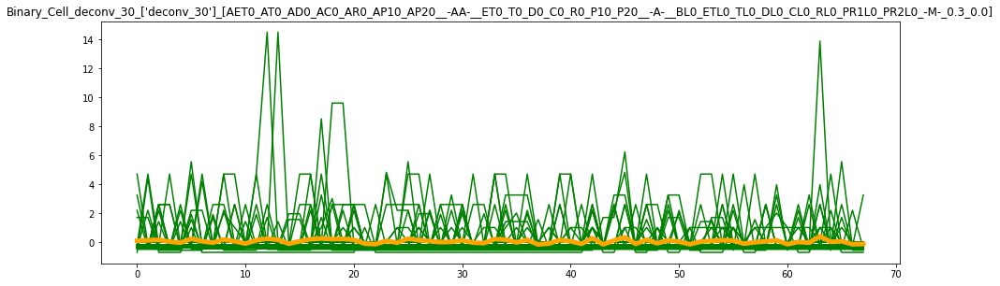


 Zero baseline detected: Binary_Cell_deconv_33: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_22: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_24: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_26: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_33: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_44: Max_0.0  Min_0.0


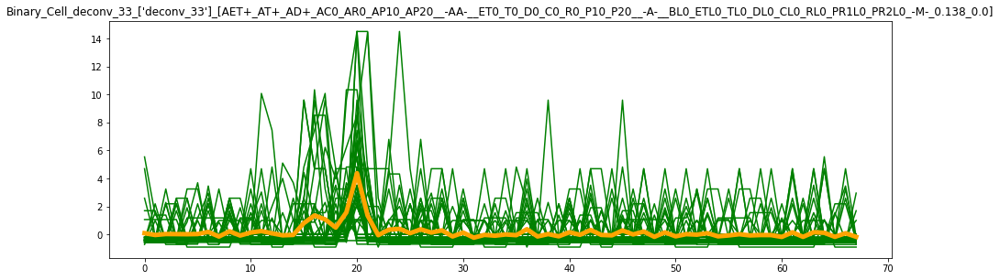


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_22: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_24: Max_0.0  Min_0.0


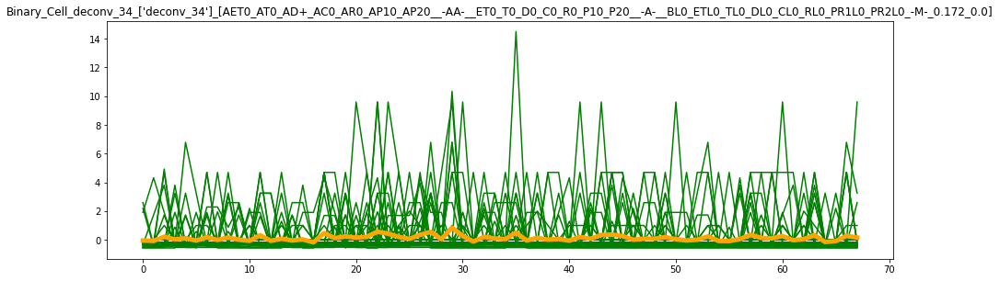


 Zero baseline detected: Binary_Cell_deconv_38: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_22: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_23: Max_0.0  Min_0.0

 Zero baseline

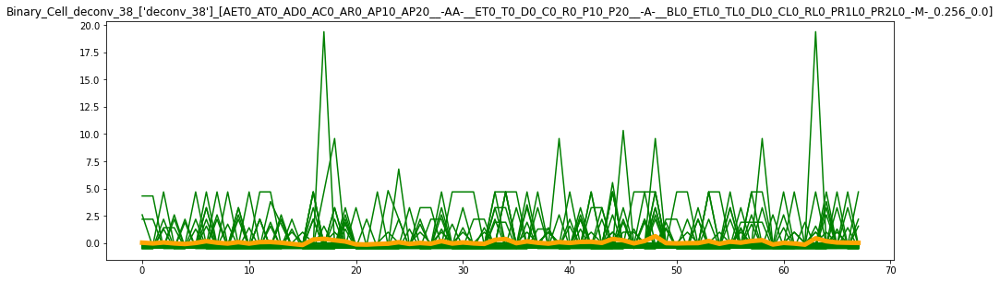


 Zero baseline detected: Binary_Cell_deconv_39: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_23: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_24: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_26: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_29: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_42: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_43: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_44: Max_0.0  Min_0.0


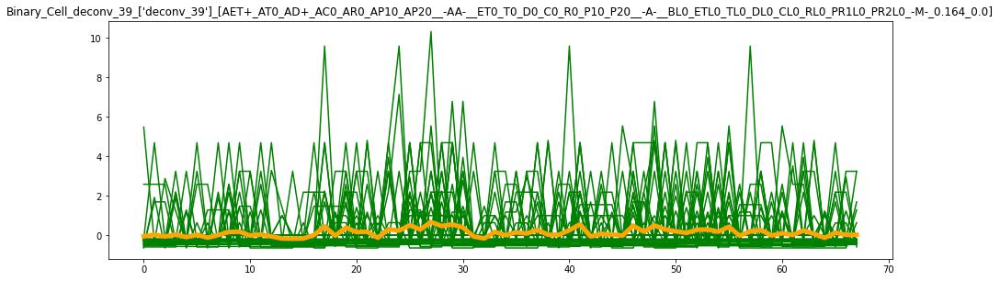


 Zero baseline detected: Binary_Cell_deconv_40: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_18: Max_0.0  Min_0.0

 Zero baseline de

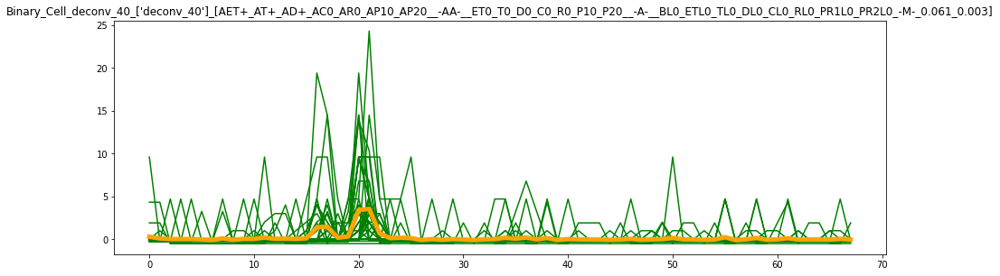


 Zero baseline detected: Binary_Cell_deconv_41: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_22: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_23: Max_0.0  Min_0.0

 Zero baseline de

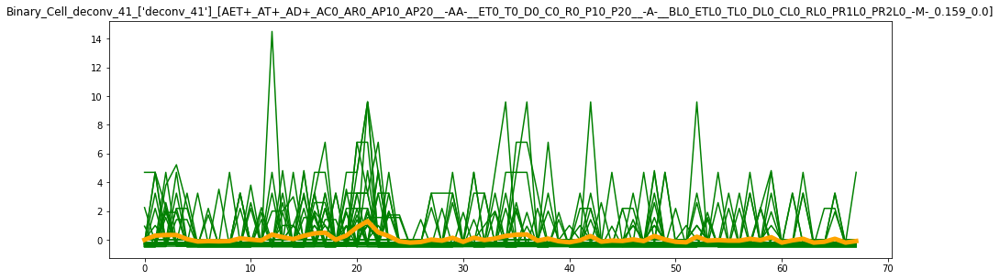


 Zero baseline detected: Binary_Cell_deconv_42: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_24: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_25: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_30: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_32: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_36: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_40: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_41: Max_0.0  Min_0.0


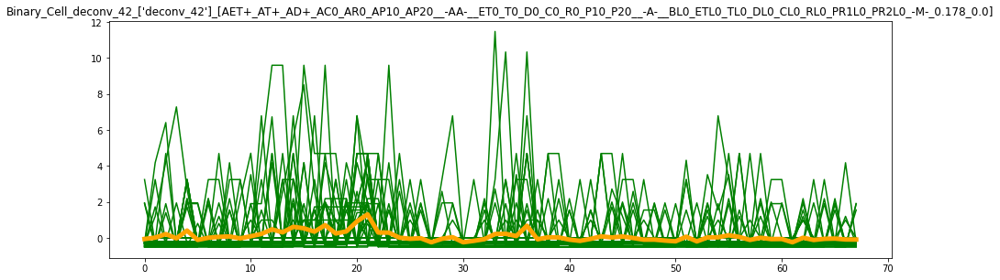


 Zero baseline detected: Binary_Cell_deconv_43: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_16: Max_0.0  Min_0.0

 Zero baseline det

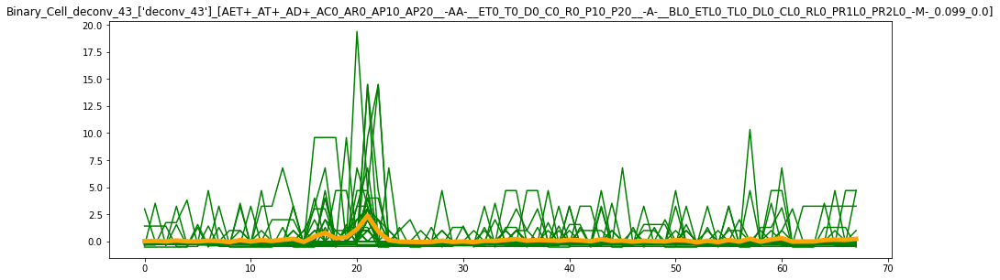


 Zero baseline detected: Binary_Cell_deconv_44: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_20: Max_0.0  Min_0.0

 Zero baseline det

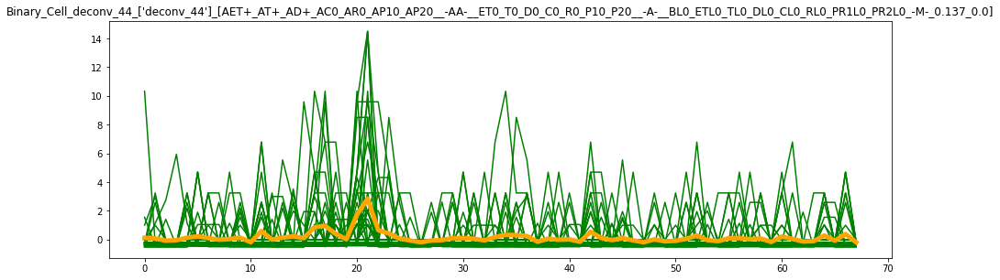


 Zero baseline detected: Binary_Cell_deconv_48: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_26: Max_0.0  Min_0.0


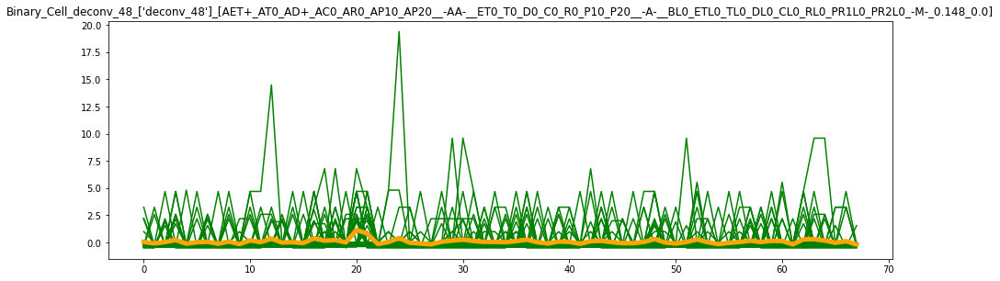


 Zero baseline detected: Binary_Cell_deconv_50: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_22: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_24: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_25: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_26: Max_0.0  Min_0.0

 Zero baseline

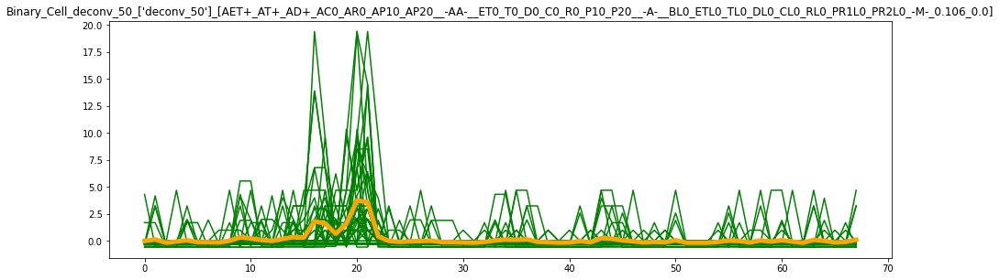


 Zero baseline detected: Binary_Cell_deconv_52: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_17: Max_0.0  Min_0.0

 Zero baseline d

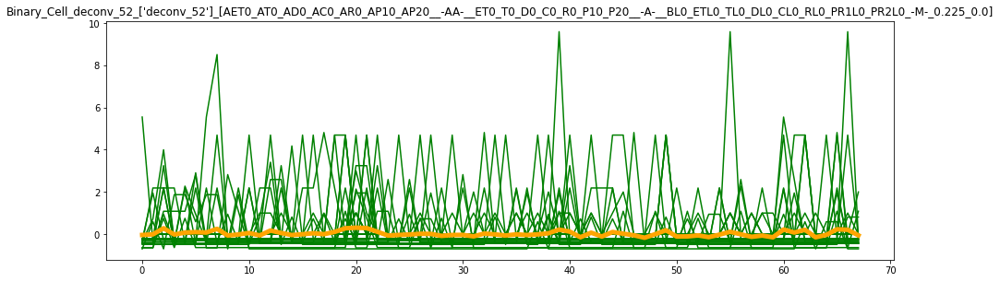

,Trial_0,Trial_1,Trial_2,Trial_3,Trial_4,Trial_5,Trial_6,Trial_7,Trial_8,Trial_9,Trial_10,Trial_11,Trial_12,Trial_13,Trial_14,Trial_15,Trial_16,Trial_17,Trial_18,Trial_19,Trial_20,Trial_21,Trial_22,Trial_23,Trial_24,Trial_25,Trial_26,Trial_27,Trial_28,Trial_29,Trial_30,Trial_31,Trial_32,Trial_33,Trial_34,Trial_35,Trial_36,Trial_37,Trial_38,Trial_39,Trial_40,Trial_41,Trial_42,Trial_43,Trial_44
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
9,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,0.083465,0.089897,-0.049052,0.035835,-0.051330,0.288562,0.003912,-0.052893,0.015994,0.114591,0.051442,-0.003417,-0.038237
1,0.118990,-0.036932,-0.073490,-0.029944,0.033761,0.093052,0.294860,0.023016,0.036648,0.081563,-0.080120,0.145981,-0.009102
2,0.150567,0.030688,0.217533,0.053993,-0.058963,0.018995,0.338162,0.219493,-0.004525,-0.074406,0.039857,-0.160790,0.280007
3,0.027700,0.025112,0.029059,-0.029496,0.040887,0.018995,0.335275,-0.016309,0.076044,-0.044993,0.229202,-0.051924,-0.015775
4,-0.046770,0.017356,0.105747,-0.083510,-0.089623,0.018995,0.051155,0.413676,-0.000179,0.129758,-0.107864,0.066170,0.074255
5,0.221379,0.030553,-0.048416,0.012191,0.033748,-0.011161,-0.112334,-0.102731,-0.008413,0.227628,0.021340,-0.110551,0.096614
6,0.053627,0.184407,0.179505,0.172870,-0.117979,-0.089871,-0.086523,0.014297,0.058193,0.105815,0.067355,-0.111234,0.077187
7,-0.043139,-0.145547,-0.005834,0.037568,0.016517,0.097705,-0.103723,0.065051,0.026637,-0.008048,-0.115743,-0.138568,0.251833
8,0.173605,0.222766,0.162501,-0.040436,0.167018,-0.067649,-0.082178,0.088790,-0.070253,0.035762,0.087119,0.020538,-0.062999
9,0.049922,-0.076652,0.013450,0.086122,0.186209,0.041217,0.103459,-0.019561,0.118001,0.134890,-0.144014,0.331512,-0.015775


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,0.083465,0.089897,-0.049052,0.035835,-0.051330,0.288562,0.003912,-0.052893,0.015994,0.114591,0.051442,-0.003417,-0.038237
1,0.118990,-0.036932,-0.073490,-0.029944,0.033761,0.093052,0.294860,0.023016,0.036648,0.081563,-0.080120,0.145981,-0.009102
2,0.150567,0.030688,0.217533,0.053993,-0.058963,0.018995,0.338162,0.219493,-0.004525,-0.074406,0.039857,-0.160790,0.280007
3,0.027700,0.025112,0.029059,-0.029496,0.040887,0.018995,0.335275,-0.016309,0.076044,-0.044993,0.229202,-0.051924,-0.015775
4,-0.046770,0.017356,0.105747,-0.083510,-0.089623,0.018995,0.051155,0.413676,-0.000179,0.129758,-0.107864,0.066170,0.074255
5,0.221379,0.030553,-0.048416,0.012191,0.033748,-0.011161,-0.112334,-0.102731,-0.008413,0.227628,0.021340,-0.110551,0.096614
6,0.053627,0.184407,0.179505,0.172870,-0.117979,-0.089871,-0.086523,0.014297,0.058193,0.105815,0.067355,-0.111234,0.077187
7,-0.043139,-0.145547,-0.005834,0.037568,0.016517,0.097705,-0.103723,0.065051,0.026637,-0.008048,-0.115743,-0.138568,0.251833
8,0.173605,0.222766,0.162501,-0.040436,0.167018,-0.067649,-0.082178,0.088790,-0.070253,0.035762,0.087119,0.020538,-0.062999
9,0.049922,-0.076652,0.013450,0.086122,0.186209,0.041217,0.103459,-0.019561,0.118001,0.134890,-0.144014,0.331512,-0.015775


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [83]:
########################################
# ##### All Trials (Trial Initiation (5s before/5s after)) 
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= 'All_Trials'


#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda


Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


    #############################################   
    # Calculates mean of bins across all Trial   


    Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
    Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

    Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
    Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


    ##################################################
    #Plot to validate trials and average of trials
    for i in range(Num_Trial_analysis):

        #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


    #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
    plt_raw.show()
    ######################################################


#Info = trial type, num of trials, bin size, duration 

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

##########################################################################
######################## Part 2  Saves Data ######################

########################################

######################################

display(Cell_Baseline_Bin_Data_df)

Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
#for x in range(3):
    tempa = '[' + Perm_Table_panda['Classify'][x] +']'
    tempb =  Perm_Table_panda['Cell_ID'][x]
    #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
    tempc = str([len(Filtered_Trial_Num_All_Reward)])
    tempd = str(Behavioral_Performance['Trials_Initiated']) 
    tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
    temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])
    
    #print(temp_name)
    


    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    
    
display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




Filter = '[R-]'
NumofCell_Filtered = 0
CellList_Filtered = []
for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
    if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_Filtered = NumofCell_Filtered+1
        CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
print('NumofCell_Filtered = ',NumofCell_Filtered)
print('CellList_Filtered =', CellList_Filtered)

Filtered_df = pd.DataFrame()

for i in range(NumofCell_Filtered):
    Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

display(Filtered_df)


# OLD way
# filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


filename = '_Avg_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Base_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)




 Zero baseline detected: Binary_Cell_deconv_30: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_3: Max_0.0  Min_0.0


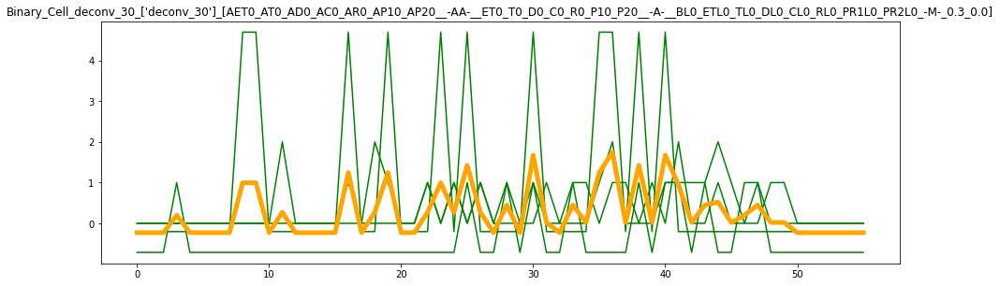


 Zero baseline detected: Binary_Cell_deconv_33: Trial_3: Max_0.0  Min_0.0


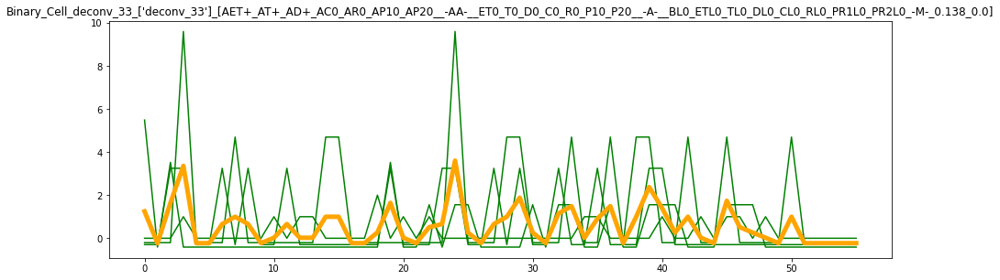


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0


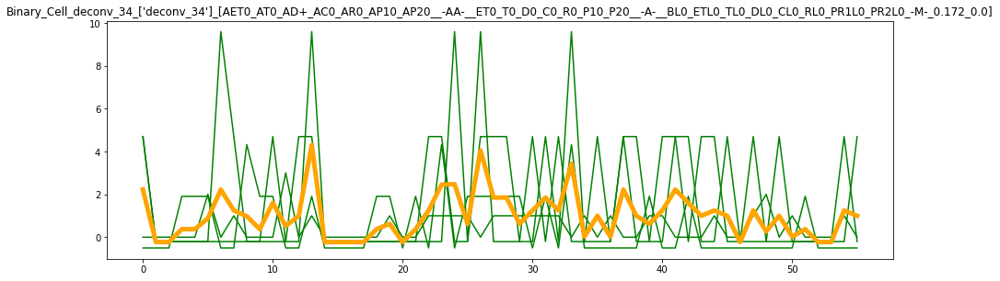


 Zero baseline detected: Binary_Cell_deconv_38: Trial_0: Max_0.0  Min_0.0


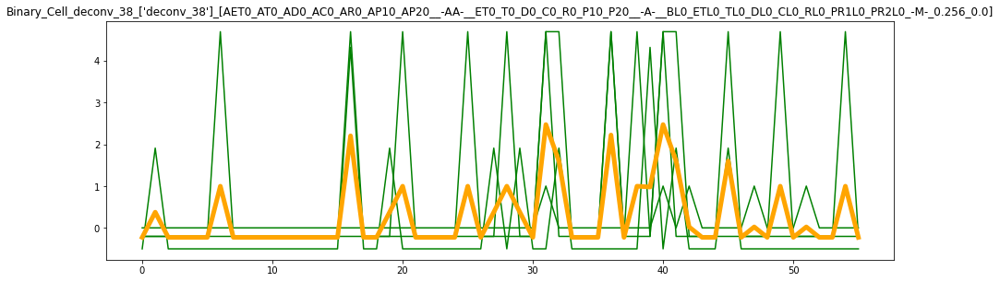


 Zero baseline detected: Binary_Cell_deconv_39: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_3: Max_0.0  Min_0.0


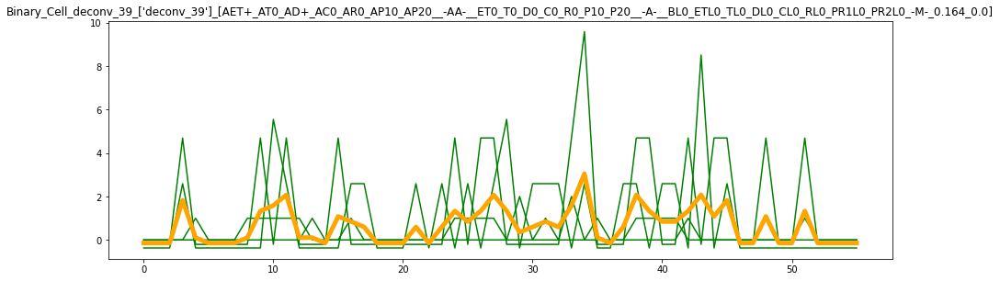


 Zero baseline detected: Binary_Cell_deconv_40: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0


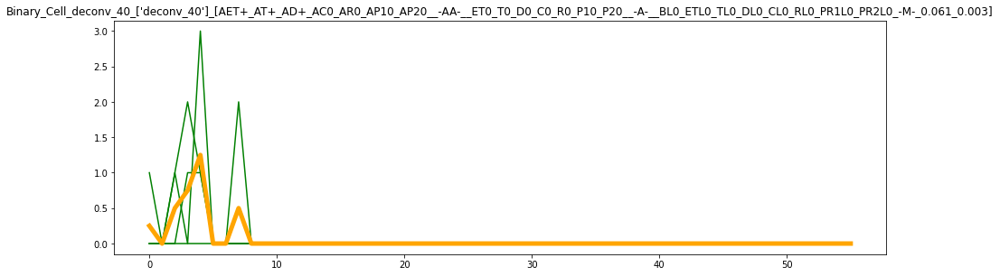


 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0


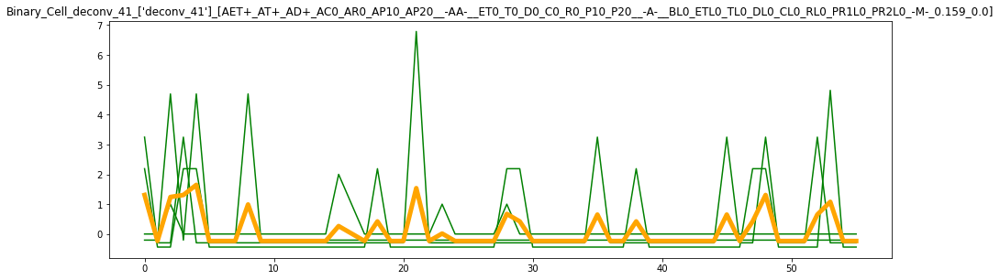

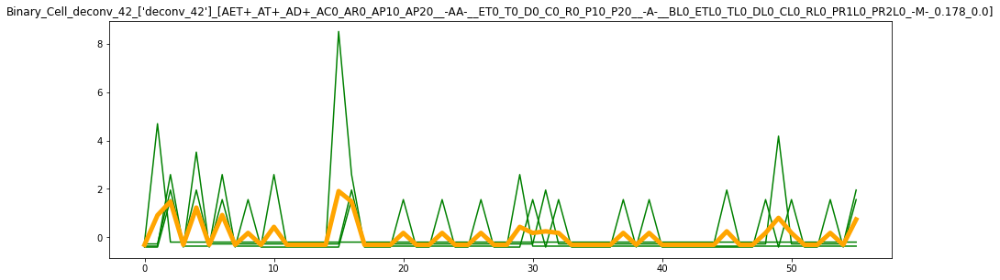


 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_3: Max_0.0  Min_0.0


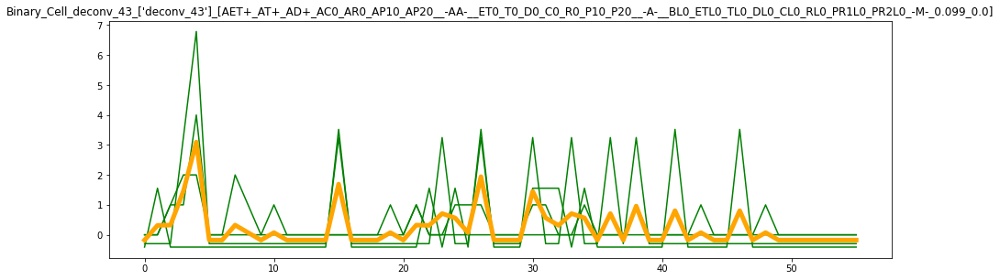


 Zero baseline detected: Binary_Cell_deconv_44: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_1: Max_0.0  Min_0.0


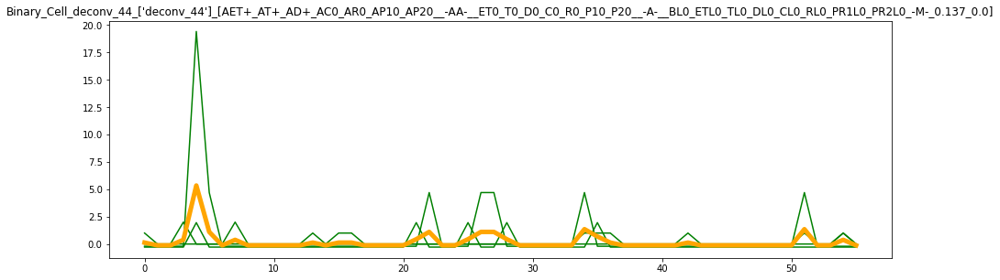


 Zero baseline detected: Binary_Cell_deconv_48: Trial_0: Max_0.0  Min_0.0


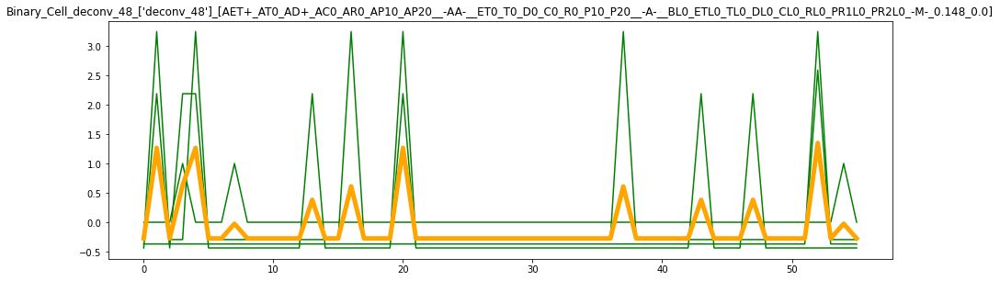


 Zero baseline detected: Binary_Cell_deconv_50: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_2: Max_0.0  Min_0.0


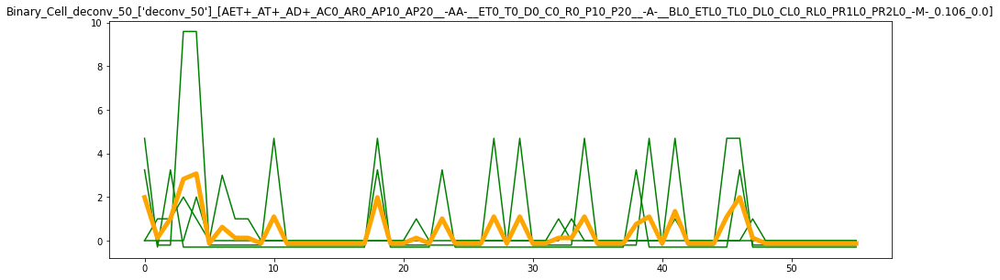


 Zero baseline detected: Binary_Cell_deconv_52: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_3: Max_0.0  Min_0.0


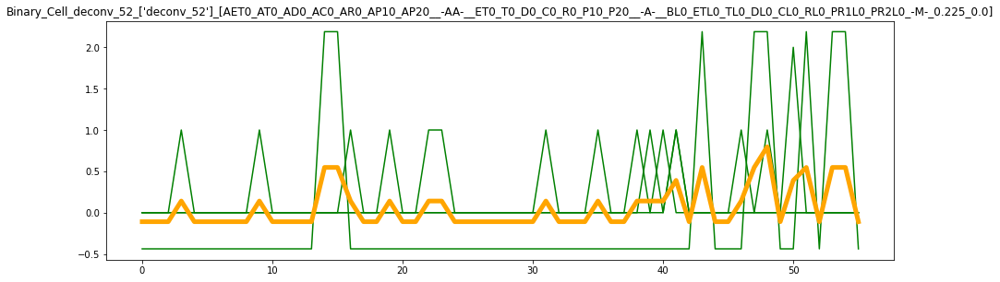

,Trial_0,Trial_1,Trial_2,Trial_3
0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0
2,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,0.0
4,0.0,1.0,0.0,0.0
5,0.0,1.0,0.0,0.0
6,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,-0.229523,1.246392,2.221881,-0.227609,-0.143533,0.25,1.307914,-0.315550,-0.176120,0.129281,-0.275742,1.985412,-0.109449
1,-0.229523,-0.227151,-0.227609,0.375017,-0.143533,0.00,-0.234271,0.909195,0.315061,-0.120719,1.266444,0.125178,-0.109449
2,-0.229523,1.640700,-0.227609,-0.227609,-0.143533,0.50,1.240474,1.473148,0.323880,-0.120719,-0.275742,1.010667,-0.109449
3,0.198858,3.357828,0.375017,-0.227609,1.821225,0.75,1.307914,-0.315550,1.459369,0.379281,0.630955,2.824668,0.140551
4,-0.229523,-0.227151,0.375017,-0.227609,0.106467,1.25,1.647170,1.224316,3.094858,5.335765,1.266444,3.074668,-0.109449
5,-0.229523,-0.227151,0.875017,-0.227609,-0.143533,0.00,-0.234271,-0.315550,-0.176120,1.104026,-0.275742,-0.124822,-0.109449
6,-0.229523,0.658338,2.221881,0.997136,-0.143533,0.00,-0.234271,0.915644,-0.176120,-0.120719,-0.275742,0.625178,-0.109449
7,-0.229523,0.997594,1.247136,-0.227609,-0.143533,0.50,-0.234271,-0.315550,0.323880,0.379281,-0.025742,0.125178,-0.109449
8,0.995222,0.658338,0.977643,-0.227609,0.106467,0.00,0.990474,0.175631,0.073880,-0.120719,-0.275742,0.125178,-0.109449
9,0.995222,-0.227151,0.375017,-0.227609,1.331212,0.00,-0.234271,-0.315550,-0.176120,-0.120719,-0.275742,-0.124822,0.140551


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,-0.229523,1.246392,2.221881,-0.227609,-0.143533,0.25,1.307914,-0.315550,-0.176120,0.129281,-0.275742,1.985412,-0.109449
1,-0.229523,-0.227151,-0.227609,0.375017,-0.143533,0.00,-0.234271,0.909195,0.315061,-0.120719,1.266444,0.125178,-0.109449
2,-0.229523,1.640700,-0.227609,-0.227609,-0.143533,0.50,1.240474,1.473148,0.323880,-0.120719,-0.275742,1.010667,-0.109449
3,0.198858,3.357828,0.375017,-0.227609,1.821225,0.75,1.307914,-0.315550,1.459369,0.379281,0.630955,2.824668,0.140551
4,-0.229523,-0.227151,0.375017,-0.227609,0.106467,1.25,1.647170,1.224316,3.094858,5.335765,1.266444,3.074668,-0.109449
5,-0.229523,-0.227151,0.875017,-0.227609,-0.143533,0.00,-0.234271,-0.315550,-0.176120,1.104026,-0.275742,-0.124822,-0.109449
6,-0.229523,0.658338,2.221881,0.997136,-0.143533,0.00,-0.234271,0.915644,-0.176120,-0.120719,-0.275742,0.625178,-0.109449
7,-0.229523,0.997594,1.247136,-0.227609,-0.143533,0.50,-0.234271,-0.315550,0.323880,0.379281,-0.025742,0.125178,-0.109449
8,0.995222,0.658338,0.977643,-0.227609,0.106467,0.00,0.990474,0.175631,0.073880,-0.120719,-0.275742,0.125178,-0.109449
9,0.995222,-0.227151,0.375017,-0.227609,1.331212,0.00,-0.234271,-0.315550,-0.176120,-0.120719,-0.275742,-0.124822,0.140551


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [84]:
########################################
# ##### Reward Trials (reward window)
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = 'Reward_Start_5s_Bfr'
Signal_End = 'Post_Rewrd_Win_BLk_2_End'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
#Bin = 20   # Bin size
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= 'Rewarded'


#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission

Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


    #############################################   
    # Calculates mean of bins across all Trial   


    Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
    Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

    Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
    Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


    ##################################################
    #Plot to validate trials and average of trials
    for i in range(Num_Trial_analysis):

        #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


    #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
    plt_raw.show()
    ######################################################


#Info = trial type, num of trials, bin size, duration 

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

##########################################################################
######################## Part 2  Saves Data ######################

########################################

######################################

display(Cell_Baseline_Bin_Data_df)

Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
#for x in range(3):
    tempa = '[' + Perm_Table_panda['Classify'][x] +']'
    tempb =  Perm_Table_panda['Cell_ID'][x]
    #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
    tempc = str([len(Filtered_Trial_Num_All_Reward)])
    tempd = str(Behavioral_Performance['Trials_Initiated']) 
    #temp_name = str([tempa]+[tempb]+[tempc])
    tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
    temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])
    
    #print(temp_name)
    


    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    
    
display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




Filter = '[R-]'
NumofCell_Filtered = 0
CellList_Filtered = []
for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
    if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_Filtered = NumofCell_Filtered+1
        CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
print('NumofCell_Filtered = ',NumofCell_Filtered)
print('CellList_Filtered =', CellList_Filtered)

Filtered_df = pd.DataFrame()

for i in range(NumofCell_Filtered):
    Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

display(Filtered_df)


# OLD way
# filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


filename = '_Avg_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Base_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)




 Zero baseline detected: Binary_Cell_deconv_30: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_19: Max_0.0  Min_0.0

 Zero baseline de

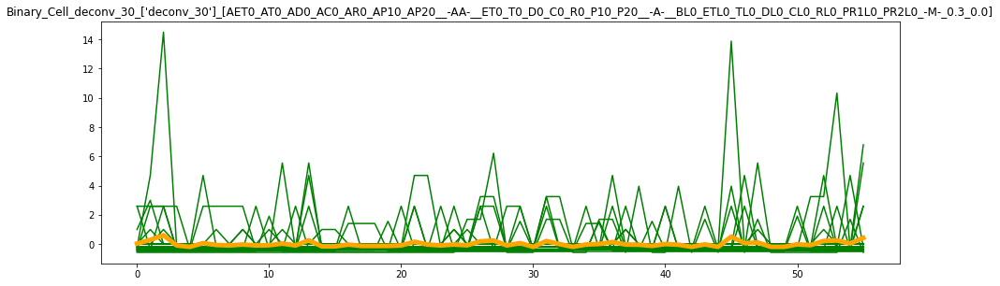


 Zero baseline detected: Binary_Cell_deconv_33: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_25: Max_0.0  Min_0.0


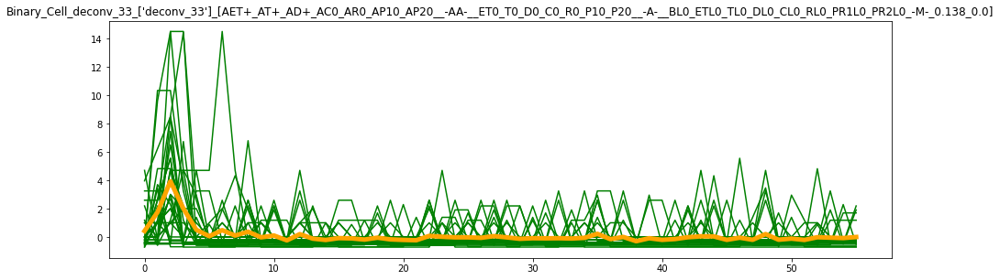


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_20: Max_0.0  Min_0.0


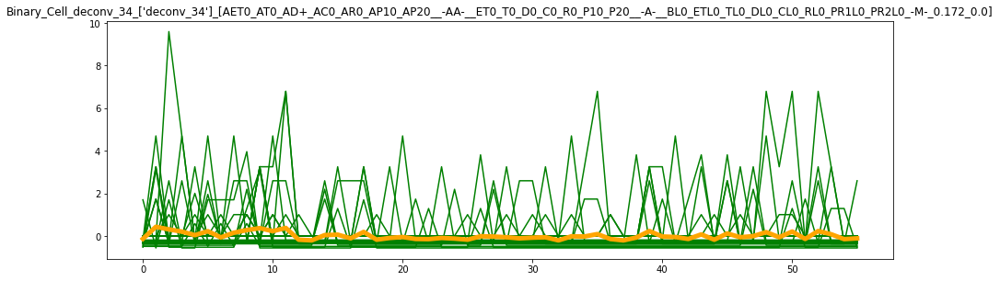


 Zero baseline detected: Binary_Cell_deconv_38: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_21: Max_0.0  Min_0.0

 Zero baseline 

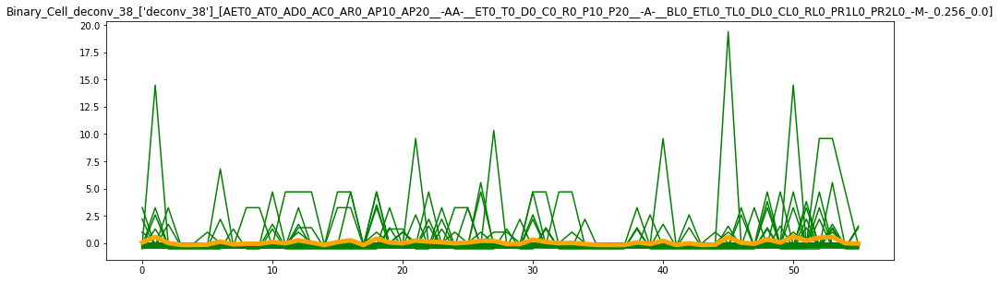


 Zero baseline detected: Binary_Cell_deconv_39: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_30: Max_0.0  Min_0.0


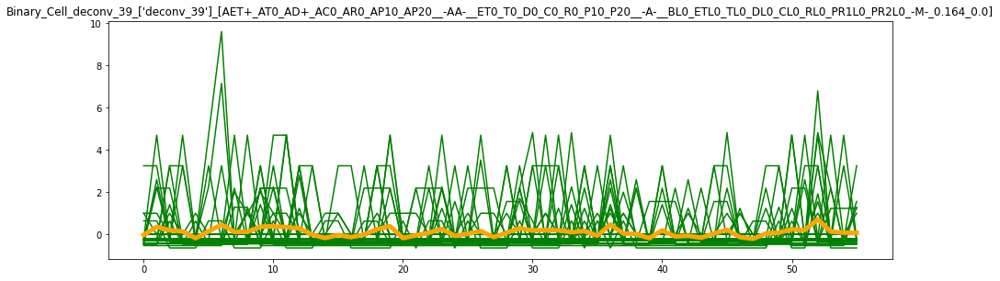


 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_19: Max_0.0  Min_0.0

 Zero baseline det

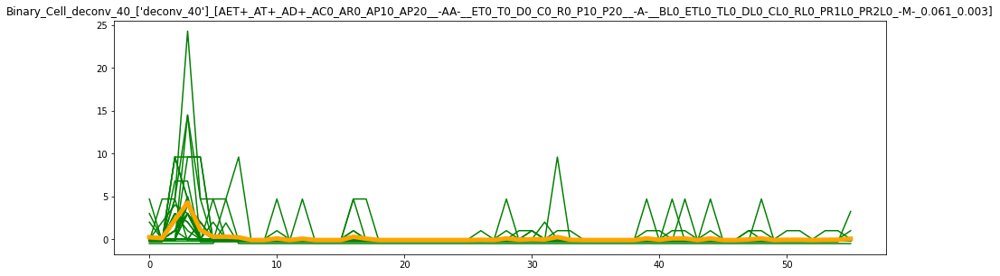


 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_20: Max_0.0  Min_0.0

 Zero baseline de

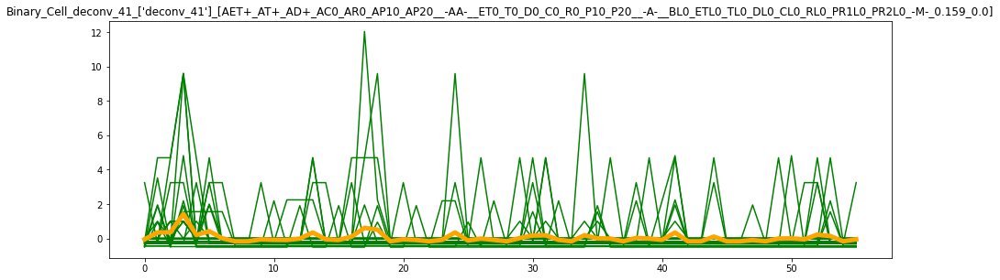


 Zero baseline detected: Binary_Cell_deconv_42: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_23: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_27: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_29: Max_0.0  Min_0.0


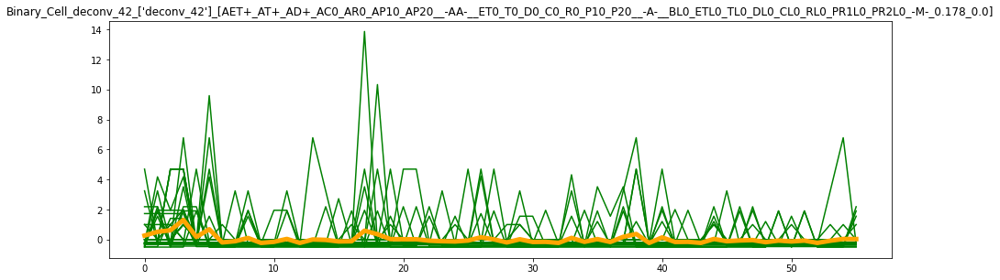


 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_15: Max_0.0  Min_0.0

 Zero baseline dete

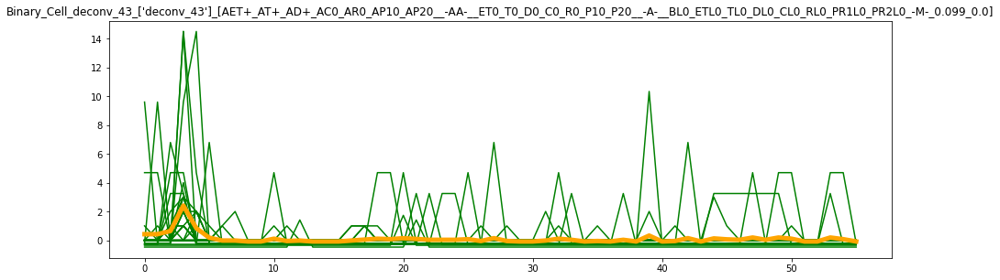


 Zero baseline detected: Binary_Cell_deconv_44: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_17: Max_0.0  Min_0.0

 Zero baseline dete

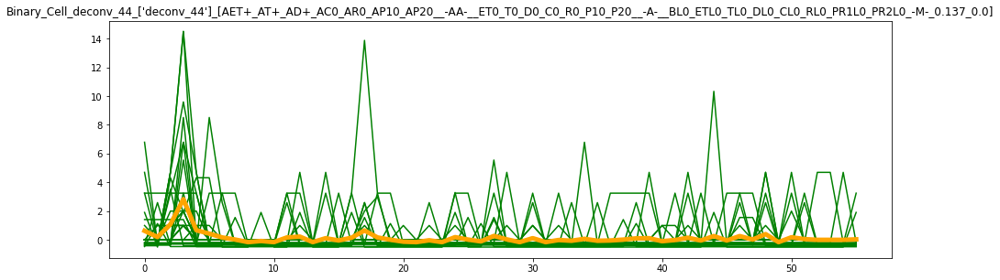


 Zero baseline detected: Binary_Cell_deconv_48: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_21: Max_0.0  Min_0.0


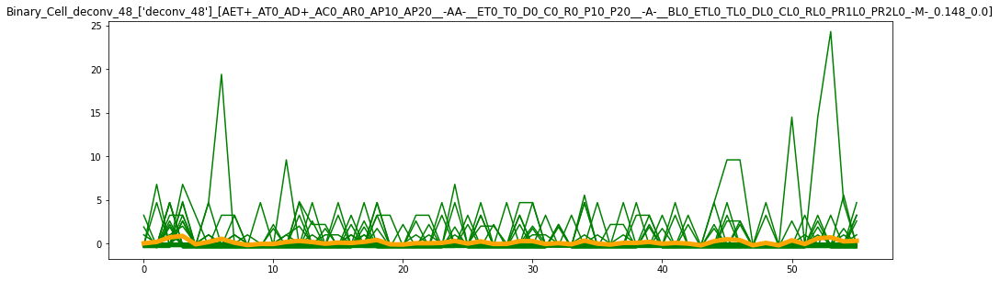


 Zero baseline detected: Binary_Cell_deconv_50: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_22: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_23: Max_0.0  Min_0.0

 Zero baseline 

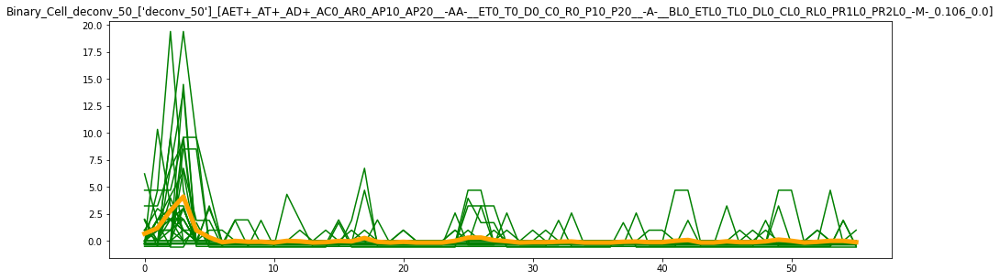


 Zero baseline detected: Binary_Cell_deconv_52: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_18: Max_0.0  Min_0.0

 Zero baseline de

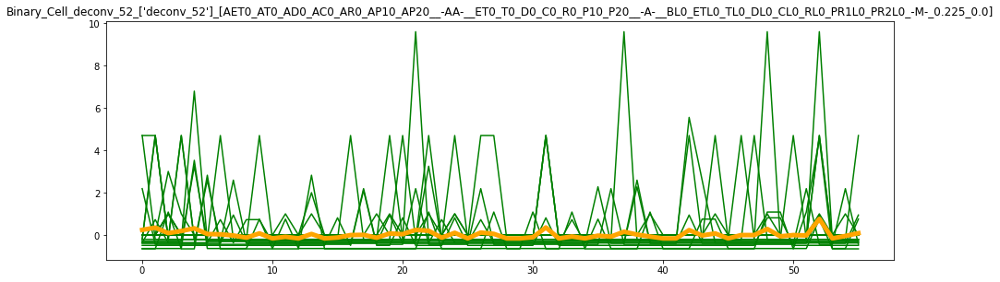

,Trial_0,Trial_1,Trial_2,Trial_3,Trial_4,Trial_5,Trial_6,Trial_7,Trial_8,Trial_9,Trial_10,Trial_11,Trial_12,Trial_13,Trial_14,Trial_15,Trial_16,Trial_17,Trial_18,Trial_19,Trial_20,Trial_21,Trial_22,Trial_23,Trial_24,Trial_25,Trial_26,Trial_27,Trial_28,Trial_29,Trial_30
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,0.036843,0.421380,-0.136355,0.056831,-0.024713,0.227754,-0.051880,0.264571,0.425115,0.628288,0.028924,0.681209,0.241280
1,0.291649,1.745441,0.428535,0.568066,0.360297,0.130980,0.346558,0.515960,0.425115,0.196902,0.191196,1.191623,0.349761
2,0.606424,3.928627,0.307452,0.006827,0.196092,2.236650,0.360958,0.618452,0.645370,1.081643,0.715498,2.802966,0.090056
3,-0.090900,2.001398,0.202266,-0.174418,0.141713,4.271837,1.420683,1.304925,2.408270,2.827547,0.876925,4.110483,0.188804
4,-0.186386,0.505195,0.036377,-0.174418,-0.177836,1.082429,0.201788,0.174325,0.841211,0.671659,-0.081092,0.988099,0.317463
5,0.067131,0.051290,0.221356,-0.142160,0.147819,0.289012,0.420239,0.685901,0.179534,0.431022,0.185231,0.333392,0.048018
6,-0.058642,0.477741,-0.069468,0.138830,0.463882,0.302254,0.011498,-0.191700,-0.016721,0.166533,0.551034,-0.113428,0.033698
7,-0.090900,0.099653,0.149420,-0.115771,0.121098,0.224496,-0.166137,-0.109701,-0.016721,0.020169,0.097681,0.004008,-0.021056
8,-0.026384,0.370881,0.274587,-0.060162,0.121685,-0.091568,-0.166137,0.103371,-0.081238,-0.157466,-0.163090,-0.073750,-0.124333
9,-0.090900,-0.027734,0.365039,-0.060162,0.363083,-0.091568,-0.051880,-0.223958,-0.081238,-0.079708,-0.037317,-0.067928,0.078435


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,0.036843,0.421380,-0.136355,0.056831,-0.024713,0.227754,-0.051880,0.264571,0.425115,0.628288,0.028924,0.681209,0.241280
1,0.291649,1.745441,0.428535,0.568066,0.360297,0.130980,0.346558,0.515960,0.425115,0.196902,0.191196,1.191623,0.349761
2,0.606424,3.928627,0.307452,0.006827,0.196092,2.236650,0.360958,0.618452,0.645370,1.081643,0.715498,2.802966,0.090056
3,-0.090900,2.001398,0.202266,-0.174418,0.141713,4.271837,1.420683,1.304925,2.408270,2.827547,0.876925,4.110483,0.188804
4,-0.186386,0.505195,0.036377,-0.174418,-0.177836,1.082429,0.201788,0.174325,0.841211,0.671659,-0.081092,0.988099,0.317463
5,0.067131,0.051290,0.221356,-0.142160,0.147819,0.289012,0.420239,0.685901,0.179534,0.431022,0.185231,0.333392,0.048018
6,-0.058642,0.477741,-0.069468,0.138830,0.463882,0.302254,0.011498,-0.191700,-0.016721,0.166533,0.551034,-0.113428,0.033698
7,-0.090900,0.099653,0.149420,-0.115771,0.121098,0.224496,-0.166137,-0.109701,-0.016721,0.020169,0.097681,0.004008,-0.021056
8,-0.026384,0.370881,0.274587,-0.060162,0.121685,-0.091568,-0.166137,0.103371,-0.081238,-0.157466,-0.163090,-0.073750,-0.124333
9,-0.090900,-0.027734,0.365039,-0.060162,0.363083,-0.091568,-0.051880,-0.223958,-0.081238,-0.079708,-0.037317,-0.067928,0.078435


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [85]:
########################################
# ##### Omissions Trials (reward window)
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = 'Reward_Start_(Fake)_5s_Bfr'
Signal_End = 'Post_Rewrd_Win_BLk_2_End'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= 'Omission'


#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


    #############################################   
    # Calculates mean of bins across all Trial   


    Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
    Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

    Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
    Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


    ##################################################
    #Plot to validate trials and average of trials
    for i in range(Num_Trial_analysis):

        #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


    #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
    plt_raw.show()
    ######################################################


#Info = trial type, num of trials, bin size, duration 

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

##########################################################################
######################## Part 2  Saves Data ######################

########################################

######################################

display(Cell_Baseline_Bin_Data_df)

Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
#for x in range(3):
    tempa = '[' + Perm_Table_panda['Classify'][x] +']'
    tempb =  Perm_Table_panda['Cell_ID'][x]
    #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
    tempc = str([len(Filtered_Trial_Num_All_Reward)])
    tempd = str(Behavioral_Performance['Trials_Initiated']) 
    tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
    temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])
    
    #print(temp_name)
    


    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    
    
display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




Filter = '[R-]'
NumofCell_Filtered = 0
CellList_Filtered = []
for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
    if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_Filtered = NumofCell_Filtered+1
        CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
print('NumofCell_Filtered = ',NumofCell_Filtered)
print('CellList_Filtered =', CellList_Filtered)

Filtered_df = pd.DataFrame()

for i in range(NumofCell_Filtered):
    Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

display(Filtered_df)


# OLD way
# filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


filename = '_Avg_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Base_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)








 Zero baseline detected: Binary_Cell_deconv_30: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_3: Max_0.0  Min_0.0


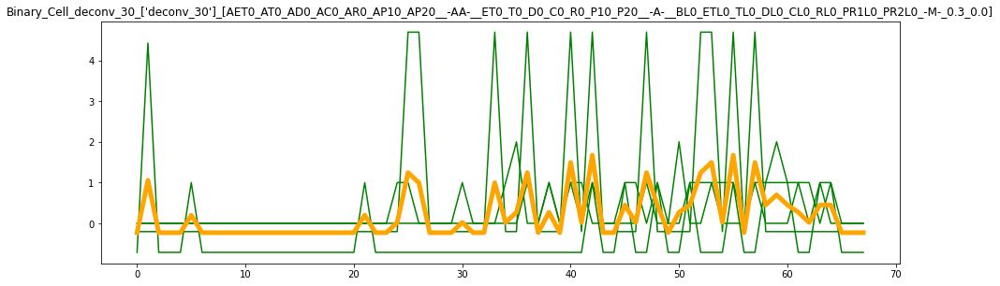


 Zero baseline detected: Binary_Cell_deconv_33: Trial_3: Max_0.0  Min_0.0


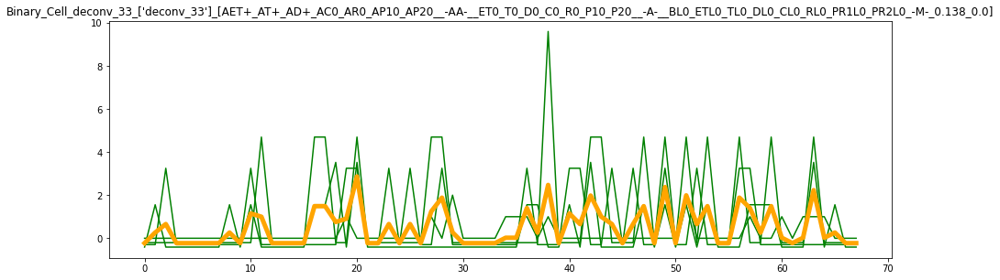


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0


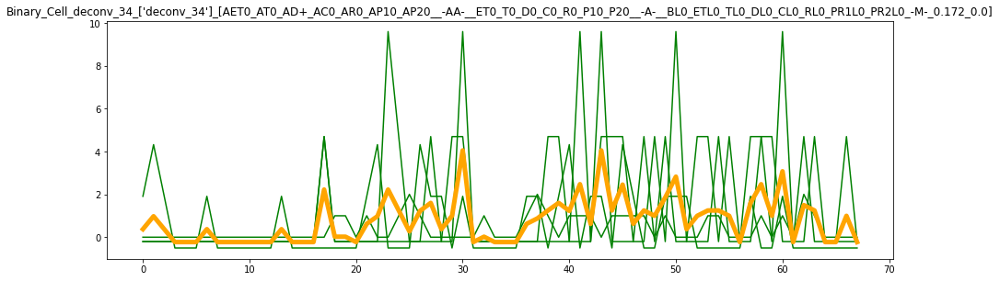


 Zero baseline detected: Binary_Cell_deconv_38: Trial_0: Max_0.0  Min_0.0


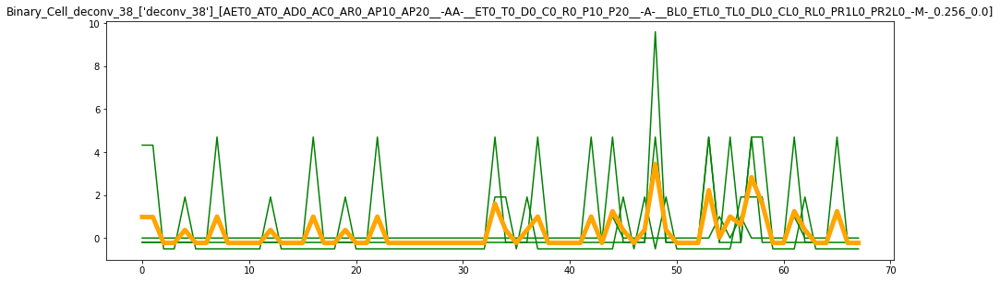


 Zero baseline detected: Binary_Cell_deconv_39: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_3: Max_0.0  Min_0.0


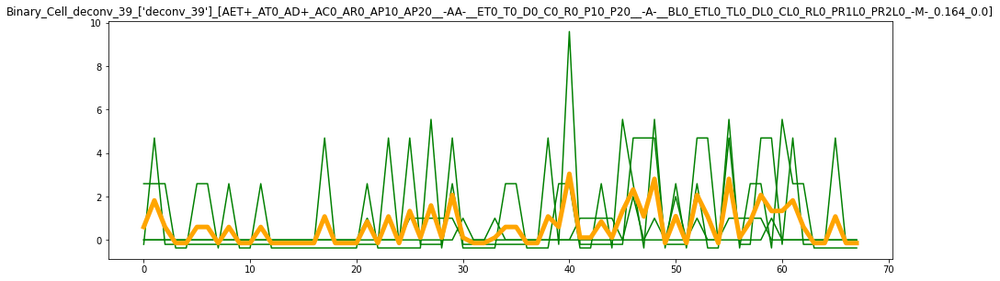


 Zero baseline detected: Binary_Cell_deconv_40: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0


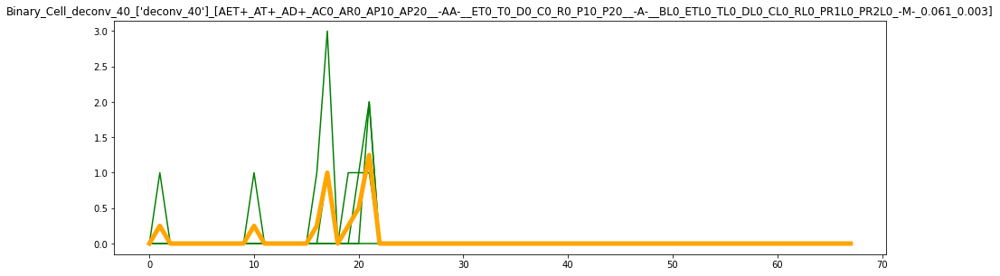


 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0


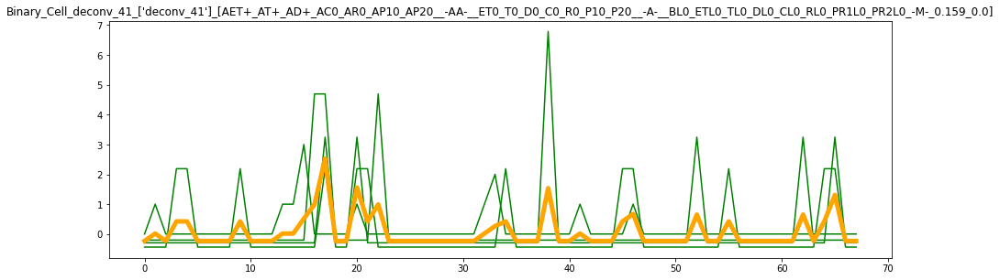

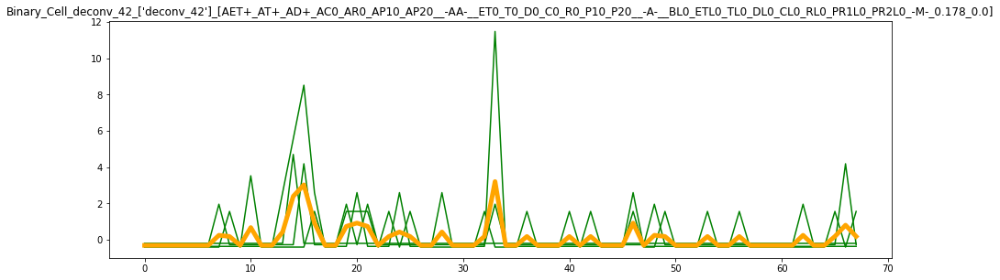


 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_3: Max_0.0  Min_0.0


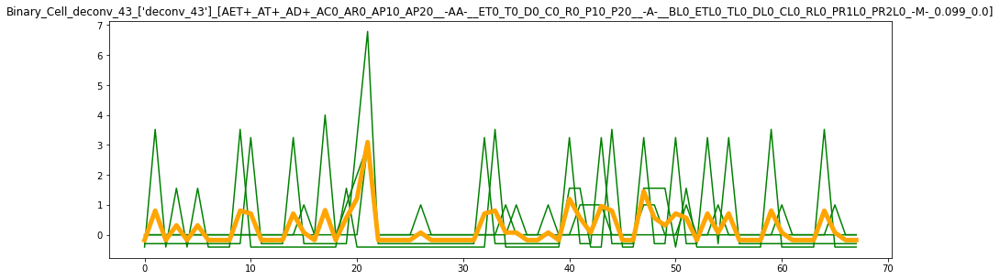


 Zero baseline detected: Binary_Cell_deconv_44: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_1: Max_0.0  Min_0.0


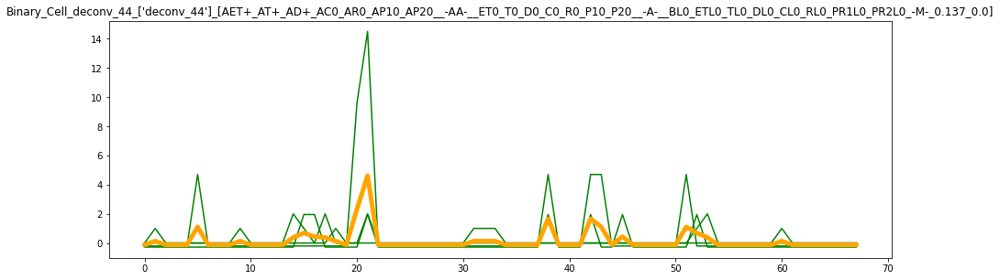


 Zero baseline detected: Binary_Cell_deconv_48: Trial_0: Max_0.0  Min_0.0


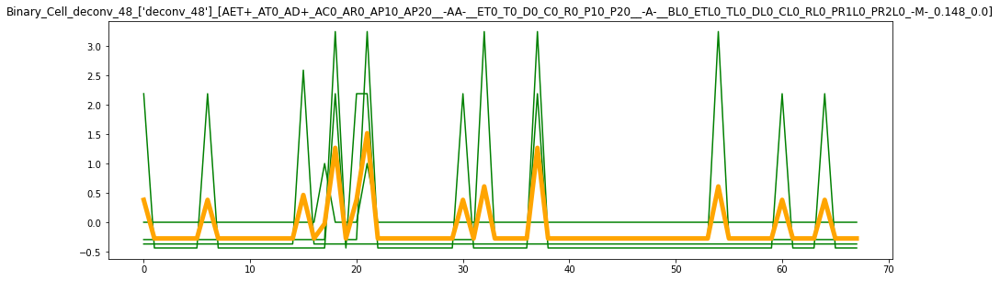


 Zero baseline detected: Binary_Cell_deconv_50: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_2: Max_0.0  Min_0.0


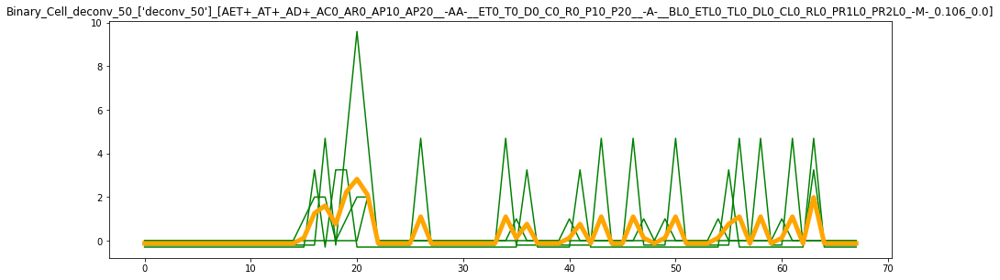


 Zero baseline detected: Binary_Cell_deconv_52: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_3: Max_0.0  Min_0.0


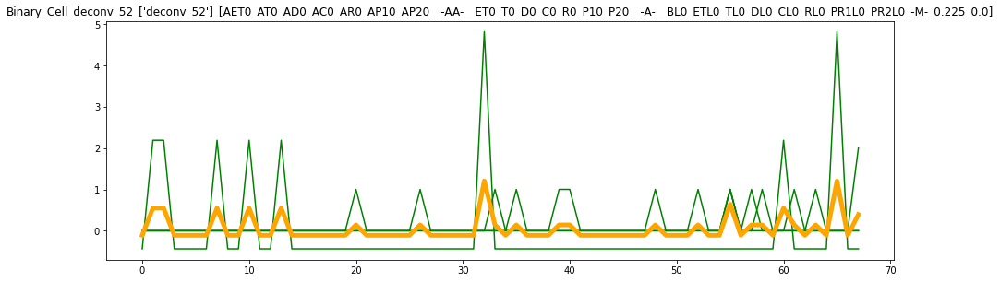

,Trial_0,Trial_1,Trial_2,Trial_3
0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0
2,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,0.0
4,0.0,1.0,0.0,0.0
5,0.0,1.0,0.0,0.0
6,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,-0.229523,-0.227151,0.375017,0.977643,0.596480,0.00,-0.234271,-0.315550,-0.176120,-0.120719,0.380955,-0.124822,-0.109449
1,1.055621,0.264030,0.977643,0.977643,1.821225,0.25,0.015729,-0.315550,0.806242,0.129281,-0.275742,-0.124822,0.547247
2,-0.229523,0.658338,0.375017,-0.227609,0.596480,0.00,-0.234271,-0.315550,-0.176120,-0.120719,-0.275742,-0.124822,0.547247
3,-0.229523,-0.227151,-0.227609,-0.227609,-0.143533,0.00,0.422425,-0.315550,0.315061,-0.120719,-0.275742,-0.124822,-0.109449
4,-0.229523,-0.227151,-0.227609,0.375017,-0.143533,0.00,0.422425,-0.315550,-0.176120,-0.120719,-0.275742,-0.124822,-0.109449
5,0.198858,-0.227151,-0.227609,-0.227609,0.596480,0.00,-0.234271,-0.315550,0.315061,1.104026,-0.275742,-0.124822,-0.109449
6,-0.229523,-0.227151,0.375017,-0.227609,0.596480,0.00,-0.234271,-0.315550,-0.176120,-0.120719,0.380955,-0.124822,-0.109449
7,-0.229523,-0.227151,-0.227609,0.997136,-0.143533,0.00,-0.234271,0.241954,-0.176120,-0.120719,-0.275742,-0.124822,0.547247
8,-0.229523,0.264030,-0.227609,-0.227609,0.596480,0.00,-0.234271,0.175631,-0.176120,-0.120719,-0.275742,-0.124822,-0.109449
9,-0.229523,-0.227151,-0.227609,-0.227609,-0.143533,0.00,0.422425,-0.315550,0.806242,0.129281,-0.275742,-0.124822,-0.109449


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,-0.229523,-0.227151,0.375017,0.977643,0.596480,0.00,-0.234271,-0.315550,-0.176120,-0.120719,0.380955,-0.124822,-0.109449
1,1.055621,0.264030,0.977643,0.977643,1.821225,0.25,0.015729,-0.315550,0.806242,0.129281,-0.275742,-0.124822,0.547247
2,-0.229523,0.658338,0.375017,-0.227609,0.596480,0.00,-0.234271,-0.315550,-0.176120,-0.120719,-0.275742,-0.124822,0.547247
3,-0.229523,-0.227151,-0.227609,-0.227609,-0.143533,0.00,0.422425,-0.315550,0.315061,-0.120719,-0.275742,-0.124822,-0.109449
4,-0.229523,-0.227151,-0.227609,0.375017,-0.143533,0.00,0.422425,-0.315550,-0.176120,-0.120719,-0.275742,-0.124822,-0.109449
5,0.198858,-0.227151,-0.227609,-0.227609,0.596480,0.00,-0.234271,-0.315550,0.315061,1.104026,-0.275742,-0.124822,-0.109449
6,-0.229523,-0.227151,0.375017,-0.227609,0.596480,0.00,-0.234271,-0.315550,-0.176120,-0.120719,0.380955,-0.124822,-0.109449
7,-0.229523,-0.227151,-0.227609,0.997136,-0.143533,0.00,-0.234271,0.241954,-0.176120,-0.120719,-0.275742,-0.124822,0.547247
8,-0.229523,0.264030,-0.227609,-0.227609,0.596480,0.00,-0.234271,0.175631,-0.176120,-0.120719,-0.275742,-0.124822,-0.109449
9,-0.229523,-0.227151,-0.227609,-0.227609,-0.143533,0.00,0.422425,-0.315550,0.806242,0.129281,-0.275742,-0.124822,-0.109449


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [86]:
########################################
# ##### Reward Trials (Trial Initiation (5s before/5s after)) 
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= 'Rewarded'


#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission

Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


    #############################################   
    # Calculates mean of bins across all Trial   


    Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
    Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

    Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
    Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


    ##################################################
    #Plot to validate trials and average of trials
    for i in range(Num_Trial_analysis):

        #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


    #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
    plt_raw.show()
    ######################################################


#Info = trial type, num of trials, bin size, duration 

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

##########################################################################
######################## Part 2  Saves Data ######################

########################################

######################################

display(Cell_Baseline_Bin_Data_df)

Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
#for x in range(3):
    tempa = '[' + Perm_Table_panda['Classify'][x] +']'
    tempb =  Perm_Table_panda['Cell_ID'][x]
    #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
    tempc = str([len(Filtered_Trial_Num_All_Reward)])
    tempd = str(Behavioral_Performance['Trials_Initiated']) 
    tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
    temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])
    
    #print(temp_name)
    


    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    
    
display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




Filter = '[R-]'
NumofCell_Filtered = 0
CellList_Filtered = []
for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
    if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_Filtered = NumofCell_Filtered+1
        CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
print('NumofCell_Filtered = ',NumofCell_Filtered)
print('CellList_Filtered =', CellList_Filtered)

Filtered_df = pd.DataFrame()

for i in range(NumofCell_Filtered):
    Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

display(Filtered_df)


# OLD way
# filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


filename = '_Avg_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Base_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)




 Zero baseline detected: Binary_Cell_deconv_30: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_19: Max_0.0  Min_0.0

 Zero baseline de

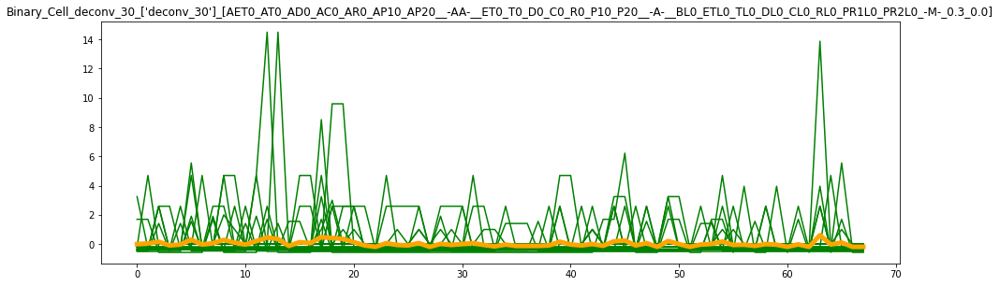


 Zero baseline detected: Binary_Cell_deconv_33: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_25: Max_0.0  Min_0.0


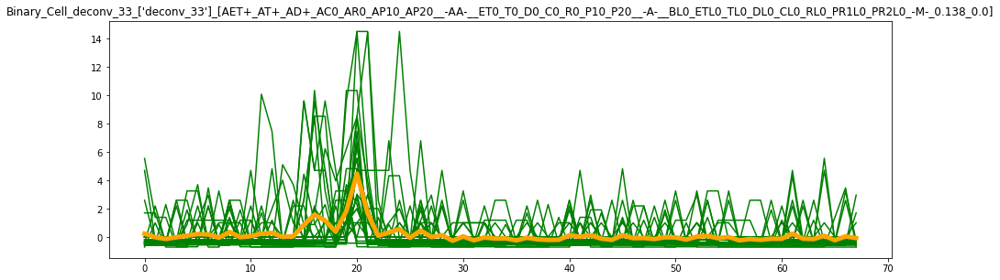


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_20: Max_0.0  Min_0.0


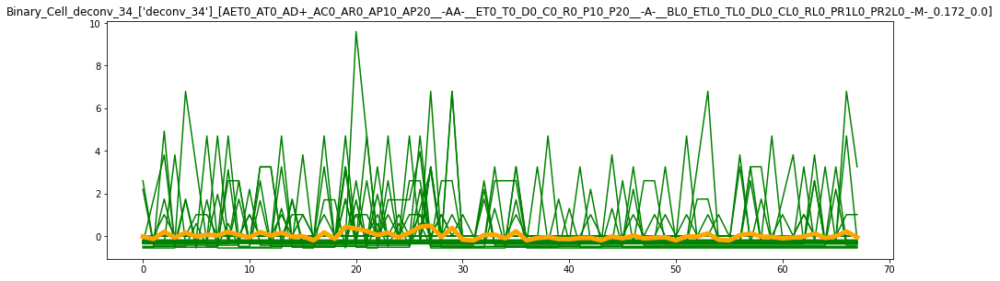


 Zero baseline detected: Binary_Cell_deconv_38: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_21: Max_0.0  Min_0.0

 Zero baseline 

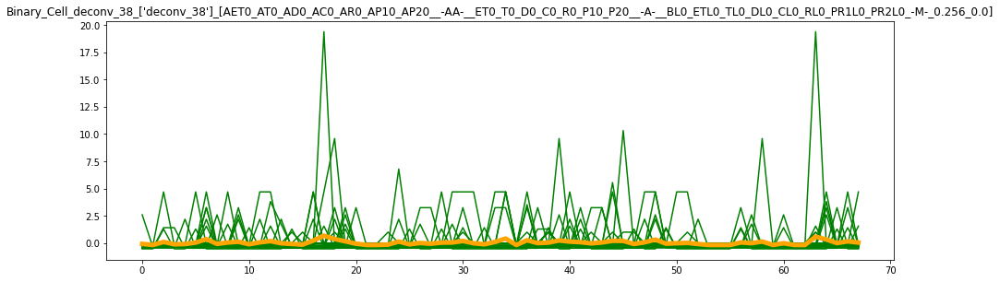


 Zero baseline detected: Binary_Cell_deconv_39: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_30: Max_0.0  Min_0.0


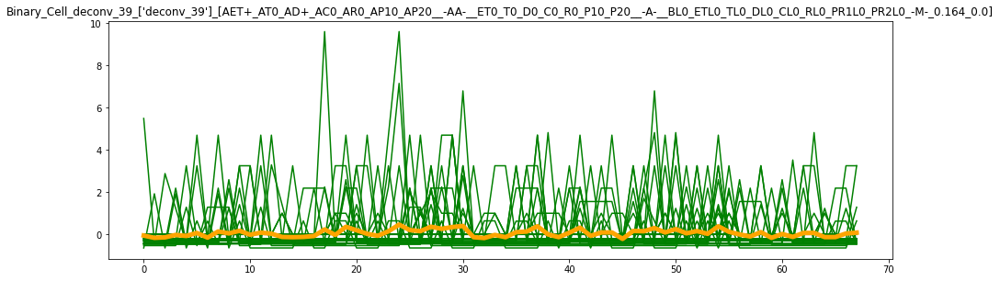


 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_19: Max_0.0  Min_0.0

 Zero baseline det

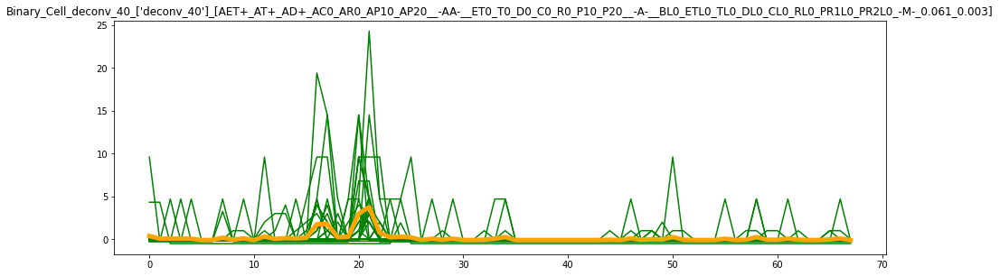


 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_20: Max_0.0  Min_0.0

 Zero baseline de

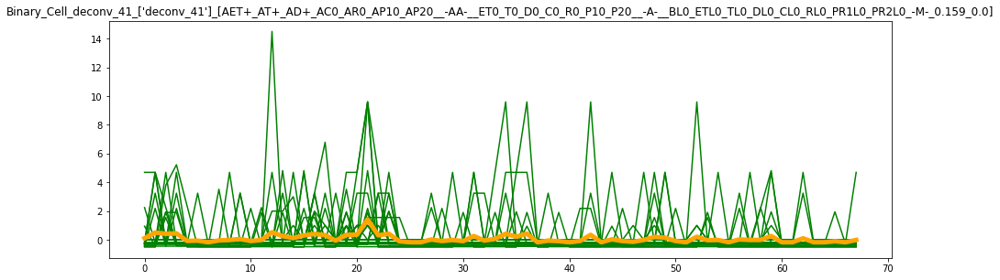


 Zero baseline detected: Binary_Cell_deconv_42: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_23: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_27: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_29: Max_0.0  Min_0.0


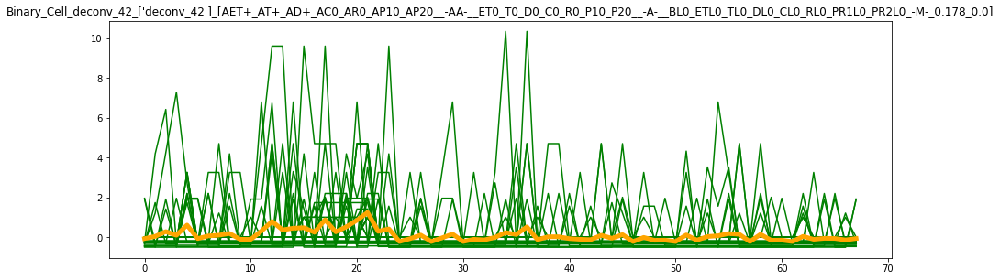


 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_15: Max_0.0  Min_0.0

 Zero baseline dete

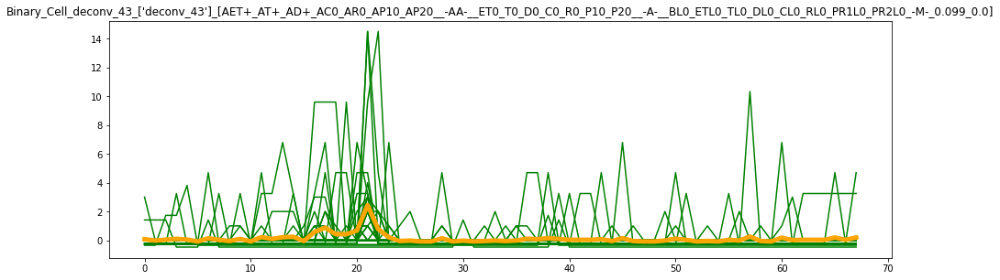


 Zero baseline detected: Binary_Cell_deconv_44: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_17: Max_0.0  Min_0.0

 Zero baseline dete

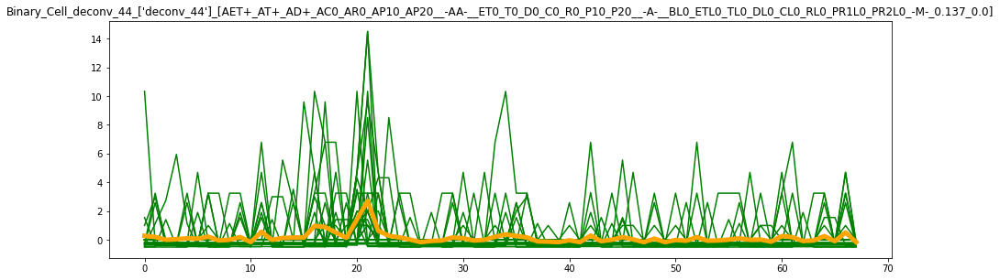


 Zero baseline detected: Binary_Cell_deconv_48: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_21: Max_0.0  Min_0.0


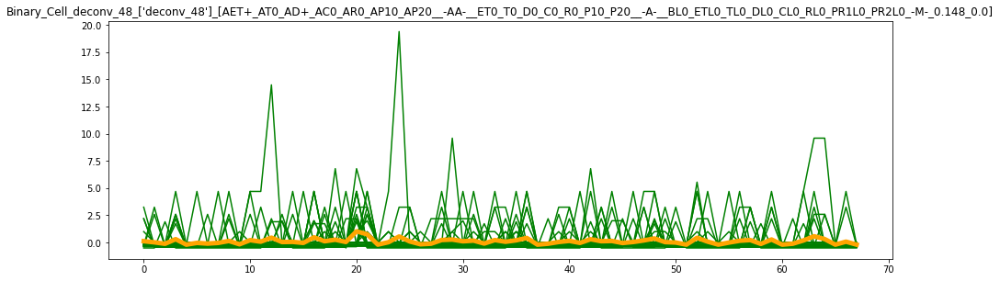


 Zero baseline detected: Binary_Cell_deconv_50: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_22: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_23: Max_0.0  Min_0.0

 Zero baseline 

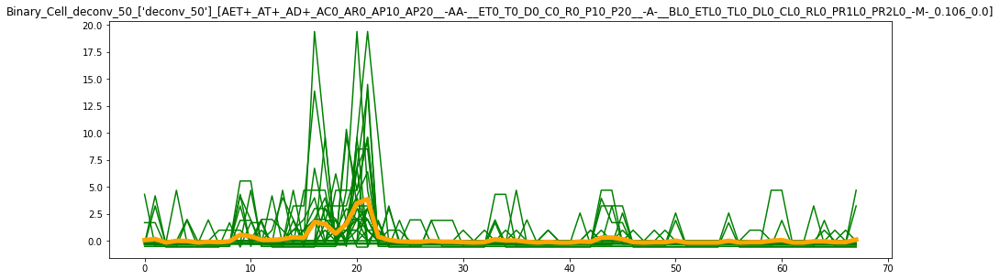


 Zero baseline detected: Binary_Cell_deconv_52: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_18: Max_0.0  Min_0.0

 Zero baseline de

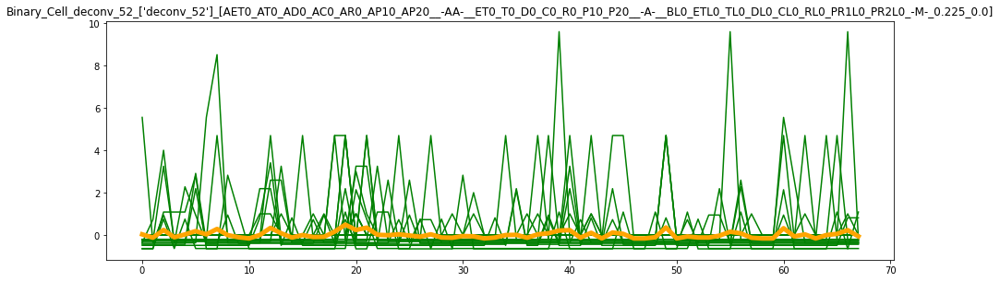

,Trial_0,Trial_1,Trial_2,Trial_3,Trial_4,Trial_5,Trial_6,Trial_7,Trial_8,Trial_9,Trial_10,Trial_11,Trial_12,Trial_13,Trial_14,Trial_15,Trial_16,Trial_17,Trial_18,Trial_19,Trial_20,Trial_21,Trial_22,Trial_23,Trial_24,Trial_25,Trial_26,Trial_27,Trial_28,Trial_29,Trial_30
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,0.000799,0.228782,-0.029062,-0.078933,-0.054697,0.380012,0.116865,-0.074263,0.076217,0.280940,0.120636,0.082758,0.031453
1,0.044574,-0.018703,-0.142294,-0.174418,-0.162139,0.063949,0.506950,0.035927,-0.020558,0.200738,0.014394,0.185371,-0.124333
2,0.160751,-0.140893,0.199884,0.102941,-0.138706,0.066464,0.421845,0.277361,0.046431,0.006590,-0.117590,-0.145686,0.239214
3,-0.090900,-0.022924,-0.075305,-0.113738,-0.024341,0.066464,0.452461,0.093098,0.100008,0.049286,0.305378,0.012345,-0.103493
4,-0.030220,0.091373,0.159147,-0.089683,-0.071928,0.066464,-0.074228,0.603013,0.052740,0.103964,-0.195349,-0.003412,0.027197
5,0.303753,0.206015,-0.028139,0.042261,0.068803,-0.091568,-0.051880,-0.074263,-0.081238,0.078324,-0.037317,-0.145686,0.185796
6,-0.028354,0.176203,0.053935,0.360240,-0.151446,-0.091568,-0.166137,0.059769,0.137474,0.217562,-0.099863,-0.073750,0.031453
7,0.059786,-0.049613,0.020685,-0.078933,0.139275,0.180721,-0.039380,0.097355,0.033019,-0.043209,-0.037317,-0.113428,0.284970
8,0.289679,0.348728,0.196158,0.050602,0.047099,-0.059309,-0.008105,0.182284,-0.048980,0.008479,0.142904,-0.040500,-0.004491
9,0.099390,-0.012983,0.048677,0.120059,0.170443,0.098722,0.062377,-0.109701,0.097535,0.193413,-0.163090,0.568946,-0.103493


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,0.000799,0.228782,-0.029062,-0.078933,-0.054697,0.380012,0.116865,-0.074263,0.076217,0.280940,0.120636,0.082758,0.031453
1,0.044574,-0.018703,-0.142294,-0.174418,-0.162139,0.063949,0.506950,0.035927,-0.020558,0.200738,0.014394,0.185371,-0.124333
2,0.160751,-0.140893,0.199884,0.102941,-0.138706,0.066464,0.421845,0.277361,0.046431,0.006590,-0.117590,-0.145686,0.239214
3,-0.090900,-0.022924,-0.075305,-0.113738,-0.024341,0.066464,0.452461,0.093098,0.100008,0.049286,0.305378,0.012345,-0.103493
4,-0.030220,0.091373,0.159147,-0.089683,-0.071928,0.066464,-0.074228,0.603013,0.052740,0.103964,-0.195349,-0.003412,0.027197
5,0.303753,0.206015,-0.028139,0.042261,0.068803,-0.091568,-0.051880,-0.074263,-0.081238,0.078324,-0.037317,-0.145686,0.185796
6,-0.028354,0.176203,0.053935,0.360240,-0.151446,-0.091568,-0.166137,0.059769,0.137474,0.217562,-0.099863,-0.073750,0.031453
7,0.059786,-0.049613,0.020685,-0.078933,0.139275,0.180721,-0.039380,0.097355,0.033019,-0.043209,-0.037317,-0.113428,0.284970
8,0.289679,0.348728,0.196158,0.050602,0.047099,-0.059309,-0.008105,0.182284,-0.048980,0.008479,0.142904,-0.040500,-0.004491
9,0.099390,-0.012983,0.048677,0.120059,0.170443,0.098722,0.062377,-0.109701,0.097535,0.193413,-0.163090,0.568946,-0.103493


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [87]:
########################################
# ##### Omissions Trials (Trial Initiation (5s before/5s after))
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= 'Omission'


#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission

Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


    #############################################   
    # Calculates mean of bins across all Trial   


    Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
    Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

    Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
    Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


    ##################################################
    #Plot to validate trials and average of trials
    for i in range(Num_Trial_analysis):

        #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


    #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
    plt_raw.show()
    ######################################################


#Info = trial type, num of trials, bin size, duration 

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

##########################################################################
######################## Part 2  Saves Data ######################

########################################

######################################

display(Cell_Baseline_Bin_Data_df)

Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
#for x in range(3):
    tempa = '[' + Perm_Table_panda['Classify'][x] +']'
    tempb =  Perm_Table_panda['Cell_ID'][x]
    #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
    tempc = str([len(Filtered_Trial_Num_All_Reward)])
    tempd = str(Behavioral_Performance['Trials_Initiated']) 
    tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
    temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])
    
    #print(temp_name)
    


    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    
    
display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




Filter = '[R-]'
NumofCell_Filtered = 0
CellList_Filtered = []
for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
    if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_Filtered = NumofCell_Filtered+1
        CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
print('NumofCell_Filtered = ',NumofCell_Filtered)
print('CellList_Filtered =', CellList_Filtered)

Filtered_df = pd.DataFrame()

for i in range(NumofCell_Filtered):
    Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

display(Filtered_df)


# OLD way
# filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


filename = '_Avg_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Base_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)




In [88]:
display(Trial_Type_panda)

,P_Value,L/R_Reversed,Trial_Num,Trial_Descript,Type,Pre_Trial_Initi_Start,Pre_Trial_Initi_End,Trial_Initi_Start,Trial_Initi_Start_2_Sec_Limit,Trial_Initi_End,Delay_Win_Start,Delay_Win_End,Cue_Start,Cue_End,Cue_Side,Cue_Resp,Reward_Outcome,Reward_Start,Reward_End,Reward_Start_(Fake),Reward_End_(Fake),Reward_received_T,5s_bfr_Reward_received_T,5s_aft_Reward_received_T,Reward_received,Post_Rewrd_Win_BLk_1_Start,Post_Rewrd_Win_BLk_1_End,Post_Rewrd_Win_BLk_2_Start,Post_Rewrd_Win_BLk_2_End,5s_bfr_Trial_Initi_End,5s_aft_Trial_Initi_End,Reward_Start_5s_Bfr,Reward_Start_(Fake)_5s_Bfr,Ka_Win_Begin,Ka_Win_End,Data_Len(R),Onset(R),Total_Durat_above_zero(R),Num_of_Occurance(R),Max_Event_Duration(R),Min_Event_Duration(R),Max_Inter_Event_Duration(R),Min_Inter_Event_Duration(R),Events_Duration_list(R),Events_Time_list(R),Inter_Events_Duration_list(R),Inter_Events_Time_list(R),Data_Len(D),Onset(D),Total_Durat_above_zero(D),Num_of_Occurance(D),Max_Event_Duration(D),Min_Event_Duration(D),Max_Inter_Event_Duration(D),Min_Inter_Event_Duration(D),Events_Duration_list(D),Events_Time_list(D),Inter_Events_Duration_list(D),Inter_Events_Time_list(D),Corrected(D),Corrected_Onset(D),Corrected_Total_Durat_above_zero(D),Corrected_Num_of_Occurance(D)
0,0.005,0,[1],NonReward_Left,Rejejct,[730],[850],[850],[850],[855],[855],[915],[915],[924],Left,Middle,NonReward,[],[],[924],[984],No_Reward,[],[],0,[984],[1044],[1044],[1104],[755],[1095],[],[824],[530],[1210],120,1,27,1,27.0,27.0,0,10000000,[[27.0]],[[1.0]],[[]],[[]],60,1,3,1,3.0,3.0,0,10000000,[[3.0]],[[1.0]],[[]],[[]],1,NA,0,0
1,0.005,0,[2],NonReward_Right,Omission,[1944],[2064],[2064],[2277],[2317],[2317],[2377],[2377],[2400],Right,None,NonReward,[],[],[2400],[2460],No_Reward,[],[],0,[2460],[2520],[2520],[2580],[2217],[2557],[],[2300],[1744],[2424],120,31,10,1,10.0,10.0,0,10000000,[[10.0]],[[31.0]],[[]],[[]],60,1,14,2,13.0,1.0,18.0,18.0,"[[1.0, 13]]","[[1.0, 20]]",[[18.0]],[[2.0]],1,20,13.0,1
2,0.005,0,[3],NonReward_Left,Omission,[2887],[3007],[3007],[3176],[3216],[3216],[3276],[3276],[3300],Left,None,NonReward,[],[],[3300],[3360],No_Reward,[],[],0,[3360],[3420],[3420],[3480],[3116],[3456],[],[3200],[2687],[3367],120,95,10,2,6.0,4.0,1.0,1.0,"[[6.0, 4]]","[[95.0, 102]]",[[1.0]],[[101.0]],60,1,19,2,16.0,3.0,24.0,24.0,"[[3.0, 16]]","[[1.0, 28]]",[[24.0]],[[4.0]],1,28,16.0,1
3,0.005,0,[4],NonReward_Left,Omission,[4126],[4246],[4246],[4384],[4424],[4424],[4484],[4484],[4514],Left,None,NonReward,[],[],[4514],[4574],No_Reward,[],[],0,[4574],[4634],[4634],[4694],[4324],[4664],[],[4414],[3926],[4606],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,23,1,23.0,23.0,0,10000000,[[23.0]],[[1.0]],[[]],[[]],1,NA,0,0
4,0.005,0,[5],NonReward_Left,Omission,[5194],[5314],[5314],[5332],[5372],[5372],[5432],[5432],[5462],Left,None,NonReward,[],[],[5462],[5522],No_Reward,[],[],0,[5522],[5582],[5582],[5642],[5272],[5612],[],[5362],[4994],[5674],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,21,1,21.0,21.0,0,10000000,[[21.0]],[[1.0]],[[]],[[]],1,NA,0,0
5,0.005,0,[6],NonReward_Right,Omission,[6142],[6262],[6262],[6262],[6272],[6272],[6332],[6332],[6362],Right,None,NonReward,[],[],[6362],[6422],No_Reward,[],[],0,[6422],[6482],[6482],[6542],[6172],[6512],[],[6262],[5942],[6622],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,2,1,2.0,2.0,0,10000000,[[2.0]],[[1.0]],[[]],[[]],1,NA,0,0
6,0.005,0,[7],NonReward_Left,Omission,[7182],[7302],[7302],[7302],[7332],[7332],[7392],[7392],[7422],Left,None,NonReward,[],[],[7422],[7482],No_Reward,[],[],0,[7482],[7542],[7542],[7602],[7232],[7572],[],[7322],[6982],[7662],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,4,1,4.0,4.0,0,10000000,[[4.0]],[[1.0]],[[]],[[]],1,NA,0,0
7,0.005,0,[8],NonReward_Right,Omission,[8042],[8162],[8162],[8162],[8168],[8168],[8228],[8228],[8258],Right,None,NonReward,[],[],[8258],[8318],No_Reward,[],[],0,[8318],[8378],[8378],[8438],[8068],[8408],[],[8158],[7842],[8522],120,0,0,0,0,10000000,0,10000000,[[]],[[]],[[]],[[]],60,1,4,1,4.0,4.0,0,1

,index,P_Value,L/R_Reversed,Trial_Num,Trial_Descript,Type,Pre_Trial_Initi_Start,Pre_Trial_Initi_End,Trial_Initi_Start,Trial_Initi_Start_2_Sec_Limit,Trial_Initi_End,Delay_Win_Start,Delay_Win_End,Cue_Start,Cue_End,Cue_Side,Cue_Resp,Reward_Outcome,Reward_Start,Reward_End,Reward_Start_(Fake),Reward_End_(Fake),Reward_received_T,5s_bfr_Reward_received_T,5s_aft_Reward_received_T,Reward_received,Post_Rewrd_Win_BLk_1_Start,Post_Rewrd_Win_BLk_1_End,Post_Rewrd_Win_BLk_2_Start,Post_Rewrd_Win_BLk_2_End,5s_bfr_Trial_Initi_End,5s_aft_Trial_Initi_End,Reward_Start_5s_Bfr,Reward_Start_(Fake)_5s_Bfr,Ka_Win_Begin,Ka_Win_End,Data_Len(R),Onset(R),Total_Durat_above_zero(R),Num_of_Occurance(R),Max_Event_Duration(R),Min_Event_Duration(R),Max_Inter_Event_Duration(R),Min_Inter_Event_Duration(R),Events_Duration_list(R),Events_Time_list(R),Inter_Events_Duration_list(R),Inter_Events_Time_list(R),Data_Len(D),Onset(D),Total_Durat_above_zero(D),Num_of_Occurance(D),Max_Event_Duration(D),Min_Event_Duration(D),Max_Inter_Event_Duration(D),Min_Inter_Event_Duration(D),Events_Duration_list(D),Events_Time_list(D),Inter_Events_Duration_list(D),Inter_Events_Time_list(D),Corrected(D),Corrected_Onset(D),Corrected_Total_Durat_above_zero(D),Corrected_Num_of_Occurance(D)
0,16,0.005,0,[17],Rewarded_Left,Rewarded,[16405],[16525],[16525],[16525],[16551],[16551],[16611],[16611],[16619],Left,Left,Rewarded,[16619],[16679],,,[16628],[16528],[16728],1,[16679],[16739],[16739],[16799],[16451],[16791],[16519],,[16205],[16885],120,10,110,2,72.0,38.0,1.0,1.0,"[[72.0, 38]]","[[10.0, 83]]",[[1.0]],[[82.0]],60,1,5,1,5.0,5.0,0,10000000,[[5.0]],[[1.0]],[[]],[[]],1,NA,0,0
1,28,0.005,0,[29],Rewarded_Left,Rewarded,[29532],[29652],[29652],[29775],[29815],[29815],[29875],[29875],[29900],Left,Left,Rewarded,[29903],[29963],,,[29918],[29818],[30018],1,[29963],[30023],[30023],[30083],[29715],[30055],[29803],,[29332],[30012],123,19,105,1,105.0,105.0,0,10000000,[[105.0]],[[19.0]],[[]],[[]],60,1,5,1,5.0,5.0,0,10000000,[[5.0]],[[1.0]],[[]],[[]],1,NA,0,0
2,29,0.005,0,[30],Rewarded_Left,Rewarded,[30743],[30863],[30863],[30863],[30867],[30867],[30927],[30927],[30952],Left,Left,Rewarded,[30952],[31012],,,[30967],[30867],[31067],1,[31012],[31072],[31072],[31132],[30767],[31107],[30852],,[30543],[31223],120,16,101,1,101.0,101.0,0,10000000,[[101.0]],[[16.0]],[[]],[[]],60,1,28,2,24.0,4.0,24.0,24.0,"[[4.0, 24]]","[[1.0, 29]]",[[24.0]],[[5.0]],1,29,24.0,1
3,44,0.005,0,[45],Rewarded_Left,Rewarded,[46147],[46267],[46267],[46267],[46272],[46272],[46332],[46332],[46355],Left,Left,Rewarded,[46355],[46415],,,[46366],[46266],[46466],1,[46415],[46475],[46475],[46535],[46172],[46512],[46255],,[45947],[46627],120,12,109,1,109.0,109.0,0,10000000,[[109.0]],[[12.0]],[[]],[[]],60,1,15,2,12.0,3.0,42.0,42.0,"[[3.0, 12]]","[[1.0, 46]]",[[42.0]],[[4.0]],1,46,12.0,1


Odd_Trials


,index,P_Value,L/R_Reversed,Trial_Num,Trial_Descript,Type,Pre_Trial_Initi_Start,Pre_Trial_Initi_End,Trial_Initi_Start,Trial_Initi_Start_2_Sec_Limit,Trial_Initi_End,Delay_Win_Start,Delay_Win_End,Cue_Start,Cue_End,Cue_Side,Cue_Resp,Reward_Outcome,Reward_Start,Reward_End,Reward_Start_(Fake),Reward_End_(Fake),Reward_received_T,5s_bfr_Reward_received_T,5s_aft_Reward_received_T,Reward_received,Post_Rewrd_Win_BLk_1_Start,Post_Rewrd_Win_BLk_1_End,Post_Rewrd_Win_BLk_2_Start,Post_Rewrd_Win_BLk_2_End,5s_bfr_Trial_Initi_End,5s_aft_Trial_Initi_End,Reward_Start_5s_Bfr,Reward_Start_(Fake)_5s_Bfr,Ka_Win_Begin,Ka_Win_End,Data_Len(R),Onset(R),Total_Durat_above_zero(R),Num_of_Occurance(R),Max_Event_Duration(R),Min_Event_Duration(R),Max_Inter_Event_Duration(R),Min_Inter_Event_Duration(R),Events_Duration_list(R),Events_Time_list(R),Inter_Events_Duration_list(R),Inter_Events_Time_list(R),Data_Len(D),Onset(D),Total_Durat_above_zero(D),Num_of_Occurance(D),Max_Event_Duration(D),Min_Event_Duration(D),Max_Inter_Event_Duration(D),Min_Inter_Event_Duration(D),Events_Duration_list(D),Events_Time_list(D),Inter_Events_Duration_list(D),Inter_Events_Time_list(D),Corrected(D),Corrected_Onset(D),Corrected_Total_Durat_above_zero(D),Corrected_Num_of_Occurance(D)
0,28,0.005,0,[29],Rewarded_Left,Rewarded,[29532],[29652],[29652],[29775],[29815],[29815],[29875],[29875],[29900],Left,Left,Rewarded,[29903],[29963],,,[29918],[29818],[30018],1,[29963],[30023],[30023],[30083],[29715],[30055],[29803],,[29332],[30012],123,19,105,1,105.0,105.0,0,10000000,[[105.0]],[[19.0]],[[]],[[]],60,1,5,1,5.0,5.0,0,10000000,[[5.0]],[[1.0]],[[]],[[]],1,NA,0,0
1,44,0.005,0,[45],Rewarded_Left,Rewarded,[46147],[46267],[46267],[46267],[46272],[46272],[46332],[46332],[46355],Left,Left,Rewarded,[46355],[46415],,,[46366],[46266],[46466],1,[46415],[46475],[46475],[46535],[46172],[46512],[46255],,[45947],[46627],120,12,109,1,109.0,109.0,0,10000000,[[109.0]],[[12.0]],[[]],[[]],60,1,15,2,12.0,3.0,42.0,42.0,"[[3.0, 12]]","[[1.0, 46]]",[[42.0]],[[4.0]],1,46,12.0,1



 Zero baseline detected: Binary_Cell_deconv_30: Trial_1: Max_0.0  Min_0.0


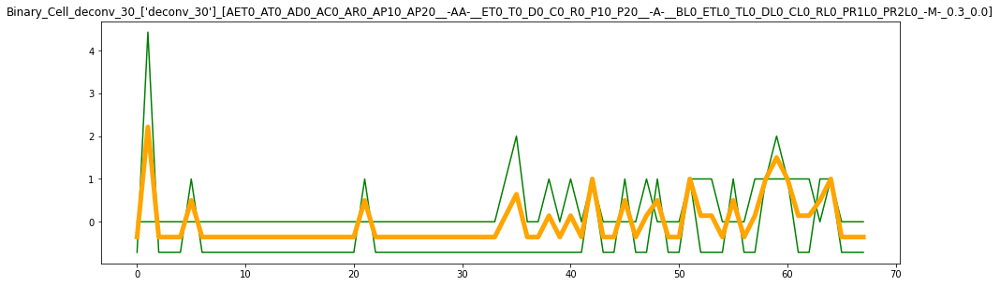


 Zero baseline detected: Binary_Cell_deconv_33: Trial_1: Max_0.0  Min_0.0


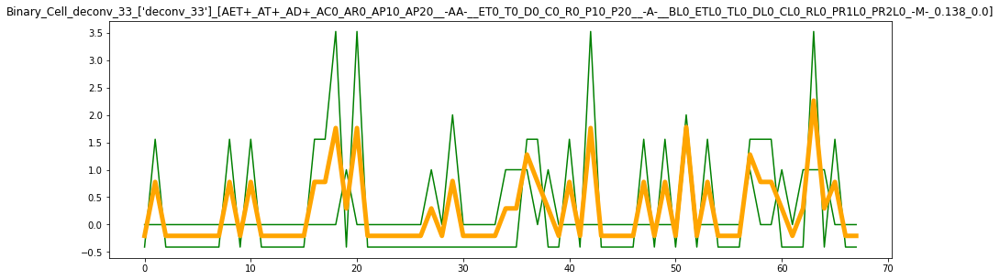

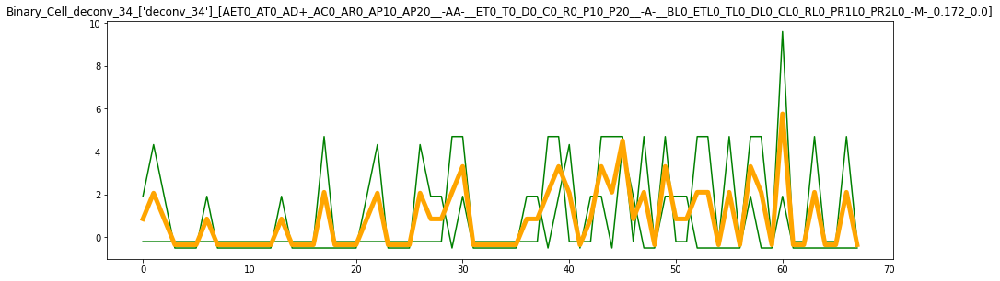

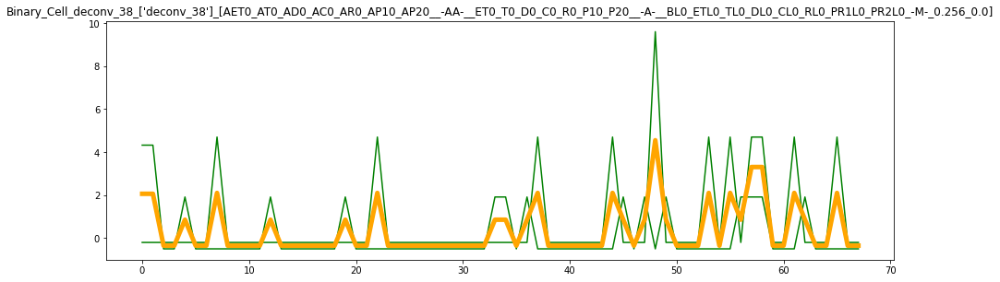


 Zero baseline detected: Binary_Cell_deconv_39: Trial_1: Max_0.0  Min_0.0


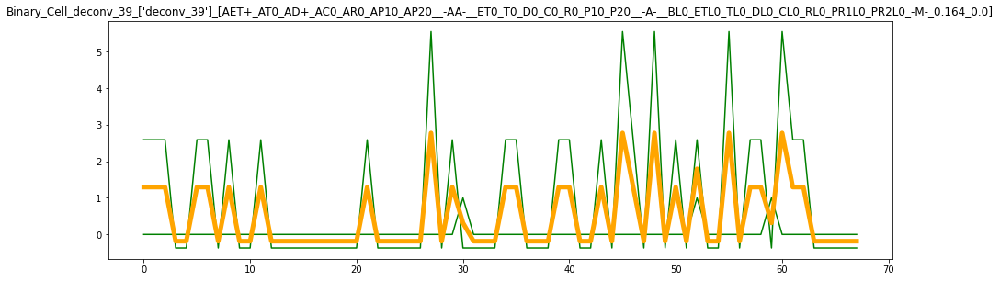


 Zero baseline detected: Binary_Cell_deconv_40: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_1: Max_0.0  Min_0.0


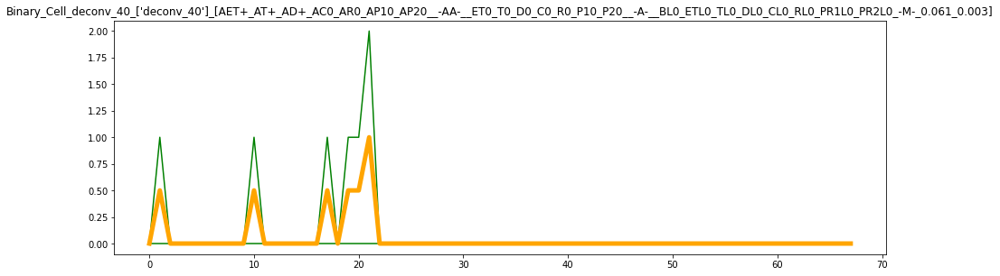


 Zero baseline detected: Binary_Cell_deconv_41: Trial_0: Max_0.0  Min_0.0


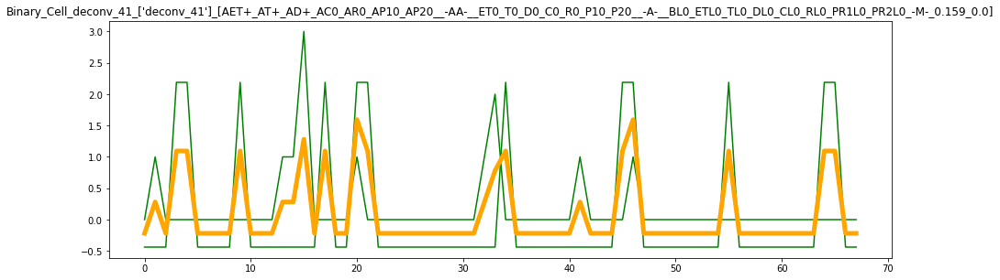

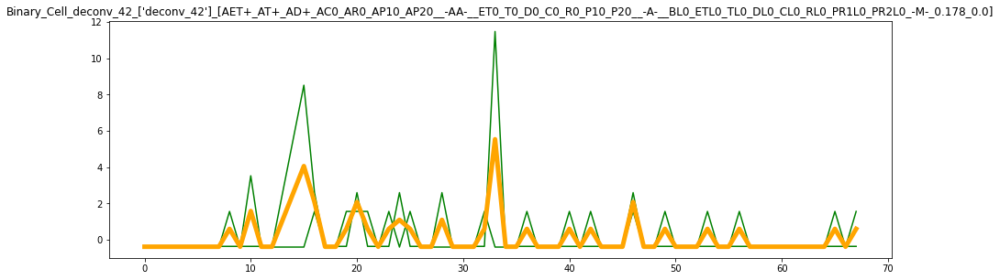


 Zero baseline detected: Binary_Cell_deconv_43: Trial_1: Max_0.0  Min_0.0


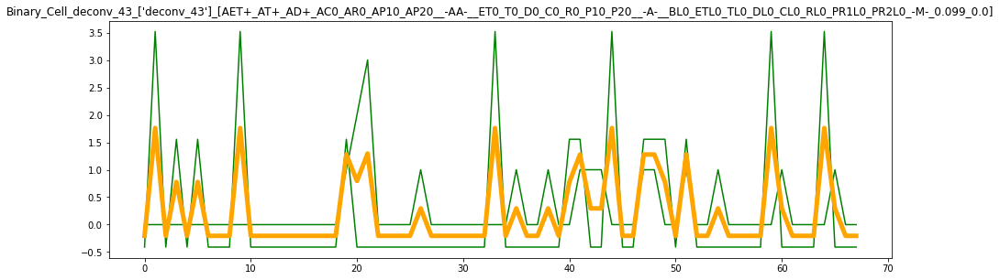


 Zero baseline detected: Binary_Cell_deconv_44: Trial_0: Max_0.0  Min_0.0


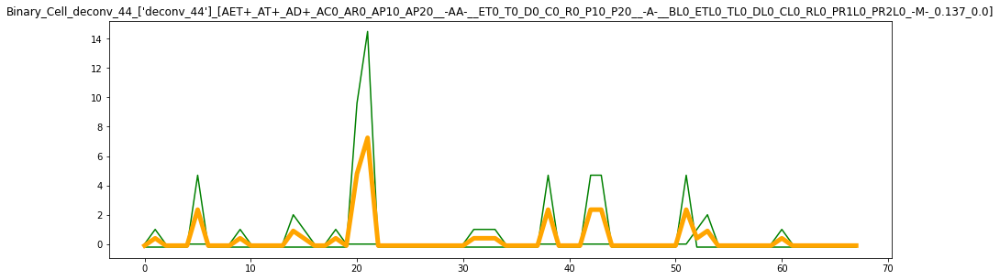

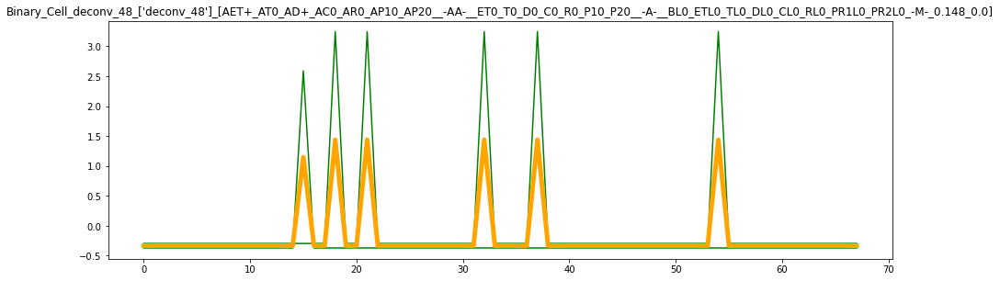

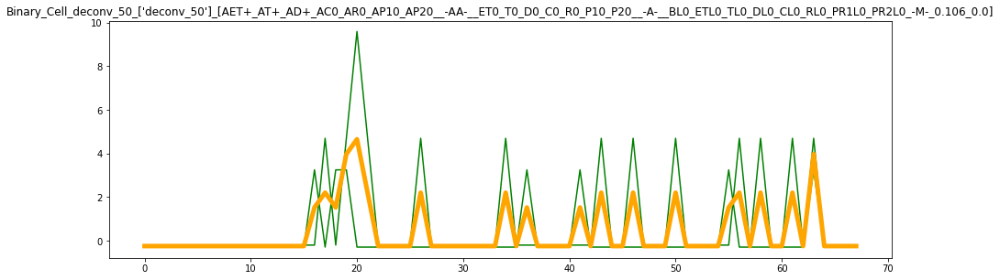


 Zero baseline detected: Binary_Cell_deconv_52: Trial_1: Max_0.0  Min_0.0


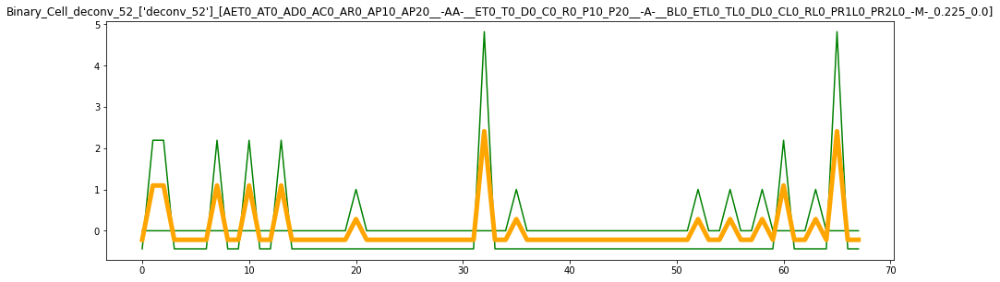

,Trial_0,Trial_1
0,0.0,0.0
1,0.0,0.0
2,1.0,0.0
3,0.0,0.0
4,1.0,0.0
5,1.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,-0.356985,-0.204659,0.852095,2.057347,1.295023,0.0,-0.218899,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,-0.218899
1,2.213304,0.777703,2.057347,2.057347,1.295023,0.5,0.281101,-0.389662,1.760065,0.397938,-0.332585,-0.249644,1.094494
2,-0.356985,-0.204659,0.852095,-0.353156,1.295023,0.0,-0.218899,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,1.094494
3,-0.356985,-0.204659,-0.353156,-0.353156,-0.185003,0.0,1.094494,-0.389662,0.777703,-0.102062,-0.332585,-0.249644,-0.218899
4,-0.356985,-0.204659,-0.353156,0.852095,-0.185003,0.0,1.094494,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,-0.218899
5,0.499778,-0.204659,-0.353156,-0.353156,1.295023,0.0,-0.218899,-0.389662,0.777703,2.347428,-0.332585,-0.249644,-0.218899
6,-0.356985,-0.204659,0.852095,-0.353156,1.295023,0.0,-0.218899,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,-0.218899
7,-0.356985,-0.204659,-0.353156,2.096334,-0.185003,0.0,-0.218899,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,1.094494
8,-0.356985,0.777703,-0.353156,-0.353156,1.295023,0.0,-0.218899,0.592700,-0.204659,-0.102062,-0.332585,-0.249644,-0.218899
9,-0.356985,-0.204659,-0.353156,-0.353156,-0.185003,0.0,1.094494,-0.389662,1.760065,0.397938,-0.332585,-0.249644,-0.218899


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,-0.356985,-0.204659,0.852095,2.057347,1.295023,0.0,-0.218899,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,-0.218899
1,2.213304,0.777703,2.057347,2.057347,1.295023,0.5,0.281101,-0.389662,1.760065,0.397938,-0.332585,-0.249644,1.094494
2,-0.356985,-0.204659,0.852095,-0.353156,1.295023,0.0,-0.218899,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,1.094494
3,-0.356985,-0.204659,-0.353156,-0.353156,-0.185003,0.0,1.094494,-0.389662,0.777703,-0.102062,-0.332585,-0.249644,-0.218899
4,-0.356985,-0.204659,-0.353156,0.852095,-0.185003,0.0,1.094494,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,-0.218899
5,0.499778,-0.204659,-0.353156,-0.353156,1.295023,0.0,-0.218899,-0.389662,0.777703,2.347428,-0.332585,-0.249644,-0.218899
6,-0.356985,-0.204659,0.852095,-0.353156,1.295023,0.0,-0.218899,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,-0.218899
7,-0.356985,-0.204659,-0.353156,2.096334,-0.185003,0.0,-0.218899,-0.389662,-0.204659,-0.102062,-0.332585,-0.249644,1.094494
8,-0.356985,0.777703,-0.353156,-0.353156,1.295023,0.0,-0.218899,0.592700,-0.204659,-0.102062,-0.332585,-0.249644,-0.218899
9,-0.356985,-0.204659,-0.353156,-0.353156,-0.185003,0.0,1.094494,-0.389662,1.760065,0.397938,-0.332585,-0.249644,-0.218899


NumofCell_Filtered =  0
CellList_Filtered = []


""


Even_Trials


,index,P_Value,L/R_Reversed,Trial_Num,Trial_Descript,Type,Pre_Trial_Initi_Start,Pre_Trial_Initi_End,Trial_Initi_Start,Trial_Initi_Start_2_Sec_Limit,Trial_Initi_End,Delay_Win_Start,Delay_Win_End,Cue_Start,Cue_End,Cue_Side,Cue_Resp,Reward_Outcome,Reward_Start,Reward_End,Reward_Start_(Fake),Reward_End_(Fake),Reward_received_T,5s_bfr_Reward_received_T,5s_aft_Reward_received_T,Reward_received,Post_Rewrd_Win_BLk_1_Start,Post_Rewrd_Win_BLk_1_End,Post_Rewrd_Win_BLk_2_Start,Post_Rewrd_Win_BLk_2_End,5s_bfr_Trial_Initi_End,5s_aft_Trial_Initi_End,Reward_Start_5s_Bfr,Reward_Start_(Fake)_5s_Bfr,Ka_Win_Begin,Ka_Win_End,Data_Len(R),Onset(R),Total_Durat_above_zero(R),Num_of_Occurance(R),Max_Event_Duration(R),Min_Event_Duration(R),Max_Inter_Event_Duration(R),Min_Inter_Event_Duration(R),Events_Duration_list(R),Events_Time_list(R),Inter_Events_Duration_list(R),Inter_Events_Time_list(R),Data_Len(D),Onset(D),Total_Durat_above_zero(D),Num_of_Occurance(D),Max_Event_Duration(D),Min_Event_Duration(D),Max_Inter_Event_Duration(D),Min_Inter_Event_Duration(D),Events_Duration_list(D),Events_Time_list(D),Inter_Events_Duration_list(D),Inter_Events_Time_list(D),Corrected(D),Corrected_Onset(D),Corrected_Total_Durat_above_zero(D),Corrected_Num_of_Occurance(D)
0,16,0.005,0,[17],Rewarded_Left,Rewarded,[16405],[16525],[16525],[16525],[16551],[16551],[16611],[16611],[16619],Left,Left,Rewarded,[16619],[16679],,,[16628],[16528],[16728],1,[16679],[16739],[16739],[16799],[16451],[16791],[16519],,[16205],[16885],120,10,110,2,72.0,38.0,1.0,1.0,"[[72.0, 38]]","[[10.0, 83]]",[[1.0]],[[82.0]],60,1,5,1,5.0,5.0,0,10000000,[[5.0]],[[1.0]],[[]],[[]],1,NA,0,0
1,29,0.005,0,[30],Rewarded_Left,Rewarded,[30743],[30863],[30863],[30863],[30867],[30867],[30927],[30927],[30952],Left,Left,Rewarded,[30952],[31012],,,[30967],[30867],[31067],1,[31012],[31072],[31072],[31132],[30767],[31107],[30852],,[30543],[31223],120,16,101,1,101.0,101.0,0,10000000,[[101.0]],[[16.0]],[[]],[[]],60,1,28,2,24.0,4.0,24.0,24.0,"[[4.0, 24]]","[[1.0, 29]]",[[24.0]],[[5.0]],1,29,24.0,1



 Zero baseline detected: Binary_Cell_deconv_30: Trial_0: Max_0.0  Min_0.0


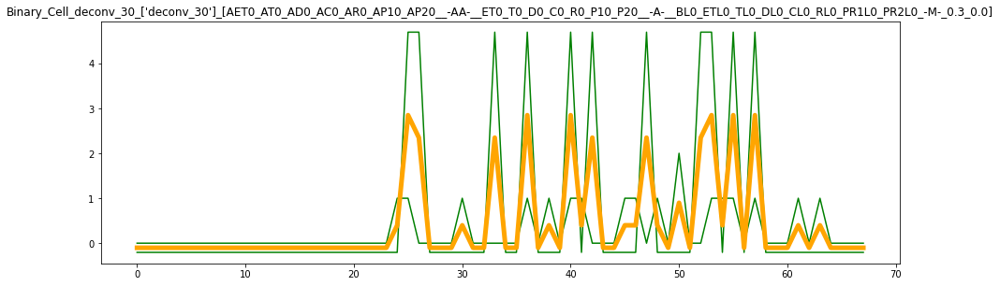

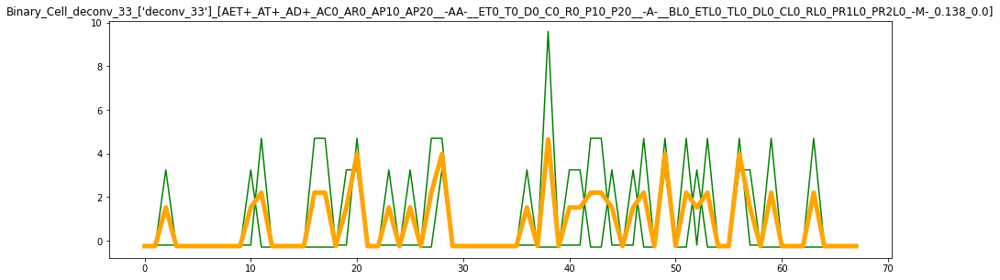


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0


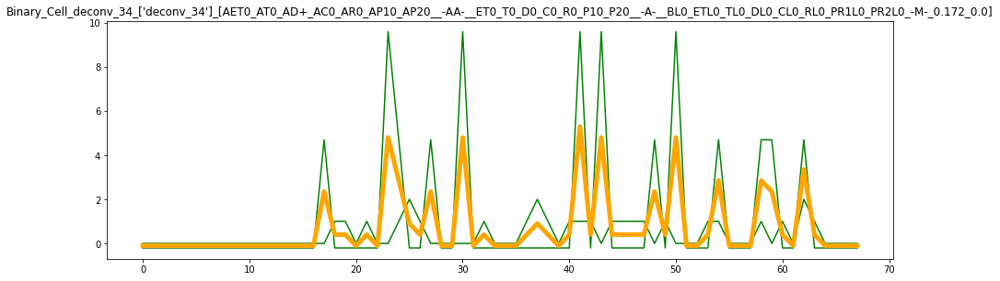


 Zero baseline detected: Binary_Cell_deconv_38: Trial_0: Max_0.0  Min_0.0


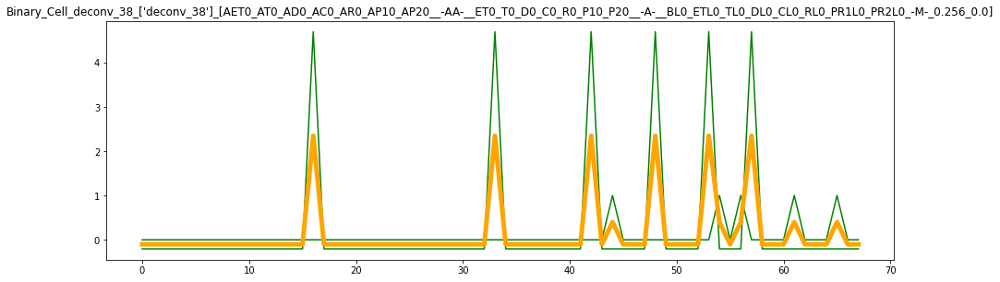


 Zero baseline detected: Binary_Cell_deconv_39: Trial_1: Max_0.0  Min_0.0


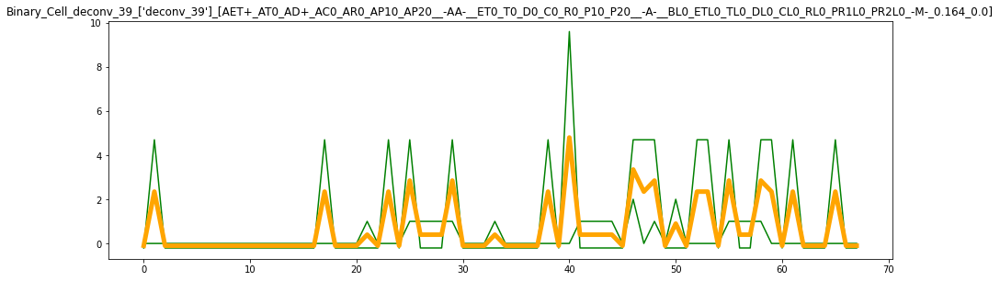


 Zero baseline detected: Binary_Cell_deconv_40: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_1: Max_0.0  Min_0.0


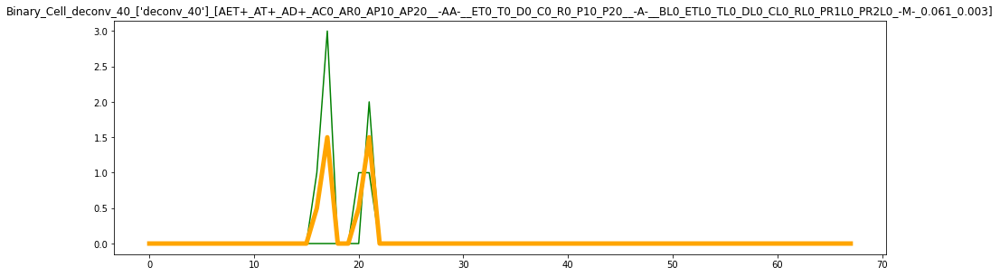

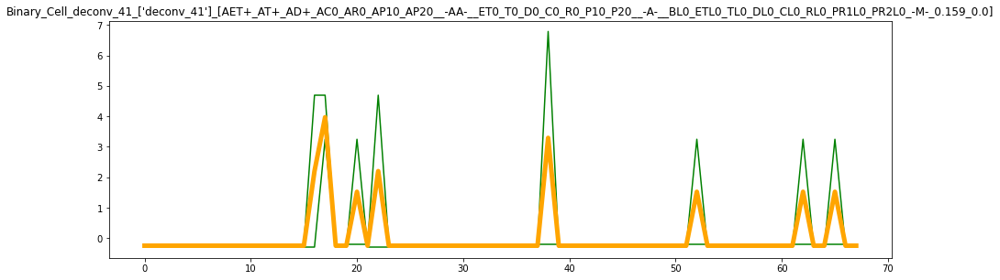

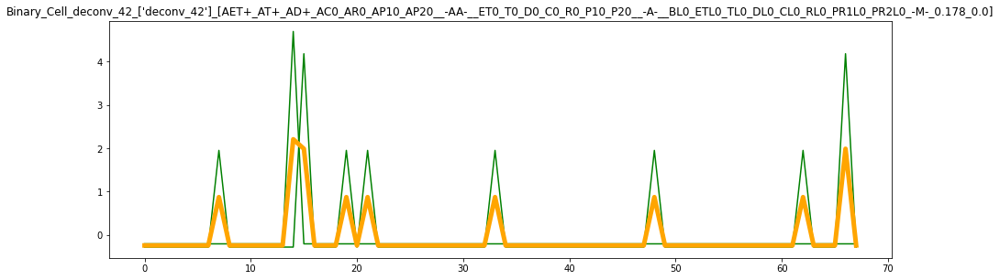


 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0


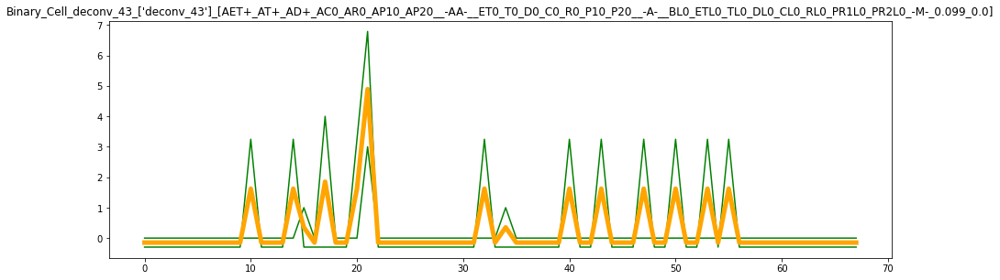


 Zero baseline detected: Binary_Cell_deconv_44: Trial_0: Max_0.0  Min_0.0


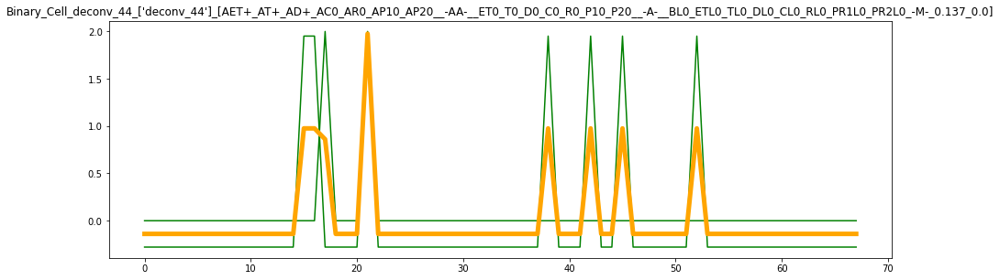


 Zero baseline detected: Binary_Cell_deconv_48: Trial_0: Max_0.0  Min_0.0


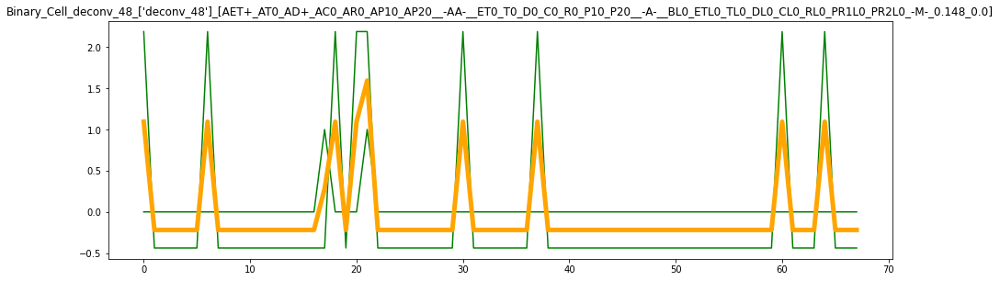


 Zero baseline detected: Binary_Cell_deconv_50: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_1: Max_0.0  Min_0.0


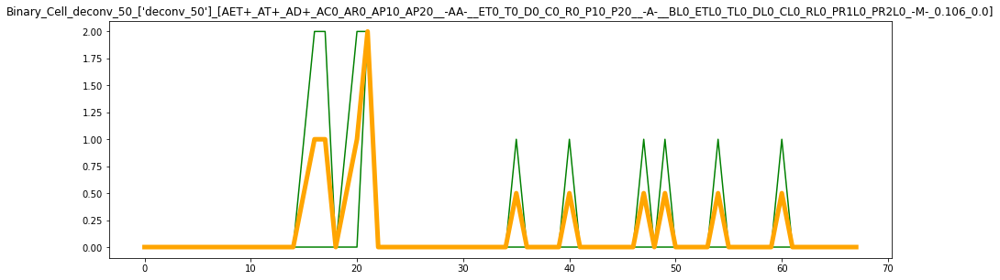


 Zero baseline detected: Binary_Cell_deconv_52: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_1: Max_0.0  Min_0.0


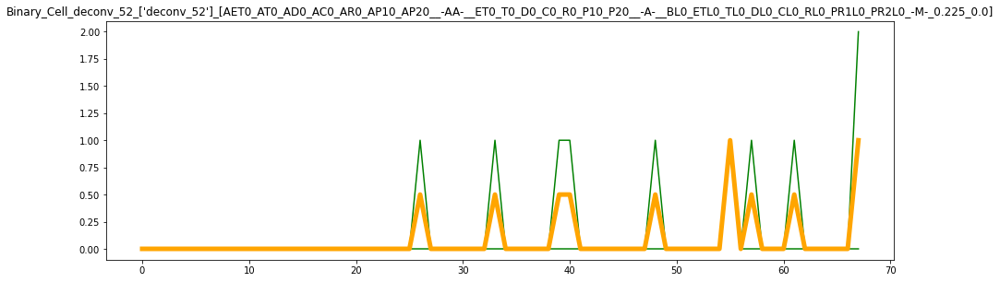

,Trial_0,Trial_1
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
5,0.0,0.0
6,0.0,0.0
7,0.0,0.0
8,0.0,0.0
9,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,1.094494,0.0,0.0
1,-0.102062,-0.249644,-0.102062,-0.102062,2.347428,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
2,-0.102062,1.521335,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
3,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
4,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
5,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
6,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,1.094494,0.0,0.0
7,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,0.873570,-0.147582,-0.139376,-0.218899,0.0,0.0
8,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
9,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,1.094494,0.0,0.0
1,-0.102062,-0.249644,-0.102062,-0.102062,2.347428,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
2,-0.102062,1.521335,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
3,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
4,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
5,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
6,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,1.094494,0.0,0.0
7,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,0.873570,-0.147582,-0.139376,-0.218899,0.0,0.0
8,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0
9,-0.102062,-0.249644,-0.102062,-0.102062,-0.102062,0.0,-0.249644,-0.241438,-0.147582,-0.139376,-0.218899,0.0,0.0


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [89]:
################################################################################
# ##### Reward Trials (Trial Initiation (5s before/5s after)) + Export Odd and Even Trials znorm traces 
##############################################################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= 'Rewarded'
#Trial_Filter= 'Omission'


#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 
display(Filtered_TimeStamp)

Temp= Filtered_TimeStamp.copy()
#############################################
# Split into Odd and Even Trials
###################################

odd_Trials = pd.DataFrame()
even_Trials = pd.DataFrame()
for ii in range(0, len(Temp)):
    if ((ii % 2)==0 ):
        even_Trials= even_Trials.append(Temp[ii:ii+1], ignore_index=True)
    else :
        odd_Trials= odd_Trials.append(Temp[ii:ii+1],ignore_index=True)
        
# display(odd_Trials)
# display(even_Trials)
del Filtered_TimeStamp

# ###################################

for xx in range(2):
    if(xx ==0):
        Odd_Even_Label = 'Odd_Trials'
        Filtered_TimeStamp= odd_Trials
    else:
        Odd_Even_Label = 'Even_Trials'
        Filtered_TimeStamp= even_Trials

    print(Odd_Even_Label)
    display(Filtered_TimeStamp)


    Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
    Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
    Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
    Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




    Baseline_Traces_Binned = defaultdict(list)
    Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Baseline_Traces_Binned = defaultdict(list)
    Z_Norm_Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Traces_Binned_Header = ['Info']

    for i in range(NumofCell_deconv):
        Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])

    for ii in range(len(Z_Norm_Traces_Binned_Header)):
        Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

    # # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
    Cropped_Length = []
    for i in range(len(Filtered_Signal_Begin)):
        tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer
        Cropped_Length.append(tempb - tempa)

    Median_Cropped_Length = (np.median(Cropped_Length))

    ###############################################
    #number of trials that can be analyze (trials cut off prematurely gets reject)
    Num_Trial_analysis= 0 
    ##########################
    ############################################ crop data###########
    # Use the first cell to check for data cutoff
    #Signal_Label = CellList_deconv[0]  
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

    for i in range(len(Filtered_Signal_Begin)):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Signal_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer


        # Crop out data that is not proper length 
        if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
            Num_Trial_analysis= Num_Trial_analysis +1

    #################################################################
    ## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
    # Not Normlaized
    Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

    # zNormlaized
    Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

    for x in range(NumofCell_deconv):

        ############################################################################################################
        #################################  (1) Slice by timestamp interval########################################
        #Signal_Label = CellList_deconv[0]
        Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
        xCropped_BaselineTraces_Cell = {}
        xCropped_SignalTraces_Cell = {}



        for i in range(Num_Trial_analysis):
            Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

            tempa = Filtered_Baseline_Begin[i] 
            tempa = int(tempa[0])   # Convert to Integer
            tempb = Filtered_Baseline_End[i]
            tempb = int(tempb[0])   # Convert to Integer

            tempc = Filtered_Signal_Begin[i] 
            tempc = int(tempc[0])   # Convert to Integer
            tempd = Filtered_Signal_End[i]
            tempd = int(tempd[0])   # Convert to Integer

            # Crop out data that is not proper length 
            if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
                xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
                xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

        ############################################################################################################
        ################# Bin data   ---  Baseline ################################################################################
        # Baseline_Traces_Binned
        # Signal_Traces_Binned


        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Baseline_Bin_Data_df = pd.DataFrame()

        ##########  Baeline #######################
        # This compnent added to integrate binn scripts 
        t = list(xCropped_BaselineTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


        #############################################  
        ######################################################
        ################# Bin data ---  Signal ############

        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Signal_Bin_Data_df = pd.DataFrame()

        ##########
        # This compnent added to integrate binn scripts 
        t = list(xCropped_SignalTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


        ###############################################
        # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

        zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
        zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

        for i in range(Num_Trial_analysis):

            Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
            Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

            Baseline_Mean = Baseline_Trace.mean()
            Baseline_Stdev = statistics.stdev(Baseline_Trace)
            Baseline_Max = max(Baseline_Trace)
            Baseline_Min = min(Baseline_Trace)

            if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
                zNormalized_Baseline_Trace = Baseline_Trace
                zNormalized_Signal_Trace = Signal_Trace
                print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
            else:
                zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
                zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

            zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
            zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


        #############################################   
        # Calculates mean of bins across all Trial   


        Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
        Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

        Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
        Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


        ##################################################
        #Plot to validate trials and average of trials
        for i in range(Num_Trial_analysis):

            #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
            #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
            #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
            plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


        #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
        #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
        #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
        plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

        plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
        plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
        plt_raw.show()
        ######################################################


    #Info = trial type, num of trials, bin size, duration 

    ##########################################################################
    #  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
    for ii in range(len(Z_Norm_Traces_Binned_Header)):
        del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
        del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
        del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
        del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

    ##########################################################################
    ######################## Part 2  Saves Data ######################

    ########################################

    ######################################

    display(Cell_Baseline_Bin_Data_df)

    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
    Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

    Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

    for x in range(NumofCell_deconv):
    #for x in range(3):
        tempa = '[' + Perm_Table_panda['Classify'][x] +']'
        tempb =  Perm_Table_panda['Cell_ID'][x]
        #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
        tempc = str([len(Filtered_Trial_Num_All_Reward)])
        tempd = str(Behavioral_Performance['Trials_Initiated']) 
        tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
        temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])

        #print(temp_name)



        Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
        Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
        Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]


    display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
    display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




    Filter = '[R-]'
    NumofCell_Filtered = 0
    CellList_Filtered = []
    for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
        if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
            NumofCell_Filtered = NumofCell_Filtered+1
            CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
    print('NumofCell_Filtered = ',NumofCell_Filtered)
    print('CellList_Filtered =', CellList_Filtered)

    Filtered_df = pd.DataFrame()

    for i in range(NumofCell_Filtered):
        Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

    display(Filtered_df)


    # OLD way
    # filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
    # savefilename = os.path.join(Save_Path, filename)
    # Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    # filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
    # savefilename = os.path.join(Save_Path, filename)
    # Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    # filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
    # savefilename = os.path.join(Save_Path, filename)
    # Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


    filename = '_Avg_Cell_Traces_zNorm_Signal_||'+ Odd_Even_Label+ '|-|' +Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    filename = '_Avg_Cell_Traces_Raw_Base_||'+ Odd_Even_Label+ '|-|'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    filename = '_Avg_Cell_Traces_Raw_Signal_||' + Odd_Even_Label+ '|-|'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)






 Zero baseline detected: Binary_Cell_deconv_30: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_17: Max_0.0  Min_0.0


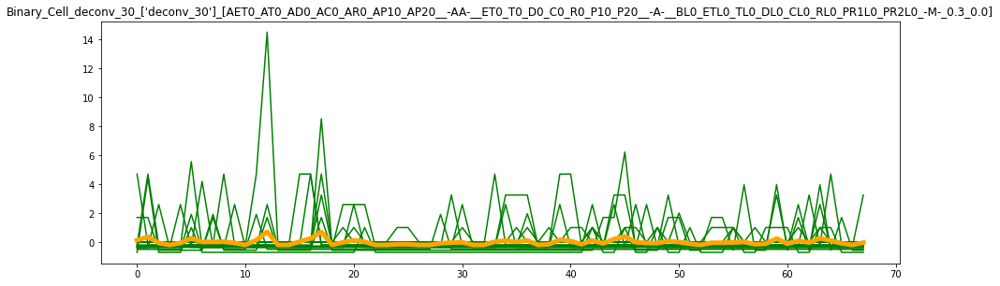


 Zero baseline detected: Binary_Cell_deconv_33: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_13: Max_0.0  Min_0.0


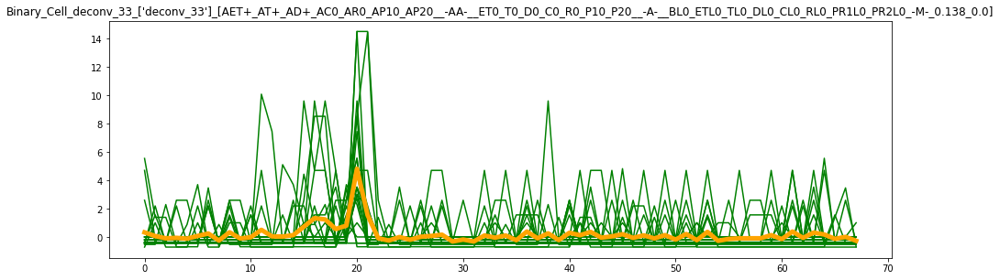


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_13: Max_0.0  Min_0.0


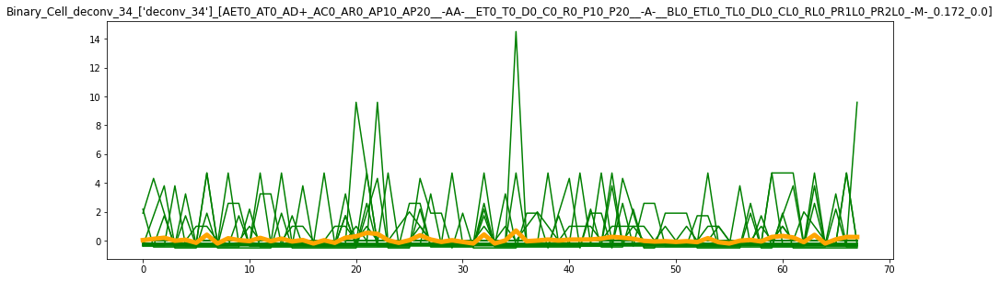


 Zero baseline detected: Binary_Cell_deconv_38: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_20: Max_0.0  Min_0.0


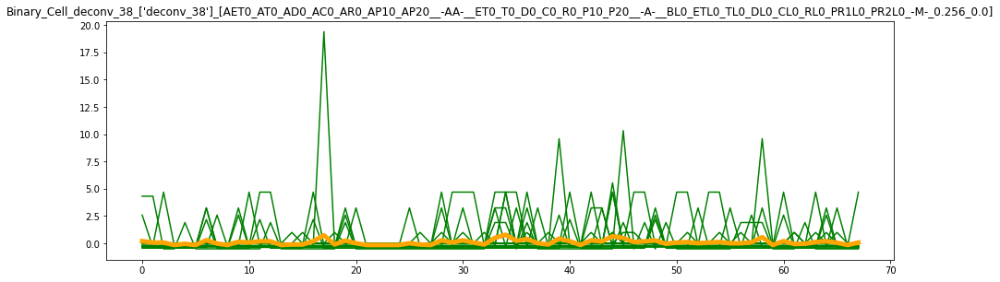


 Zero baseline detected: Binary_Cell_deconv_39: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_21: Max_0.0  Min_0.0


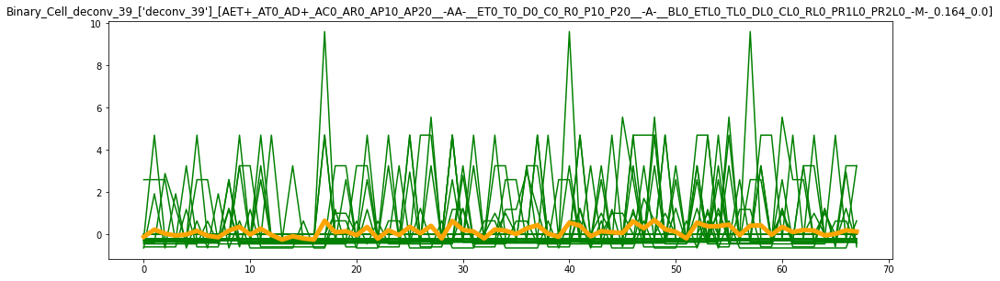


 Zero baseline detected: Binary_Cell_deconv_40: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_19: Max_0.0  Min_0.0

 Zero baseline det

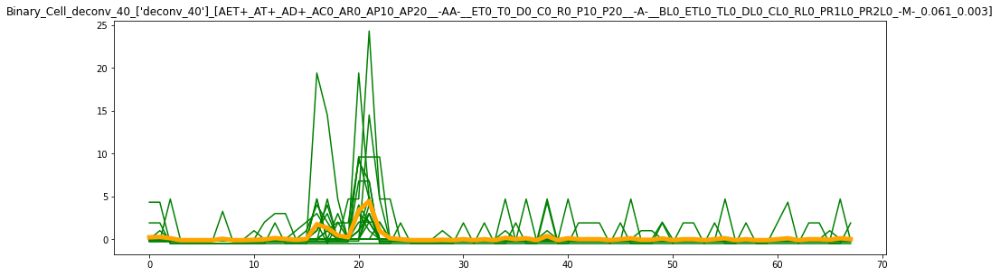


 Zero baseline detected: Binary_Cell_deconv_41: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_15: Max_0.0  Min_0.0


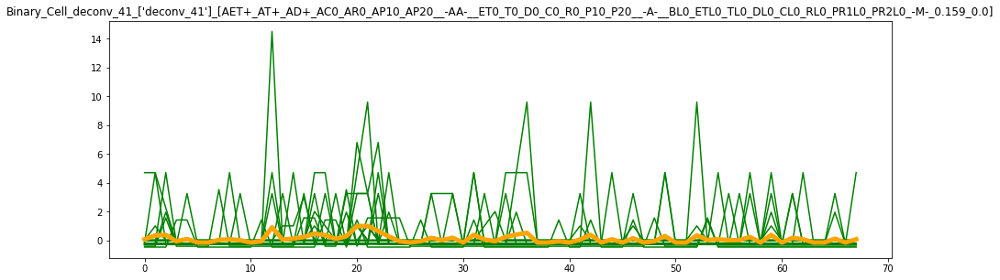


 Zero baseline detected: Binary_Cell_deconv_42: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_19: Max_0.0  Min_0.0


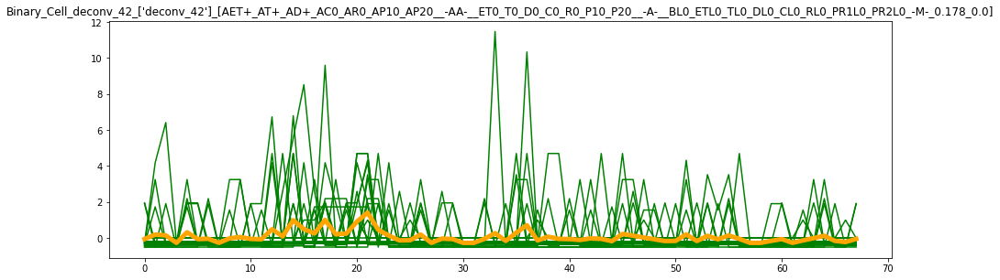


 Zero baseline detected: Binary_Cell_deconv_43: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_16: Max_0.0  Min_0.0

 Zero baseline det

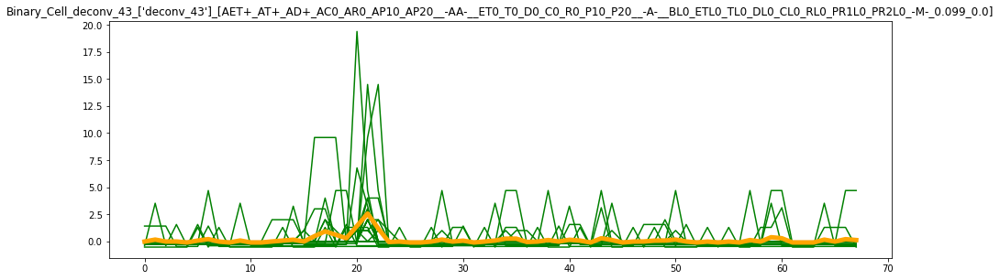


 Zero baseline detected: Binary_Cell_deconv_44: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_15: Max_0.0  Min_0.0


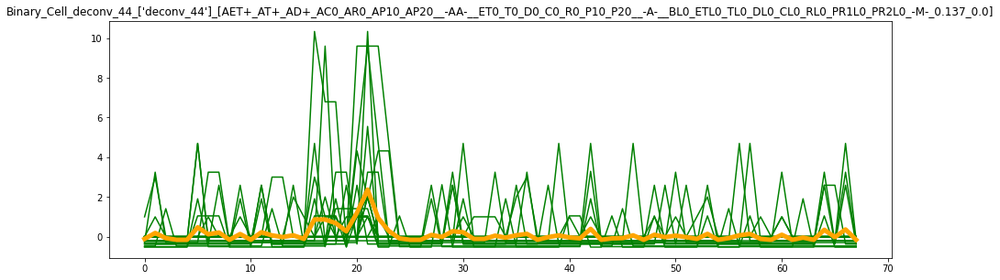


 Zero baseline detected: Binary_Cell_deconv_48: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_12: Max_0.0  Min_0.0


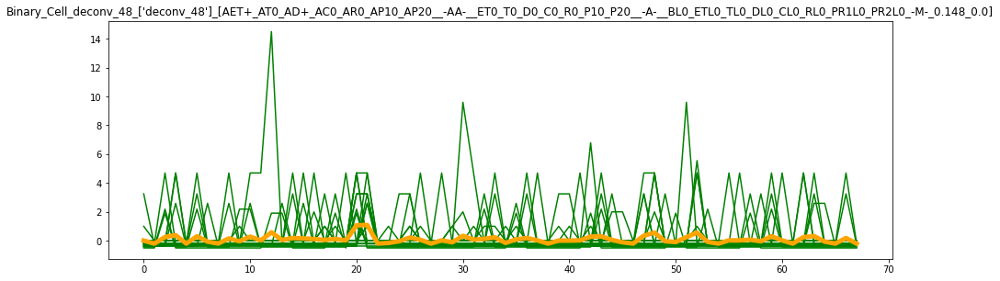


 Zero baseline detected: Binary_Cell_deconv_50: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_18: Max_0.0  Min_0.0


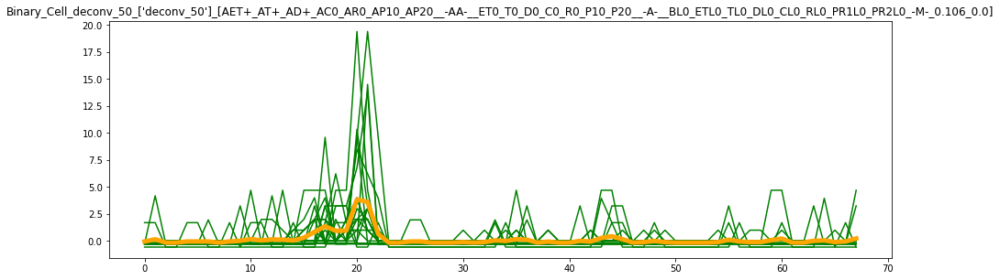


 Zero baseline detected: Binary_Cell_deconv_52: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_17: Max_0.0  Min_0.0

 Zero baseline det

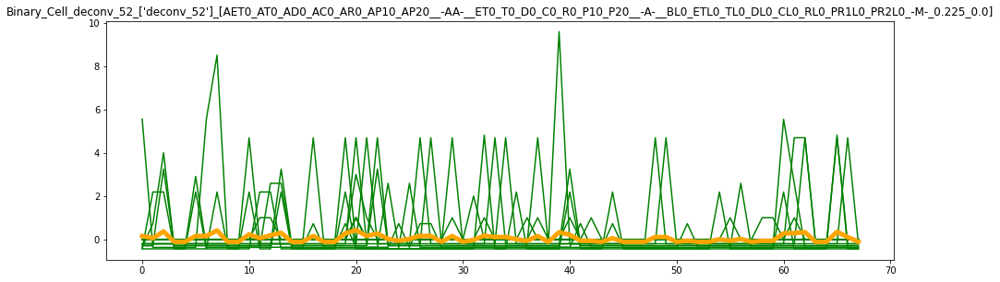

,Trial_0,Trial_1,Trial_2,Trial_3,Trial_4,Trial_5,Trial_6,Trial_7,Trial_8,Trial_9,Trial_10,Trial_11,Trial_12,Trial_13,Trial_14,Trial_15,Trial_16,Trial_17,Trial_18,Trial_19,Trial_20,Trial_21
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,0.126679,0.322039,0.039723,0.203360,-0.112755,0.223243,0.069971,-0.056649,-0.019832,-0.110838,0.008072,-0.047931,0.154700
1,0.360341,0.062616,0.124285,0.068812,0.226447,0.268698,0.338107,0.190539,0.158779,0.186524,-0.198380,0.154798,0.054581
2,-0.064217,-0.096104,0.203504,0.072356,0.036786,0.117219,0.371982,0.146080,-0.019832,-0.070789,0.253268,-0.150693,0.364313
3,-0.198765,-0.064422,-0.000458,-0.150325,-0.056011,-0.105462,-0.067206,-0.267581,-0.016030,-0.156293,0.381529,-0.150693,-0.114396
4,-0.064217,-0.119886,0.066146,-0.040756,-0.005806,-0.105462,0.093792,0.318142,-0.105336,-0.156293,-0.198380,-0.047931,-0.114396
5,0.257787,0.070725,-0.143791,-0.150325,0.168186,-0.105462,-0.152710,-0.056649,0.066609,0.469992,0.304698,-0.047931,0.153737
6,0.003964,0.243764,0.411140,0.291071,-0.063806,-0.105462,-0.152710,-0.038614,0.202848,0.121515,-0.063832,-0.049329,0.154700
7,0.013566,-0.254434,-0.189245,-0.015777,-0.130781,0.055536,0.025902,-0.267581,-0.022696,0.210608,-0.198380,-0.150693,0.408647
8,0.023916,0.331712,0.167984,-0.150325,0.177062,-0.105462,0.069971,-0.017278,-0.105336,-0.156293,0.158849,-0.047931,-0.114396
9,-0.064217,-0.105934,0.039696,0.145221,0.355635,-0.105462,0.008288,0.054415,0.073275,0.133278,-0.033526,0.010305,-0.114396


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,0.126679,0.322039,0.039723,0.203360,-0.112755,0.223243,0.069971,-0.056649,-0.019832,-0.110838,0.008072,-0.047931,0.154700
1,0.360341,0.062616,0.124285,0.068812,0.226447,0.268698,0.338107,0.190539,0.158779,0.186524,-0.198380,0.154798,0.054581
2,-0.064217,-0.096104,0.203504,0.072356,0.036786,0.117219,0.371982,0.146080,-0.019832,-0.070789,0.253268,-0.150693,0.364313
3,-0.198765,-0.064422,-0.000458,-0.150325,-0.056011,-0.105462,-0.067206,-0.267581,-0.016030,-0.156293,0.381529,-0.150693,-0.114396
4,-0.064217,-0.119886,0.066146,-0.040756,-0.005806,-0.105462,0.093792,0.318142,-0.105336,-0.156293,-0.198380,-0.047931,-0.114396
5,0.257787,0.070725,-0.143791,-0.150325,0.168186,-0.105462,-0.152710,-0.056649,0.066609,0.469992,0.304698,-0.047931,0.153737
6,0.003964,0.243764,0.411140,0.291071,-0.063806,-0.105462,-0.152710,-0.038614,0.202848,0.121515,-0.063832,-0.049329,0.154700
7,0.013566,-0.254434,-0.189245,-0.015777,-0.130781,0.055536,0.025902,-0.267581,-0.022696,0.210608,-0.198380,-0.150693,0.408647
8,0.023916,0.331712,0.167984,-0.150325,0.177062,-0.105462,0.069971,-0.017278,-0.105336,-0.156293,0.158849,-0.047931,-0.114396
9,-0.064217,-0.105934,0.039696,0.145221,0.355635,-0.105462,0.008288,0.054415,0.073275,0.133278,-0.033526,0.010305,-0.114396


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [90]:
########################################
# ##### Delay Win No_Poke Trials ###. DO NOT COPY (Filter modified to > instead of == )
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
#Bin = 20   # Bin size
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= 0


#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Corrected_Num_of_Occurance(D)'] == Trial_Filter] #. Filter trials by omission

Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


    #############################################   
    # Calculates mean of bins across all Trial   


    Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
    Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

    Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
    Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


    ##################################################
    #Plot to validate trials and average of trials
    for i in range(Num_Trial_analysis):

        #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


    #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
    plt_raw.show()
    ######################################################


#Info = trial type, num of trials, bin size, duration 

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

##########################################################################
######################## Part 2  Saves Data ######################

########################################

######################################

display(Cell_Baseline_Bin_Data_df)

Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
#for x in range(3):
    tempa = '[' + Perm_Table_panda['Classify'][x] +']'
    tempb =  Perm_Table_panda['Cell_ID'][x]
    #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
    tempc = str([len(Filtered_Trial_Num_All_Reward)])
    tempd = str(Behavioral_Performance['Trials_Initiated']) 
    #temp_name = str([tempa]+[tempb]+[tempc])
    tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
    temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])
    
    #print(temp_name)
    


    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    
    
display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




Filter = '[R-]'
NumofCell_Filtered = 0
CellList_Filtered = []
for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
    if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_Filtered = NumofCell_Filtered+1
        CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
print('NumofCell_Filtered = ',NumofCell_Filtered)
print('CellList_Filtered =', CellList_Filtered)

Filtered_df = pd.DataFrame()

for i in range(NumofCell_Filtered):
    Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

display(Filtered_df)


# OLD way
# filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


filename = '_Avg_Cell_Traces_zNorm_Signal_Corrected_Num_of_Occurance(D)_||'+ 'No_Poke' + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Base_Corrected_Num_of_Occurance(D)_||'+ 'No_Poke' + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Signal_Corrected_Num_of_Occurance(D)_||' + 'No_Poke' + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)



In [91]:
#display(Filtered_TimeStamp)


 Zero baseline detected: Binary_Cell_deconv_30: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_22: Max_0.0  Min_0.0


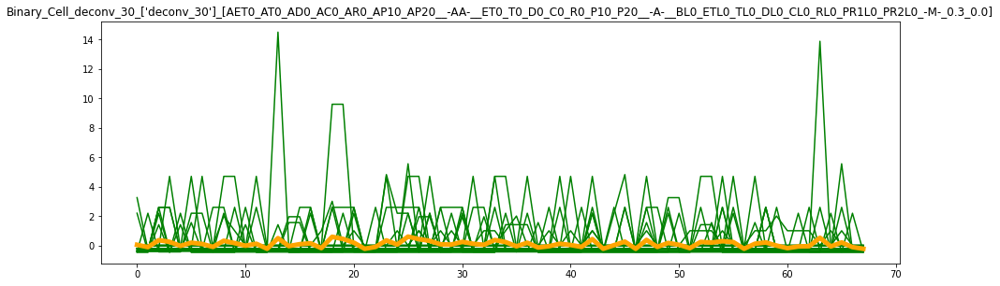


 Zero baseline detected: Binary_Cell_deconv_33: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_22: Max_0.0  Min_0.0


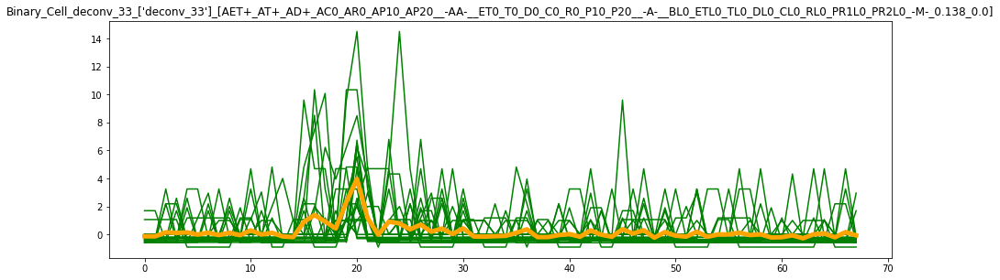


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_10: Max_0.0  Min_0.0


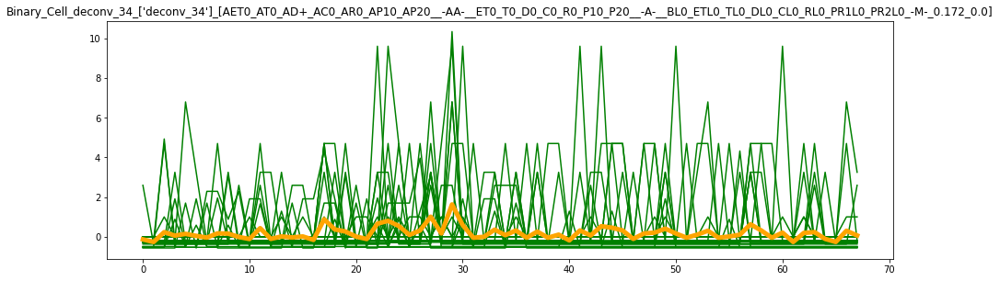


 Zero baseline detected: Binary_Cell_deconv_38: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_11: Max_0.0  Min_0.0


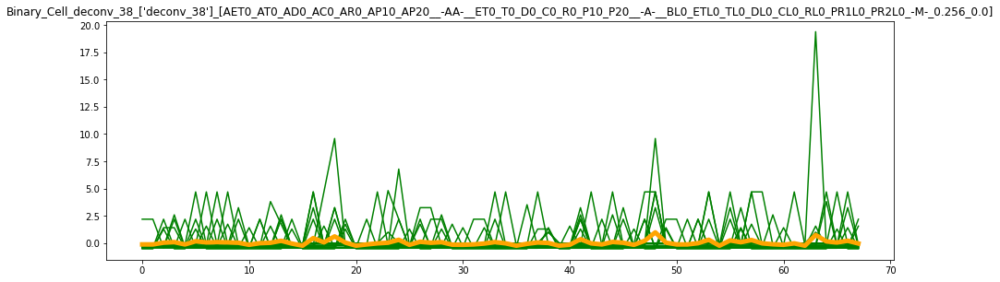


 Zero baseline detected: Binary_Cell_deconv_39: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_22: Max_0.0  Min_0.0


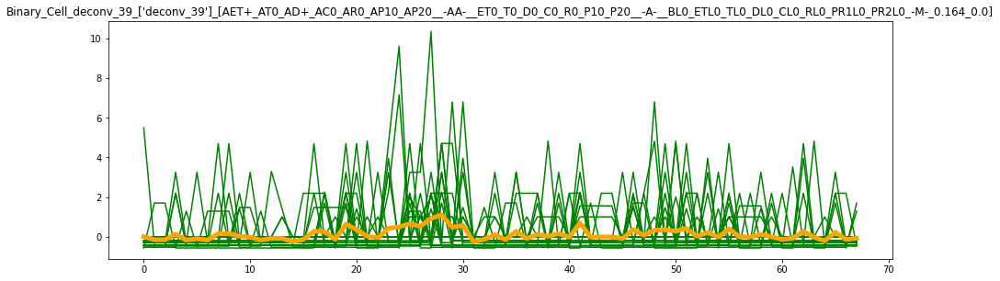


 Zero baseline detected: Binary_Cell_deconv_40: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_18: Max_0.0  Min_0.0

 Zero baseline de

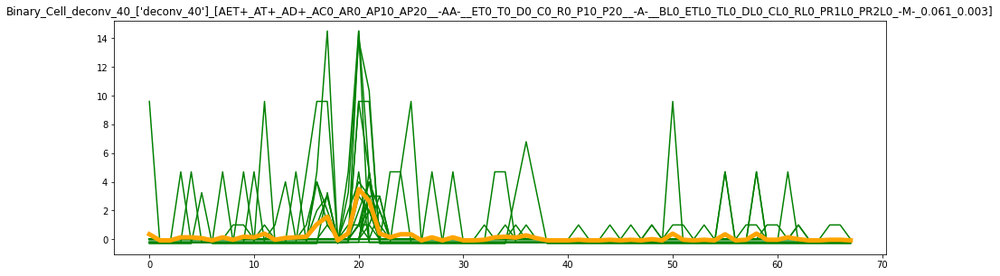


 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_16: Max_0.0  Min_0.0


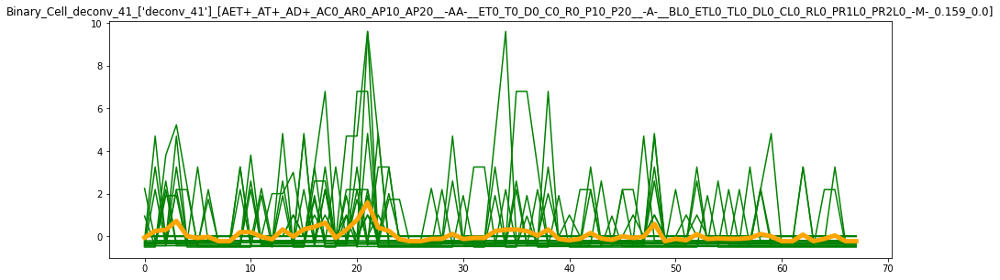


 Zero baseline detected: Binary_Cell_deconv_42: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_42: Trial_21: Max_0.0  Min_0.0


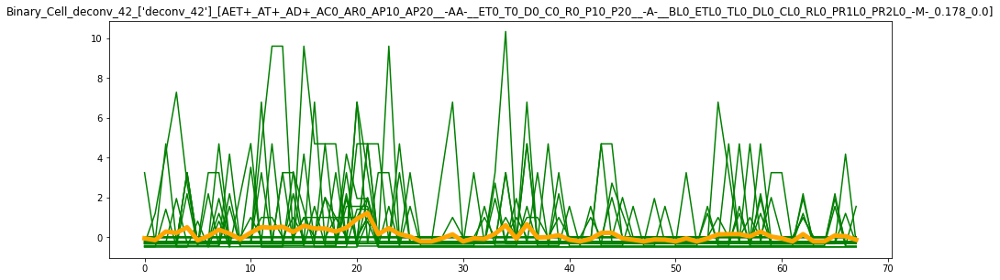


 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_19: Max_0.0  Min_0.0

 Zero baseline detec

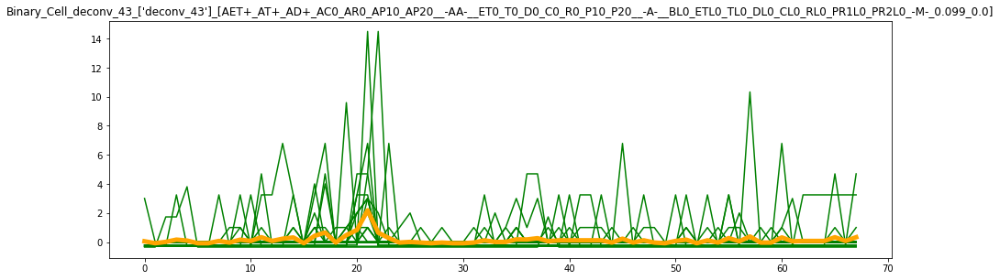


 Zero baseline detected: Binary_Cell_deconv_44: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_10: Max_0.0  Min_0.0


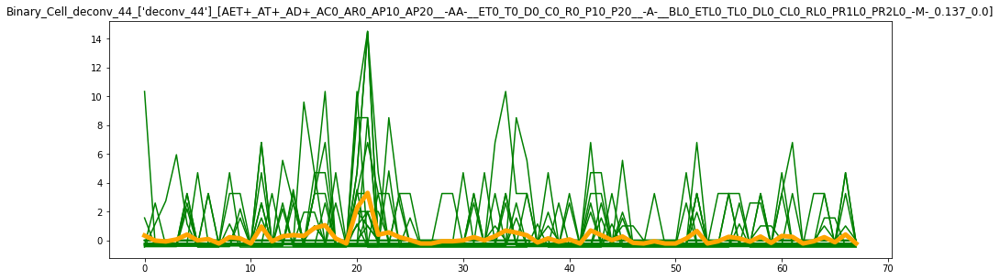


 Zero baseline detected: Binary_Cell_deconv_48: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_48: Trial_11: Max_0.0  Min_0.0


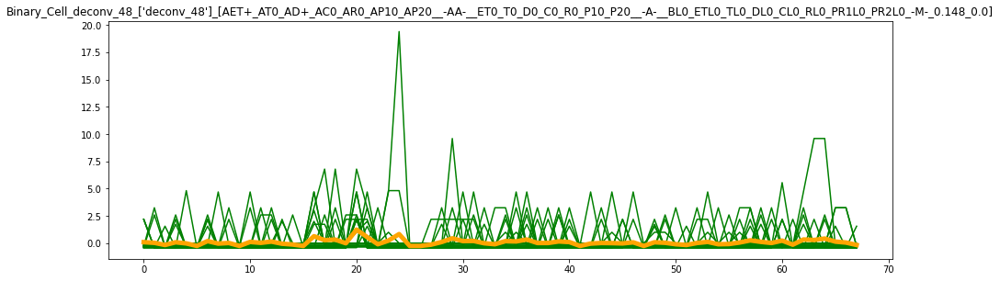


 Zero baseline detected: Binary_Cell_deconv_50: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_19: Max_0.0  Min_0.0


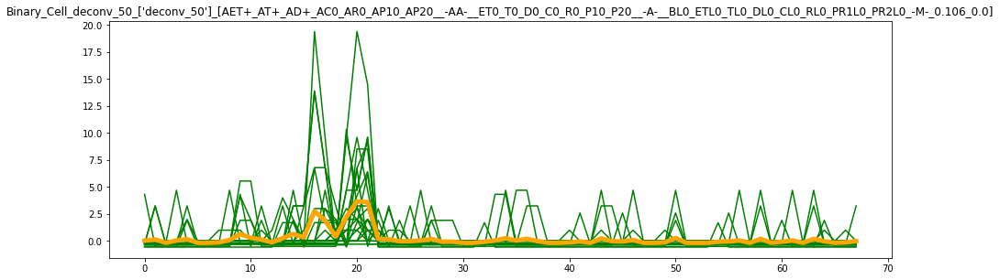


 Zero baseline detected: Binary_Cell_deconv_52: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_22: Max_0.0  Min_0.0


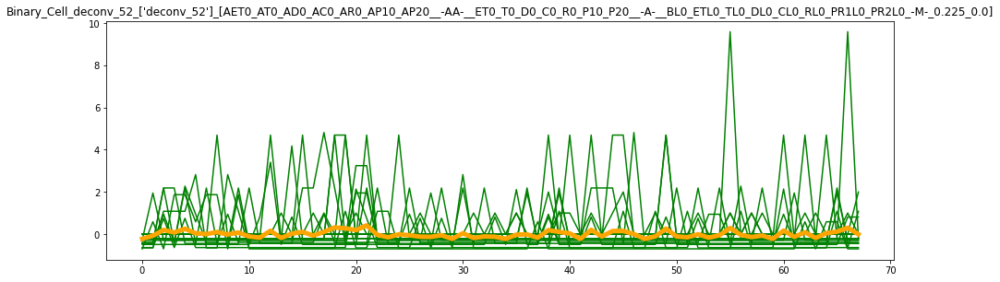

,Trial_0,Trial_1,Trial_2,Trial_3,Trial_4,Trial_5,Trial_6,Trial_7,Trial_8,Trial_9,Trial_10,Trial_11,Trial_12,Trial_13,Trial_14,Trial_15,Trial_16,Trial_17,Trial_18,Trial_19,Trial_20,Trial_21,Trial_22
0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
9,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,0.042130,-0.132152,-0.133968,-0.124405,0.007425,0.351040,-0.059274,-0.049301,0.050262,0.330220,0.092926,0.039161,-0.222785
1,-0.111868,-0.132152,-0.262666,-0.124405,-0.150548,-0.074958,0.253493,-0.137223,-0.080173,-0.018833,0.032997,0.137548,-0.070016
2,0.356012,0.151968,0.230952,0.036427,-0.150548,-0.074958,0.305812,0.289714,0.010117,-0.077865,-0.164276,-0.170448,0.199366
3,0.244319,0.110754,0.057293,0.086078,0.133571,0.138041,0.720258,0.224038,0.164115,0.061468,0.083497,0.042551,0.078557
4,-0.030082,0.148630,0.143625,-0.124405,-0.169796,0.138041,0.010372,0.505055,0.100406,0.403371,-0.021282,0.175311,0.254704
5,0.186554,-0.007873,0.042811,0.167640,-0.094845,0.079040,-0.073714,-0.146809,-0.080173,-0.004198,-0.249699,-0.170448,0.041975
6,0.101131,0.127631,-0.042059,0.059808,-0.169796,-0.074958,-0.023215,0.064907,-0.080173,0.090799,0.192838,-0.170448,0.003045
7,-0.097378,-0.041394,0.169603,0.088594,0.157411,0.138041,-0.227712,0.383221,0.073825,-0.217198,-0.036699,-0.126970,0.101836
8,0.316785,0.118557,0.157256,0.064675,0.157411,-0.031480,-0.227712,0.190246,-0.036694,0.219466,0.018508,0.086029,-0.013836
9,0.159099,-0.048643,-0.011655,0.029593,0.024150,0.181519,0.194492,-0.090320,0.160782,0.136431,-0.249699,0.638754,0.078557


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,0.042130,-0.132152,-0.133968,-0.124405,0.007425,0.351040,-0.059274,-0.049301,0.050262,0.330220,0.092926,0.039161,-0.222785
1,-0.111868,-0.132152,-0.262666,-0.124405,-0.150548,-0.074958,0.253493,-0.137223,-0.080173,-0.018833,0.032997,0.137548,-0.070016
2,0.356012,0.151968,0.230952,0.036427,-0.150548,-0.074958,0.305812,0.289714,0.010117,-0.077865,-0.164276,-0.170448,0.199366
3,0.244319,0.110754,0.057293,0.086078,0.133571,0.138041,0.720258,0.224038,0.164115,0.061468,0.083497,0.042551,0.078557
4,-0.030082,0.148630,0.143625,-0.124405,-0.169796,0.138041,0.010372,0.505055,0.100406,0.403371,-0.021282,0.175311,0.254704
5,0.186554,-0.007873,0.042811,0.167640,-0.094845,0.079040,-0.073714,-0.146809,-0.080173,-0.004198,-0.249699,-0.170448,0.041975
6,0.101131,0.127631,-0.042059,0.059808,-0.169796,-0.074958,-0.023215,0.064907,-0.080173,0.090799,0.192838,-0.170448,0.003045
7,-0.097378,-0.041394,0.169603,0.088594,0.157411,0.138041,-0.227712,0.383221,0.073825,-0.217198,-0.036699,-0.126970,0.101836
8,0.316785,0.118557,0.157256,0.064675,0.157411,-0.031480,-0.227712,0.190246,-0.036694,0.219466,0.018508,0.086029,-0.013836
9,0.159099,-0.048643,-0.011655,0.029593,0.024150,0.181519,0.194492,-0.090320,0.160782,0.136431,-0.249699,0.638754,0.078557


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [92]:
########################################
# ##### Delay Win ANY_Poke Trials ###. DO NOT COPY (Filter modified to > instead of == )
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
#Bin = 20   # Bin size
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= 0


#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Corrected_Num_of_Occurance(D)'] > Trial_Filter] #. Filter trials by omission

Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


    #############################################   
    # Calculates mean of bins across all Trial   


    Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
    Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

    Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
    Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


    ##################################################
    #Plot to validate trials and average of trials
    for i in range(Num_Trial_analysis):

        #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


    #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
    plt_raw.show()
    ######################################################


#Info = trial type, num of trials, bin size, duration 

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

##########################################################################
######################## Part 2  Saves Data ######################

########################################

######################################

display(Cell_Baseline_Bin_Data_df)

Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
#for x in range(3):
    tempa = '[' + Perm_Table_panda['Classify'][x] +']'
    tempb =  Perm_Table_panda['Cell_ID'][x]
    #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
    tempc = str([len(Filtered_Trial_Num_All_Reward)])
    tempd = str(Behavioral_Performance['Trials_Initiated']) 
    #temp_name = str([tempa]+[tempb]+[tempc])
    tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
    temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])
    
    #print(temp_name)
    


    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    
    
display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




Filter = '[R-]'
NumofCell_Filtered = 0
CellList_Filtered = []
for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
    if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_Filtered = NumofCell_Filtered+1
        CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
print('NumofCell_Filtered = ',NumofCell_Filtered)
print('CellList_Filtered =', CellList_Filtered)

Filtered_df = pd.DataFrame()

for i in range(NumofCell_Filtered):
    Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

display(Filtered_df)


# OLD way
# filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


filename = '_Avg_Cell_Traces_zNorm_Signal_Corrected_Num_of_Occurance(D)_||'+ 'Any_Poke' + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Base_Corrected_Num_of_Occurance(D)_||'+ 'Any_Poke' + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Signal_Corrected_Num_of_Occurance(D)_||' + 'Any_Poke' + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)



In [93]:
#display(Filtered_TimeStamp)


In [94]:
# STOP HERE


 Zero baseline detected: Binary_Cell_deconv_30: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_3: Max_0.0  Min_0.0


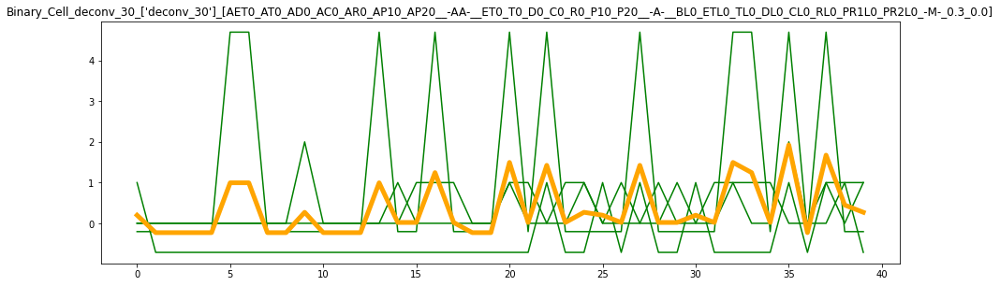


 Zero baseline detected: Binary_Cell_deconv_33: Trial_3: Max_0.0  Min_0.0


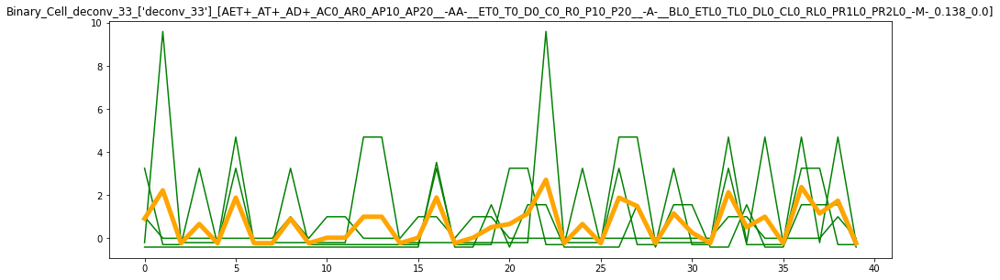


 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0


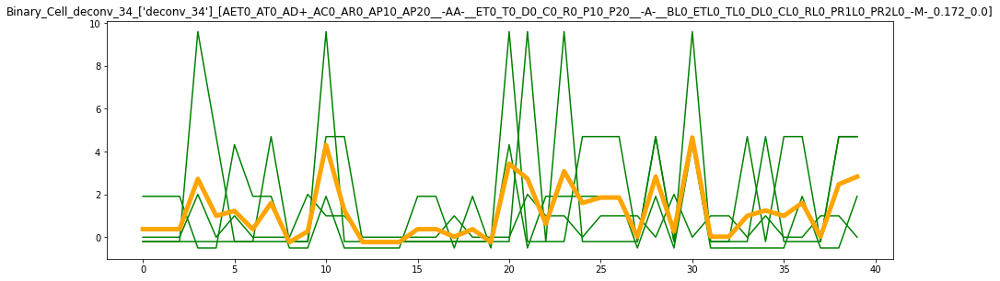


 Zero baseline detected: Binary_Cell_deconv_38: Trial_0: Max_0.0  Min_0.0


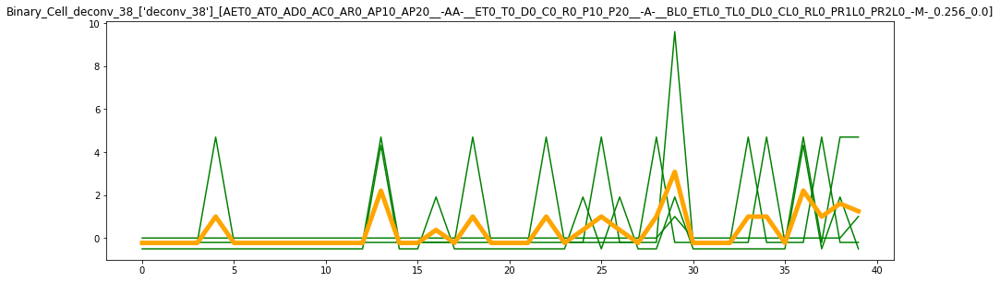


 Zero baseline detected: Binary_Cell_deconv_39: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_3: Max_0.0  Min_0.0


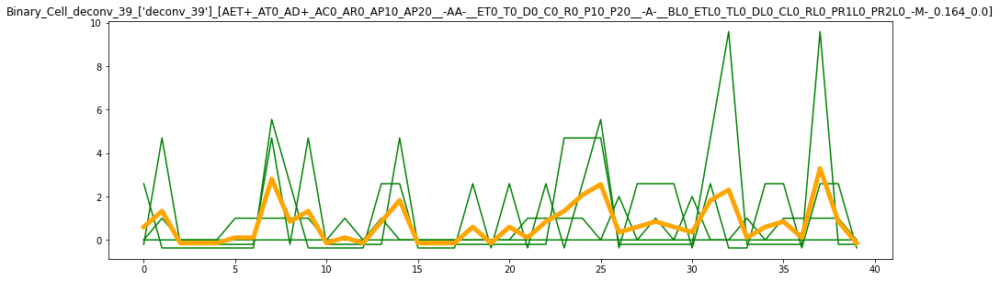


 Zero baseline detected: Binary_Cell_deconv_40: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0


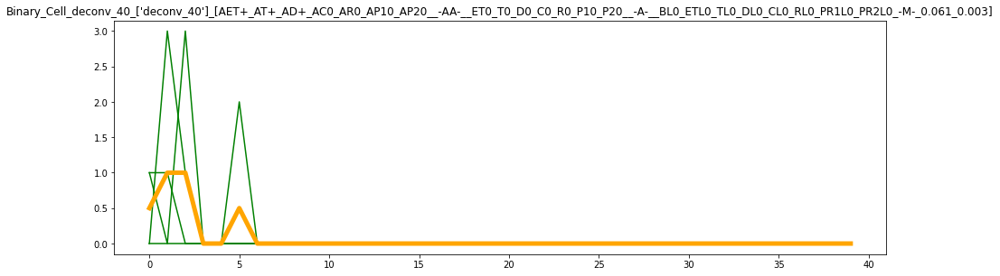


 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0


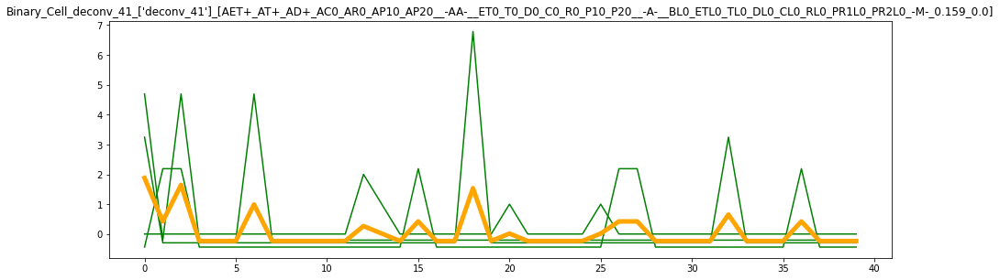

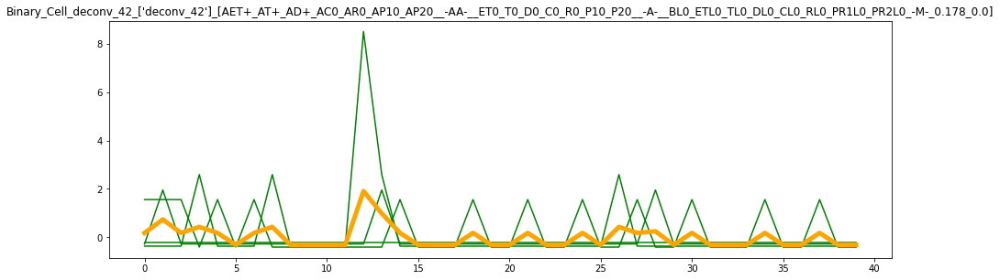


 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_3: Max_0.0  Min_0.0


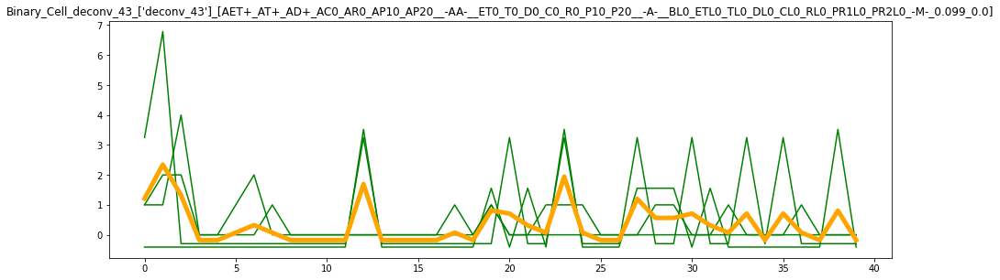


 Zero baseline detected: Binary_Cell_deconv_44: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_1: Max_0.0  Min_0.0


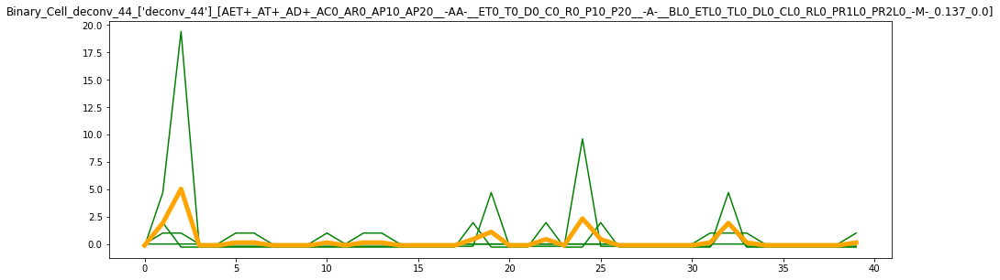


 Zero baseline detected: Binary_Cell_deconv_48: Trial_0: Max_0.0  Min_0.0


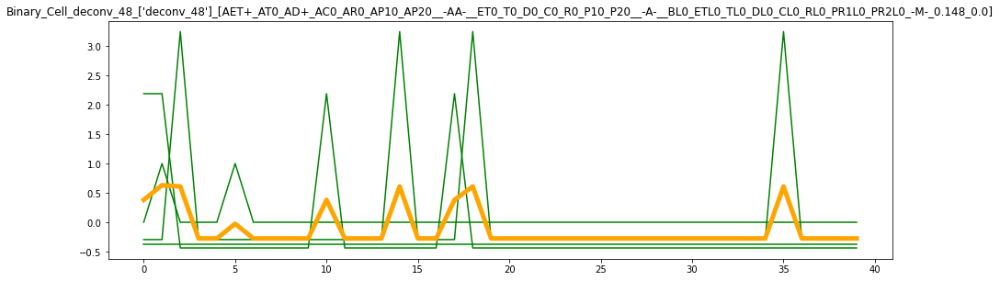


 Zero baseline detected: Binary_Cell_deconv_50: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_50: Trial_2: Max_0.0  Min_0.0


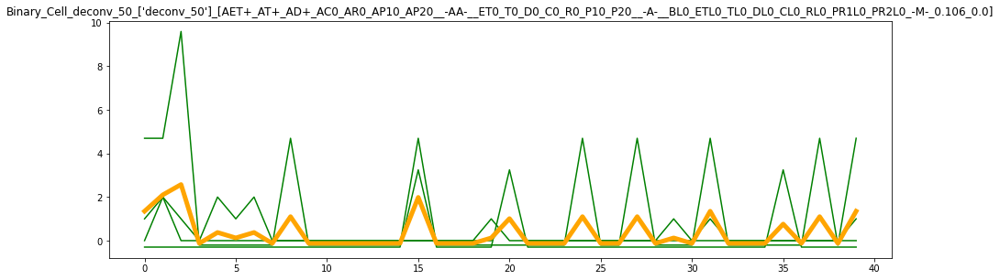


 Zero baseline detected: Binary_Cell_deconv_52: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_3: Max_0.0  Min_0.0


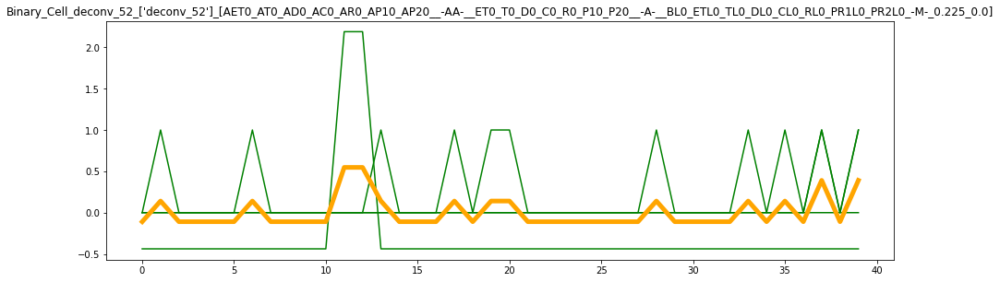

,Trial_0,Trial_1,Trial_2,Trial_3
0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0
2,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,0.0
4,0.0,1.0,0.0,0.0
5,0.0,1.0,0.0,0.0
6,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0


,Binary_Cell_deconv_30,Binary_Cell_deconv_33,Binary_Cell_deconv_34,Binary_Cell_deconv_38,Binary_Cell_deconv_39,Binary_Cell_deconv_40,Binary_Cell_deconv_41,Binary_Cell_deconv_42,Binary_Cell_deconv_43,Binary_Cell_deconv_44,Binary_Cell_deconv_48,Binary_Cell_deconv_50,Binary_Cell_deconv_52
0,0.198858,0.908338,0.375017,-0.227609,0.596480,0.5,1.875963,0.175631,1.209369,-0.120719,0.380955,1.349923,-0.109449
1,-0.229523,2.222339,0.375017,-0.227609,1.331212,1.0,0.422425,0.733135,2.344858,1.911530,0.630955,2.099923,0.140551
2,-0.229523,-0.227151,0.375017,-0.227609,-0.143533,1.0,1.647170,0.175631,1.323880,5.028260,0.609747,2.574668,-0.109449
3,-0.229523,0.658338,2.721881,-0.227609,-0.143533,0.0,-0.234271,0.424463,-0.176120,-0.120719,-0.275742,-0.124822,-0.109449
4,-0.229523,-0.227151,0.997136,0.997136,-0.143533,0.0,-0.234271,0.175631,-0.176120,-0.120719,-0.275742,0.375178,-0.109449
5,0.995222,1.883083,1.227643,-0.227609,0.106467,0.5,-0.234271,-0.315550,0.073880,0.129281,-0.025742,0.125178,-0.109449
6,0.995222,-0.227151,0.375017,-0.227609,0.106467,0.0,0.990474,0.175631,0.323880,0.129281,-0.275742,0.375178,0.140551
7,-0.229523,-0.227151,1.599762,-0.227609,2.811238,0.0,-0.234271,0.424463,0.073880,-0.120719,-0.275742,-0.124822,-0.109449
8,-0.229523,0.908338,-0.227609,-0.227609,0.846480,0.0,-0.234271,-0.315550,-0.176120,-0.120719,-0.275742,1.099923,-0.109449
9,0.270477,-0.227151,0.272391,-0.227609,1.331212,0.0,-0.234271,-0.315550,-0.176120,-0.120719,-0.275742,-0.124822,-0.109449


,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.256_0.0]', ['deconv_38'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.164_0.0]', ['deconv_39'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.061_0.003]', ['deconv_40'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.159_0.0]', ['deconv_41'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.178_0.0]', ['deconv_42'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.099_0.0]', ['deconv_43'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.137_0.0]', ['deconv_44'], '[4]', '[45]', '[1.0]']","['[AET+_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.148_0.0]', ['deconv_48'], '[4]', '[45]', '[1.0]']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.106_0.0]', ['deconv_50'], '[4]', '[45]', '[1.0]']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.225_0.0]', ['deconv_52'], '[4]', '[45]', '[1.0]']"
0,0.198858,0.908338,0.375017,-0.227609,0.596480,0.5,1.875963,0.175631,1.209369,-0.120719,0.380955,1.349923,-0.109449
1,-0.229523,2.222339,0.375017,-0.227609,1.331212,1.0,0.422425,0.733135,2.344858,1.911530,0.630955,2.099923,0.140551
2,-0.229523,-0.227151,0.375017,-0.227609,-0.143533,1.0,1.647170,0.175631,1.323880,5.028260,0.609747,2.574668,-0.109449
3,-0.229523,0.658338,2.721881,-0.227609,-0.143533,0.0,-0.234271,0.424463,-0.176120,-0.120719,-0.275742,-0.124822,-0.109449
4,-0.229523,-0.227151,0.997136,0.997136,-0.143533,0.0,-0.234271,0.175631,-0.176120,-0.120719,-0.275742,0.375178,-0.109449
5,0.995222,1.883083,1.227643,-0.227609,0.106467,0.5,-0.234271,-0.315550,0.073880,0.129281,-0.025742,0.125178,-0.109449
6,0.995222,-0.227151,0.375017,-0.227609,0.106467,0.0,0.990474,0.175631,0.323880,0.129281,-0.275742,0.375178,0.140551
7,-0.229523,-0.227151,1.599762,-0.227609,2.811238,0.0,-0.234271,0.424463,0.073880,-0.120719,-0.275742,-0.124822,-0.109449
8,-0.229523,0.908338,-0.227609,-0.227609,0.846480,0.0,-0.234271,-0.315550,-0.176120,-0.120719,-0.275742,1.099923,-0.109449
9,0.270477,-0.227151,0.272391,-0.227609,1.331212,0.0,-0.234271,-0.315550,-0.176120,-0.120719,-0.275742,-0.124822,-0.109449


NumofCell_Filtered =  0
CellList_Filtered = []


""


In [95]:

# Trial_Type['5s_bfr_Reward_received_T']

# Trial_Type['5s_aft_Reward_received_T']

# Reward_received




########################################
# ##### Reward Trials (reward window)  Reward_Received   # DO NOT COPY
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Reward_received_T'
Signal_End = '5s_aft_Reward_received_T'
# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
#Bin = 20   # Bin size
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda

Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission


#Trial_Filter= 'Reward_received'
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_Outcome'] == 'Rewarded'] #. Filter trials by reward
# Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == 'Omission'] #. Filter trials by omission
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace


    #############################################   
    # Calculates mean of bins across all Trial   


    Mean_Baseline_Cell_Bin_Data_df[Signal_Label] = Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1)  
    Mean_Signal_Cell_Bin_Data_df[Signal_Label] = Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 

    Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Baseline_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 
    Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label] = zNormalized_Cell_Signal_Bin_Data_df.iloc[:,0:Num_Trial_analysis].mean(axis=1) 


    ##################################################
    #Plot to validate trials and average of trials
    for i in range(Num_Trial_analysis):

        #plt_raw.plot(Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        #plt_raw.plot(zNormalized_Cell_Baseline_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells
        plt_raw.plot(zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))],'green')   # Mean of all cells


    #plt_raw.plot(Mean_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    #plt_raw.plot(Mean_zNormalized_Baseline_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells
    plt_raw.plot(Mean_zNormalized_Signal_Cell_Bin_Data_df[Signal_Label],'orange', linewidth = 5,)   # Mean of all cells

    plt_raw.subplots_adjust(bottom=0.1, right=2.1, top=1)
    plt_raw.title((Signal_Label + '_' +str(Perm_Table['Cell_ID'][x]) + '_' + '['+str(Perm_Table['Classify'][x]) +']' ), fontdict = None, loc='center')
    plt_raw.show()
    ######################################################


#Info = trial type, num of trials, bin size, duration 

##########################################################################
#  Remove 'None' place holder for Event_Count_TimeStamp, which is the first value
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    del Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]
    del Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]][0]

##########################################################################
######################## Part 2  Saves Data ######################

########################################

######################################

display(Cell_Baseline_Bin_Data_df)

Export_Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()
Export_Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

Export_Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
#for x in range(3):
    tempa = '[' + Perm_Table_panda['Classify'][x] +']'
    tempb =  Perm_Table_panda['Cell_ID'][x]
    #tempc = '[' + Perm_Table_panda['File_Name'][x] +']'
    tempc = str([len(Filtered_Trial_Num_All_Reward)])
    tempd = str(Behavioral_Performance['Trials_Initiated']) 
    #temp_name = str([tempa]+[tempb]+[tempc])
    tempe= '[' +str(Overall_Side_Preference_Rewarded)+']'
    temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])
    
    #print(temp_name)
    


    Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[temp_name] = Mean_zNormalized_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Baseline_Cell_Bin_Data_df[temp_name] = Mean_Baseline_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    Export_Mean_Signal_Cell_Bin_Data_df[temp_name]= Mean_Signal_Cell_Bin_Data_df['Binary_Cell_'+ CellList_deconv[x]]
    
    
display(Mean_zNormalized_Signal_Cell_Bin_Data_df)
display(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df)




Filter = '[R-]'
NumofCell_Filtered = 0
CellList_Filtered = []
for x in range(len(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns)):
    if( Filter in (Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])):     #. Detects cell by containing string (deconvoluted calcium spike)
        NumofCell_Filtered = NumofCell_Filtered+1
        CellList_Filtered.append(Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.columns[x])
print('NumofCell_Filtered = ',NumofCell_Filtered)
print('CellList_Filtered =', CellList_Filtered)

Filtered_df = pd.DataFrame()

for i in range(NumofCell_Filtered):
    Filtered_df[CellList_Filtered[i]]= Export_Mean_zNormalized_Signal_Cell_Bin_Data_df[CellList_Filtered[i]]

display(Filtered_df)


# OLD way
# filename = '_Averaged_Cell_Traces_zNormalized_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Baseline_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

# filename = '_Averaged_Cell_Traces_Raw_Signal_Rewarded_' + File_Name.split(".")[0] +'.csv'
# savefilename = os.path.join(Save_Path, filename)
# Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


filename = '_Avg_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_zNormalized_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Base_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Baseline_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

filename = '_Avg_Cell_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
Export_Mean_Signal_Cell_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)



In [96]:
########################################
# DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
# ##### Reward Received (Reward Received (5s before/5s after))
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = 'Reward_Start_5s_Bfr'
Signal_End = 'Post_Rewrd_Win_BLk_2_End'

# Signal_Begin = '5s_bfr_Reward_received_T'
# Signal_End = '5s_aft_Reward_received_T'

# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


Trial_Filter= 'Rewarded'

Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


#Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
    
    ###################################################################################
    ############################ (0) re import trial level event rates ################
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward
    
    # Avg length
    Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    

    

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):  
        
#         print('\n Cell:  ',x)
#         print('\n Trial: ', i)
#         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)
            
        ############ Newly Added
        # label trials with cell information 
        #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'
        
        tempa = '[' + Perm_Table_panda['Classify'][x] +']'
        tempb =  Perm_Table_panda['Cell_ID'][x]
        tempc=  Filtered_TimeStamp['Trial_Num'][i]
        tempd= '[' +str(Overall_Side_Preference_Rewarded)+']' 


        tempe= '[' +str(Filtered_TimeStamp['Onset(R)'][i])+']' 
        tempf= '[' +str(Filtered_TimeStamp['Total_Durat_above_zero(R)'][i])+']'
        tempg= '[' +str(Filtered_TimeStamp['Num_of_Occurance(R)'][i])+']'
        temph= '[' +str(Filtered_TimeStamp['Max_Event_Duration(R)'][i])+']'
        
        tempi= '[' + str(Filtered_Pre_Trial_Initi_Len[i]) + ']'
        tempj= '[' + str(Filtered_UnFiltered_Trial_Initi_Len[i]) + ']'
        tempk= '[' + str(Filtered_Trial_Initi_Len[i]) + ']'   # Omitted on purpose 
        templ= '[' + str(Filtered_Cue_Len[i]) + ']'
        tempm= '[' + str(Filtered_Reward_Len[i]) + ']'
        
        tempn= '[' + str(Filtered_Pre_Trial_Initi_Rate[i]) + ']'
        
        tempo= '[' + str(Filtered_Trial_Initi_Rate[i]) + ']'  
        tempp= '[' + str(Filtered_Cue_Rate[i]) + ']'
        tempq= '[' + str(Filtered_Reward_Rate[i]) + ']'
        tempr= '[' + str(Filtered_Post_Reward_Blk_1_Rate[i]) + ']'
        
        temps = str([len(Filtered_Trial_Num_All_Reward)])
        tempt = str(Behavioral_Performance['Trials_Initiated']) 
        tempu = Filtered_TimeStamp['Trial_Descript'][i]
        
        #temp_name = str([tempa]+[tempb]+[tempc])
        temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+['x']+[tempe]+[tempf]+[tempg]+[temph]
                        +['xx']+[tempi]+[tempj]+[tempk]+[templ]+[tempm]
                        +['xxx']+[tempn]
                        +['xxxx']+[tempo]+[tempp]+[tempq]+[tempr]
                        +['xxxxx']+[temps]+[tempt]+[tempu])
        
        

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace
        
        All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace


filename = '_Trial_Level_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    

#print(Perm_Table_panda['Cell_ID'][x])
    #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
    #print(zNormalized_Cell_Signal_Bin_Data_df)

    # save to this variable
    #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df











 Zero baseline detected: Binary_Cell_deconv_30: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected:

In [97]:
########################################
# DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
# ##### Reward Received (Reward Received (5s before/5s after))
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'

# Signal_Begin = '5s_bfr_Reward_received_T'
# Signal_End = '5s_aft_Reward_received_T'

# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


Trial_Filter= 'Rewarded'

Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


#Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
    
    ###################################################################################
    ############################ (0) re import trial level event rates ################
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward
    
    # Avg length
    Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    

    

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):  
        
#         print('\n Cell:  ',x)
#         print('\n Trial: ', i)
#         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)
            
        ############ Newly Added
        # label trials with cell information 
        #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'
        
        tempa = '[' + Perm_Table_panda['Classify'][x] +']'
        tempb =  Perm_Table_panda['Cell_ID'][x]
        tempc=  Filtered_TimeStamp['Trial_Num'][i]
        tempd= '[' +str(Overall_Side_Preference_Rewarded)+']' 


        tempe= '[' +str(Filtered_TimeStamp['Onset(R)'][i])+']' 
        tempf= '[' +str(Filtered_TimeStamp['Total_Durat_above_zero(R)'][i])+']'
        tempg= '[' +str(Filtered_TimeStamp['Num_of_Occurance(R)'][i])+']'
        temph= '[' +str(Filtered_TimeStamp['Max_Event_Duration(R)'][i])+']'
        
        tempi= '[' + str(Filtered_Pre_Trial_Initi_Len[i]) + ']'
        tempj= '[' + str(Filtered_UnFiltered_Trial_Initi_Len[i]) + ']'
        tempk= '[' + str(Filtered_Trial_Initi_Len[i]) + ']'   # Omitted on purpose 
        templ= '[' + str(Filtered_Cue_Len[i]) + ']'
        tempm= '[' + str(Filtered_Reward_Len[i]) + ']'
        
        tempn= '[' + str(Filtered_Pre_Trial_Initi_Rate[i]) + ']'
        
        tempo= '[' + str(Filtered_Trial_Initi_Rate[i]) + ']'  
        tempp= '[' + str(Filtered_Cue_Rate[i]) + ']'
        tempq= '[' + str(Filtered_Reward_Rate[i]) + ']'
        tempr= '[' + str(Filtered_Post_Reward_Blk_1_Rate[i]) + ']'
        
        temps = str([len(Filtered_Trial_Num_All_Reward)])
        tempt = str(Behavioral_Performance['Trials_Initiated']) 
        tempu = Filtered_TimeStamp['Trial_Descript'][i]
        
        #temp_name = str([tempa]+[tempb]+[tempc])
        temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+['x']+[tempe]+[tempf]+[tempg]+[temph]
                        +['xx']+[tempi]+[tempj]+[tempk]+[templ]+[tempm]
                        +['xxx']+[tempn]
                        +['xxxx']+[tempo]+[tempp]+[tempq]+[tempr]
                        +['xxxxx']+[temps]+[tempt]+[tempu])
        
        

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace
        
        All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace


filename = '_Trial_Level_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    

#print(Perm_Table_panda['Cell_ID'][x])
    #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
    #print(zNormalized_Cell_Signal_Bin_Data_df)

    # save to this variable
    #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Binary_Cell_deconv_30: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected:

In [98]:
display(All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df)

,"['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], [17], '[1.0]', 'x', '[10]', '[110]', '[2]', '[72.0]', 'xx', '[120]', '[26]', '[26]', '[8]', '[60]', 'xxx', '[0.0]', 'xxxx', '[0.0]', '[0.0]', '[1.6666666666666667]', '[2.3333333333333335]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], [29], '[1.0]', 'x', '[19]', '[105]', '[1]', '[105.0]', 'xx', '[120]', '[163]', '[40]', '[25]', '[60]', 'xxx', '[1.6666666666666667]', 'xxxx', '[0.0]', '[0.0]', '[1.0]', '[1.6666666666666667]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], [30], '[1.0]', 'x', '[16]', '[101]', '[1]', '[101.0]', 'xx', '[120]', '[4]', '[4]', '[25]', '[60]', 'xxx', '[0.16666666666666666]', 'xxxx', '[0.0]', '[1.6]', '[1.0]', '[1.3333333333333333]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET0_AT0_AD0_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.3_0.0]', ['deconv_30'], [45], '[1.0]', 'x', '[12]', '[109]', '[1]', '[109.0]', 'xx', '[120]', '[5]', '[5]', '[23]', '[60]', 'xxx', '[0.0]', 'xxxx', '[0.0]', '[2.608695652173913]', '[1.3333333333333333]', '[2.3333333333333335]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], [17], '[1.0]', 'x', '[10]', '[110]', '[2]', '[72.0]', 'xx', '[120]', '[26]', '[26]', '[8]', '[60]', 'xxx', '[0.16666666666666666]', 'xxxx', '[1.5384615384615383]', '[0.0]', '[1.3333333333333333]', '[1.6666666666666667]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], [29], '[1.0]', 'x', '[19]', '[105]', '[1]', '[105.0]', 'xx', '[120]', '[163]', '[40]', '[25]', '[60]', 'xxx', '[0.8333333333333334]', 'xxxx', '[2.0]', '[0.8]', '[1.3333333333333333]', '[2.0]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], [30], '[1.0]', 'x', '[16]', '[101]', '[1]', '[101.0]', 'xx', '[120]', '[4]', '[4]', '[25]', '[60]', 'xxx', '[0.3333333333333333]', 'xxxx', '[5.0]', '[0.8]', '[1.3333333333333333]', '[1.3333333333333333]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET+_AT+_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.138_0.0]', ['deconv_33'], [45], '[1.0]', 'x', '[12]', '[109]', '[1]', '[109.0]', 'xx', '[120]', '[5]', '[5]', '[23]', '[60]', 'xxx', '[0.0]', 'xxxx', '[4.0]', '[1.7391304347826089]', '[0.6666666666666666]', '[1.3333333333333333]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], [17], '[1.0]', 'x', '[10]', '[110]', '[2]', '[72.0]', 'xx', '[120]', '[26]', '[26]', '[8]', '[60]', 'xxx', '[0.0]', 'xxxx', '[1.5384615384615383]', '[2.5]', '[3.0]', '[1.6666666666666667]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], [29], '[1.0]', 'x', '[19]', '[105]', '[1]', '[105.0]', 'xx', '[120]', '[163]', '[40]', '[25]', '[60]', 'xxx', '[0.8333333333333334]', 'xxxx', '[0.5]', '[0.8]', '[3.0]', '[1.3333333333333333]', 'xxxxx', '[4]', '[45]', 'Rewarded_Left']","['[AET0_AT0_AD+_AC0_AR0_AP10_AP20__-AA-__ET0_T0_D0_C0_R0_P10_P20__-A-__BL0_ETL0_TL0_DL0_CL0_RL0_PR1L0_PR2L0_-M-_0.172_0.0]', ['deconv_34'], [30], '[1.0]', 'x', '[16]', '[101]', '[1]', '[101.0

In [99]:


# # Creating the DataFrame
# test_list = pd.DataFrame({"A": [12, 4, 5, None, 1],
#                    "B": [7, 2, 54, 3, None],
#                    "C": [20, 16, 11, 3, 8],
#                    "D": [14, 3, None, 2, 6]})
 
# display(test_list)

# odd_Trials = pd.DataFrame()
# even_Trials = pd.DataFrame()
# for ii in range(0, len(test_list)):
#     if ((ii % 2)==0 ):
#         even_Trials= even_Trials.append(test_list[ii:ii+1], ignore_index=True)
#     else :
#         odd_Trials= odd_Trials.append(test_list[ii:ii+1],ignore_index=True)
        
# display(odd_Trials)
# display(even_Trials)




In [100]:
########################################
# DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
# ##### Reward Received (Reward Received (5s before/5s after))
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'

# Signal_Begin = '5s_bfr_Reward_received_T'
# Signal_End = '5s_aft_Reward_received_T'

# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


Trial_Filter= 'Omission'

Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


#Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
    
    ###################################################################################
    ############################ (0) re import trial level event rates ################
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Type'] == Trial_Filter] #. Filter trials by omission,  'Type' is for omission
    
    # Avg length
    Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    

    

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):  
        
#         print('\n Cell:  ',x)
#         print('\n Trial: ', i)
#         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)
            
        ############ Newly Added
        # label trials with cell information 
        #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'
        
        tempa = '[' + Perm_Table_panda['Classify'][x] +']'
        tempb =  Perm_Table_panda['Cell_ID'][x]
        tempc=  Filtered_TimeStamp['Trial_Num'][i]
        tempd= '[' +str(Overall_Side_Preference_Rewarded)+']' 


        tempe= '[' +str(Filtered_TimeStamp['Onset(R)'][i])+']' 
        tempf= '[' +str(Filtered_TimeStamp['Total_Durat_above_zero(R)'][i])+']'
        tempg= '[' +str(Filtered_TimeStamp['Num_of_Occurance(R)'][i])+']'
        temph= '[' +str(Filtered_TimeStamp['Max_Event_Duration(R)'][i])+']'
        
        tempi= '[' + str(Filtered_Pre_Trial_Initi_Len[i]) + ']'
        tempj= '[' + str(Filtered_UnFiltered_Trial_Initi_Len[i]) + ']'
        tempk= '[' + str(Filtered_Trial_Initi_Len[i]) + ']'   # Omitted on purpose 
        templ= '[' + str(Filtered_Cue_Len[i]) + ']'
        tempm= '[' + str(Filtered_Reward_Len[i]) + ']'
        
        tempn= '[' + str(Filtered_Pre_Trial_Initi_Rate[i]) + ']'
        
        tempo= '[' + str(Filtered_Trial_Initi_Rate[i]) + ']'  
        tempp= '[' + str(Filtered_Cue_Rate[i]) + ']'
        tempq= '[' + str(Filtered_Reward_Rate[i]) + ']'
        tempr= '[' + str(Filtered_Post_Reward_Blk_1_Rate[i]) + ']'
        
        temps = str([len(Filtered_Trial_Num_All_Reward)])
        tempt = str(Behavioral_Performance['Trials_Initiated']) 
        tempu = Filtered_TimeStamp['Trial_Descript'][i]
        
        #temp_name = str([tempa]+[tempb]+[tempc])
        temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+['x']+[tempe]+[tempf]+[tempg]+[temph]
                        +['xx']+[tempi]+[tempj]+[tempk]+[templ]+[tempm]
                        +['xxx']+[tempn]
                        +['xxxx']+[tempo]+[tempp]+[tempq]+[tempr]
                        +['xxxxx']+[temps]+[tempt]+[tempu])
        
        

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace
        
        All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace


filename = '_Trial_Level_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    

#print(Perm_Table_panda['Cell_ID'][x])
    #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
    #print(zNormalized_Cell_Signal_Bin_Data_df)

    # save to this variable
    #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Binary_Cell_deconv_30: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_19: Max_0.0  Min_0.0

 Zero baseline de

/var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/ipykernel_21147/1507922780.py:292: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace



 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_19: Max_0.0  Min_0.0

 Zero baseline det

In [101]:
########################################
# DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
# ##### Reward Received (Reward Received (5s before/5s after))

# For P6_3 added Delay_Window_Poke behaivors as filters 
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'

# Signal_Begin = '5s_bfr_Reward_received_T'
# Signal_End = '5s_aft_Reward_received_T'

# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


Trial_Filter= 'Rewarded'

Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


#Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
    
    ###################################################################################
    ############################ (0) re import trial level event rates ################
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward
    
    # Avg length
    Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    

    
    

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):  
        
#         print('\n Cell:  ',x)
#         print('\n Trial: ', i)
#         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)
            
        ############ Newly Added
        # label trials with cell information 
        #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'
        
        tempa = '[' + Perm_Table_panda['Classify'][x] +']'
        tempb =  Perm_Table_panda['Cell_ID'][x]
        tempc=  Filtered_TimeStamp['Trial_Num'][i]
        tempd= '[' +str(Overall_Side_Preference_Rewarded)+']' 

        ###############################
        # For Delay Window for P6_3 
        temp_y_a = Filtered_TimeStamp['Corrected(D)'][i]
        temp_y_b = Filtered_TimeStamp['Corrected_Num_of_Occurance(D)'][i]
        temp_y_c = Filtered_TimeStamp['Corrected_Onset(D)'][i]
        temp_y_d = Filtered_TimeStamp['Corrected_Total_Durat_above_zero(D)'][i]
        temp_y_e = Filtered_TimeStamp['Total_Durat_above_zero(D)'][i]
        ############################

        tempe= '[' +str(Filtered_TimeStamp['Onset(R)'][i])+']' 
        tempf= '[' +str(Filtered_TimeStamp['Total_Durat_above_zero(R)'][i])+']'
        tempg= '[' +str(Filtered_TimeStamp['Num_of_Occurance(R)'][i])+']'
        temph= '[' +str(Filtered_TimeStamp['Max_Event_Duration(R)'][i])+']'
        
        tempi= '[' + str(Filtered_Pre_Trial_Initi_Len[i]) + ']'
        tempj= '[' + str(Filtered_UnFiltered_Trial_Initi_Len[i]) + ']'
        tempk= '[' + str(Filtered_Trial_Initi_Len[i]) + ']'   # Omitted on purpose 
        templ= '[' + str(Filtered_Delay_Win_Len[i]) + ']'
        tempm= '[' + str(Filtered_Cue_Len[i]) + ']'
        tempn= '[' + str(Filtered_Reward_Len[i]) + ']'
        
        tempo= '[' + str(Filtered_Pre_Trial_Initi_Rate[i]) + ']'
        
        tempp= '[' + str(Filtered_Trial_Initi_Rate[i]) + ']'  
        tempq= '[' + str(Filtered_Delay_Win_Rate[i]) + ']'
        tempr= '[' + str(Filtered_Cue_Rate[i]) + ']'
        temps= '[' + str(Filtered_Reward_Rate[i]) + ']'
        tempt= '[' + str(Filtered_Post_Reward_Blk_1_Rate[i]) + ']'
        
        tempu = str([len(Filtered_Trial_Num_All_Reward)])
        tempv = str(Behavioral_Performance['Trials_Initiated']) 
        tempw = Filtered_TimeStamp['Trial_Descript'][i]
        tempx = Filtered_TimeStamp['Type'][i]
        
        # Delay_Win(Len)
        
        
        #temp_name = str([tempa]+[tempb]+[tempc])
        temp_name = str([tempa]+[tempb]+[tempc]+[tempd]
                        +['Y']+[temp_y_a]+[temp_y_b]+[temp_y_c]+[temp_y_d]+[temp_y_e]
                        +['x']+[tempe]+[tempf]+[tempg]+[temph]
                        +['xx']+[tempi]+[tempj]+[tempk]+[templ]+[tempm]+[tempn]
                        +['xxx']+[tempo]
                        +['xxxx']+[tempp]+[tempq]+[tempr]+[temps]+[tempt]
                        +['xxxxx']+[tempu]+[tempv]+[tempw]+[tempx])
        
        

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace
        
        All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace


filename = '_Trial_Level_Cell_Traces_zNorm_Signal_For_Delay_Win_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    

#print(Perm_Table_panda['Cell_ID'][x])
    #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
    #print(zNormalized_Cell_Signal_Bin_Data_df)

    # save to this variable
    #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Binary_Cell_deconv_30: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_33: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_41: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_0: Max_0.0  Min_0.0

 Zero baseline detected:

In [102]:
########################################
# DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
# ##### Reward Received (Reward Received (5s before/5s after))

# For P6_3 added Delay_Window_Poke behaivors as filters 
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'

# Signal_Begin = '5s_bfr_Reward_received_T'
# Signal_End = '5s_aft_Reward_received_T'

# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda



Trial_Filter= 'Omission'

Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


#Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 

Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
    
    ###################################################################################
    ############################ (0) re import trial level event rates ################
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Type'] == Trial_Filter] #. Filter trials by omission,  'Type' is for omission
    
    # Avg length
    Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    

    
    

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):  
        
#         print('\n Cell:  ',x)
#         print('\n Trial: ', i)
#         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)
            
        ############ Newly Added
        # label trials with cell information 
        #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'
        
        tempa = '[' + Perm_Table_panda['Classify'][x] +']'
        tempb =  Perm_Table_panda['Cell_ID'][x]
        tempc=  Filtered_TimeStamp['Trial_Num'][i]
        tempd= '[' +str(Overall_Side_Preference_Rewarded)+']' 

        ###############################
        # For Delay Window for P6_3 
        temp_y_a = Filtered_TimeStamp['Corrected(D)'][i]
        temp_y_b = Filtered_TimeStamp['Corrected_Num_of_Occurance(D)'][i]
        temp_y_c = Filtered_TimeStamp['Corrected_Onset(D)'][i]
        temp_y_d = Filtered_TimeStamp['Corrected_Total_Durat_above_zero(D)'][i]
        temp_y_e = Filtered_TimeStamp['Total_Durat_above_zero(D)'][i]
        ############################

        tempe= '[' +str(Filtered_TimeStamp['Onset(R)'][i])+']' 
        tempf= '[' +str(Filtered_TimeStamp['Total_Durat_above_zero(R)'][i])+']'
        tempg= '[' +str(Filtered_TimeStamp['Num_of_Occurance(R)'][i])+']'
        temph= '[' +str(Filtered_TimeStamp['Max_Event_Duration(R)'][i])+']'
        
        tempi= '[' + str(Filtered_Pre_Trial_Initi_Len[i]) + ']'
        tempj= '[' + str(Filtered_UnFiltered_Trial_Initi_Len[i]) + ']'
        tempk= '[' + str(Filtered_Trial_Initi_Len[i]) + ']'   # Omitted on purpose 
        templ= '[' + str(Filtered_Delay_Win_Len[i]) + ']'
        tempm= '[' + str(Filtered_Cue_Len[i]) + ']'
        tempn= '[' + str(Filtered_Reward_Len[i]) + ']'
        
        tempo= '[' + str(Filtered_Pre_Trial_Initi_Rate[i]) + ']'
        
        tempp= '[' + str(Filtered_Trial_Initi_Rate[i]) + ']'  
        tempq= '[' + str(Filtered_Delay_Win_Rate[i]) + ']'
        tempr= '[' + str(Filtered_Cue_Rate[i]) + ']'
        temps= '[' + str(Filtered_Reward_Rate[i]) + ']'
        tempt= '[' + str(Filtered_Post_Reward_Blk_1_Rate[i]) + ']'
        
        tempu = str([len(Filtered_Trial_Num_All_Reward)])
        tempv = str(Behavioral_Performance['Trials_Initiated']) 
        tempw = Filtered_TimeStamp['Trial_Descript'][i]
        tempx = Filtered_TimeStamp['Type'][i]
        
        # Delay_Win(Len)
        
        
        #temp_name = str([tempa]+[tempb]+[tempc])
        temp_name = str([tempa]+[tempb]+[tempc]+[tempd]
                        +['Y']+[temp_y_a]+[temp_y_b]+[temp_y_c]+[temp_y_d]+[temp_y_e]
                        +['x']+[tempe]+[tempf]+[tempg]+[temph]
                        +['xx']+[tempi]+[tempj]+[tempk]+[templ]+[tempm]+[tempn]
                        +['xxx']+[tempo]
                        +['xxxx']+[tempp]+[tempq]+[tempr]+[temps]+[tempt]
                        +['xxxxx']+[tempu]+[tempv]+[tempw]+[tempx])
        

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace
        
        All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace


filename = '_Trial_Level_Cell_Traces_zNorm_Signal_For_Delay_Win_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    

#print(Perm_Table_panda['Cell_ID'][x])
    #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
    #print(zNormalized_Cell_Signal_Bin_Data_df)

    # save to this variable
    #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Binary_Cell_deconv_30: Trial_1: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_18: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_19: Max_0.0  Min_0.0

 Zero baseline de

/var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/ipykernel_21147/1923718247.py:312: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace



 Zero baseline detected: Binary_Cell_deconv_39: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_19: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_20: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_39: Trial_30: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_3: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_40: Trial_6: Max_0.0  Min_0.0

 Zero baseline de


 Zero baseline detected: Binary_Cell_deconv_52: Trial_4: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_52: Trial_18: Max_0.0  Min_0.0

 Zero baseline de

In [103]:

########################################
# DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
# ##### Reward Received (Reward Received (5s before/5s after))

# For P6_3 added Delay_Window_Poke behaivors as filters 
######################################


# Export z-Normalized Traces for plotting , All Reward Trials, Each 
# Event rate, 2 s pre-reward, 10s post reward

#. Trace for signal
Signal_Begin = '5s_bfr_Trial_Initi_End'
Signal_End = '5s_aft_Trial_Initi_End'

# Signal_Begin = '5s_bfr_Reward_received_T'
# Signal_End = '5s_aft_Reward_received_T'

# Signal_Begin = 'Reward_Start'    # Trial_Type_panda
# Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
Bin = 5   # Bin size

# Trace for Baseline, used for normalizing 
Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


Trial_Filter= 'All_Trials'

#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp = Trial_Type_panda

#Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
#Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




Baseline_Traces_Binned = defaultdict(list)
Signal_Traces_Binned = defaultdict(list)

Z_Norm_Baseline_Traces_Binned = defaultdict(list)
Z_Norm_Signal_Traces_Binned = defaultdict(list)

Z_Norm_Traces_Binned_Header = ['Info']

for i in range(NumofCell_deconv):
    Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])
    
for ii in range(len(Z_Norm_Traces_Binned_Header)):
    Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
    Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

# # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
Cropped_Length = []
for i in range(len(Filtered_Signal_Begin)):
    tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    Cropped_Length.append(tempb - tempa)
    
Median_Cropped_Length = (np.median(Cropped_Length))

###############################################
#number of trials that can be analyze (trials cut off prematurely gets reject)
Num_Trial_analysis= 0 
##########################
############################################ crop data###########
# Use the first cell to check for data cutoff
#Signal_Label = CellList_deconv[0]  
Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]

for i in range(len(Filtered_Signal_Begin)):
    Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

    tempa = Filtered_Signal_Begin[i] 
    tempa = int(tempa[0])   # Convert to Integer
    tempb = Filtered_Signal_End[i]
    tempb = int(tempb[0])   # Convert to Integer
    
    
    # Crop out data that is not proper length 
    if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
        Num_Trial_analysis= Num_Trial_analysis +1

#################################################################
## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
# Not Normlaized
Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

# zNormlaized
Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

for x in range(NumofCell_deconv):
    
    ###################################################################################
    ############################ (0) re import trial level event rates ################
    
    Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    #Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward
    Filtered_df = Summary_Trial_panda #. Filter trials ,  NO FILTER!! so all trials 
    
    # Avg length
    Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    Filtered_Delay_Win_Len= (Filtered_df['Delay_Win(Len)']).values.tolist()
    Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()
    
    # Rate
    Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    Filtered_Delay_Win_Rate= (Filtered_df['Delay_Win(Rate)']).values.tolist()
    Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    

    
    

    ############################################################################################################
    #################################  (1) Slice by timestamp interval########################################
    #Signal_Label = CellList_deconv[0]
    Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
    xCropped_BaselineTraces_Cell = {}
    xCropped_SignalTraces_Cell = {}



    for i in range(Num_Trial_analysis):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Baseline_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Baseline_End[i]
        tempb = int(tempb[0])   # Convert to Integer

        tempc = Filtered_Signal_Begin[i] 
        tempc = int(tempc[0])   # Convert to Integer
        tempd = Filtered_Signal_End[i]
        tempd = int(tempd[0])   # Convert to Integer

        # Crop out data that is not proper length 
        if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
            xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
            xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

    ############################################################################################################
    ################# Bin data   ---  Baseline ################################################################################
    # Baseline_Traces_Binned
    # Signal_Traces_Binned


    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ##########  Baeline #######################
    # This compnent added to integrate binn scripts 
    t = list(xCropped_BaselineTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


    #############################################  
    ######################################################
    ################# Bin data ---  Signal ############

    #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
    Cell_Signal_Bin_Data_df = pd.DataFrame()

    ##########
    # This compnent added to integrate binn scripts 
    t = list(xCropped_SignalTraces_Cell.keys())##########
    temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
    Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

    for xx in range(len(t)):                      

        #  Input data 
        temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
        temp_df = pd.DataFrame(temp)

        # Create repeated array to sum across bins 
        temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

        # add the residuals for the axis 
        extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
        temp_df['ax'] = np.append(temp_ax, extra_bins)
        Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
        Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


    ###############################################
    # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

    zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
    zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

    for i in range(Num_Trial_analysis):  
        
#         print('\n Cell:  ',x)
#         print('\n Trial: ', i)
#         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)
            
        ############ Newly Added
        # label trials with cell information 
        #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'
        
        tempa = '[' + Perm_Table_panda['Classify'][x] +']'
        tempb =  Perm_Table_panda['Cell_ID'][x]
        tempc=  Filtered_TimeStamp['Trial_Num'][i]
        tempd= '[' +str(Overall_Side_Preference_Rewarded)+']' 

        ###############################
        # For Delay Window for P6_3 
        temp_y_a = Filtered_TimeStamp['Corrected(D)'][i]
        temp_y_b = Filtered_TimeStamp['Corrected_Num_of_Occurance(D)'][i]
        temp_y_c = Filtered_TimeStamp['Corrected_Onset(D)'][i]
        temp_y_d = Filtered_TimeStamp['Corrected_Total_Durat_above_zero(D)'][i]
        temp_y_e = Filtered_TimeStamp['Total_Durat_above_zero(D)'][i]
        ############################

        tempe= '[' +str(Filtered_TimeStamp['Onset(R)'][i])+']' 
        tempf= '[' +str(Filtered_TimeStamp['Total_Durat_above_zero(R)'][i])+']'
        tempg= '[' +str(Filtered_TimeStamp['Num_of_Occurance(R)'][i])+']'
        temph= '[' +str(Filtered_TimeStamp['Max_Event_Duration(R)'][i])+']'
        
        tempi= '[' + str(Filtered_Pre_Trial_Initi_Len[i]) + ']'
        tempj= '[' + str(Filtered_UnFiltered_Trial_Initi_Len[i]) + ']'
        tempk= '[' + str(Filtered_Trial_Initi_Len[i]) + ']'   # Omitted on purpose 
        templ= '[' + str(Filtered_Delay_Win_Len[i]) + ']'
        tempm= '[' + str(Filtered_Cue_Len[i]) + ']'
        tempn= '[' + str(Filtered_Reward_Len[i]) + ']'
        
        tempo= '[' + str(Filtered_Pre_Trial_Initi_Rate[i]) + ']'
        
        tempp= '[' + str(Filtered_Trial_Initi_Rate[i]) + ']'  
        tempq= '[' + str(Filtered_Delay_Win_Rate[i]) + ']'
        tempr= '[' + str(Filtered_Cue_Rate[i]) + ']'
        temps= '[' + str(Filtered_Reward_Rate[i]) + ']'
        tempt= '[' + str(Filtered_Post_Reward_Blk_1_Rate[i]) + ']'
        
        tempu = str([len(Filtered_Trial_Num_All_Reward)])
        tempv = str(Behavioral_Performance['Trials_Initiated']) 
        tempw = Filtered_TimeStamp['Trial_Descript'][i]
        tempx = Filtered_TimeStamp['Type'][i]
        
        # Delay_Win(Len)
        
        
        #temp_name = str([tempa]+[tempb]+[tempc])
        temp_name = str([tempa]+[tempb]+[tempc]+[tempd]
                        +['Y']+[temp_y_a]+[temp_y_b]+[temp_y_c]+[temp_y_d]+[temp_y_e]
                        +['x']+[tempe]+[tempf]+[tempg]+[temph]
                        +['xx']+[tempi]+[tempj]+[tempk]+[templ]+[tempm]+[tempn]
                        +['xxx']+[tempo]
                        +['xxxx']+[tempp]+[tempq]+[tempr]+[temps]+[tempt]
                        +['xxxxx']+[tempu]+[tempv]+[tempw]+[tempx])
        
        

        Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
        Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

        Baseline_Mean = Baseline_Trace.mean()
        Baseline_Stdev = statistics.stdev(Baseline_Trace)
        Baseline_Max = max(Baseline_Trace)
        Baseline_Min = min(Baseline_Trace)

        if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
            zNormalized_Baseline_Trace = Baseline_Trace
            zNormalized_Signal_Trace = Signal_Trace
            print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
        else:
            zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
            zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

        zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
        zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace
        
        All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace


filename = '_Trial_Level_Cell_Traces_zNorm_Signal_For_Delay_Win_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
savefilename = os.path.join(Save_Path, filename)
All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    

#print(Perm_Table_panda['Cell_ID'][x])
    #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
    #print(zNormalized_Cell_Signal_Bin_Data_df)

    # save to this variable
    #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df











 Zero baseline detected: Binary_Cell_deconv_30: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_7: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_16: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_17: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_30: Trial_22: Max_0.0  Min_0.0

 Zero baseline d

/var/folders/2c/qcjtsn_j1xngx_g__j1y_rn00000gn/T/ipykernel_21147/4019970386.py:314: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace




 Zero baseline detected: Binary_Cell_deconv_34: Trial_21: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_22: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_34: Trial_24: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_5: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_6: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_10: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_11: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_12: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_14: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_38: Trial_16: Max_0.0  Min_0.0

 Zero baselin

 Zero baseline detected: Binary_Cell_deconv_43: Trial_24: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_25: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_32: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_33: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_34: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_36: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_37: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_39: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_40: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_41: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_43: Trial_44: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_2: Max_0.0  Min_0.0

 Zero baseline detected: Binary_Cell_deconv_44: Trial_3: Max_0.0  Min_0.0

 Zero baseline

In [104]:
########################################
######. For Exporting locomotion #0  # for all trials
########################################

if (Motion_data == 1):

    #'Video_Motion_Thresholded_Trace_panda'

    ########################################
    # DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
    # ##### Reward Received (Reward Received (5s before/5s after))
    ######################################


    # Export z-Normalized Traces for plotting , All Reward Trials, Each 
    # Event rate, 2 s pre-reward, 10s post reward

    #. Trace for signal
    Signal_Begin = '5s_bfr_Trial_Initi_End'
    Signal_End = '5s_aft_Trial_Initi_End'

    # Signal_Begin = '5s_bfr_Reward_received_T'
    # Signal_End = '5s_aft_Reward_received_T'

    # Signal_Begin = 'Reward_Start'    # Trial_Type_panda
    # Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
    Bin = 5   # Bin size

    # Trace for Baseline, used for normalizing 
    Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
    Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


    Trial_Filter= 'All_Trials'

    #Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission
    Filtered_TimeStamp = Trial_Type_panda


    #Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
    #Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
    Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


    Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
    Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
    Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
    Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




    Baseline_Traces_Binned = defaultdict(list)
    Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Baseline_Traces_Binned = defaultdict(list)
    Z_Norm_Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Traces_Binned_Header = ['Info']

    for i in range(NumofCell_deconv):
        Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])

    for ii in range(len(Z_Norm_Traces_Binned_Header)):
        Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

    # # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
    Cropped_Length = []
    for i in range(len(Filtered_Signal_Begin)):
        tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer
        Cropped_Length.append(tempb - tempa)

    Median_Cropped_Length = (np.median(Cropped_Length))

    ###############################################
    #number of trials that can be analyze (trials cut off prematurely gets reject)
    Num_Trial_analysis= 0 
    ##########################
    ############################################ crop data###########
    # Use the first cell to check for data cutoff
    #Signal_Label = CellList_deconv[0]  
    #Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]
    Signal_Label ='Video_Motion_Thresholded_Trace_panda'

    for i in range(len(Filtered_Signal_Begin)):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Signal_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer


        # Crop out data that is not proper length 
        if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
            Num_Trial_analysis= Num_Trial_analysis +1

    #################################################################
    ## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
    # Not Normlaized
    Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

    # zNormlaized
    Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ######## for x in range(NumofCell_deconv):
    for x in range(1):

        ###################################################################################
        ############################ (0) re import trial level event rates ################

    #     Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    #     Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward

    #     # Avg length
    #     Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    #     Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    #     Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    #     Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    #     Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()

    #     # Rate
    #     Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    #     Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    



        ############################################################################################################
        #################################  (1) Slice by timestamp interval########################################
        #Signal_Label = CellList_deconv[0]
        #Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
        Signal_Label ='Video_Motion_Thresholded_Trace_panda'
        xCropped_BaselineTraces_Cell = {}
        xCropped_SignalTraces_Cell = {}



        for i in range(Num_Trial_analysis):
            Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

            tempa = Filtered_Baseline_Begin[i] 
            tempa = int(tempa[0])   # Convert to Integer
            tempb = Filtered_Baseline_End[i]
            tempb = int(tempb[0])   # Convert to Integer

            tempc = Filtered_Signal_Begin[i] 
            tempc = int(tempc[0])   # Convert to Integer
            tempd = Filtered_Signal_End[i]
            tempd = int(tempd[0])   # Convert to Integer

            # Crop out data that is not proper length 
            if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
                xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
                xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

        ############################################################################################################
        ################# Bin data   ---  Baseline ################################################################################
        # Baseline_Traces_Binned
        # Signal_Traces_Binned


        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Baseline_Bin_Data_df = pd.DataFrame()

        ##########  Baeline #######################
        # This compnent added to integrate binn scripts 
        t = list(xCropped_BaselineTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


        #############################################  
        ######################################################
        ################# Bin data ---  Signal ############

        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Signal_Bin_Data_df = pd.DataFrame()

        ##########
        # This compnent added to integrate binn scripts 
        t = list(xCropped_SignalTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


        ###############################################
        # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

        zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
        zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

        for i in range(Num_Trial_analysis):  

    #         print('\n Cell:  ',x)
    #         print('\n Trial: ', i)
    #         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)

            ############ Newly Added
            # label trials with cell information 
            #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'

            tempa = 'Motion' 
            tempb=  Filtered_TimeStamp['Trial_Num'][i]
            tempc= '[' +str(Temp_Motion_df[Temp_Motion_df.keys()[4]][2])+']'  ## Cropped video area region of interest for motion
            tempd= Trial_Filter
            tempe= '[' +File_Name.split(".")[0]+']' 



            #temp_name = str([tempa]+[tempb]+[tempc])
            temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])



            Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
            Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

            Baseline_Mean = Baseline_Trace.mean()
            Baseline_Stdev = statistics.stdev(Baseline_Trace)
            Baseline_Max = max(Baseline_Trace)
            Baseline_Min = min(Baseline_Trace)

            if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
                zNormalized_Baseline_Trace = Baseline_Trace
                zNormalized_Signal_Trace = Signal_Trace
                print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
            else:
                zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
                zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

            zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
            zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace

            All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace
            All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df[temp_name]= Signal_Trace
            All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df[temp_name]= Baseline_Trace


    # filename = '_Trial_Level_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    # savefilename = os.path.join(Save_Path, filename)
    # All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    filename = '_Locomotion_Traces_Raw_Baseline_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    filename = '_Locomotion_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)



    filename = '_Locomotion_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


    #print(Perm_Table_panda['Cell_ID'][x])
        #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
        #print(zNormalized_Cell_Signal_Bin_Data_df)

        # save to this variable
        #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_9: Max_0.0  Min_0.0

 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_15: Max_0.0  Min_0.0

 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_23: Max_0.0  Min_0.0

 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_37: Max_0.0  Min_0.0

 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_44: Max_0.0  Min_0.0


In [105]:
########################################
######. For Exporting locomotion #1
########################################

if (Motion_data == 1):

    #'Video_Motion_Thresholded_Trace_panda'

    ########################################
    # DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
    # ##### Reward Received (Reward Received (5s before/5s after))
    ######################################


    # Export z-Normalized Traces for plotting , All Reward Trials, Each 
    # Event rate, 2 s pre-reward, 10s post reward

    #. Trace for signal
    Signal_Begin = '5s_bfr_Trial_Initi_End'
    Signal_End = '5s_aft_Trial_Initi_End'

    # Signal_Begin = '5s_bfr_Reward_received_T'
    # Signal_End = '5s_aft_Reward_received_T'

    # Signal_Begin = 'Reward_Start'    # Trial_Type_panda
    # Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
    Bin = 5   # Bin size

    # Trace for Baseline, used for normalizing 
    Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
    Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


    Trial_Filter= 'Rewarded'

    Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


    #Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
    #Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
    Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


    Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
    Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
    Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
    Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




    Baseline_Traces_Binned = defaultdict(list)
    Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Baseline_Traces_Binned = defaultdict(list)
    Z_Norm_Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Traces_Binned_Header = ['Info']

    for i in range(NumofCell_deconv):
        Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])

    for ii in range(len(Z_Norm_Traces_Binned_Header)):
        Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

    # # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
    Cropped_Length = []
    for i in range(len(Filtered_Signal_Begin)):
        tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer
        Cropped_Length.append(tempb - tempa)

    Median_Cropped_Length = (np.median(Cropped_Length))

    ###############################################
    #number of trials that can be analyze (trials cut off prematurely gets reject)
    Num_Trial_analysis= 0 
    ##########################
    ############################################ crop data###########
    # Use the first cell to check for data cutoff
    #Signal_Label = CellList_deconv[0]  
    #Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]
    Signal_Label ='Video_Motion_Thresholded_Trace_panda'

    for i in range(len(Filtered_Signal_Begin)):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Signal_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer


        # Crop out data that is not proper length 
        if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
            Num_Trial_analysis= Num_Trial_analysis +1

    #################################################################
    ## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
    # Not Normlaized
    Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

    # zNormlaized
    Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ######## for x in range(NumofCell_deconv):
    for x in range(1):

        ###################################################################################
        ############################ (0) re import trial level event rates ################

    #     Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    #     Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward

    #     # Avg length
    #     Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    #     Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    #     Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    #     Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    #     Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()

    #     # Rate
    #     Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    #     Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    



        ############################################################################################################
        #################################  (1) Slice by timestamp interval########################################
        #Signal_Label = CellList_deconv[0]
        #Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
        Signal_Label ='Video_Motion_Thresholded_Trace_panda'
        xCropped_BaselineTraces_Cell = {}
        xCropped_SignalTraces_Cell = {}



        for i in range(Num_Trial_analysis):
            Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

            tempa = Filtered_Baseline_Begin[i] 
            tempa = int(tempa[0])   # Convert to Integer
            tempb = Filtered_Baseline_End[i]
            tempb = int(tempb[0])   # Convert to Integer

            tempc = Filtered_Signal_Begin[i] 
            tempc = int(tempc[0])   # Convert to Integer
            tempd = Filtered_Signal_End[i]
            tempd = int(tempd[0])   # Convert to Integer

            # Crop out data that is not proper length 
            if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
                xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
                xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

        ############################################################################################################
        ################# Bin data   ---  Baseline ################################################################################
        # Baseline_Traces_Binned
        # Signal_Traces_Binned


        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Baseline_Bin_Data_df = pd.DataFrame()

        ##########  Baeline #######################
        # This compnent added to integrate binn scripts 
        t = list(xCropped_BaselineTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


        #############################################  
        ######################################################
        ################# Bin data ---  Signal ############

        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Signal_Bin_Data_df = pd.DataFrame()

        ##########
        # This compnent added to integrate binn scripts 
        t = list(xCropped_SignalTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


        ###############################################
        # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

        zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
        zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

        for i in range(Num_Trial_analysis):  

    #         print('\n Cell:  ',x)
    #         print('\n Trial: ', i)
    #         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)

            ############ Newly Added
            # label trials with cell information 
            #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'

            tempa = 'Motion' 
            tempb=  Filtered_TimeStamp['Trial_Num'][i]
            tempc= '[' +str(Temp_Motion_df[Temp_Motion_df.keys()[4]][2])+']'  ## Cropped video area region of interest for motion
            tempd= Trial_Filter
            tempe= '[' +File_Name.split(".")[0]+']' 



            #temp_name = str([tempa]+[tempb]+[tempc])
            temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])



            Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
            Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

            Baseline_Mean = Baseline_Trace.mean()
            Baseline_Stdev = statistics.stdev(Baseline_Trace)
            Baseline_Max = max(Baseline_Trace)
            Baseline_Min = min(Baseline_Trace)

            if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
                zNormalized_Baseline_Trace = Baseline_Trace
                zNormalized_Signal_Trace = Signal_Trace
                print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
            else:
                zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
                zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

            zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
            zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace

            All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace
            All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df[temp_name]= Signal_Trace
            All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df[temp_name]= Baseline_Trace


    # filename = '_Trial_Level_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    # savefilename = os.path.join(Save_Path, filename)
    # All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    filename = '_Locomotion_Traces_Raw_Baseline_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    filename = '_Locomotion_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)



    filename = '_Locomotion_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


    #print(Perm_Table_panda['Cell_ID'][x])
        #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
        #print(zNormalized_Cell_Signal_Bin_Data_df)

        # save to this variable
        #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_3: Max_0.0  Min_0.0


In [106]:
########################################
######. For Exporting locomotion #2
########################################


if (Motion_data == 1):

    #'Video_Motion_Thresholded_Trace_panda'

    ########################################
    # DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
    # ##### Reward Received (Reward Received (5s before/5s after))
    ######################################


    # Export z-Normalized Traces for plotting , All Reward Trials, Each 
    # Event rate, 2 s pre-reward, 10s post reward

    #. Trace for signal
    Signal_Begin = '5s_bfr_Trial_Initi_End'
    Signal_End = '5s_aft_Trial_Initi_End'

    # Signal_Begin = '5s_bfr_Reward_received_T'
    # Signal_End = '5s_aft_Reward_received_T'

    # Signal_Begin = 'Reward_Start'    # Trial_Type_panda
    # Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
    Bin = 5   # Bin size

    # Trace for Baseline, used for normalizing 
    Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
    Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


    Trial_Filter= 'Omission'

    Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


    #Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
    #Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
    Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


    Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
    Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
    Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
    Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




    Baseline_Traces_Binned = defaultdict(list)
    Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Baseline_Traces_Binned = defaultdict(list)
    Z_Norm_Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Traces_Binned_Header = ['Info']

    for i in range(NumofCell_deconv):
        Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])

    for ii in range(len(Z_Norm_Traces_Binned_Header)):
        Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

    # # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
    Cropped_Length = []
    for i in range(len(Filtered_Signal_Begin)):
        tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer
        Cropped_Length.append(tempb - tempa)

    Median_Cropped_Length = (np.median(Cropped_Length))

    ###############################################
    #number of trials that can be analyze (trials cut off prematurely gets reject)
    Num_Trial_analysis= 0 
    ##########################
    ############################################ crop data###########
    # Use the first cell to check for data cutoff
    #Signal_Label = CellList_deconv[0]  
    #Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]
    Signal_Label ='Video_Motion_Thresholded_Trace_panda'

    for i in range(len(Filtered_Signal_Begin)):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Signal_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer


        # Crop out data that is not proper length 
        if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
            Num_Trial_analysis= Num_Trial_analysis +1

    #################################################################
    ## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
    # Not Normlaized
    Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

    # zNormlaized
    Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ######## for x in range(NumofCell_deconv):
    for x in range(1):

        ###################################################################################
        ############################ (0) re import trial level event rates ################

    #     Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    #     Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward

    #     # Avg length
    #     Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    #     Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    #     Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    #     Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    #     Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()

    #     # Rate
    #     Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    #     Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    



        ############################################################################################################
        #################################  (1) Slice by timestamp interval########################################
        #Signal_Label = CellList_deconv[0]
        #Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
        Signal_Label ='Video_Motion_Thresholded_Trace_panda'
        xCropped_BaselineTraces_Cell = {}
        xCropped_SignalTraces_Cell = {}



        for i in range(Num_Trial_analysis):
            Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

            tempa = Filtered_Baseline_Begin[i] 
            tempa = int(tempa[0])   # Convert to Integer
            tempb = Filtered_Baseline_End[i]
            tempb = int(tempb[0])   # Convert to Integer

            tempc = Filtered_Signal_Begin[i] 
            tempc = int(tempc[0])   # Convert to Integer
            tempd = Filtered_Signal_End[i]
            tempd = int(tempd[0])   # Convert to Integer

            # Crop out data that is not proper length 
            if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
                xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
                xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

        ############################################################################################################
        ################# Bin data   ---  Baseline ################################################################################
        # Baseline_Traces_Binned
        # Signal_Traces_Binned


        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Baseline_Bin_Data_df = pd.DataFrame()

        ##########  Baeline #######################
        # This compnent added to integrate binn scripts 
        t = list(xCropped_BaselineTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


        #############################################  
        ######################################################
        ################# Bin data ---  Signal ############

        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Signal_Bin_Data_df = pd.DataFrame()

        ##########
        # This compnent added to integrate binn scripts 
        t = list(xCropped_SignalTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


        ###############################################
        # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

        zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
        zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

        for i in range(Num_Trial_analysis):  

    #         print('\n Cell:  ',x)
    #         print('\n Trial: ', i)
    #         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)

            ############ Newly Added
            # label trials with cell information 
            #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'


            tempa = 'Motion' 
            tempb=  Filtered_TimeStamp['Trial_Num'][i]
            tempc= '[' +str(Temp_Motion_df[Temp_Motion_df.keys()[4]][2])+']'  ## Cropped video area region of interest for motion
            tempd= Trial_Filter
            tempe= '[' +File_Name.split(".")[0]+']' 



            #temp_name = str([tempa]+[tempb]+[tempc])
            temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])



            Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
            Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

            Baseline_Mean = Baseline_Trace.mean()
            Baseline_Stdev = statistics.stdev(Baseline_Trace)
            Baseline_Max = max(Baseline_Trace)
            Baseline_Min = min(Baseline_Trace)

            if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
                zNormalized_Baseline_Trace = Baseline_Trace
                zNormalized_Signal_Trace = Signal_Trace
                print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
            else:
                zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
                zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

            zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
            zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace

            All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace
            All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df[temp_name]= Signal_Trace
            All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df[temp_name]= Baseline_Trace


    # filename = '_Trial_Level_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    # savefilename = os.path.join(Save_Path, filename)
    # All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    filename = '_Locomotion_Traces_Raw_Baseline_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    filename = '_Locomotion_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)



    filename = '_Locomotion_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


    #print(Perm_Table_panda['Cell_ID'][x])
        #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
        #print(zNormalized_Cell_Signal_Bin_Data_df)

        # save to this variable
        #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_19: Max_0.0  Min_0.0


In [107]:
########################################
######. For Exporting locomotion #3
########################################


if (Motion_data == 1):

    #'Video_Motion_Thresholded_Trace_panda'

    ########################################
    # DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
    # ##### Reward Received (Reward Received (5s before/5s after))
    ######################################


    # Export z-Normalized Traces for plotting , All Reward Trials, Each 
    # Event rate, 2 s pre-reward, 10s post reward

    #. Trace for signal
    Signal_Begin = 'Reward_Start_5s_Bfr'
    Signal_End = 'Post_Rewrd_Win_BLk_2_End'

    # Signal_Begin = '5s_bfr_Reward_received_T'
    # Signal_End = '5s_aft_Reward_received_T'

    # Signal_Begin = 'Reward_Start'    # Trial_Type_panda
    # Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
    Bin = 5   # Bin size

    # Trace for Baseline, used for normalizing 
    Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
    Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


    Trial_Filter= 'Rewarded'

    Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


    #Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
    #Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
    Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


    Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
    Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
    Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
    Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




    Baseline_Traces_Binned = defaultdict(list)
    Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Baseline_Traces_Binned = defaultdict(list)
    Z_Norm_Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Traces_Binned_Header = ['Info']

    for i in range(NumofCell_deconv):
        Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])

    for ii in range(len(Z_Norm_Traces_Binned_Header)):
        Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

    # # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
    Cropped_Length = []
    for i in range(len(Filtered_Signal_Begin)):
        tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer
        Cropped_Length.append(tempb - tempa)

    Median_Cropped_Length = (np.median(Cropped_Length))

    ###############################################
    #number of trials that can be analyze (trials cut off prematurely gets reject)
    Num_Trial_analysis= 0 
    ##########################
    ############################################ crop data###########
    # Use the first cell to check for data cutoff
    #Signal_Label = CellList_deconv[0]  
    #Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]
    Signal_Label ='Video_Motion_Thresholded_Trace_panda'

    for i in range(len(Filtered_Signal_Begin)):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Signal_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer


        # Crop out data that is not proper length 
        if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
            Num_Trial_analysis= Num_Trial_analysis +1

    #################################################################
    ## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
    # Not Normlaized
    Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

    # zNormlaized
    Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ######## for x in range(NumofCell_deconv):
    for x in range(1):

        ###################################################################################
        ############################ (0) re import trial level event rates ################

    #     Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    #     Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward

    #     # Avg length
    #     Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    #     Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    #     Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    #     Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    #     Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()

    #     # Rate
    #     Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    #     Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    



        ############################################################################################################
        #################################  (1) Slice by timestamp interval########################################
        #Signal_Label = CellList_deconv[0]
        #Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
        Signal_Label ='Video_Motion_Thresholded_Trace_panda'
        xCropped_BaselineTraces_Cell = {}
        xCropped_SignalTraces_Cell = {}



        for i in range(Num_Trial_analysis):
            Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

            tempa = Filtered_Baseline_Begin[i] 
            tempa = int(tempa[0])   # Convert to Integer
            tempb = Filtered_Baseline_End[i]
            tempb = int(tempb[0])   # Convert to Integer

            tempc = Filtered_Signal_Begin[i] 
            tempc = int(tempc[0])   # Convert to Integer
            tempd = Filtered_Signal_End[i]
            tempd = int(tempd[0])   # Convert to Integer

            # Crop out data that is not proper length 
            if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
                xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
                xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

        ############################################################################################################
        ################# Bin data   ---  Baseline ################################################################################
        # Baseline_Traces_Binned
        # Signal_Traces_Binned


        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Baseline_Bin_Data_df = pd.DataFrame()

        ##########  Baeline #######################
        # This compnent added to integrate binn scripts 
        t = list(xCropped_BaselineTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


        #############################################  
        ######################################################
        ################# Bin data ---  Signal ############

        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Signal_Bin_Data_df = pd.DataFrame()

        ##########
        # This compnent added to integrate binn scripts 
        t = list(xCropped_SignalTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


        ###############################################
        # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

        zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
        zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

        for i in range(Num_Trial_analysis):  

    #         print('\n Cell:  ',x)
    #         print('\n Trial: ', i)
    #         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)

            ############ Newly Added
            # label trials with cell information 
            #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'


            tempa = 'Motion' 
            tempb=  Filtered_TimeStamp['Trial_Num'][i]
            tempc= '[' +str(Temp_Motion_df[Temp_Motion_df.keys()[4]][2])+']'  ## Cropped video area region of interest for motion
            tempd= Trial_Filter
            tempe= '[' +File_Name.split(".")[0]+']' 



            #temp_name = str([tempa]+[tempb]+[tempc])
            temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])


            Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
            Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

            Baseline_Mean = Baseline_Trace.mean()
            Baseline_Stdev = statistics.stdev(Baseline_Trace)
            Baseline_Max = max(Baseline_Trace)
            Baseline_Min = min(Baseline_Trace)

            if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
                zNormalized_Baseline_Trace = Baseline_Trace
                zNormalized_Signal_Trace = Signal_Trace
                print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
            else:
                zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
                zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

            zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
            zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace

            All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace
            All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df[temp_name]= Signal_Trace
            All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df[temp_name]= Baseline_Trace


    # filename = '_Trial_Level_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    # savefilename = os.path.join(Save_Path, filename)
    # All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    filename = '_Locomotion_Traces_Raw_Baseline_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    filename = '_Locomotion_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)



    filename = '_Locomotion_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


    #print(Perm_Table_panda['Cell_ID'][x])
        #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
        #print(zNormalized_Cell_Signal_Bin_Data_df)

        # save to this variable
        #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_3: Max_0.0  Min_0.0


In [108]:
########################################
######. For Exporting locomotion #4
########################################


if (Motion_data == 1):

    #'Video_Motion_Thresholded_Trace_panda'

    ########################################
    # DO NOT COPY, ONLY FOR Reward Received during Rewarded Trials
    # ##### Reward Received (Reward Received (5s before/5s after))
    ######################################


    # Export z-Normalized Traces for plotting , All Reward Trials, Each 
    # Event rate, 2 s pre-reward, 10s post reward

    #. Trace for signal
    Signal_Begin = 'Reward_Start_(Fake)_5s_Bfr'
    Signal_End = 'Post_Rewrd_Win_BLk_2_End'

    # Signal_Begin = '5s_bfr_Reward_received_T'
    # Signal_End = '5s_aft_Reward_received_T'

    # Signal_Begin = 'Reward_Start'    # Trial_Type_panda
    # Signal_End = 'Post_Rewrd_Win_BLk_2_End'        # Trial_Type_panda
    Bin = 5   # Bin size

    # Trace for Baseline, used for normalizing 
    Baseline_Begin = 'Pre_Trial_Initi_Start'    # Trial_Type_panda
    Baseline_End = 'Pre_Trial_Initi_End'        # Trial_Type_panda


    Trial_Filter= 'Omission'

    Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Type'] == Trial_Filter] #. Filter trials by omission


    #Trial_Filter= '1'  # 1 is reward received , 0 is for non rewarded trials or no reward received
    #Filtered_TimeStamp = Trial_Type_panda[Trial_Type_panda['Reward_received'] == Trial_Filter] #. Filter trials by omission
    Filtered_TimeStamp= Filtered_TimeStamp.reset_index()  # re-indexing is necessary for exporting (and referencing) individual trials 


    Filtered_Signal_Begin= (Filtered_TimeStamp[Signal_Begin]).values.tolist()
    Filtered_Signal_End= (Filtered_TimeStamp[Signal_End]).values.tolist()
    Filtered_Baseline_Begin= (Filtered_TimeStamp[Baseline_Begin]).values.tolist()
    Filtered_Baseline_End= (Filtered_TimeStamp[Baseline_End]).values.tolist()




    Baseline_Traces_Binned = defaultdict(list)
    Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Baseline_Traces_Binned = defaultdict(list)
    Z_Norm_Signal_Traces_Binned = defaultdict(list)

    Z_Norm_Traces_Binned_Header = ['Info']

    for i in range(NumofCell_deconv):
        Z_Norm_Traces_Binned_Header.append(CellList_deconv[i])

    for ii in range(len(Z_Norm_Traces_Binned_Header)):
        Z_Norm_Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Z_Norm_Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Signal_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)
        Baseline_Traces_Binned[Z_Norm_Traces_Binned_Header[ii]].append(None)

    # # calculate Median Data length, needs to be same length every trial, so premature data cutoffs trials will get omitted
    Cropped_Length = []
    for i in range(len(Filtered_Signal_Begin)):
        tempa = Filtered_Signal_Begin[i]    # cannot use 'Pre_Trial_Initi_Start' because of diff trial length
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer
        Cropped_Length.append(tempb - tempa)

    Median_Cropped_Length = (np.median(Cropped_Length))

    ###############################################
    #number of trials that can be analyze (trials cut off prematurely gets reject)
    Num_Trial_analysis= 0 
    ##########################
    ############################################ crop data###########
    # Use the first cell to check for data cutoff
    #Signal_Label = CellList_deconv[0]  
    #Signal_Label = 'Binary_Cell_'+ CellList_deconv[0]
    Signal_Label ='Video_Motion_Thresholded_Trace_panda'

    for i in range(len(Filtered_Signal_Begin)):
        Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

        tempa = Filtered_Signal_Begin[i] 
        tempa = int(tempa[0])   # Convert to Integer
        tempb = Filtered_Signal_End[i]
        tempb = int(tempb[0])   # Convert to Integer


        # Crop out data that is not proper length 
        if(len(Signal.values[tempa:tempb])== Median_Cropped_Length):
            Num_Trial_analysis= Num_Trial_analysis +1

    #################################################################
    ## (1) Slice by timestamp interval, (2) Binned by bin width,  (3) normalized against baseline, and (4) THEN average by trials 
    # Not Normlaized
    Mean_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_Signal_Cell_Bin_Data_df = pd.DataFrame()

    # zNormlaized
    Mean_zNormalized_Baseline_Cell_Bin_Data_df = pd.DataFrame()
    Mean_zNormalized_Signal_Cell_Bin_Data_df = pd.DataFrame()

    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df = pd.DataFrame()
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df = pd.DataFrame()

    ######## for x in range(NumofCell_deconv):
    for x in range(1):

        ###################################################################################
        ############################ (0) re import trial level event rates ################

    #     Summary_Trial_panda = Funct_Extract_Trials_from_Cell(x)  #. Cell data by trials 
    #     Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == Trial_Filter] #. Filter trials by reward

    #     # Avg length
    #     Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
    #     Filtered_UnFiltered_Trial_Initi_Len= (Filtered_df['UnFiltered_Trial_Initi(Len)']).values.tolist()
    #     Filtered_Trial_Initi_Len= (Filtered_df['Trial_Initi(Len)']).values.tolist()
    #     Filtered_Cue_Len= (Filtered_df['Cue(Len)']).values.tolist()
    #     Filtered_Reward_Len= (Filtered_df['Reward(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Len= (Filtered_df['Post_Rewrd_Win_BLk_1(Len)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Len= (Filtered_df['Post_Rewrd_Win_BLk_2(Len)']).values.tolist()

    #     # Rate
    #     Filtered_Pre_Trial_Initi_Rate= (Filtered_df['Pre_Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Trial_Initi_Rate= (Filtered_df['Trial_Initi(Rate)']).values.tolist()
    #     Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()
    #     Filtered_Reward_Rate= (Filtered_df['Reward(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_1_Rate= (Filtered_df['Post_Rewrd_Win_BLk_1(Rate)']).values.tolist()
    #     Filtered_Post_Reward_Blk_2_Rate= (Filtered_df['Post_Rewrd_Win_BLk_2(Rate)']).values.tolist()    



        ############################################################################################################
        #################################  (1) Slice by timestamp interval########################################
        #Signal_Label = CellList_deconv[0]
        #Signal_Label = 'Binary_Cell_'+ CellList_deconv[x]
        Signal_Label ='Video_Motion_Thresholded_Trace_panda'
        xCropped_BaselineTraces_Cell = {}
        xCropped_SignalTraces_Cell = {}



        for i in range(Num_Trial_analysis):
            Signal = df[Signal_Label].astype(float)   # access data under signal label in df dataframe

            tempa = Filtered_Baseline_Begin[i] 
            tempa = int(tempa[0])   # Convert to Integer
            tempb = Filtered_Baseline_End[i]
            tempb = int(tempb[0])   # Convert to Integer

            tempc = Filtered_Signal_Begin[i] 
            tempc = int(tempc[0])   # Convert to Integer
            tempd = Filtered_Signal_End[i]
            tempd = int(tempd[0])   # Convert to Integer

            # Crop out data that is not proper length 
            if(len(Signal.values[tempc:tempd])== Median_Cropped_Length):
                xCropped_BaselineTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempa:tempb]})
                xCropped_SignalTraces_Cell.update({('Trial_' + str(i)) :  Signal.values[tempc:tempd]})

        ############################################################################################################
        ################# Bin data   ---  Baseline ################################################################################
        # Baseline_Traces_Binned
        # Signal_Traces_Binned


        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Baseline_Bin_Data_df = pd.DataFrame()

        ##########  Baeline #######################
        # This compnent added to integrate binn scripts 
        t = list(xCropped_BaselineTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_BaselineTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Baseline_Bin_Data_df[t[xx]] = Temp_Bin_Data


        #############################################  
        ######################################################
        ################# Bin data ---  Signal ############

        #Bin = 20  # Bin size            #(10 seonds *20 frames per second)                             
        Cell_Signal_Bin_Data_df = pd.DataFrame()

        ##########
        # This compnent added to integrate binn scripts 
        t = list(xCropped_SignalTraces_Cell.keys())##########
        temp = SignalTraces_pd.DataFrame(xCropped_SignalTraces_Cell)
        Perievent_Traces_panda = temp.squeeze()                #################      Reward_Window_Trace_panda

        for xx in range(len(t)):                      

            #  Input data 
            temp = Perievent_Traces_panda.loc[0:len(Perievent_Traces_panda), t[xx]]
            temp_df = pd.DataFrame(temp)

            # Create repeated array to sum across bins 
            temp_ax = np.repeat(np.arange(1,len(temp)//Bin+1,1), Bin)

            # add the residuals for the axis 
            extra_bins = np.repeat(len(temp)//Bin+1, len(temp)%Bin)     
            temp_df['ax'] = np.append(temp_ax, extra_bins)
            Temp_Bin_Data = (temp_df.groupby(temp_df['ax'])[t[xx]].sum()).tolist()
            Cell_Signal_Bin_Data_df[t[xx]] = Temp_Bin_Data


        ###############################################
        # Normalized Baseline (By baseline) [y = (x - mean of baseline)/std of baseline]

        zNormalized_Cell_Baseline_Bin_Data_df = pd.DataFrame()
        zNormalized_Cell_Signal_Bin_Data_df = pd.DataFrame()

        for i in range(Num_Trial_analysis):  

    #         print('\n Cell:  ',x)
    #         print('\n Trial: ', i)
    #         print('Pre Trial:  ',Filtered_Pre_Trial_Initi_Rate)

            ############ Newly Added
            # label trials with cell information 
            #tempxx = '[' + Perm_Table_panda['File_Name'][x] +']'


            tempa = 'Motion' 
            tempb=  Filtered_TimeStamp['Trial_Num'][i]
            tempc= '[' +str(Temp_Motion_df[Temp_Motion_df.keys()[4]][2])+']'  ## Cropped video area region of interest for motion
            tempd= Trial_Filter
            tempe= '[' +File_Name.split(".")[0]+']' 



            #temp_name = str([tempa]+[tempb]+[tempc])
            temp_name = str([tempa]+[tempb]+[tempc]+[tempd]+[tempe])



            Baseline_Trace = Cell_Baseline_Bin_Data_df[('Trial_' + str(i))]
            Signal_Trace = Cell_Signal_Bin_Data_df[('Trial_' + str(i))]

            Baseline_Mean = Baseline_Trace.mean()
            Baseline_Stdev = statistics.stdev(Baseline_Trace)
            Baseline_Max = max(Baseline_Trace)
            Baseline_Min = min(Baseline_Trace)

            if (Baseline_Stdev == 0):  #. Usually due to zero baseline 
                zNormalized_Baseline_Trace = Baseline_Trace
                zNormalized_Signal_Trace = Signal_Trace
                print('\n Zero baseline detected: ' + Signal_Label +': Trial_' + str(i)+ ': Max_' + str(Baseline_Max) + '  Min_' + str(Baseline_Min))
            else:
                zNormalized_Baseline_Trace = (Baseline_Trace-Baseline_Mean)/Baseline_Stdev
                zNormalized_Signal_Trace = (Signal_Trace-Baseline_Mean)/Baseline_Stdev

            zNormalized_Cell_Baseline_Bin_Data_df['Trial_' + str(i)] = zNormalized_Baseline_Trace
            zNormalized_Cell_Signal_Bin_Data_df['Trial_' + str(i)] = zNormalized_Signal_Trace

            All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df[temp_name]= zNormalized_Signal_Trace
            All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df[temp_name]= Signal_Trace
            All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df[temp_name]= Baseline_Trace


    # filename = '_Trial_Level_Cell_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    # savefilename = os.path.join(Save_Path, filename)
    # All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    filename = '_Locomotion_Traces_Raw_Baseline_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Baseline_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)

    
    filename = '_Locomotion_Traces_zNorm_Signal_||'+ Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_zNormalized_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)



    filename = '_Locomotion_Traces_Raw_Signal_||' + Trial_Filter + '||_|' + Signal_Begin + '|-|' + Signal_End +'|_' + File_Name.split(".")[0] +'.csv'
    savefilename = os.path.join(Save_Path, filename)
    All_Cell_Trials_Raw_Cell_Signal_Bin_Data_df.to_csv(savefilename, mode='w', index=False, header=True)


    #print(Perm_Table_panda['Cell_ID'][x])
        #  zNormalized_Cell_Signal_Bin_Data_df[('Trial_' + str(i))]
        #print(zNormalized_Cell_Signal_Bin_Data_df)

        # save to this variable
        #ALL_Trials_zNormalized_Signal_Cell_Bin_Data_df








 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_8: Max_0.0  Min_0.0

 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_13: Max_0.0  Min_0.0

 Zero baseline detected: Video_Motion_Thresholded_Trace_panda: Trial_19: Max_0.0  Min_0.0


In [109]:

#For checking if trial level data event rates are being export correctly for different cells.


# Summary_Trial_panda = Funct_Extract_Trials_from_Cell(1) 
# Filtered_df = Summary_Trial_panda[Summary_Trial_panda['Reward_Outcome'] == 'Rewarded'] #.
# display(Filtered_df)

# Filtered_Pre_Trial_Initi_Len= (Filtered_df['Pre_Trial_Initi(Len)']).values.tolist()
# Filtered_Cue_Rate= (Filtered_df['Cue(Rate)']).values.tolist()

# print(Filtered_Cue_Rate)
# print('\n')
# print(Filtered_Cue_Rate[0])



In [110]:
# Side_Rewarded_Left = len(Summary_Trial_panda[Summary_Trial_panda['Cue_Side']=='Left'])
# Side_Rewarded_Right = len(Summary_Trial_panda[Summary_Trial_panda['Cue_Side']=='Right'])
# Overall_Side_Preference = (Side_Rewarded_Left-Side_Rewarded_Right)/(Side_Rewarded_Left+Side_Rewarded_Right)
# print(Side_Preference_Rewarded)

In [111]:
# Rewarded_Trials
# Traces of Ca Signal
# Export all Cells Perievent Figure
if (Export_Fig == 1):
    

    WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
    WinEnd= 20*6   # Signal after Reference Event

    ReferenceEvent = 'Filtered_Reward_Reward_Start' ############################################## 11111111

    # Signal_Label_Trace = ('ReScaled_Cell_37')
    # Signal_Label_Event = ('Binary_Cell_deconv_37')  # 28, 56, 64

#     Signal_Label_Trace = ('ReScaled_Cell_' + CellList_raw[5] ) # 3rd cell
#     Signal_Label_Event = ('Binary_Cell_' + CellList_deconv[5] ) # 3rd cell



    #MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
    MarkerOne_Label = 'Trial_Initi_Window_2_Sec_Limit_Trace_panda'
    MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
    #MarkerTwo_Label = 'Reward_Window_Trace_panda'
    MarkerThree_Label = 'ALL_IR_Traces_panda'
    #MarkerThree_Label = 'Video_Light3_Trace_panda'
    MarkerFour_Label= 'Middle_IR_Traces_panda'
    MarkerFive_Label= 'Reward_Received_Trace_panda'
    y_lim = 5  # number is for y_lim
    
    
    ############## For looping through all the cells
    for loop in range(NumofCell_raw):
        Cell_Resp_Label=Perm_Table_panda['Classify'][loop]
        Signal_Label_Trace = ('ReScaled_Cell_' + CellList_raw[loop] ) # 3rd cell
        Signal_Label_Event = ('Binary_Cell_' + CellList_deconv[loop] ) 
        Perievent_Traces = ExportRasters(y_lim, WinBegin,WinEnd, Signal_Label_Trace,Signal_Label_Event, ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label, MarkerFive_Label, Cell_Resp_Label)

        # # Export Binned Data
        #Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim


    ######################################################################


In [112]:
# Omssion_Trials
# Traces of Ca Signal
# Export all Cells Perievent Figure
if (Export_Fig == 1):
    

    WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
    WinEnd= 20*6   # Signal after Reference Event

    ReferenceEvent = 'Filtered_Omission_Cue_End' ############################################## 11111111

    # Signal_Label_Trace = ('ReScaled_Cell_37')
    # Signal_Label_Event = ('Binary_Cell_deconv_37')  # 28, 56, 64

#     Signal_Label_Trace = ('ReScaled_Cell_' + CellList_raw[5] ) # 3rd cell
#     Signal_Label_Event = ('Binary_Cell_' + CellList_deconv[5] ) # 3rd cell



    #MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
    MarkerOne_Label = 'Trial_Initi_Window_2_Sec_Limit_Trace_panda'
    MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
    #MarkerTwo_Label = 'Reward_Window_Trace_panda'
    MarkerThree_Label = 'ALL_IR_Traces_panda'
    #MarkerThree_Label = 'Video_Light3_Trace_panda'
    MarkerFour_Label= 'Middle_IR_Traces_panda'
    MarkerFive_Label= 'Reward_Received_Trace_panda'
    y_lim = 5  # number is for y_lim
    
    
    ############## For looping through all the cells
    for loop in range(NumofCell_raw):
        Cell_Resp_Label=Perm_Table_panda['Classify'][loop]
        Signal_Label_Trace = ('ReScaled_Cell_' + CellList_raw[loop] ) # 3rd cell
        Signal_Label_Event = ('Binary_Cell_' + CellList_deconv[loop] ) 
        Perievent_Traces = ExportRasters(y_lim, WinBegin,WinEnd, Signal_Label_Trace,Signal_Label_Event, ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label, MarkerFive_Label, Cell_Resp_Label)

        # # Export Binned Data
        #Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim


    ######################################################################


In [113]:
# All_Trials
# Traces of Ca Signal
# Export all Cells Perievent Figure
if (Export_Fig == 1):
    

    WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
    WinEnd= 20*12   # Signal after Reference Event

    ReferenceEvent = 'Trial_Window_End' ############################################## 11111111

    # Signal_Label_Trace = ('ReScaled_Cell_37')
    # Signal_Label_Event = ('Binary_Cell_deconv_37')  # 28, 56, 64

#     Signal_Label_Trace = ('ReScaled_Cell_' + CellList_raw[5] ) # 3rd cell
#     Signal_Label_Event = ('Binary_Cell_' + CellList_deconv[5] ) # 3rd cell



    #MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
    MarkerOne_Label = 'Trial_Initi_Window_2_Sec_Limit_Trace_panda'
    MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
    #MarkerTwo_Label = 'Reward_Window_Trace_panda'
    MarkerThree_Label = 'ALL_IR_Traces_panda'
    #MarkerThree_Label = 'Video_Light3_Trace_panda'
    MarkerFour_Label= 'Middle_IR_Traces_panda'
    MarkerFive_Label= 'Reward_Received_Trace_panda'
    y_lim = 5  # number is for y_lim
    
    
    ############## For looping through all the cells
    for loop in range(NumofCell_raw):
        Cell_Resp_Label=Perm_Table_panda['Classify'][loop]
        Signal_Label_Trace = ('ReScaled_Cell_' + CellList_raw[loop] ) # 3rd cell
        Signal_Label_Event = ('Binary_Cell_' + CellList_deconv[loop] ) 
        Perievent_Traces = ExportRasters(y_lim, WinBegin,WinEnd, Signal_Label_Trace,Signal_Label_Event, ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label, MarkerFive_Label, Cell_Resp_Label)

        # # Export Binned Data
        #Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim


    ######################################################################


In [114]:
# # Traces of Ca Signal
# # Export all Cells Perievent Figure

# if (Export_Fig == 1):    

#     WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
#     WinEnd= 20*6   # Signal after Reference Event

#     #Signal_Label = ('ReScaled_Cell_' + CellList_raw[1] ) # 3rd cell
#     #ReferenceEvent ='Trial_Window_End'
#     ReferenceEvent ='Filtered_Reward_Reward_Start'
#     #MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
#     MarkerOne_Label = 'Trial_Initi_Window_2_Sec_Limit_Trace_panda'
#     MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
#     MarkerThree_Label = 'ALL_IR_Traces_panda'
#     #MarkerThree_Label = 'Video_Light3_Trace_panda'
#     MarkerFour_Label= 'Reward_Received_Trace_panda'

#     #Cell_Resp_Label= '[None-][None+]'
#     #Cell_Resp_Label=Perm_Table_panda['Classify'][3]  # Does not work here, not calculate yet until later

#     ############## For looping through all the cells
#     for loop in range(NumofCell_raw):
#         Cell_Resp_Label=Perm_Table_panda['Classify'][loop]
#         Signal_Label = ('ReScaled_Cell_' + CellList_raw[loop] ) # 3rd cell
#         Perievent_Traces = ExportRasters(WinBegin,WinEnd, Signal_Label,ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label,Cell_Resp_Label)

#         # # Export Binned Data
#         #Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim


#     ######################################################################
#     # Events of Ca Signal
#     # Export all Cells Perievent Figure


#     WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
#     WinEnd= 20*6   # Signal after Reference Event

#     #Signal_Label = ('ReScaled_Cell_' + CellList_raw[1] ) # 3rd cell
#     #ReferenceEvent ='Trial_Window_End'
#     ReferenceEvent ='Filtered_Reward_Reward_Start'
#     #MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
#     MarkerOne_Label = 'Trial_Initi_Window_2_Sec_Limit_Trace_panda'
#     MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
#     MarkerThree_Label = 'ALL_IR_Traces_panda'
#     #MarkerThree_Label = 'Video_Light3_Trace_panda'
#     MarkerFour_Label= 'Reward_Received_Trace_panda'

#     #Cell_Resp_Label= '[None-][None+]'
#     #Cell_Resp_Label=Perm_Table_panda['Classify'][3]  # Does not work here, not calculate yet until later

#     ############## For looping through all the cells
#     for loop in range(NumofCell_raw):
#         Cell_Resp_Label=Perm_Table_panda['Classify'][loop]
#         Signal_Label = ('Binary_Cell_' + CellList_deconv[loop] ) # 3rd cell
#         #Signal_Label = ('ReScaled_Cell_' + CellList_raw[loop] ) # 3rd cell
#         Perievent_Traces = ExportRasters(WinBegin,WinEnd, Signal_Label,ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label,Cell_Resp_Label)

#         # # Export Binned Data
#         Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim


In [115]:
# # Traces of Ca Signal
# # Export all Cells Perievent Figure

# if (Export_Fig == 1):

#     WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
#     WinEnd= 20*6   # Signal after Reference Event

#     #Signal_Label = ('ReScaled_Cell_' + CellList_raw[1] ) # 3rd cell
#     #ReferenceEvent ='Trial_Window_End'
#     ReferenceEvent = 'Filtered_Omission_Cue_End'
#     #MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
#     MarkerOne_Label = 'Trial_Initi_Window_2_Sec_Limit_Trace_panda'
#     MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
#     MarkerThree_Label = 'ALL_IR_Traces_panda'
#     #MarkerThree_Label = 'Video_Light3_Trace_panda'
#     MarkerFour_Label= 'Reward_Received_Trace_panda'

#     #Cell_Resp_Label= '[None-][None+]'
#     #Cell_Resp_Label=Perm_Table_panda['Classify'][3]  # Does not work here, not calculate yet until later

#     ############## For looping through all the cells
#     for loop in range(NumofCell_raw):
#         Cell_Resp_Label=Perm_Table_panda['Classify'][loop]
#         Signal_Label = ('ReScaled_Cell_' + CellList_raw[loop] ) # 3rd cell
#         Perievent_Traces = ExportRasters(WinBegin,WinEnd, Signal_Label,ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label,Cell_Resp_Label)

#         # # Export Binned Data
#         #Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim


#     ######################################################################
#     # Events of Ca Signal
#     # Export all Cells Perievent Figure


#     WinBegin = 20*5   #Baseline signal Before Reference Event,  There is a limit in now far back you can go, limited by distance from trial initiation    
#     WinEnd= 20*6   # Signal after Reference Event

#     #Signal_Label = ('ReScaled_Cell_' + CellList_raw[1] ) # 3rd cell
#     #ReferenceEvent ='Trial_Window_End'
#     ReferenceEvent = 'Filtered_Omission_Cue_End'
#     #MarkerOne_Label = 'Trial_Window_Available_Trace_panda'
#     MarkerOne_Label = 'Trial_Initi_Window_2_Sec_Limit_Trace_panda'
#     MarkerTwo_Label = 'Pre_Trial_Baseline_Trace_panda'
#     MarkerThree_Label = 'ALL_IR_Traces_panda'
#     #MarkerThree_Label = 'Video_Light3_Trace_panda'
#     MarkerFour_Label= 'Reward_Received_Trace_panda'

#     #Cell_Resp_Label= '[None-][None+]'
#     #Cell_Resp_Label=Perm_Table_panda['Classify'][3]  # Does not work here, not calculate yet until later

#     ############## For looping through all the cells
#     for loop in range(NumofCell_raw):
#         Cell_Resp_Label=Perm_Table_panda['Classify'][loop]
#         Signal_Label = ('Binary_Cell_' + CellList_deconv[loop] ) # 3rd cell
#         #Signal_Label = ('ReScaled_Cell_' + CellList_raw[loop] ) # 3rd cell
#         Perievent_Traces = ExportRasters(WinBegin,WinEnd, Signal_Label,ReferenceEvent, MarkerOne_Label,MarkerTwo_Label,MarkerThree_Label,MarkerFour_Label,Cell_Resp_Label)

#         # # Export Binned Data
#         Export_Binned_Figure(8,Cell_Resp_Label) # number is for y_lim

In [116]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

print('Available Signals')
#print(df.keys())    # Signal races available from Original Data Sheet
print(df.columns.values)


print('\n\n')
print('Available TimeStamps')
print(Event_Count)  # TimeStamps

Available Signals
['Bin' 'time' '30' '33' '34' '38' '39' '40' '41' '42' '43' '44' '48' '50'
 '52' 'deconv_30' 'deconv_33' 'deconv_34' 'deconv_38' 'deconv_39'
 'deconv_40' 'deconv_41' 'deconv_42' 'deconv_43' 'deconv_44' 'deconv_48'
 'deconv_50' 'deconv_52' 'Bins_Behavior' 'Time_Behavior' 'Trial_available'
 'ALL_IR' 'event_1' 'event_2' 'event_3' 'event_4' 'event_5'
 'zNormalized_raw_Cell_30' 'zNormalized_raw_Cell_33'
 'zNormalized_raw_Cell_34' 'zNormalized_raw_Cell_38'
 'zNormalized_raw_Cell_39' 'zNormalized_raw_Cell_40'
 'zNormalized_raw_Cell_41' 'zNormalized_raw_Cell_42'
 'zNormalized_raw_Cell_43' 'zNormalized_raw_Cell_44'
 'zNormalized_raw_Cell_48' 'zNormalized_raw_Cell_50'
 'zNormalized_raw_Cell_52' 'zNormalized_deconv_Cell_deconv_30'
 'zNormalized_deconv_Cell_deconv_33' 'zNormalized_deconv_Cell_deconv_34'
 'zNormalized_deconv_Cell_deconv_38' 'zNormalized_deconv_Cell_deconv_39'
 'zNormalized_deconv_Cell_deconv_40' 'zNormalized_deconv_Cell_deconv_41'
 'zNormalized_deconv_Cell_deconv_4

In [117]:

#. Important TimeStamps

# Pretrial_baseline
print(Event_Count['Reward_Pre_Trial_Baseline_Start'])
print(Event_Count['Reward_Pre_Trial_Baseline_End'])
#Reward_Pre_Trial_Trace_panda

# Trial Initiation
print(Event_Count['Reward_Filtered_Trial_Window_Start'])
print(Event_Count['Reward_Trial_init_Window_End_panda_ConvertedTimeStamp'])
#Trial_Window_Available_Trace_panda

# Actual "Trial" period which animal respond to cue  
print(Event_Count['Reward_Trial_init_Window_End_panda_ConvertedTimeStamp'])
print(Event_Count['Reward_Win_Begining'])

# Reward Window
print(Event_Count['Reward_Win_Begining'])
print(Event_Count['Reward_Win_Ending'])
#Reward_Window_Trace_panda




4
4
4
4
4
4
4
4


In [118]:
# ##########################
# # Analyze basic output using Deconvoluted data 


# #for i in range():
# # Rate (Events Per Second) 
# a = len(SignalTraces['TimeStamp_' + str(2)])
# b = len(SignalTraces['TimeStamp_' + str(4)])
# aa = sum(SignalTraces['TimeStamp_' + str(2)])
# bb = sum(SignalTraces['TimeStamp_' + str(4)])
# print(a)
# print(aa)
# print(b)
# print(bb)



In [119]:
# Unpaired Permeutation test
# http://rasbt.github.io/mlxtend/user_guide/evaluate/permutation_test/

# treatment = [ 28.44,  29.32,  31.22,  29.58,  30.34,  28.76,  29.21,  30.4 ,
#               31.12,  31.78,  27.58,  31.57,  30.73,  30.43,  30.31,  30.32,
#               29.18,  29.52,  29.22,  30.56]
# control = [ 33.51,  30.63,  32.38,  32.52,  29.41,  30.93,  49.78,  28.96,
#             35.77,  31.42,  30.76,  30.6 ,  23.64,  30.54,  47.78,  31.98,
#             34.52,  32.42,  31.32,  40.72]


# from mlxtend.evaluate import permutation_test

# p_value = permutation_test(treatment, control,
#                            method='approximate',
#                            num_rounds=10000,
#                            seed=0)
# print(p_value)
##########0.0066993300669933005

In [120]:
#Paired Permeutation test  (l)
#http://rasbt.github.io/mlxtend/user_guide/evaluate/permutation_test/

# from mlxtend.evaluate import permutation_test

# lakes_1980 = [3.67, 1.72, 3.46, 2.60, 2.03, 2.10, 3.01]
# lakes_1990 = [2.11, 1.79, 2.71, 1.89, 1.69, 1.71, 2.01]

# p_value = permutation_test(
#     lakes_1980, lakes_1990, paired=True, method="approximate", seed=0, num_rounds=100000
# )

#print('P value: %.3f' % p_value)

#####P value: 0.031

In [121]:

print(Event_Count_TimeStamps['Reward_Received_Trace_panda_ConvertedTimeStamp'])



[[16628], [29918], [30967], [46366]]


In [122]:
# Return multiple data frames
def test():
    df1 = pd.DataFrame([1,2,3], ['a','b','c'])
    df2 = pd.DataFrame([4,5,6], ['d','e','f'])
    return df1, df2

a, b = test()
display(a, b)

,0
a,1
b,2
c,3


,0
d,4
e,5
f,6


In [123]:
print('File_Name:',  File_Name)
print('\n')
print('Removed_Trials:  ', Remove_trials)

File_Name: filtered_behav_added-DS1122-P6_3-S1-Sucrose-Reduced.csv


Removed_Trials:   [0]
